In [47]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import math as math
from imblearn.over_sampling import SMOTE
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV
import time as time
from sklearn.metrics import accuracy_score, precision_score, recall_score, roc_auc_score, roc_curve,f1_score,auc
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import learning_curve
from xgboost import XGBClassifier, plot_importance
from imblearn.pipeline import make_pipeline
import warnings
warnings.filterwarnings('ignore')
from sklearn.metrics import get_scorer_names
from sklearn.tree import DecisionTreeClassifier
from tensorflow.keras.layers import Dropout
from tensorflow.keras import regularizers
import seaborn as sns
from sklearn.svm import SVC
from sklearn.ensemble import AdaBoostClassifier
import lightgbm as ltb
from sklearn.neighbors import KNeighborsClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.feature_selection import mutual_info_classif
from sklearn.ensemble import ExtraTreesClassifier
from sklearn_genetic import GASearchCV
from sklearn_genetic.space import Continuous, Categorical, Integer
from sklearn_genetic.plots import plot_fitness_evolution, plot_search_space
from sklearn.model_selection import StratifiedKFold
from genetic_selection import GeneticSelectionCV
from tensorflow.keras.wrappers.scikit_learn import KerasClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import shap
import dtreeviz
from sklearn.ensemble import StackingClassifier

In [2]:
def evaluate_model (y_test, y_pred):
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    roc = roc_auc_score(y_test, y_pred)
    f1 = f1_score(y_test,y_pred)
    print("Accuracy of the model is: %.2f"%(accuracy * 100) , "%")
    print("Precision of the model is: %.2f" %(precision * 100) , "%")
    print("Recall of the model is: %.2f" %(recall * 100) , "%")
    print("AUC value of the model is: %.2f" %(roc * 100) , "%")
    print("F1 score of the model is: %.2f" %(f1 * 100) , "%")

In [3]:
df =  pd.read_csv('pd_speech_features.csv') #importing the TQWT feature dataset
df.head()

,id,gender,PPE,DFA,RPDE,numPulses,numPeriodsPulses,meanPeriodPulses,stdDevPeriodPulses,locPctJitter,...,tqwt_kurtosisValue_dec_28,tqwt_kurtosisValue_dec_29,tqwt_kurtosisValue_dec_30,tqwt_kurtosisValue_dec_31,tqwt_kurtosisValue_dec_32,tqwt_kurtosisValue_dec_33,tqwt_kurtosisValue_dec_34,tqwt_kurtosisValue_dec_35,tqwt_kurtosisValue_dec_36,class
0,0,1,0.85247,0.71826,0.57227,240,239,0.008064,0.000087,0.00218,...,1.5620,2.6445,3.8686,4.2105,5.1221,4.4625,2.6202,3.0004,18.9405,1
1,0,1,0.76686,0.69481,0.53966,234,233,0.008258,0.000073,0.00195,...,1.5589,3.6107,23.5155,14.1962,11.0261,9.5082,6.5245,6.3431,45.1780,1
2,0,1,0.85083,0.67604,0.58982,232,231,0.008340,0.000060,0.00176,...,1.5643,2.3308,9.4959,10.7458,11.0177,4.8066,2.9199,3.1495,4.7666,1
3,1,0,0.41121,0.79672,0.59257,178,177,0.010858,0.000183,0.00419,...,3.7805,3.5664,5.2558,14.0403,4.2235,4.6857,4.8460,6.2650,4.0603,1
4,1,0,0.32790,0.79782,0.53028,236,235,0.008162,0.002669,0.00535,...,6.1727,5.8416,6.0805,5.7621,7.7817,11.6891,8.2103,5.0559,6.1164,1


In [4]:
df1 =  pd.read_csv('parkinsons.data', sep=",") #importing the 2008 dataset
df1.head()

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335


In [5]:
df_p=df[df['class']==1]
df_n=df[df['class']==0]

# DATASET 1

## Data Analysis

In [48]:
df.shape #checking for the shape of the dataset

(756, 755)

In [49]:
df.dtypes # checking the data for the types of the data

id                             int64
gender                         int64
PPE                          float64
DFA                          float64
RPDE                         float64
                              ...   
tqwt_kurtosisValue_dec_33    float64
tqwt_kurtosisValue_dec_34    float64
tqwt_kurtosisValue_dec_35    float64
tqwt_kurtosisValue_dec_36    float64
class                          int64
Length: 755, dtype: object

In [50]:
# extracring the categorical columns from the dataset
categorical_columns = df.select_dtypes(include=['object']).columns.tolist()

print(categorical_columns)

[]


In [51]:
df.isnull().sum().sum()

0

In [52]:
df['class'].value_counts() #extracting the target feature distribution 

1    564
0    192
Name: class, dtype: int64

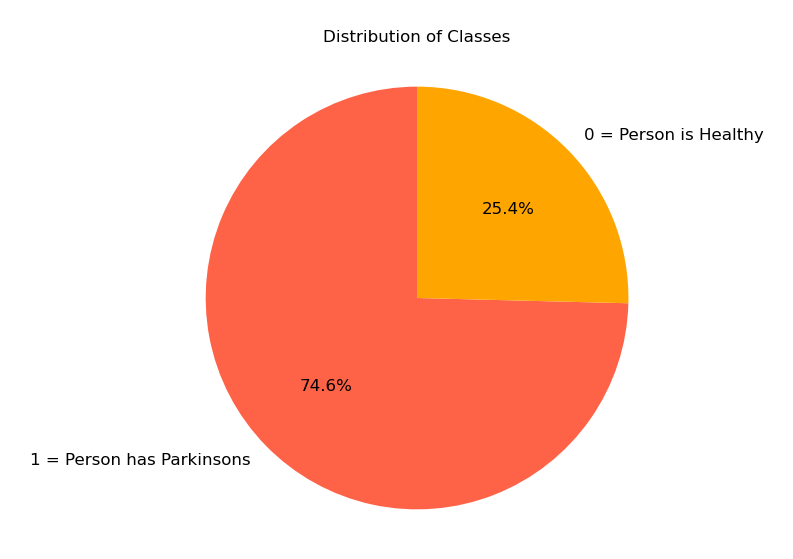

In [735]:
class_counts = df['class'].value_counts()

colors = ['#FF6347', '#FFA500'] #setting custom colours for the pie chart

plt.figure(figsize=(2, 2), dpi=300) #setting the display size and choosing a higher resolution for clearer plots

#the code below sets the data and labels for the pie chart, chooses a percentage distribution and sets colors 

plt.pie(class_counts, labels=['1 = Person has Parkinsons', '0 = Person is Healthy'], 
        autopct='%1.1f%%', startangle=90, colors=colors, textprops={'fontsize': 4})

plt.axis('equal') #this ensures the plot is a circle

plt.title('Distribution of Classes', fontsize=4) #setting title for the plot

plt.show() #displaying the plot 

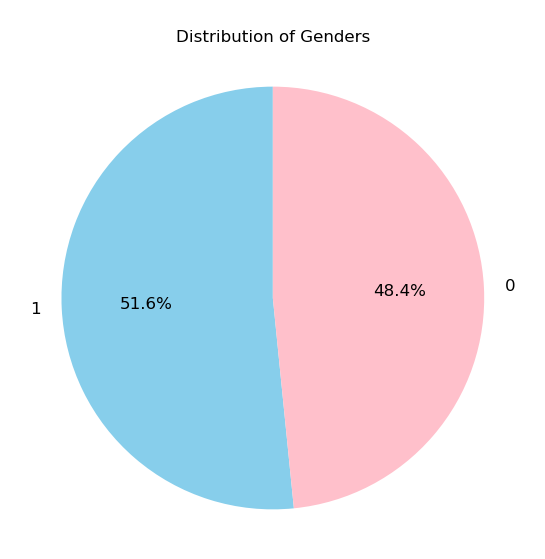

In [53]:
gender_counts = df['gender'].value_counts()

colors = ['skyblue', 'pink']

plt.figure(figsize=(2, 2), dpi=300)

plt.pie(gender_counts, labels=gender_counts.index, 
        autopct='%1.1f%%', startangle=90, colors=colors, textprops={'fontsize': 4})

plt.axis('equal')

plt.title('Distribution of Genders', fontsize=4)

plt.show()

## Data Subsets

In [54]:
df_MFCC = df.iloc[:, 57:140]
df_MFCC

,mean_MFCC_0th_coef,mean_MFCC_1st_coef,mean_MFCC_2nd_coef,mean_MFCC_3rd_coef,mean_MFCC_4th_coef,mean_MFCC_5th_coef,mean_MFCC_6th_coef,mean_MFCC_7th_coef,mean_MFCC_8th_coef,mean_MFCC_9th_coef,...,std_3rd_delta_delta,std_4th_delta_delta,std_5th_delta_delta,std_6th_delta_delta,std_7th_delta_delta,std_8th_delta_delta,std_9th_delta_delta,std_10th_delta_delta,std_11th_delta_delta,std_12th_delta_delta
0,11.4283,8.4781,2.48740,0.02292,0.55527,-1.63340,-1.51440,0.39725,0.61775,0.091821,...,0.021565,0.029594,0.015351,0.014642,0.019681,0.012829,0.021703,0.017089,0.010043,0.012130
1,12.1387,8.5008,2.89860,-0.46733,0.45984,-1.34270,-1.67590,0.17695,0.72944,0.236100,...,0.024058,0.038709,0.012191,0.025500,0.019374,0.010645,0.020296,0.015389,0.015488,0.016128
2,11.3956,7.6362,3.22080,-0.48228,0.28918,-1.73340,-1.49290,0.70520,0.51173,0.166150,...,0.024740,0.039222,0.025675,0.024607,0.024819,0.016553,0.023186,0.017217,0.015073,0.016257
3,13.7399,6.7365,3.10230,0.75419,-1.55900,-1.00830,-0.65556,0.86495,1.48370,-0.153650,...,0.019442,0.018382,0.018555,0.017274,0.016129,0.015533,0.011976,0.015529,0.013770,0.015713
4,14.7643,6.4634,2.94510,0.83210,-1.75500,-1.03920,-0.51876,0.94225,1.54980,-0.202080,...,0.022486,0.020515,0.017161,0.013791,0.016059,0.014382,0.012686,0.014478,0.013402,0.013618
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
751,19.2331,4.9357,-1.97830,-1.33790,-2.11040,-1.88320,-0.80593,1.12670,0.52705,-0.842250,...,0.014913,0.014774,0.013047,0.012046,0.014700,0.011600,0.014449,0.013394,0.013538,0.009880
752,15.9976,5.4473,-1.45210,-0.75819,-1.64890,-1.38900,-0.58952,1.96150,1.21260,-0.947720,...,0.042189,0.027349,0.019757,0.023391,0.019244,0.017564,0.017151,0.020394,0.015763,0.012711
753,16.8314,6.9160,-1.13730,-0.25013,-1.13190,-0.43466,-0.46761,-0.61630,-0.68995,0.002167,...,0.016443,0.016380,0.014117,0.013633,0.016366,0.013659,0.015405,0.013761,0.010788,0.009230
754,14.9487,8.4947,-0.17925,-0.40934,-0.22750,-0.28694,-0.72361,0.25487,0.12408,-0.284850,...,0.020405,0.018511,0.014261,0.016464,0.015774,0.012458,0.013842,0.014118,0.013443,0.012294


In [55]:
df_TQWT = df.iloc[:, 322:-1]
df_TQWT

,tqwt_energy_dec_1,tqwt_energy_dec_2,tqwt_energy_dec_3,tqwt_energy_dec_4,tqwt_energy_dec_5,tqwt_energy_dec_6,tqwt_energy_dec_7,tqwt_energy_dec_8,tqwt_energy_dec_9,tqwt_energy_dec_10,...,tqwt_kurtosisValue_dec_27,tqwt_kurtosisValue_dec_28,tqwt_kurtosisValue_dec_29,tqwt_kurtosisValue_dec_30,tqwt_kurtosisValue_dec_31,tqwt_kurtosisValue_dec_32,tqwt_kurtosisValue_dec_33,tqwt_kurtosisValue_dec_34,tqwt_kurtosisValue_dec_35,tqwt_kurtosisValue_dec_36
0,0.000011,0.000004,0.000005,0.000004,0.000007,0.000039,0.000164,0.000376,0.000392,0.000406,...,1.5466,1.5620,2.6445,3.8686,4.2105,5.1221,4.4625,2.6202,3.0004,18.9405
1,0.000029,0.000010,0.000011,0.000010,0.000012,0.000025,0.000092,0.000276,0.000404,0.000449,...,1.5530,1.5589,3.6107,23.5155,14.1962,11.0261,9.5082,6.5245,6.3431,45.1780
2,0.000034,0.000010,0.000008,0.000005,0.000007,0.000036,0.000153,0.000352,0.000312,0.000320,...,1.5399,1.5643,2.3308,9.4959,10.7458,11.0177,4.8066,2.9199,3.1495,4.7666
3,0.000051,0.000041,0.000041,0.000047,0.000061,0.000042,0.000068,0.000132,0.000167,0.000107,...,6.9761,3.7805,3.5664,5.2558,14.0403,4.2235,4.6857,4.8460,6.2650,4.0603
4,0.000044,0.000050,0.000061,0.000052,0.000062,0.000043,0.000055,0.000136,0.000207,0.000107,...,7.8832,6.1727,5.8416,6.0805,5.7621,7.7817,11.6891,8.2103,5.0559,6.1164
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
751,0.000097,0.000083,0.000106,0.000149,0.000308,0.000888,0.002457,0.003740,0.003561,0.002268,...,3.4394,3.0706,3.0190,3.1212,2.4921,3.5844,3.5400,3.3805,3.2003,6.8671
752,0.000093,0.000132,0.000186,0.000151,0.000262,0.001221,0.003890,0.005243,0.003337,0.001720,...,19.6733,1.9704,1.7451,1.8277,2.4976,5.2981,4.2616,6.3042,10.9058,28.4170
753,0.000044,0.000054,0.000142,0.000599,0.000936,0.000504,0.001110,0.002888,0.003411,0.003576,...,137.3126,51.5607,44.4641,26.1586,6.3076,2.8601,2.5361,3.5377,3.3545,5.0424
754,0.000024,0.000023,0.000029,0.000048,0.000073,0.000150,0.000487,0.001105,0.001570,0.001550,...,5.4425,19.1607,12.8312,8.9434,2.2044,1.9496,1.9664,2.6801,2.8332,3.7131


In [739]:
df_WT = df.iloc[:, 140:322]
df_WT

,Ea,Ed_1_coef,Ed_2_coef,Ed_3_coef,Ed_4_coef,Ed_5_coef,Ed_6_coef,Ed_7_coef,Ed_8_coef,Ed_9_coef,...,app_LT_TKEO_std_1_coef,app_LT_TKEO_std_2_coef,app_LT_TKEO_std_3_coef,app_LT_TKEO_std_4_coef,app_LT_TKEO_std_5_coef,app_LT_TKEO_std_6_coef,app_LT_TKEO_std_7_coef,app_LT_TKEO_std_8_coef,app_LT_TKEO_std_9_coef,app_LT_TKEO_std_10_coef
0,99.9996,1.530000e-07,8.860000e-07,0.000007,0.000021,0.000102,0.000013,4.060000e-05,0.000027,0.000010,...,6.2990,16.7003,42.0762,101.0889,228.8489,493.8563,1015.7707,2091.9460,4188.2456,8373.9278
1,99.9998,1.680000e-07,1.230000e-06,0.000012,0.000031,0.000046,0.000036,5.370000e-06,0.000074,0.000009,...,6.2381,16.5376,41.7306,100.0918,226.9019,489.9169,1006.3702,2074.4541,4148.9889,8298.1606
2,99.9999,1.170000e-07,9.450000e-07,0.000010,0.000034,0.000024,0.000035,1.660000e-06,0.000001,0.000001,...,6.2163,16.4817,41.4869,99.6154,225.7803,486.9865,1001.7348,2064.1067,4127.0967,8254.7868
3,99.0823,8.545600e-03,2.058600e-02,0.025449,0.041488,0.062341,0.090279,1.333100e-01,0.234650,0.067636,...,6.7833,16.8216,41.3157,94.4579,211.1565,443.3447,955.8128,1890.1299,3910.7029,7698.9389
4,98.6930,7.861100e-03,1.123800e-02,0.014564,0.055365,0.030612,0.057492,1.135000e-01,0.123360,0.101750,...,6.9366,18.3595,46.2704,108.6792,244.0607,541.2414,1057.2566,2242.5460,4297.4639,8645.2845
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
751,99.9979,2.310000e-07,1.040000e-06,0.000006,0.000009,0.000104,0.000047,7.250000e-05,0.000225,0.000077,...,7.8452,20.8153,52.4709,126.1072,285.6177,616.4486,1265.7214,2611.9756,5210.8916,10429.2198
752,99.9299,3.300000e-03,2.086100e-03,0.003924,0.012352,0.009249,0.013572,3.697600e-03,0.001720,0.001164,...,7.9352,20.9682,53.8402,125.9366,284.4779,610.4778,1246.2253,2585.9758,5122.8001,10271.0937
753,99.9905,2.070000e-07,1.140000e-06,0.000006,0.000011,0.000003,0.000004,9.490000e-07,0.000560,0.000574,...,7.5586,20.0371,50.5433,121.4045,274.9368,593.1211,1220.7509,2509.1969,5046.7191,10077.7849
754,99.9995,1.640000e-07,2.070000e-06,0.000005,0.000029,0.000012,0.000024,3.600000e-05,0.000301,0.000030,...,7.2604,19.2551,48.5163,116.6511,264.2910,570.1961,1169.9712,2412.3786,4826.7965,9652.6216


In [740]:
df_VFF = df.iloc[:, 34:56]
df_VFF

,GQ_prc5_95,GQ_std_cycle_open,GQ_std_cycle_closed,GNE_mean,GNE_std,GNE_SNR_TKEO,GNE_SNR_SEO,GNE_NSR_TKEO,GNE_NSR_SEO,VFER_mean,...,VFER_SNR_TKEO,VFER_SNR_SEO,VFER_NSR_TKEO,VFER_NSR_SEO,IMF_SNR_SEO,IMF_SNR_TKEO,IMF_SNR_entropy,IMF_NSR_SEO,IMF_NSR_TKEO,IMF_NSR_entropy
0,0.77778,11.7245,2.8277,1.17300,0.265120,0.083127,1200445.612,1.5347,3.0152,0.000463,...,209.6062,455.9654,1.2825,1.3305,51.6843,5.77840,23.2610,0.26850,5.8573,0.20023
1,0.81250,13.8284,2.8908,1.02210,0.220040,0.127410,1298455.445,1.6029,3.0600,0.000615,...,243.0816,379.8429,1.3063,1.3177,24.0230,6.79160,21.8851,0.26839,6.2366,0.20336
2,0.81818,26.9273,2.6975,0.84951,0.157560,0.116890,1272869.841,1.6223,3.0309,0.000360,...,238.5976,386.4739,1.2614,1.3078,60.0458,11.33760,41.7310,0.23034,4.8081,0.17296
3,0.98548,139.5744,1.6961,0.83405,0.172950,0.147370,1932289.206,1.6717,3.0293,0.000196,...,79.0921,161.1054,1.2369,1.2986,83.6201,5.07840,35.8179,0.23529,4.2629,0.17510
4,0.97847,102.0549,15.4045,0.83556,0.162100,0.151990,1861807.802,1.6781,3.0362,0.000281,...,53.6764,164.4029,1.2360,1.3156,102.9371,5.60220,31.5211,0.30603,6.3500,0.21877
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
751,1.00000,58.5451,0.0000,1.17130,0.129530,0.139260,1390404.985,1.5961,2.9570,0.019310,...,28.0254,536.9566,1.2526,1.4734,1.6584,0.65800,1.9044,0.15798,16.3559,0.15815
752,1.00000,14.5816,0.0000,1.19440,0.267640,0.113530,1773348.921,1.5855,3.0318,0.002685,...,28.1885,565.6387,1.2163,1.4004,2.2743,0.87396,2.7527,0.15487,8.6261,0.14907
753,1.00000,6.6615,0.0000,0.97851,0.131880,0.132760,1952725.483,1.6227,3.0272,0.000113,...,3.8880,66.3241,1.0833,1.1821,23.4506,1.11010,9.2936,0.15999,6.2751,0.15163
754,1.00000,6.2636,0.0000,0.87012,0.134290,0.152170,1676319.779,1.6576,2.9310,0.000138,...,9.8459,25.1221,1.1051,1.1383,52.7419,2.44840,15.6834,0.23067,6.6056,0.18473


In [741]:
df_BL = df.iloc[:, :23]
df_BL

,id,gender,PPE,DFA,RPDE,numPulses,numPeriodsPulses,meanPeriodPulses,stdDevPeriodPulses,locPctJitter,...,ddpJitter,locShimmer,locDbShimmer,apq3Shimmer,apq5Shimmer,apq11Shimmer,ddaShimmer,meanAutoCorrHarmonicity,meanNoiseToHarmHarmonicity,meanHarmToNoiseHarmonicity
0,0,1,0.85247,0.71826,0.57227,240,239,0.008064,0.000087,0.00218,...,0.00200,0.05883,0.517,0.03011,0.03496,0.04828,0.09034,0.970805,0.036223,18.995
1,0,1,0.76686,0.69481,0.53966,234,233,0.008258,0.000073,0.00195,...,0.00157,0.05516,0.502,0.02320,0.03675,0.06195,0.06961,0.984322,0.017974,21.497
2,0,1,0.85083,0.67604,0.58982,232,231,0.008340,0.000060,0.00176,...,0.00171,0.09902,0.897,0.05094,0.06497,0.07772,0.15282,0.974846,0.026313,17.651
3,1,0,0.41121,0.79672,0.59257,178,177,0.010858,0.000183,0.00419,...,0.00446,0.05451,0.527,0.02395,0.02857,0.04462,0.07185,0.968343,0.042003,19.865
4,1,0,0.32790,0.79782,0.53028,236,235,0.008162,0.002669,0.00535,...,0.00499,0.05610,0.497,0.02909,0.03327,0.05278,0.08728,0.975754,0.027139,19.557
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
751,250,0,0.80903,0.56355,0.28385,417,416,0.004627,0.000052,0.00064,...,0.00024,0.01947,0.171,0.01068,0.01260,0.01547,0.03204,0.997438,0.002571,26.813
752,250,0,0.16084,0.56499,0.59194,415,413,0.004550,0.000220,0.00143,...,0.00047,0.04291,0.482,0.02307,0.02626,0.03272,0.06920,0.976867,0.025519,17.802
753,251,0,0.88389,0.72335,0.46815,381,380,0.005069,0.000103,0.00076,...,0.00034,0.02978,0.263,0.01597,0.01916,0.02271,0.04790,0.995544,0.004480,24.005
754,251,0,0.83782,0.74890,0.49823,340,339,0.005679,0.000055,0.00092,...,0.00052,0.03552,0.311,0.01791,0.02348,0.02648,0.05373,0.988241,0.011931,19.706


In [742]:
df_TFF = df.iloc[:, 23:34]
df_TFF

,minIntensity,maxIntensity,meanIntensity,f1,f2,f3,f4,b1,b2,b3,b4
0,69.997496,76.088046,72.465512,539.342735,1031.849040,2447.162183,3655.054806,101.092218,83.147440,255.214830,396.643631
1,67.415903,73.046374,71.528945,564.363615,1016.367294,2383.565201,3498.681572,58.465428,86.487292,248.357127,218.229722
2,62.661706,71.633549,68.086583,548.444604,1032.406341,2357.826954,3678.128717,160.387771,54.685168,151.694847,84.240339
3,76.306989,81.000749,79.190593,819.529588,1201.813897,3154.035654,4122.163933,238.667052,191.984916,573.752909,526.147599
4,76.645686,80.937258,79.183495,846.796144,1215.346469,3201.513132,4085.456839,402.216738,210.061394,203.637106,384.611697
...,...,...,...,...,...,...,...,...,...,...,...
751,79.991789,82.239447,81.244436,881.915768,1395.398812,2862.850072,3285.426385,88.521045,80.283013,836.862497,2954.030296
752,70.191330,81.606291,79.423824,907.787590,1406.737344,2958.433790,3819.231665,31.238251,38.919082,5913.036193,472.403606
753,75.091300,77.612498,76.485859,687.046383,1382.653498,2189.489101,3344.351359,250.727258,2566.530343,149.117330,232.686866
754,76.168804,79.266058,77.870915,771.948334,1657.021811,2914.862553,3789.033261,148.537987,107.101663,194.220698,339.805353


# Visual Data Analysis

## Baseline Features

(array([0, 1, 2, 3, 4]),
 [Text(0, 0, 'locPctJitter'),
  Text(1, 0, 'locAbsJitter'),
  Text(2, 0, 'rapJitter'),
  Text(3, 0, 'ppq5Jitter'),
  Text(4, 0, 'ddpJitter')])

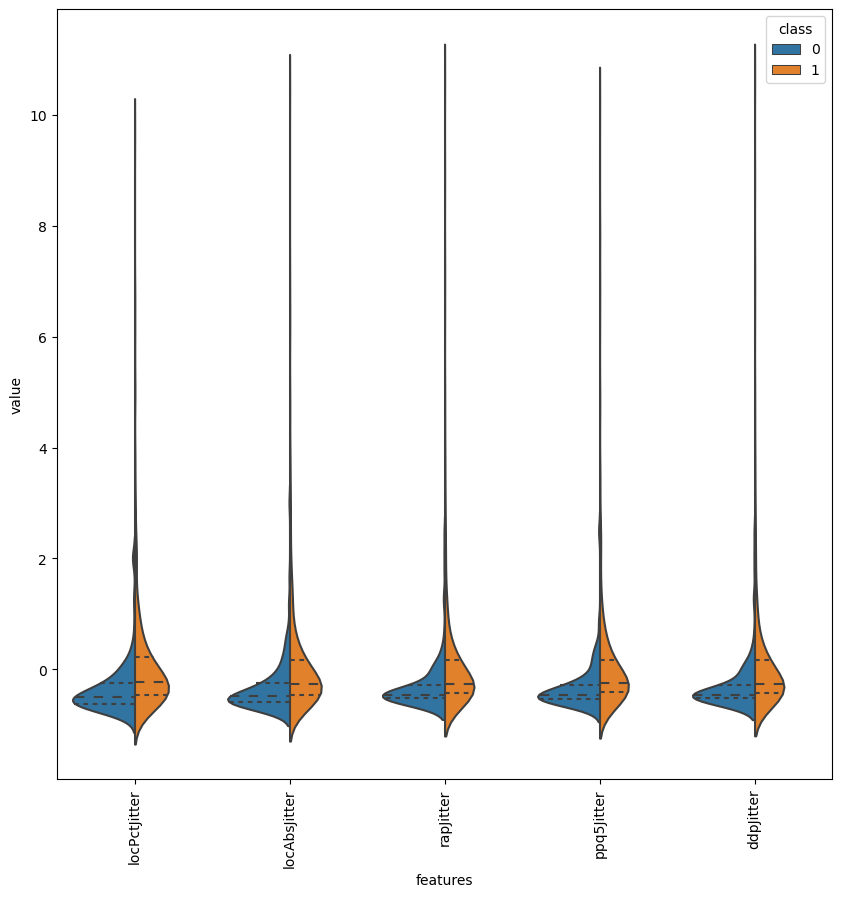

In [244]:
y= df['class']
data_dia = df['class']
data =  df_BL.iloc[:, 9:14]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
#the following line adds the values of the features in a single column for ease of visualization 
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4]),
 [Text(0, 0, 'locPctJitter'),
  Text(1, 0, 'locAbsJitter'),
  Text(2, 0, 'rapJitter'),
  Text(3, 0, 'ppq5Jitter'),
  Text(4, 0, 'ddpJitter')])

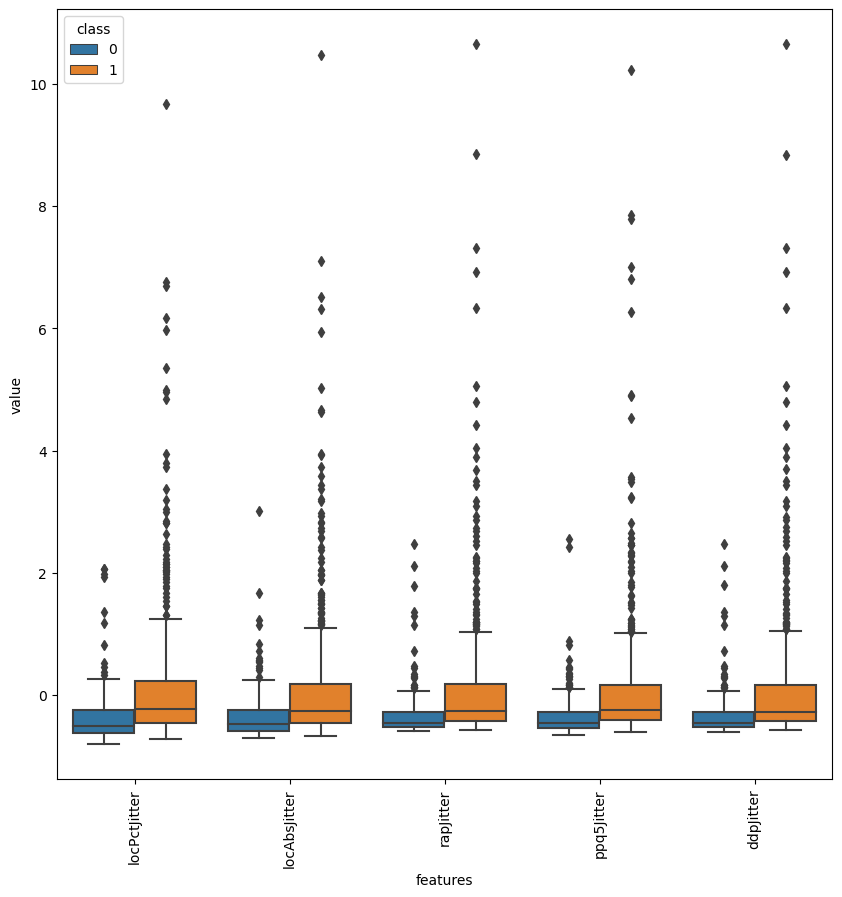

In [245]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'PPE'),
  Text(1, 0, 'DFA'),
  Text(2, 0, 'RPDE'),
  Text(3, 0, 'numPulses'),
  Text(4, 0, 'numPeriodsPulses'),
  Text(5, 0, 'meanPeriodPulses'),
  Text(6, 0, 'stdDevPeriodPulses')])

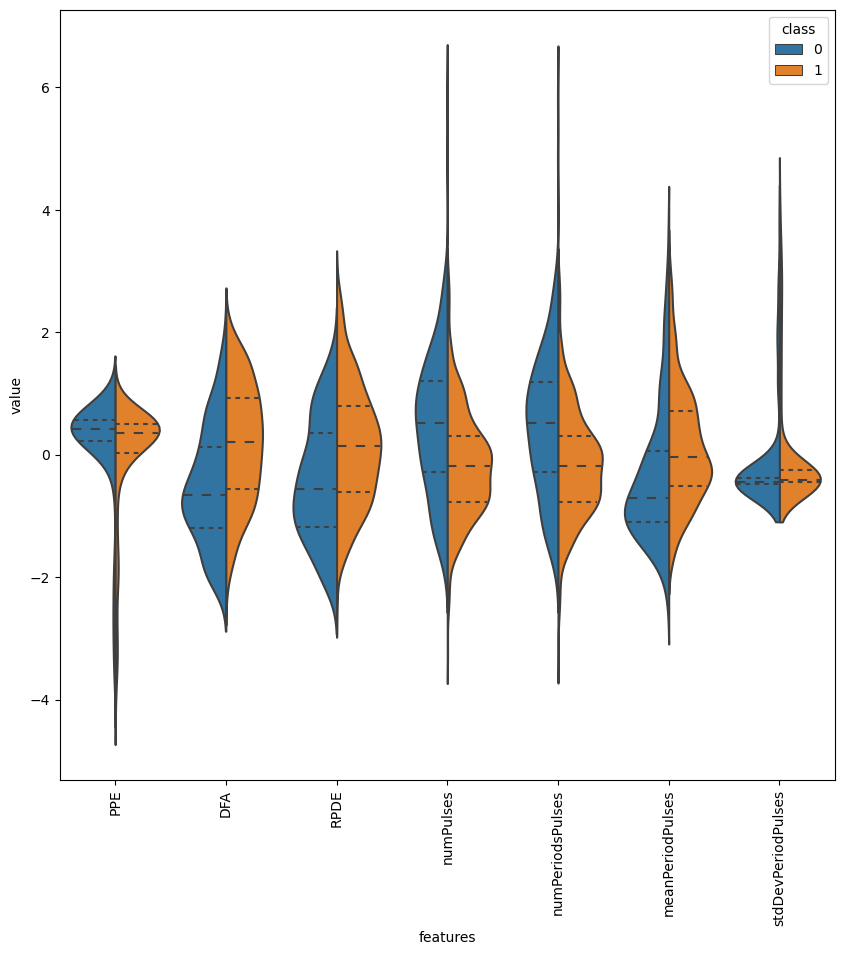

In [246]:
y= df['class']
data_dia = df['class']
data =  df_BL.iloc[:, 2:9]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'PPE'),
  Text(1, 0, 'DFA'),
  Text(2, 0, 'RPDE'),
  Text(3, 0, 'numPulses'),
  Text(4, 0, 'numPeriodsPulses'),
  Text(5, 0, 'meanPeriodPulses'),
  Text(6, 0, 'stdDevPeriodPulses')])

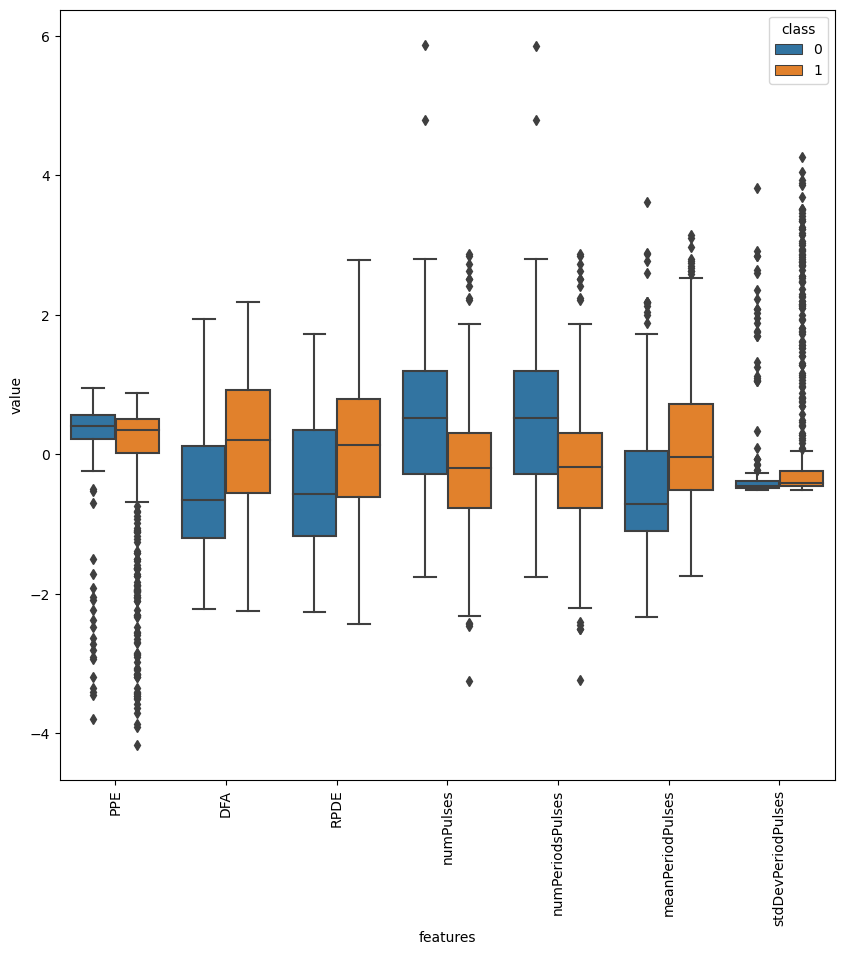

In [247]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'locShimmer'),
  Text(1, 0, 'locDbShimmer'),
  Text(2, 0, 'apq3Shimmer'),
  Text(3, 0, 'apq5Shimmer'),
  Text(4, 0, 'apq11Shimmer'),
  Text(5, 0, 'ddaShimmer')])

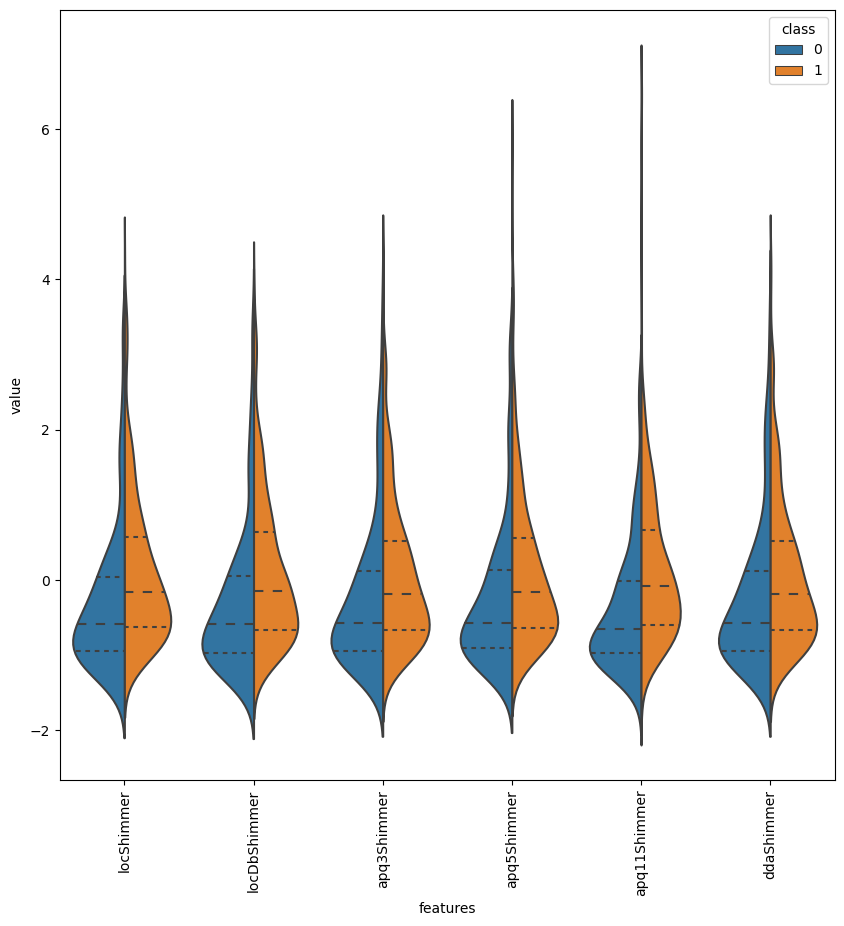

In [248]:
y= df['class']
data_dia = df['class']
data =  df_BL.iloc[:, 14:20]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'locShimmer'),
  Text(1, 0, 'locDbShimmer'),
  Text(2, 0, 'apq3Shimmer'),
  Text(3, 0, 'apq5Shimmer'),
  Text(4, 0, 'apq11Shimmer'),
  Text(5, 0, 'ddaShimmer')])

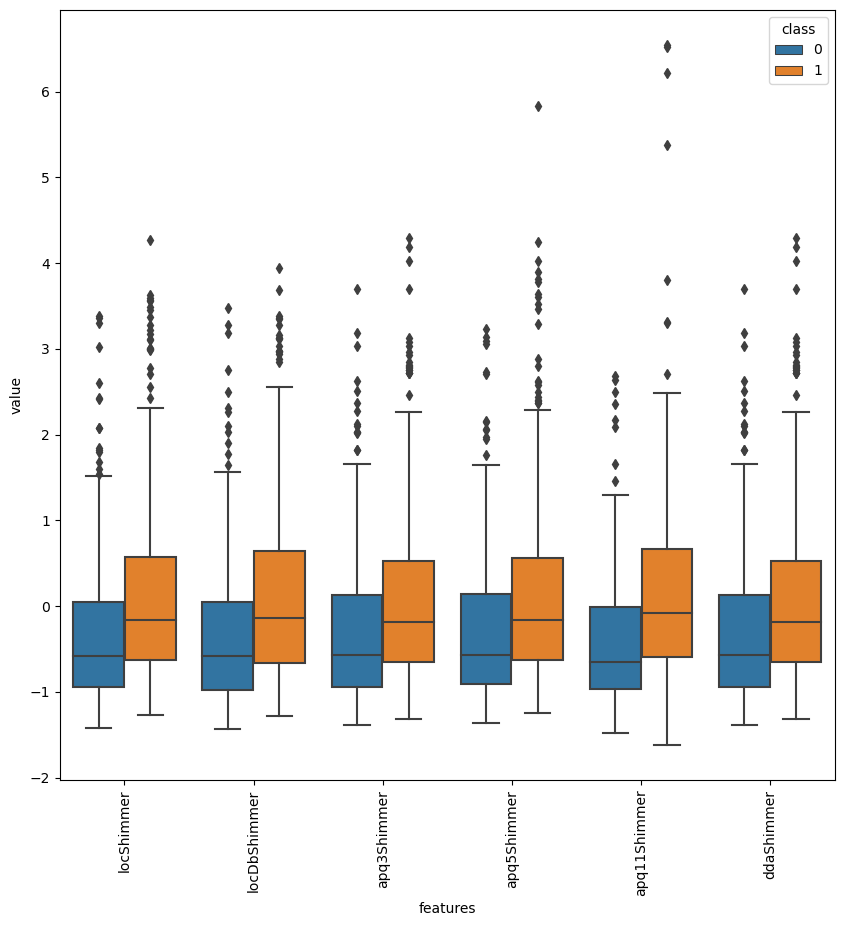

In [249]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4],
 [Text(0, 0, 'locPctJitter'),
  Text(1, 0, 'locAbsJitter'),
  Text(2, 0, 'rapJitter'),
  Text(3, 0, 'ppq5Jitter'),
  Text(4, 0, 'ddpJitter')])

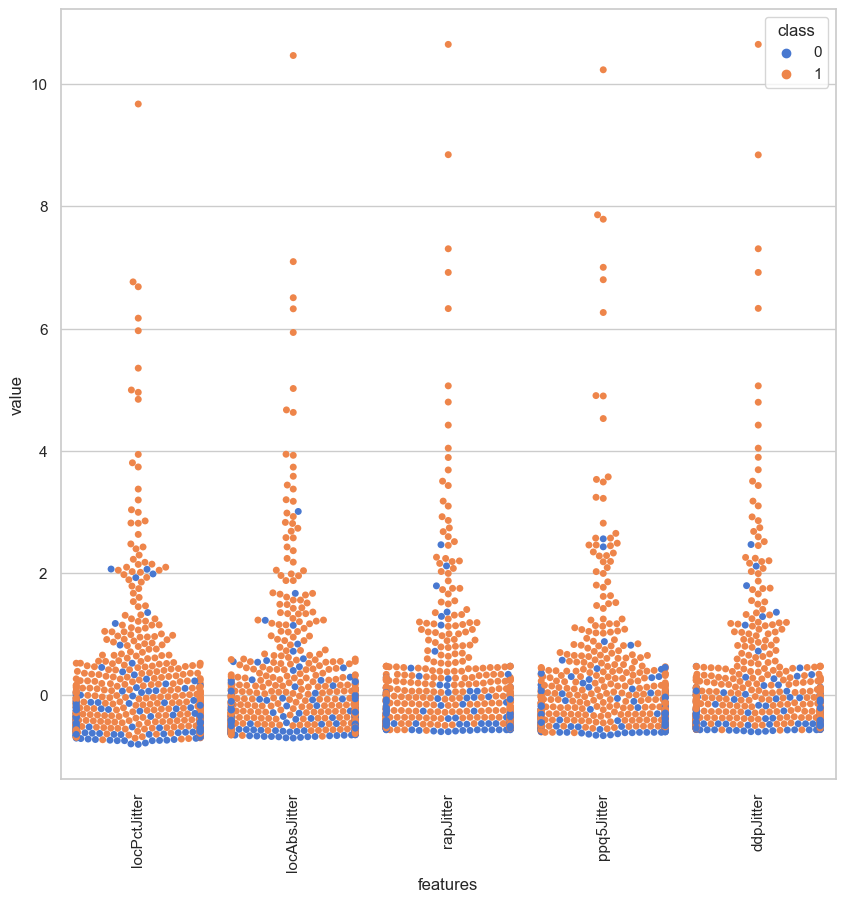

In [97]:
sns.set(style="whitegrid", palette="muted")
data_dia = df['class']
data =  df.iloc[:, 9:14]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')

plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

([0, 1, 2, 3, 4, 5],
 [Text(0, 0, 'locShimmer'),
  Text(1, 0, 'locDbShimmer'),
  Text(2, 0, 'apq3Shimmer'),
  Text(3, 0, 'apq5Shimmer'),
  Text(4, 0, 'apq11Shimmer'),
  Text(5, 0, 'ddaShimmer')])

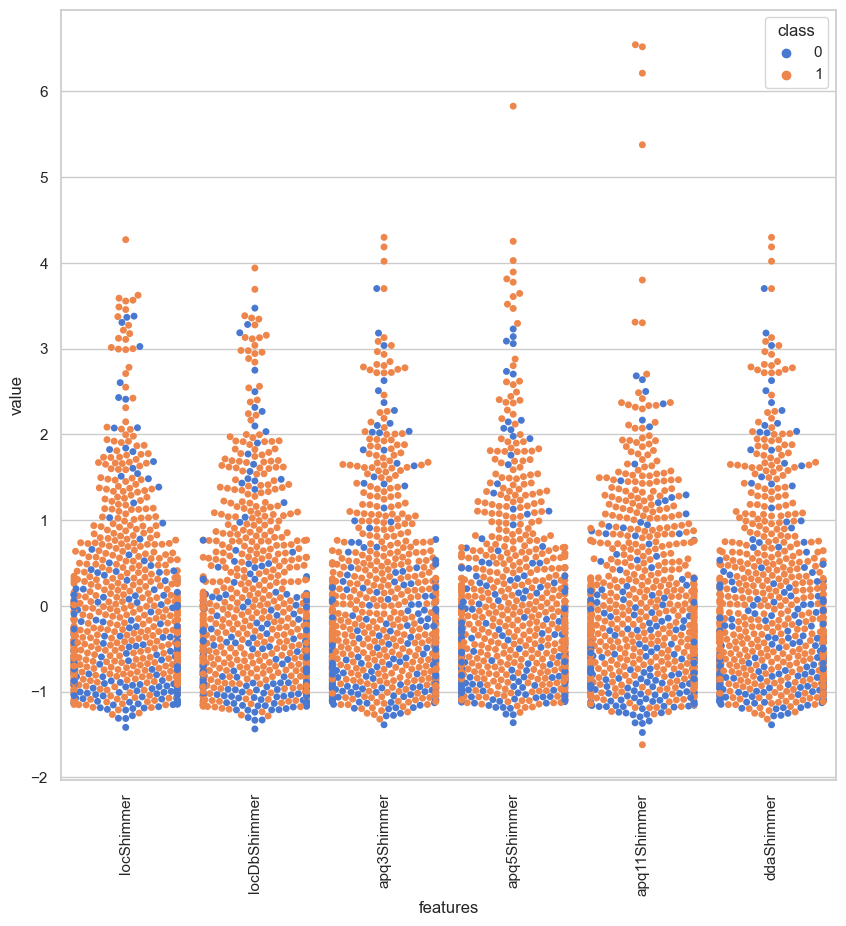

In [98]:
sns.set(style="whitegrid", palette="muted")
data_dia = df['class']
data =  df.iloc[:, 14:20]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

## Time Frequency Features

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 [Text(0, 0, 'minIntensity'),
  Text(1, 0, 'maxIntensity'),
  Text(2, 0, 'meanIntensity'),
  Text(3, 0, 'f1'),
  Text(4, 0, 'f2'),
  Text(5, 0, 'f3'),
  Text(6, 0, 'f4'),
  Text(7, 0, 'b1'),
  Text(8, 0, 'b2'),
  Text(9, 0, 'b3'),
  Text(10, 0, 'b4')])

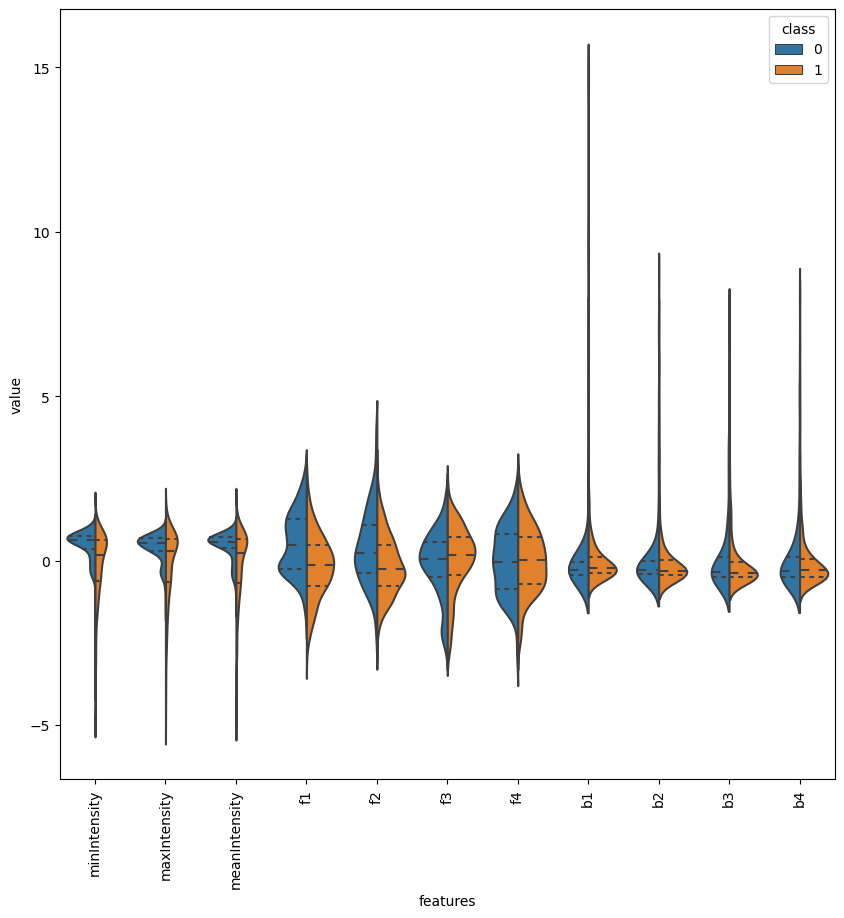

In [256]:
y= df['class']
data_dia = df['class']
data =  df_TFF
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 [Text(0, 0, 'minIntensity'),
  Text(1, 0, 'maxIntensity'),
  Text(2, 0, 'meanIntensity'),
  Text(3, 0, 'f1'),
  Text(4, 0, 'f2'),
  Text(5, 0, 'f3'),
  Text(6, 0, 'f4'),
  Text(7, 0, 'b1'),
  Text(8, 0, 'b2'),
  Text(9, 0, 'b3'),
  Text(10, 0, 'b4')])

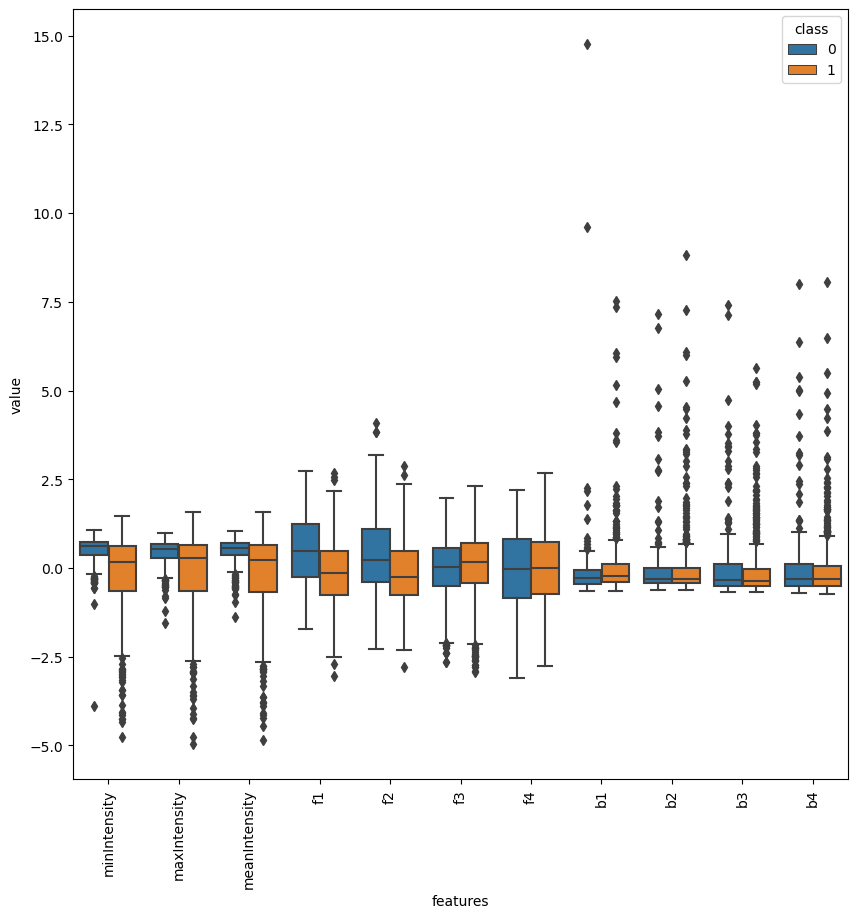

In [257]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
 [Text(0, 0, 'minIntensity'),
  Text(1, 0, 'maxIntensity'),
  Text(2, 0, 'meanIntensity'),
  Text(3, 0, 'f1'),
  Text(4, 0, 'f2'),
  Text(5, 0, 'f3'),
  Text(6, 0, 'f4'),
  Text(7, 0, 'b1'),
  Text(8, 0, 'b2'),
  Text(9, 0, 'b3'),
  Text(10, 0, 'b4')])

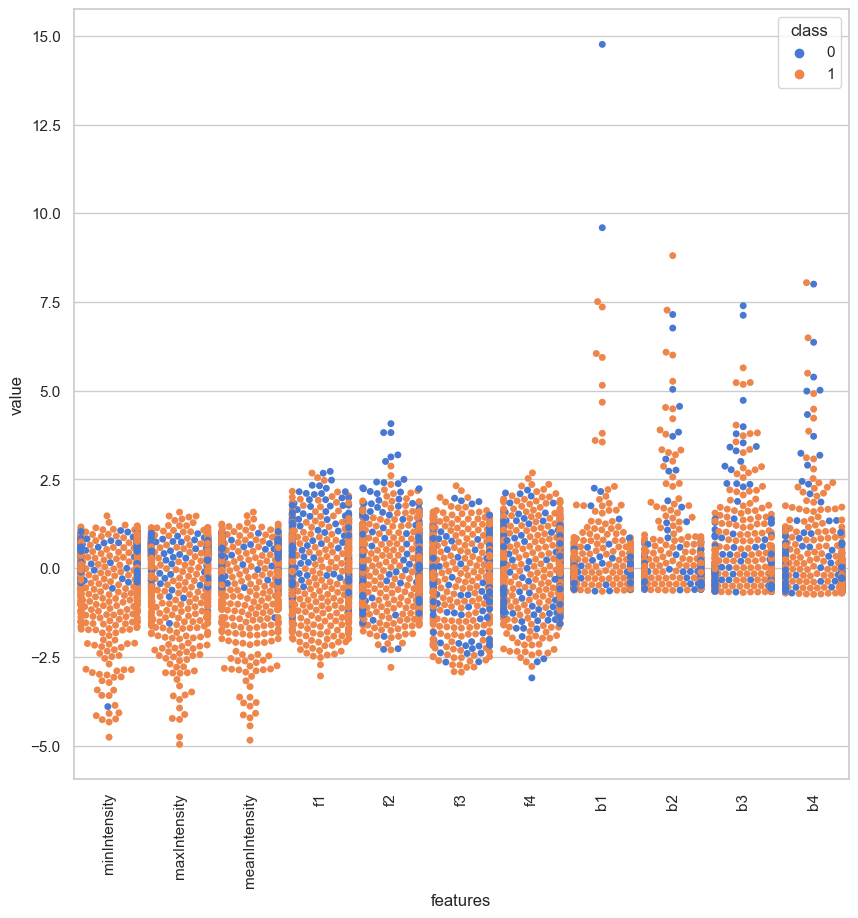

In [101]:
sns.set(style="whitegrid", palette="muted")
data_dia = df['class']
data =  df_TFF
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

## MFCC Features

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, 'mean_MFCC_0th_coef'),
  Text(1, 0, 'mean_MFCC_1st_coef'),
  Text(2, 0, 'mean_MFCC_2nd_coef'),
  Text(3, 0, 'mean_MFCC_3rd_coef'),
  Text(4, 0, 'mean_MFCC_4th_coef'),
  Text(5, 0, 'mean_MFCC_5th_coef'),
  Text(6, 0, 'mean_MFCC_6th_coef'),
  Text(7, 0, 'mean_MFCC_7th_coef'),
  Text(8, 0, 'mean_MFCC_8th_coef'),
  Text(9, 0, 'mean_MFCC_9th_coef'),
  Text(10, 0, 'mean_MFCC_10th_coef'),
  Text(11, 0, 'mean_MFCC_11th_coef'),
  Text(12, 0, 'mean_MFCC_12th_coef')])

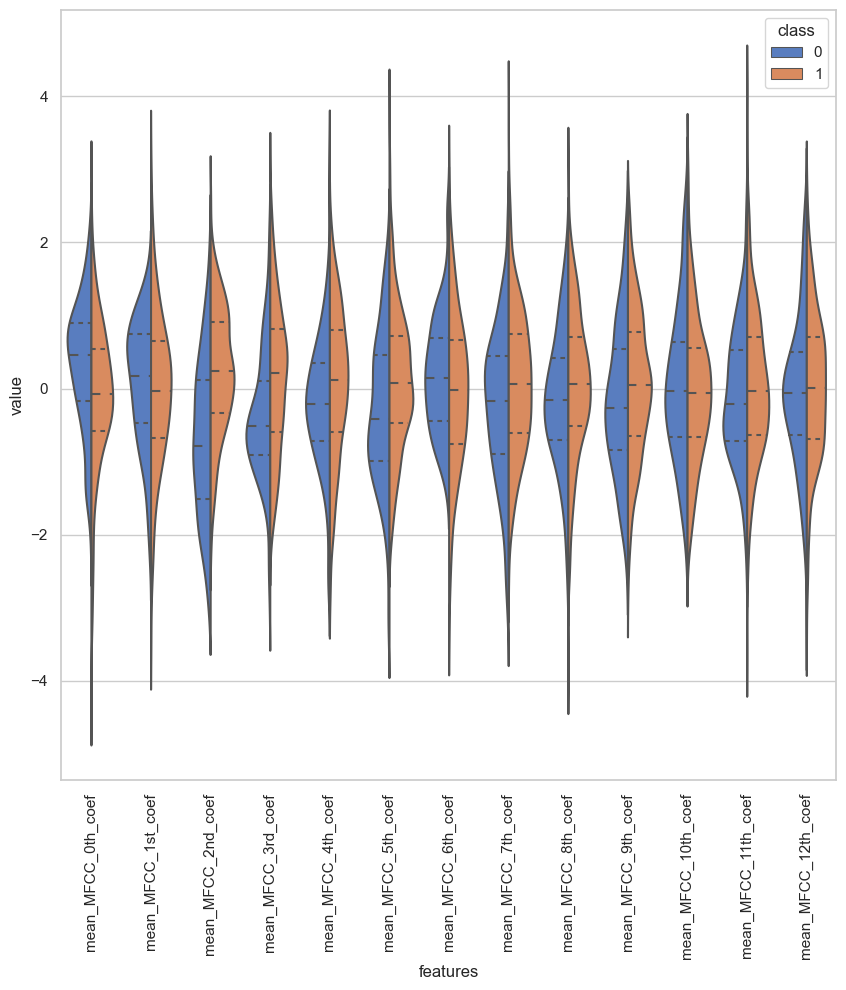

In [114]:
y= df['class']
data_dia = df['class']
data =  df_MFCC.iloc[:,:13]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, 'mean_MFCC_0th_coef'),
  Text(1, 0, 'mean_MFCC_1st_coef'),
  Text(2, 0, 'mean_MFCC_2nd_coef'),
  Text(3, 0, 'mean_MFCC_3rd_coef'),
  Text(4, 0, 'mean_MFCC_4th_coef'),
  Text(5, 0, 'mean_MFCC_5th_coef'),
  Text(6, 0, 'mean_MFCC_6th_coef'),
  Text(7, 0, 'mean_MFCC_7th_coef'),
  Text(8, 0, 'mean_MFCC_8th_coef'),
  Text(9, 0, 'mean_MFCC_9th_coef'),
  Text(10, 0, 'mean_MFCC_10th_coef'),
  Text(11, 0, 'mean_MFCC_11th_coef'),
  Text(12, 0, 'mean_MFCC_12th_coef')])

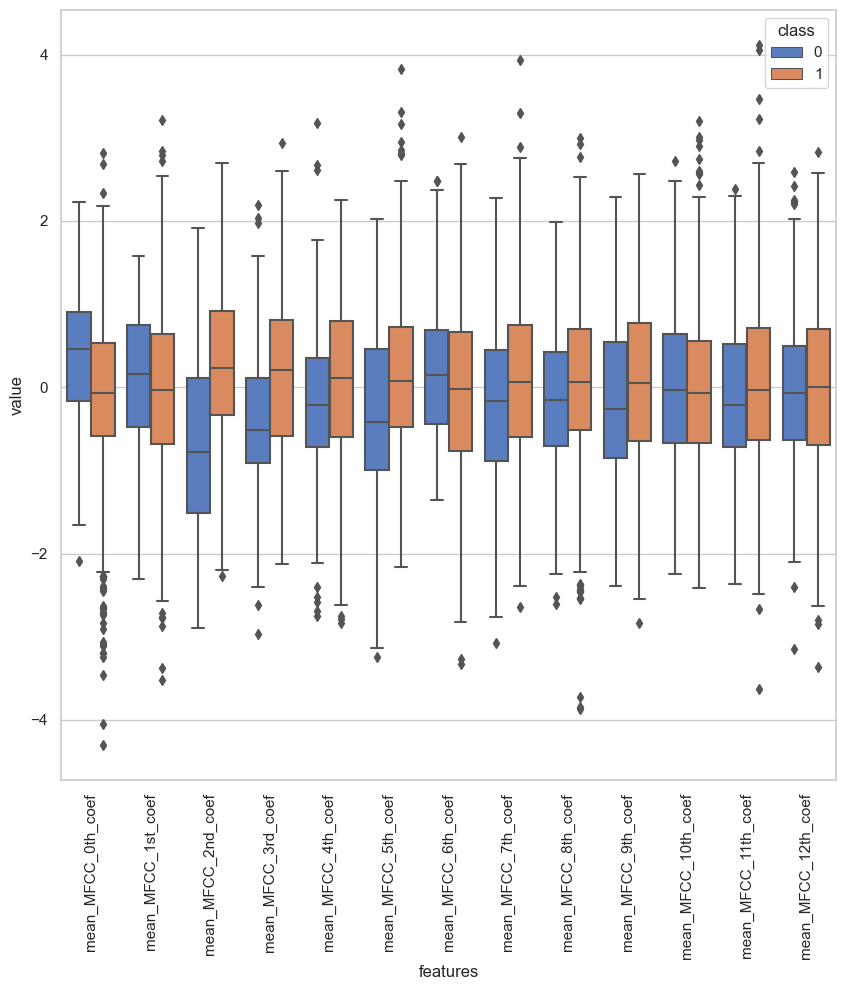

In [115]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
 [Text(0, 0, 'mean_MFCC_0th_coef'),
  Text(1, 0, 'mean_MFCC_1st_coef'),
  Text(2, 0, 'mean_MFCC_2nd_coef'),
  Text(3, 0, 'mean_MFCC_3rd_coef'),
  Text(4, 0, 'mean_MFCC_4th_coef'),
  Text(5, 0, 'mean_MFCC_5th_coef'),
  Text(6, 0, 'mean_MFCC_6th_coef'),
  Text(7, 0, 'mean_MFCC_7th_coef'),
  Text(8, 0, 'mean_MFCC_8th_coef'),
  Text(9, 0, 'mean_MFCC_9th_coef'),
  Text(10, 0, 'mean_MFCC_10th_coef'),
  Text(11, 0, 'mean_MFCC_11th_coef'),
  Text(12, 0, 'mean_MFCC_12th_coef')])

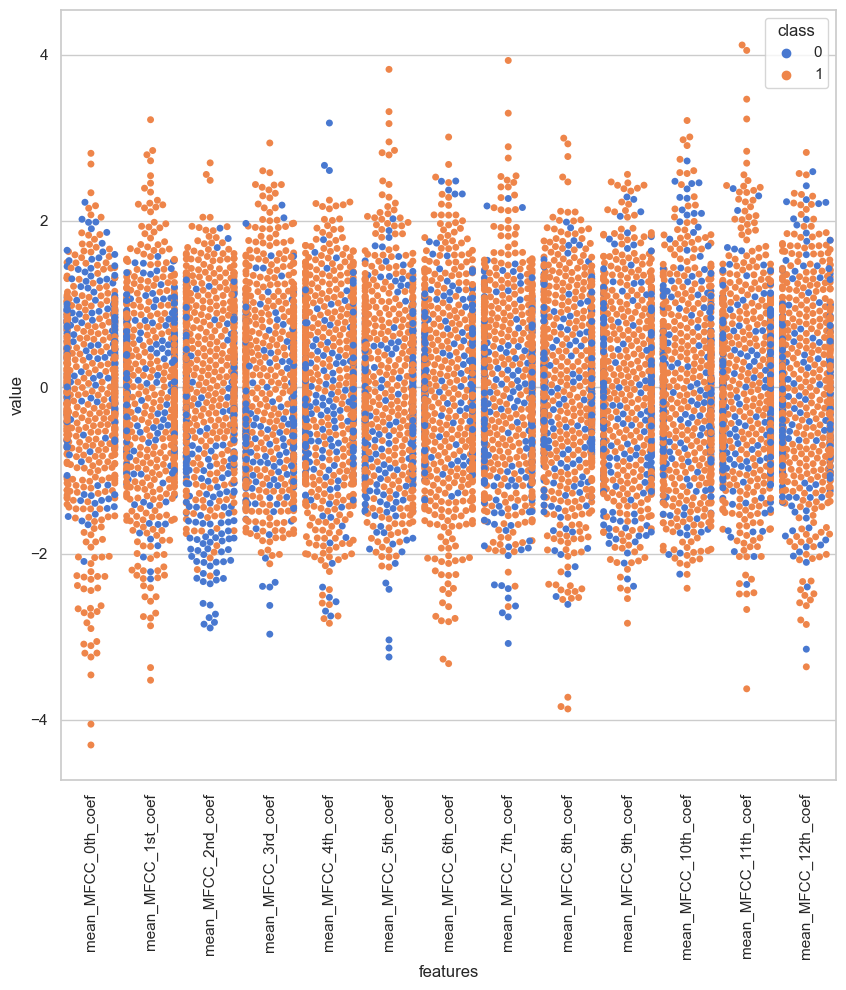

In [116]:
sns.set(style="whitegrid", palette="muted")
data_dia = df['class']
data =  df_MFCC.iloc[:,:13]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, 'std_MFCC_0th_coef'),
  Text(1, 0, 'std_MFCC_1st_coef'),
  Text(2, 0, 'std_MFCC_2nd_coef'),
  Text(3, 0, 'std_MFCC_3rd_coef'),
  Text(4, 0, 'std_MFCC_4th_coef'),
  Text(5, 0, 'std_MFCC_5th_coef'),
  Text(6, 0, 'std_MFCC_6th_coef'),
  Text(7, 0, 'std_MFCC_7th_coef'),
  Text(8, 0, 'std_MFCC_8th_coef'),
  Text(9, 0, 'std_MFCC_9th_coef'),
  Text(10, 0, 'std_MFCC_10th_coef'),
  Text(11, 0, 'std_MFCC_11th_coef'),
  Text(12, 0, 'std_MFCC_12th_coef')])

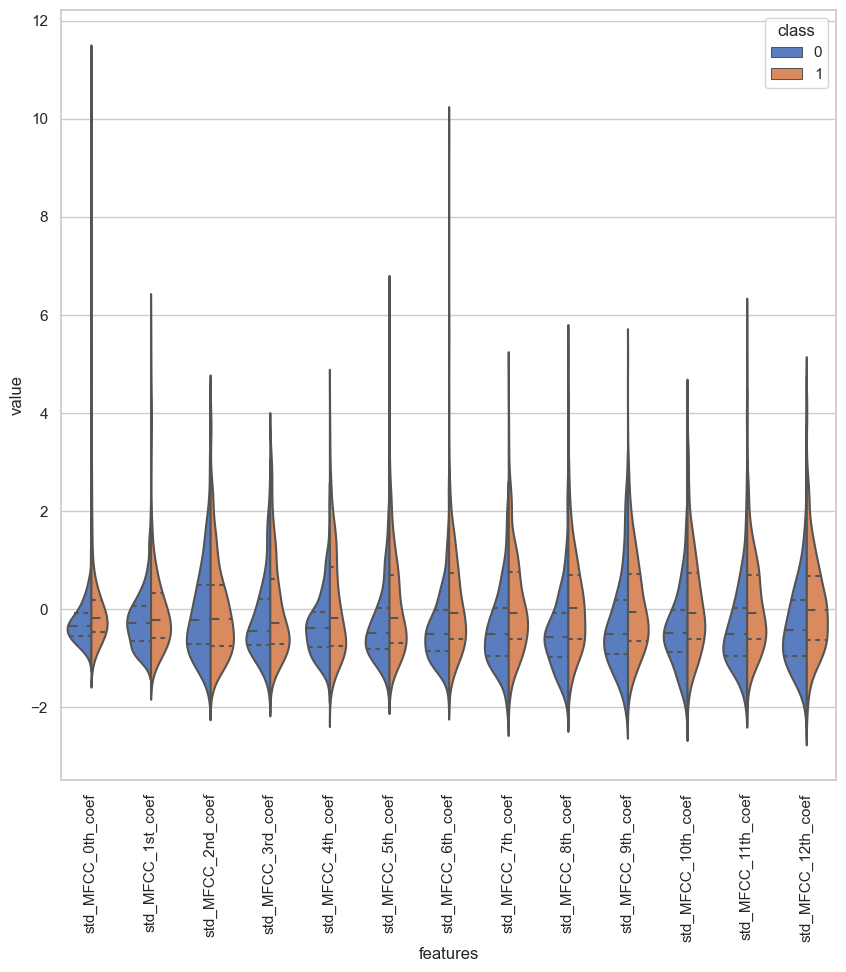

In [117]:
y= df['class']
data_dia = df['class']
data =  df_MFCC.iloc[:,42:55]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, 'std_MFCC_0th_coef'),
  Text(1, 0, 'std_MFCC_1st_coef'),
  Text(2, 0, 'std_MFCC_2nd_coef'),
  Text(3, 0, 'std_MFCC_3rd_coef'),
  Text(4, 0, 'std_MFCC_4th_coef'),
  Text(5, 0, 'std_MFCC_5th_coef'),
  Text(6, 0, 'std_MFCC_6th_coef'),
  Text(7, 0, 'std_MFCC_7th_coef'),
  Text(8, 0, 'std_MFCC_8th_coef'),
  Text(9, 0, 'std_MFCC_9th_coef'),
  Text(10, 0, 'std_MFCC_10th_coef'),
  Text(11, 0, 'std_MFCC_11th_coef'),
  Text(12, 0, 'std_MFCC_12th_coef')])

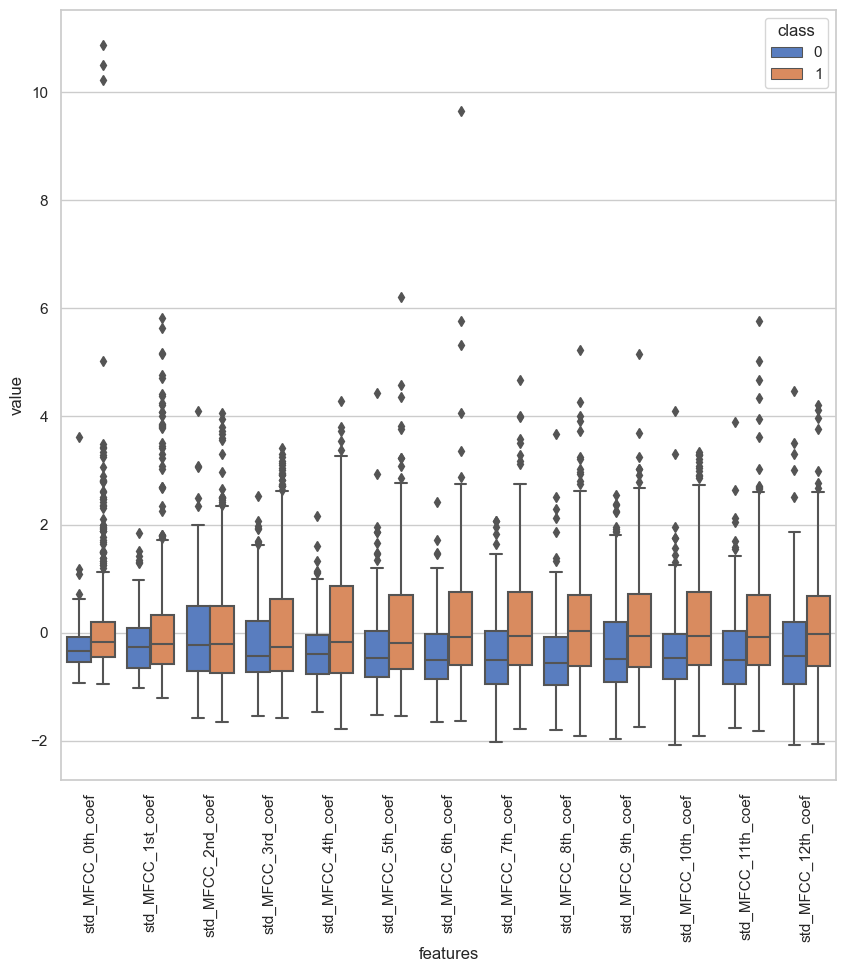

In [118]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
 [Text(0, 0, 'std_MFCC_0th_coef'),
  Text(1, 0, 'std_MFCC_1st_coef'),
  Text(2, 0, 'std_MFCC_2nd_coef'),
  Text(3, 0, 'std_MFCC_3rd_coef'),
  Text(4, 0, 'std_MFCC_4th_coef'),
  Text(5, 0, 'std_MFCC_5th_coef'),
  Text(6, 0, 'std_MFCC_6th_coef'),
  Text(7, 0, 'std_MFCC_7th_coef'),
  Text(8, 0, 'std_MFCC_8th_coef'),
  Text(9, 0, 'std_MFCC_9th_coef'),
  Text(10, 0, 'std_MFCC_10th_coef'),
  Text(11, 0, 'std_MFCC_11th_coef'),
  Text(12, 0, 'std_MFCC_12th_coef')])

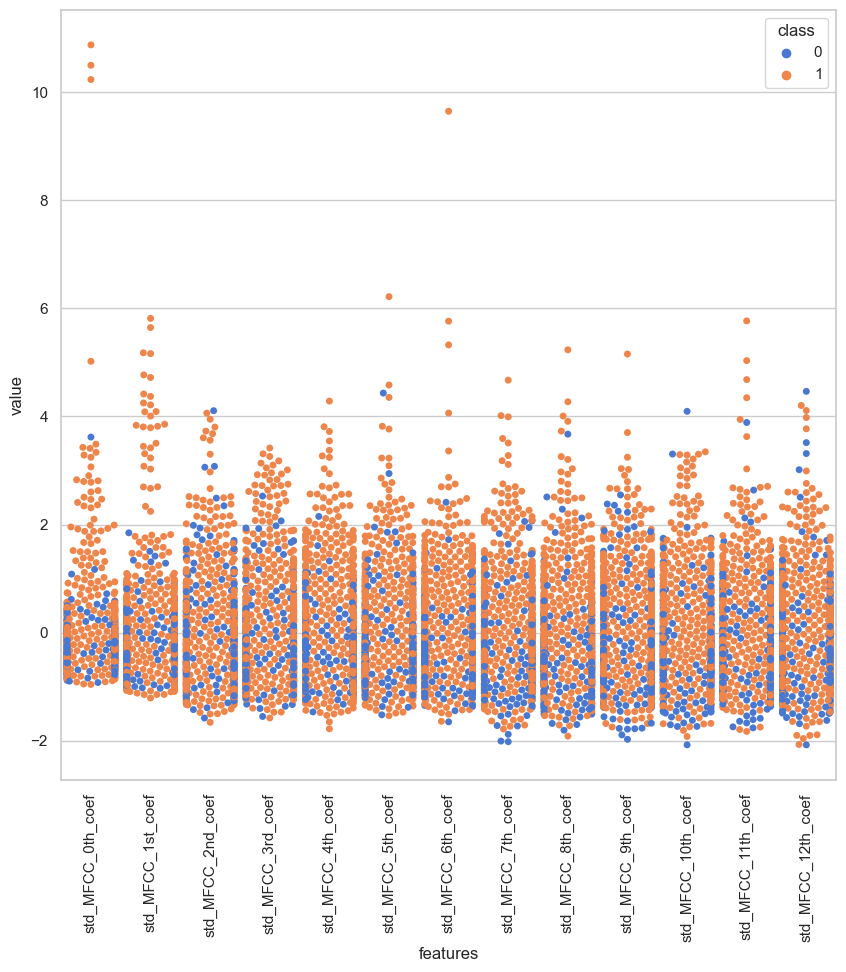

In [119]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

## Wavelet Transform Features

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'app_entropy_shannon_1_coef'),
  Text(1, 0, 'app_entropy_shannon_2_coef'),
  Text(2, 0, 'app_entropy_shannon_3_coef'),
  Text(3, 0, 'app_entropy_shannon_4_coef'),
  Text(4, 0, 'app_entropy_shannon_5_coef'),
  Text(5, 0, 'app_entropy_shannon_6_coef'),
  Text(6, 0, 'app_entropy_shannon_7_coef'),
  Text(7, 0, 'app_entropy_shannon_8_coef'),
  Text(8, 0, 'app_entropy_shannon_9_coef'),
  Text(9, 0, 'app_entropy_shannon_10_coef')])

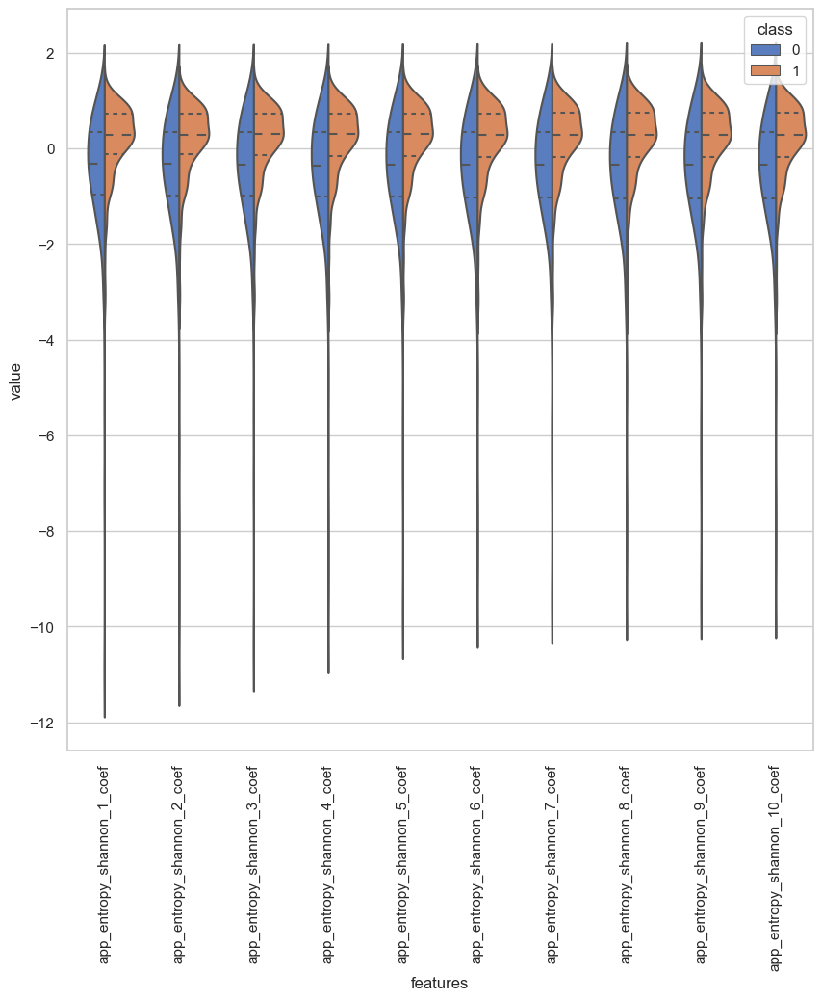

In [138]:
y= df['class']
data_dia = df['class']
x=51
data =  df_WT.iloc[:,x:x+10]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'app_entropy_shannon_1_coef'),
  Text(1, 0, 'app_entropy_shannon_2_coef'),
  Text(2, 0, 'app_entropy_shannon_3_coef'),
  Text(3, 0, 'app_entropy_shannon_4_coef'),
  Text(4, 0, 'app_entropy_shannon_5_coef'),
  Text(5, 0, 'app_entropy_shannon_6_coef'),
  Text(6, 0, 'app_entropy_shannon_7_coef'),
  Text(7, 0, 'app_entropy_shannon_8_coef'),
  Text(8, 0, 'app_entropy_shannon_9_coef'),
  Text(9, 0, 'app_entropy_shannon_10_coef')])

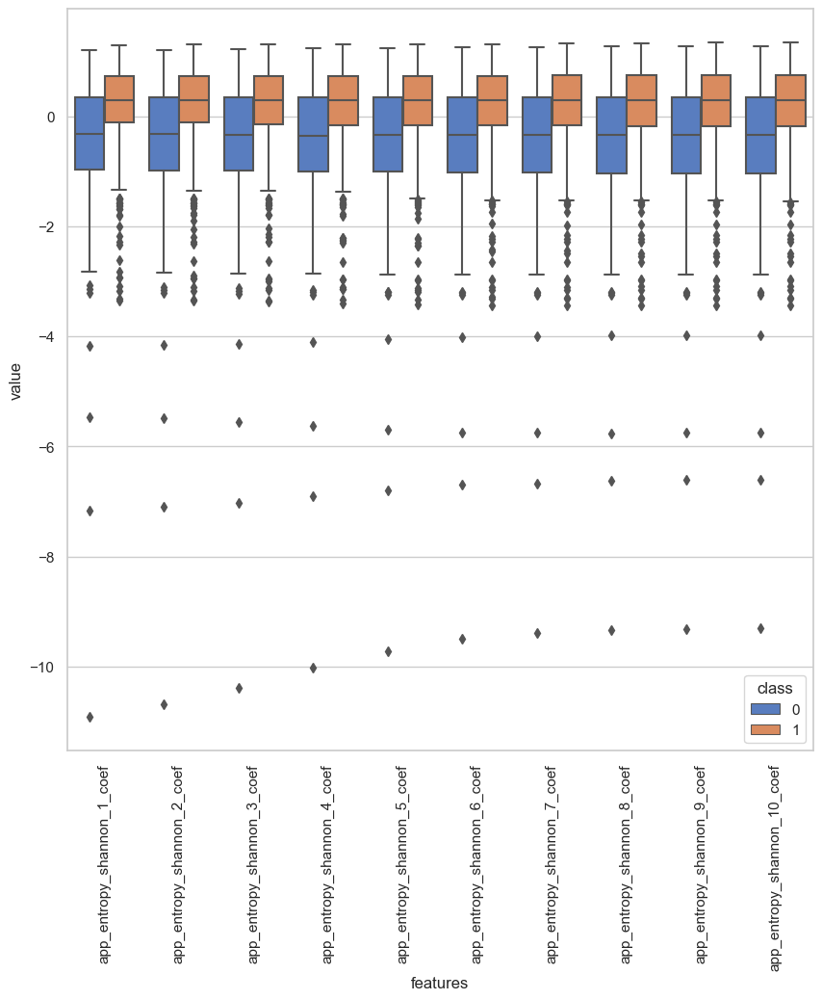

In [139]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
 [Text(0, 0, 'app_entropy_shannon_1_coef'),
  Text(1, 0, 'app_entropy_shannon_2_coef'),
  Text(2, 0, 'app_entropy_shannon_3_coef'),
  Text(3, 0, 'app_entropy_shannon_4_coef'),
  Text(4, 0, 'app_entropy_shannon_5_coef'),
  Text(5, 0, 'app_entropy_shannon_6_coef'),
  Text(6, 0, 'app_entropy_shannon_7_coef'),
  Text(7, 0, 'app_entropy_shannon_8_coef'),
  Text(8, 0, 'app_entropy_shannon_9_coef'),
  Text(9, 0, 'app_entropy_shannon_10_coef')])

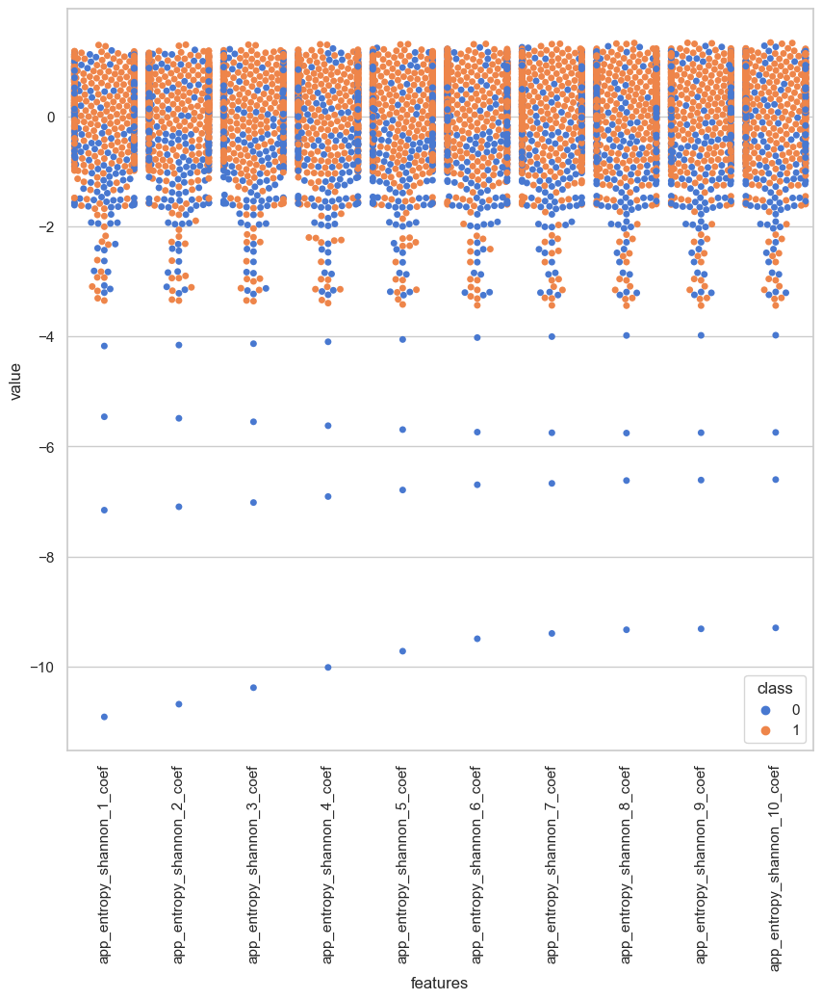

In [140]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'app_entropy_log_1_coef'),
  Text(1, 0, 'app_entropy_log_2_coef'),
  Text(2, 0, 'app_entropy_log_3_coef'),
  Text(3, 0, 'app_entropy_log_4_coef'),
  Text(4, 0, 'app_entropy_log_5_coef'),
  Text(5, 0, 'app_entropy_log_6_coef'),
  Text(6, 0, 'app_entropy_log_7_coef'),
  Text(7, 0, 'app_entropy_log_8_coef'),
  Text(8, 0, 'app_entropy_log_9_coef'),
  Text(9, 0, 'app_entropy_log_10_coef')])

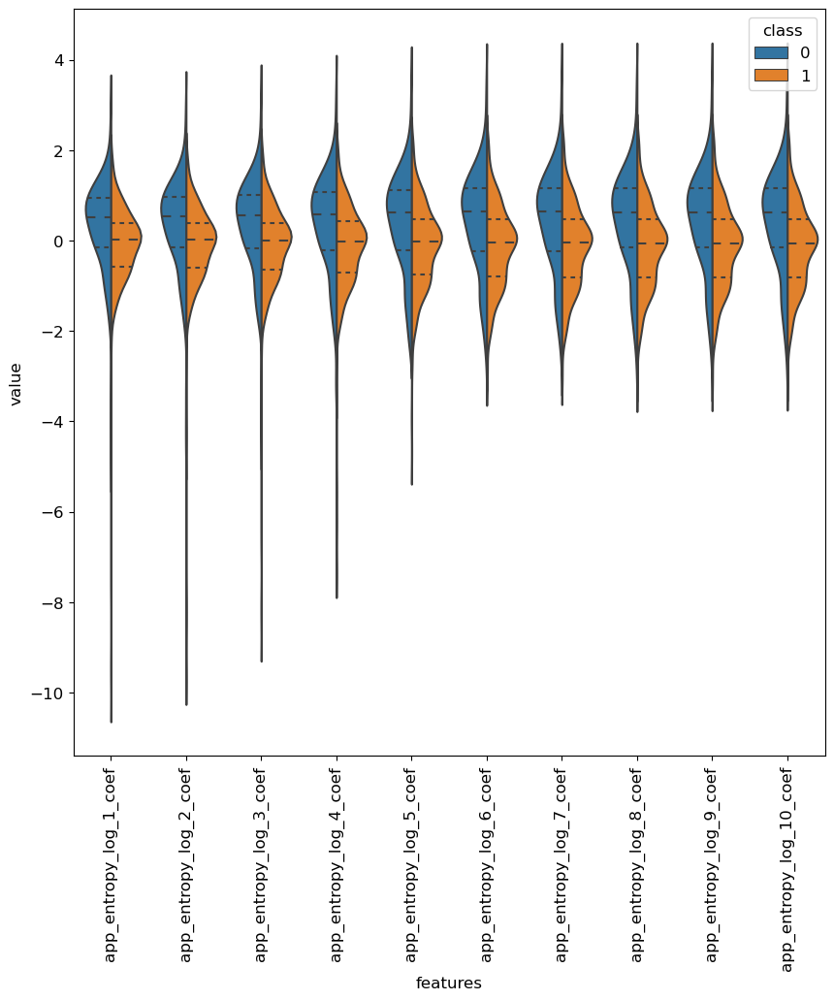

In [744]:
y= df['class']
data_dia = df['class']
x=61
data =  df_WT.iloc[:,x:x+10]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'app_entropy_log_1_coef'),
  Text(1, 0, 'app_entropy_log_2_coef'),
  Text(2, 0, 'app_entropy_log_3_coef'),
  Text(3, 0, 'app_entropy_log_4_coef'),
  Text(4, 0, 'app_entropy_log_5_coef'),
  Text(5, 0, 'app_entropy_log_6_coef'),
  Text(6, 0, 'app_entropy_log_7_coef'),
  Text(7, 0, 'app_entropy_log_8_coef'),
  Text(8, 0, 'app_entropy_log_9_coef'),
  Text(9, 0, 'app_entropy_log_10_coef')])

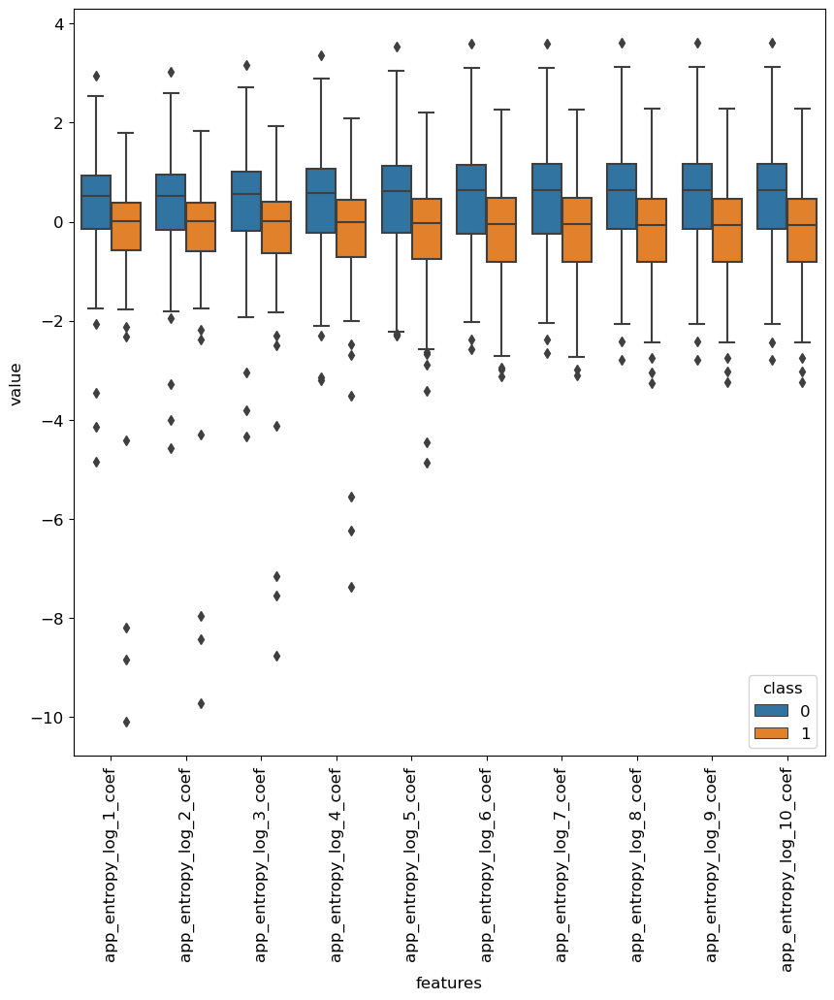

In [745]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
 [Text(0, 0, 'app_entropy_log_1_coef'),
  Text(1, 0, 'app_entropy_log_2_coef'),
  Text(2, 0, 'app_entropy_log_3_coef'),
  Text(3, 0, 'app_entropy_log_4_coef'),
  Text(4, 0, 'app_entropy_log_5_coef'),
  Text(5, 0, 'app_entropy_log_6_coef'),
  Text(6, 0, 'app_entropy_log_7_coef'),
  Text(7, 0, 'app_entropy_log_8_coef'),
  Text(8, 0, 'app_entropy_log_9_coef'),
  Text(9, 0, 'app_entropy_log_10_coef')])

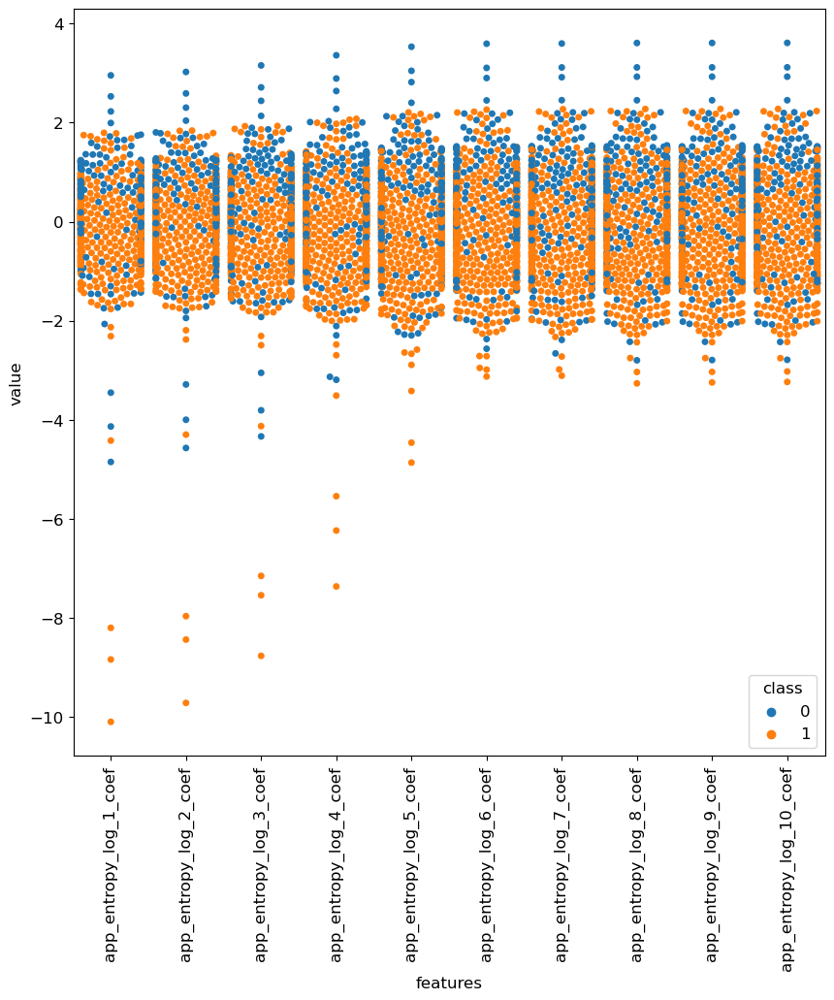

In [746]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'app_TKEO_std_1_coef'),
  Text(1, 0, 'app_TKEO_std_2_coef'),
  Text(2, 0, 'app_TKEO_std_3_coef'),
  Text(3, 0, 'app_TKEO_std_4_coef'),
  Text(4, 0, 'app_TKEO_std_5_coef'),
  Text(5, 0, 'app_TKEO_std_6_coef'),
  Text(6, 0, 'app_TKEO_std_7_coef'),
  Text(7, 0, 'app_TKEO_std_8_coef'),
  Text(8, 0, 'app_TKEO_std_9_coef'),
  Text(9, 0, 'app_TKEO_std_10_coef')])

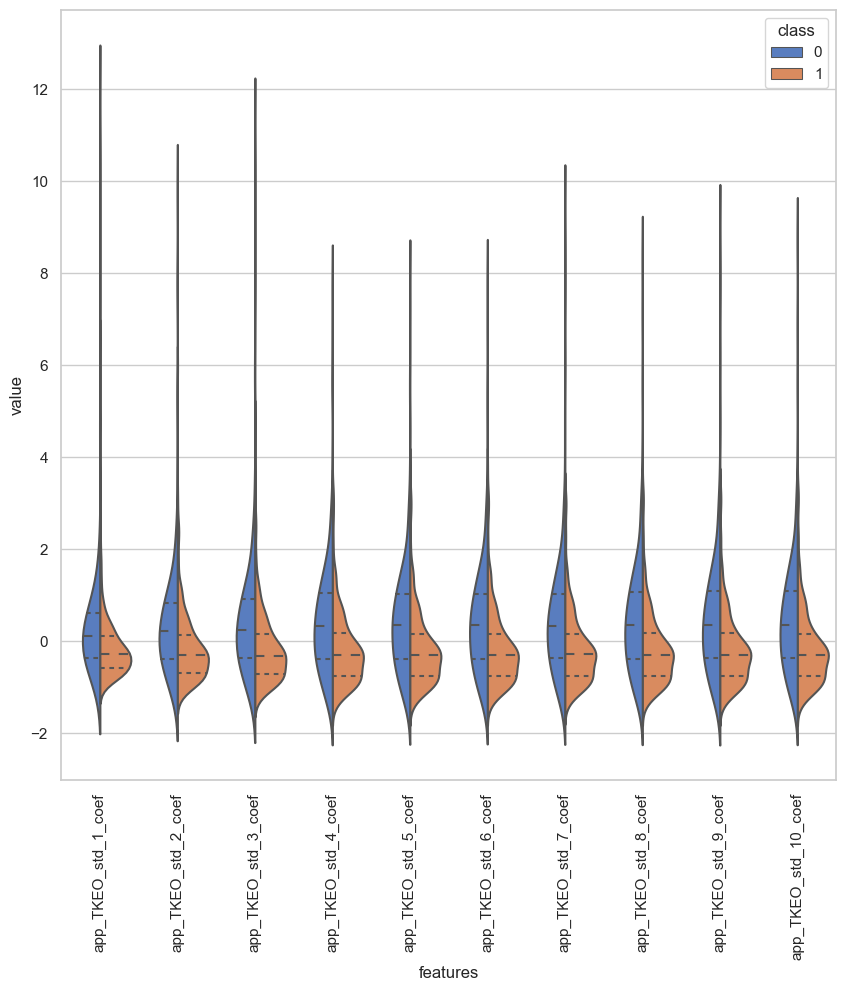

In [160]:
y= df['class']
data_dia = df['class']
x=81
data =  df_WT.iloc[:,x:x+10]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'app_TKEO_std_1_coef'),
  Text(1, 0, 'app_TKEO_std_2_coef'),
  Text(2, 0, 'app_TKEO_std_3_coef'),
  Text(3, 0, 'app_TKEO_std_4_coef'),
  Text(4, 0, 'app_TKEO_std_5_coef'),
  Text(5, 0, 'app_TKEO_std_6_coef'),
  Text(6, 0, 'app_TKEO_std_7_coef'),
  Text(7, 0, 'app_TKEO_std_8_coef'),
  Text(8, 0, 'app_TKEO_std_9_coef'),
  Text(9, 0, 'app_TKEO_std_10_coef')])

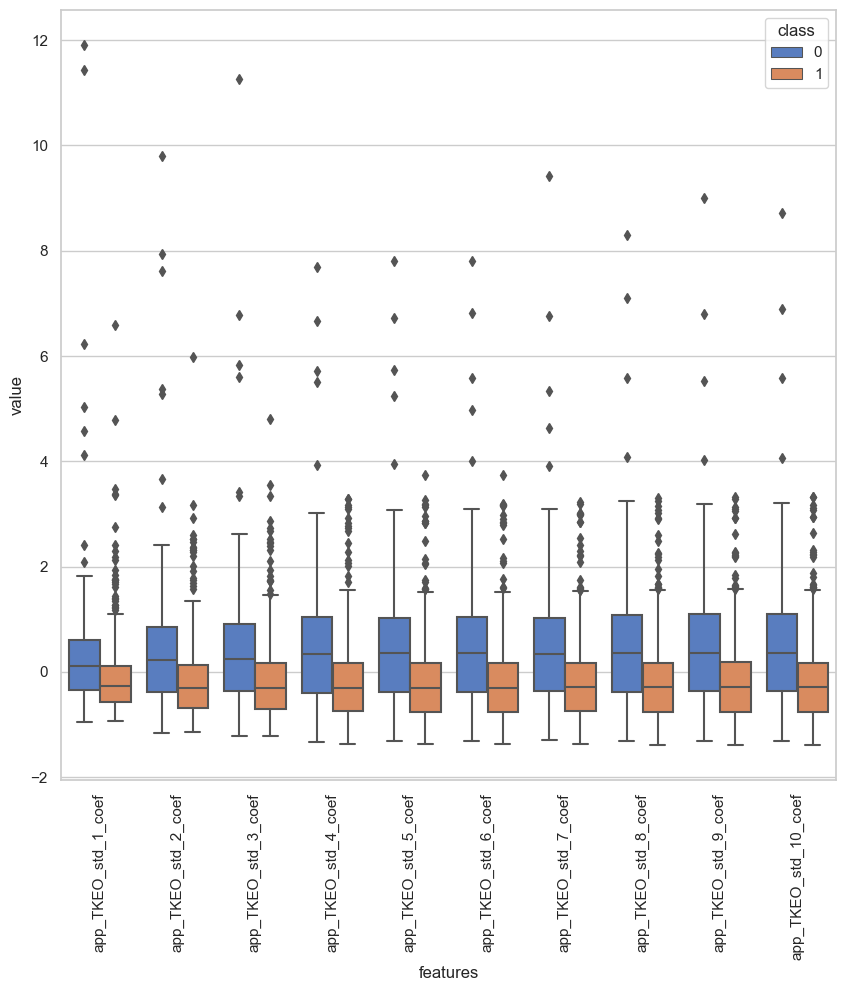

In [161]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

## Vocal Fold Features

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'VFER_mean'),
  Text(1, 0, 'VFER_std'),
  Text(2, 0, 'VFER_entropy'),
  Text(3, 0, 'VFER_SNR_TKEO'),
  Text(4, 0, 'VFER_SNR_SEO'),
  Text(5, 0, 'VFER_NSR_TKEO'),
  Text(6, 0, 'VFER_NSR_SEO')])

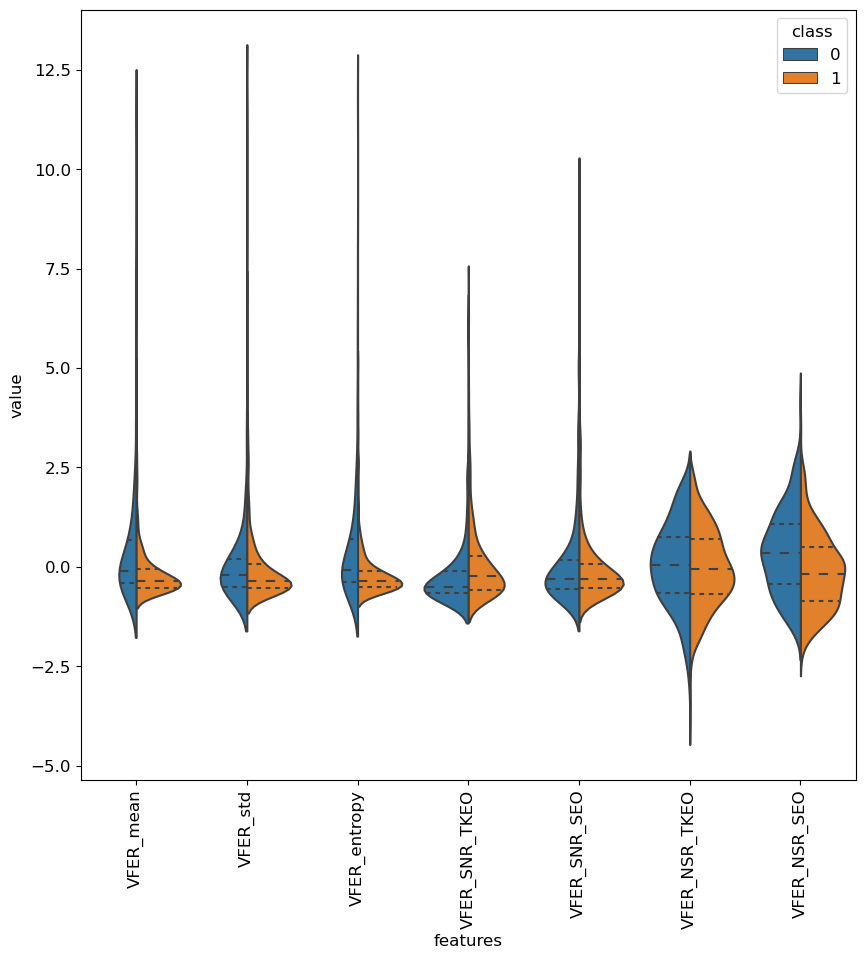

In [752]:
y= df['class']
data_dia = df['class']
data =  df_VFF.iloc[:,9:16]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'VFER_mean'),
  Text(1, 0, 'VFER_std'),
  Text(2, 0, 'VFER_entropy'),
  Text(3, 0, 'VFER_SNR_TKEO'),
  Text(4, 0, 'VFER_SNR_SEO'),
  Text(5, 0, 'VFER_NSR_TKEO'),
  Text(6, 0, 'VFER_NSR_SEO')])

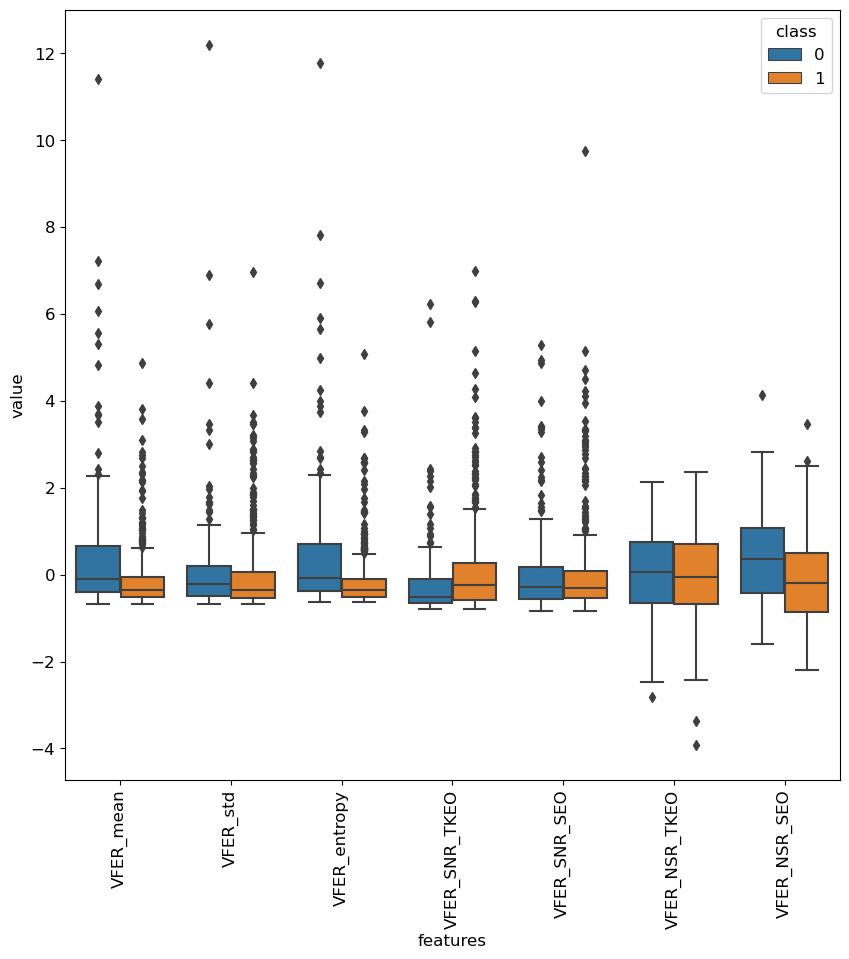

In [753]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

([0, 1, 2],
 [Text(0, 0, 'GQ_prc5_95'),
  Text(1, 0, 'GQ_std_cycle_open'),
  Text(2, 0, 'GQ_std_cycle_closed')])

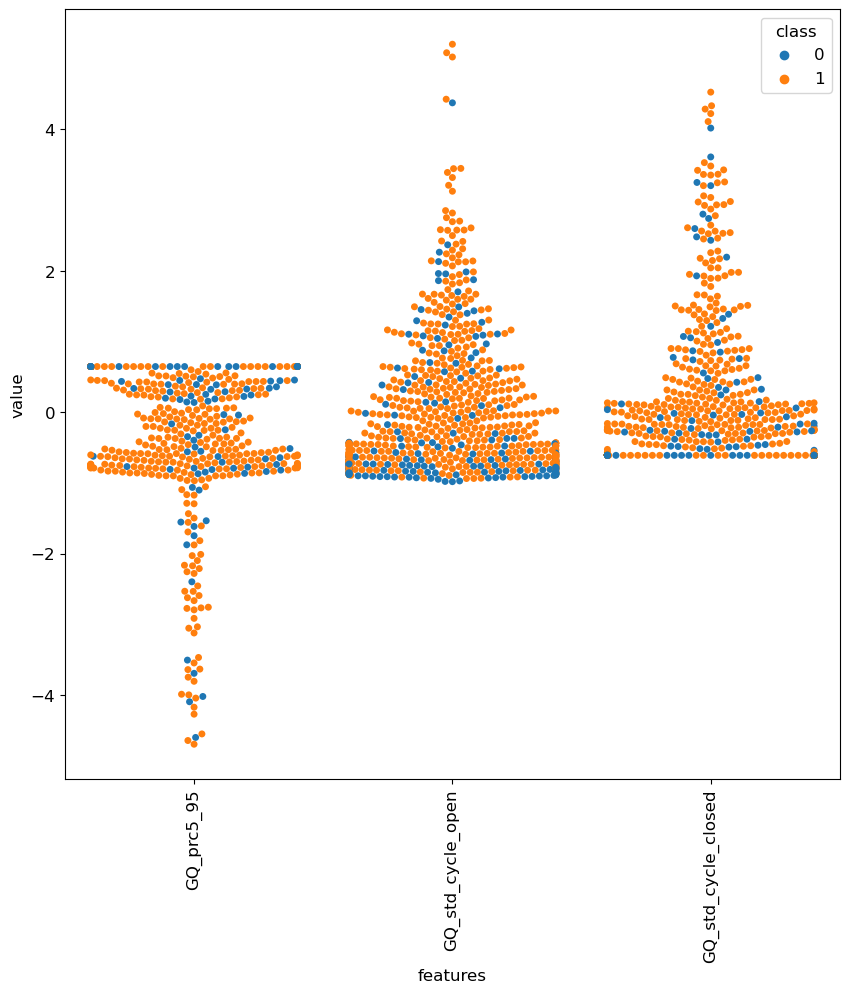

In [749]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'VFER_mean'),
  Text(1, 0, 'VFER_std'),
  Text(2, 0, 'VFER_entropy'),
  Text(3, 0, 'VFER_SNR_TKEO'),
  Text(4, 0, 'VFER_SNR_SEO'),
  Text(5, 0, 'VFER_NSR_TKEO'),
  Text(6, 0, 'VFER_NSR_SEO')])

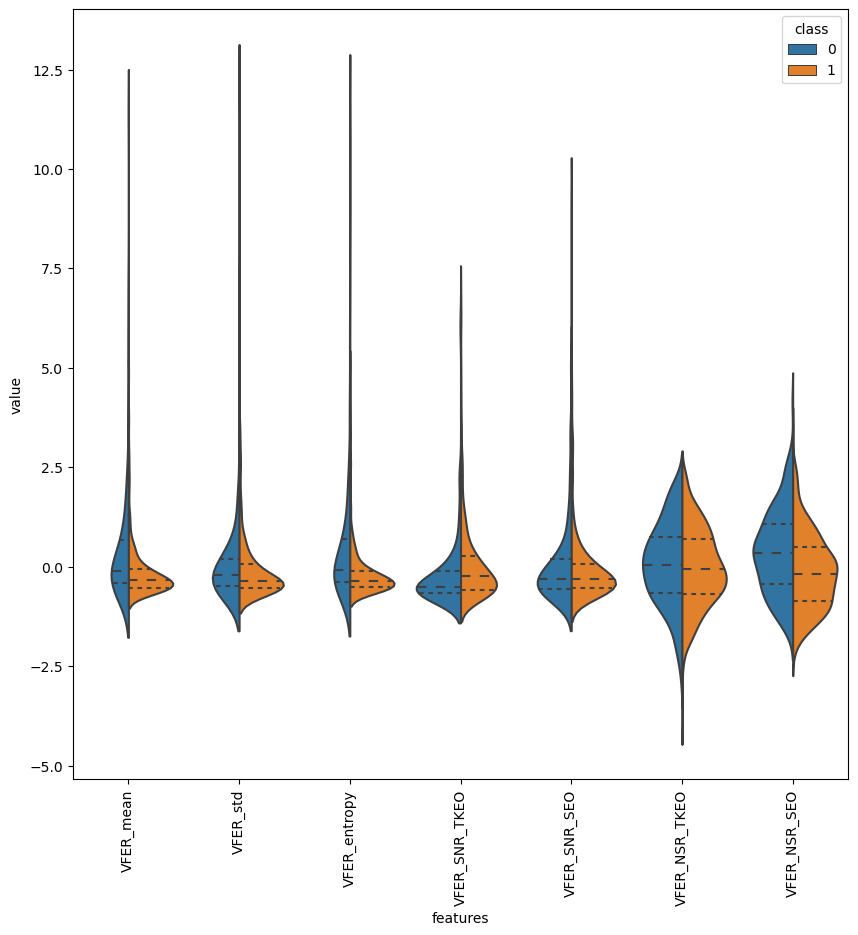

In [270]:
y= df['class']
data_dia = df['class']
data =  df_VFF.iloc[:,9:16]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6]),
 [Text(0, 0, 'VFER_mean'),
  Text(1, 0, 'VFER_std'),
  Text(2, 0, 'VFER_entropy'),
  Text(3, 0, 'VFER_SNR_TKEO'),
  Text(4, 0, 'VFER_SNR_SEO'),
  Text(5, 0, 'VFER_NSR_TKEO'),
  Text(6, 0, 'VFER_NSR_SEO')])

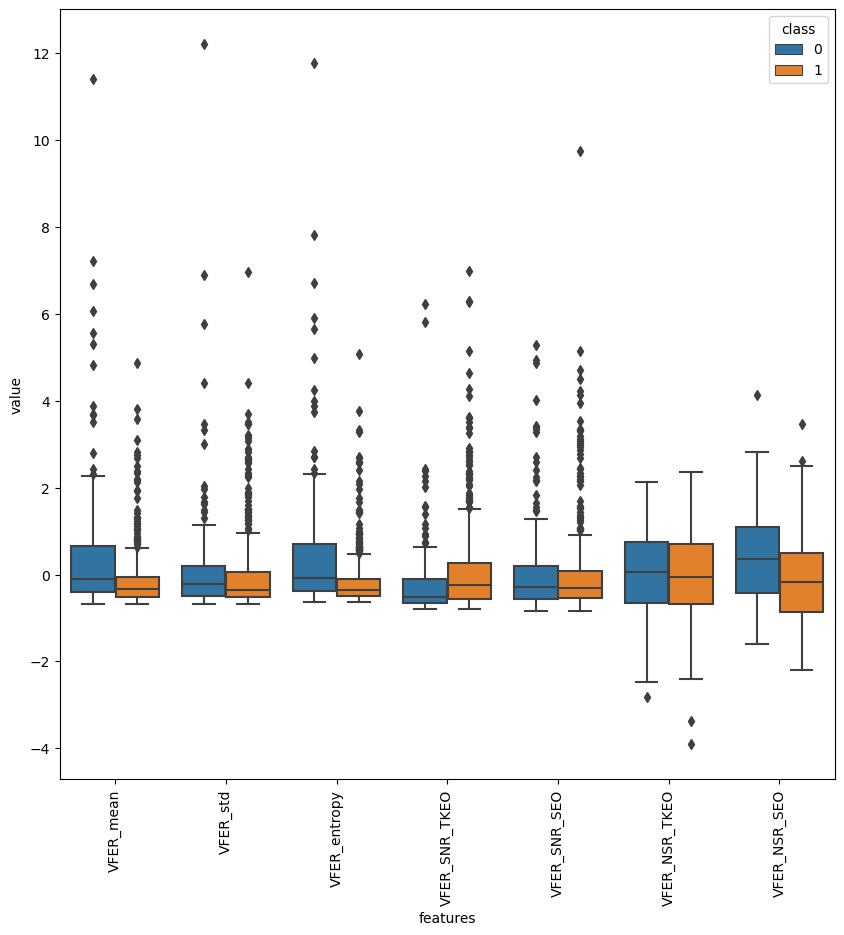

In [271]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4, 5, 6],
 [Text(0, 0, 'VFER_mean'),
  Text(1, 0, 'VFER_std'),
  Text(2, 0, 'VFER_entropy'),
  Text(3, 0, 'VFER_SNR_TKEO'),
  Text(4, 0, 'VFER_SNR_SEO'),
  Text(5, 0, 'VFER_NSR_TKEO'),
  Text(6, 0, 'VFER_NSR_SEO')])

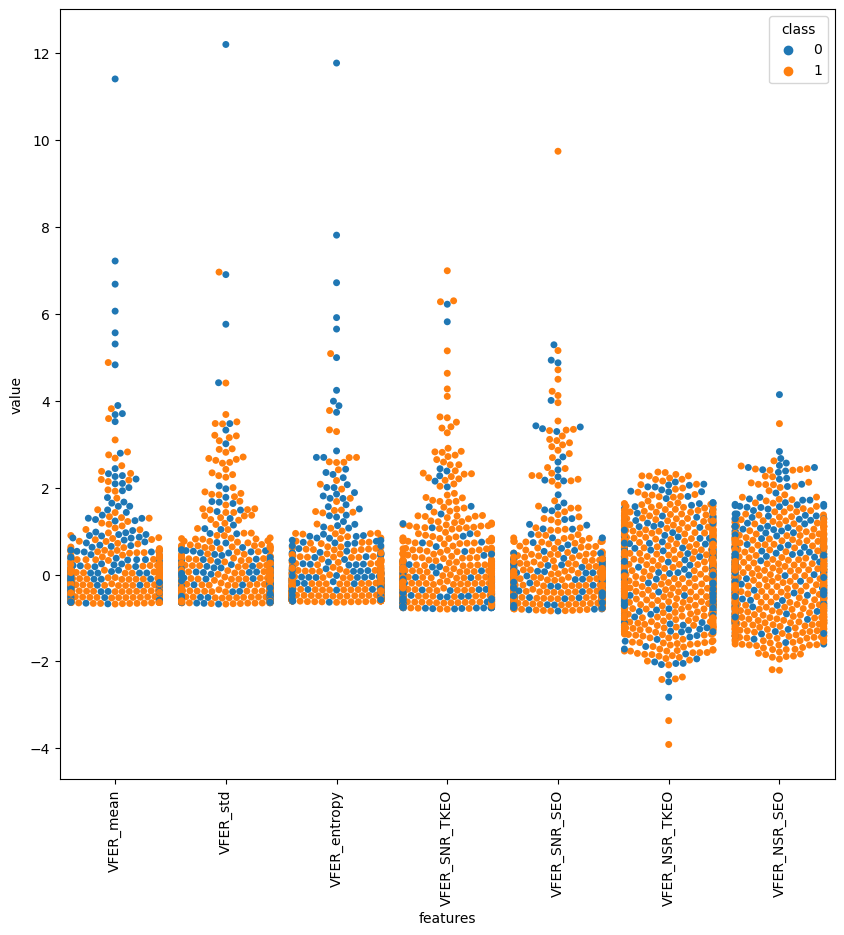

In [272]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

## TQWT Features

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_entropy_shannon_dec_1'),
  Text(1, 0, 'tqwt_entropy_shannon_dec_2'),
  Text(2, 0, 'tqwt_entropy_shannon_dec_3'),
  Text(3, 0, 'tqwt_entropy_shannon_dec_4'),
  Text(4, 0, 'tqwt_entropy_shannon_dec_5'),
  Text(5, 0, 'tqwt_entropy_shannon_dec_6'),
  Text(6, 0, 'tqwt_entropy_shannon_dec_7'),
  Text(7, 0, 'tqwt_entropy_shannon_dec_8'),
  Text(8, 0, 'tqwt_entropy_shannon_dec_9'),
  Text(9, 0, 'tqwt_entropy_shannon_dec_10')])

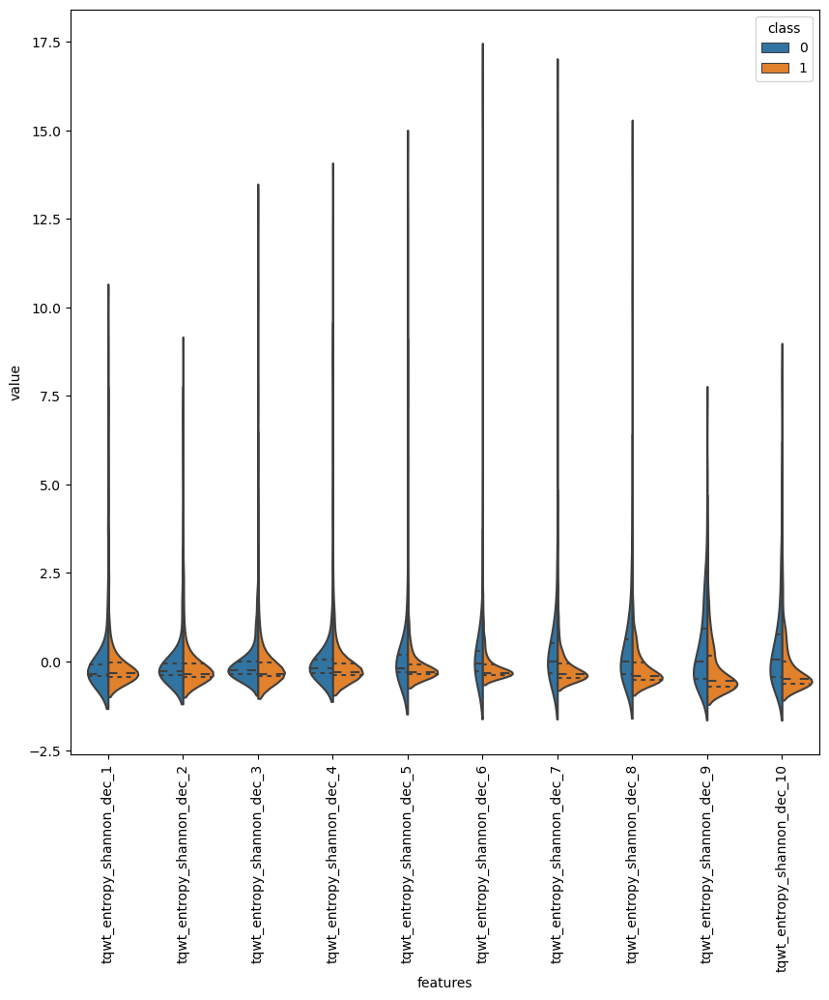

In [273]:
y= df['class']
data_dia = df['class']
x = 36
data =  df_TQWT.iloc[:,x:x+10]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_entropy_shannon_dec_1'),
  Text(1, 0, 'tqwt_entropy_shannon_dec_2'),
  Text(2, 0, 'tqwt_entropy_shannon_dec_3'),
  Text(3, 0, 'tqwt_entropy_shannon_dec_4'),
  Text(4, 0, 'tqwt_entropy_shannon_dec_5'),
  Text(5, 0, 'tqwt_entropy_shannon_dec_6'),
  Text(6, 0, 'tqwt_entropy_shannon_dec_7'),
  Text(7, 0, 'tqwt_entropy_shannon_dec_8'),
  Text(8, 0, 'tqwt_entropy_shannon_dec_9'),
  Text(9, 0, 'tqwt_entropy_shannon_dec_10')])

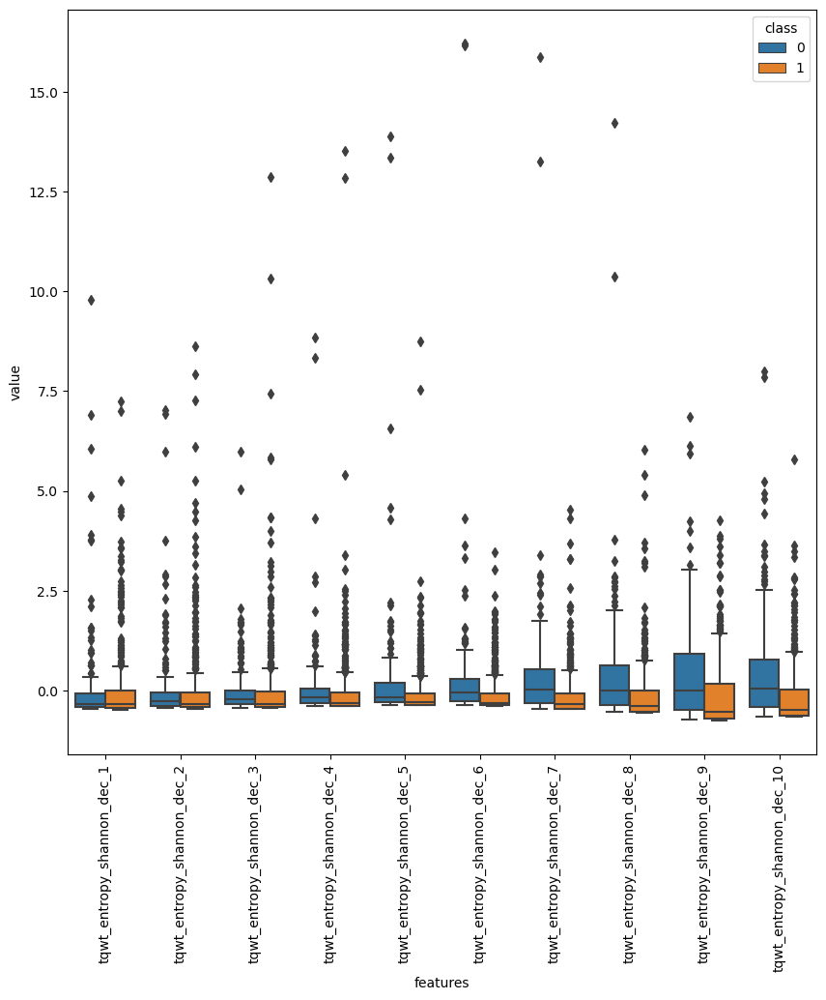

In [274]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_entropy_log_dec_1'),
  Text(1, 0, 'tqwt_entropy_log_dec_2'),
  Text(2, 0, 'tqwt_entropy_log_dec_3'),
  Text(3, 0, 'tqwt_entropy_log_dec_4'),
  Text(4, 0, 'tqwt_entropy_log_dec_5'),
  Text(5, 0, 'tqwt_entropy_log_dec_6'),
  Text(6, 0, 'tqwt_entropy_log_dec_7'),
  Text(7, 0, 'tqwt_entropy_log_dec_8'),
  Text(8, 0, 'tqwt_entropy_log_dec_9'),
  Text(9, 0, 'tqwt_entropy_log_dec_10')])

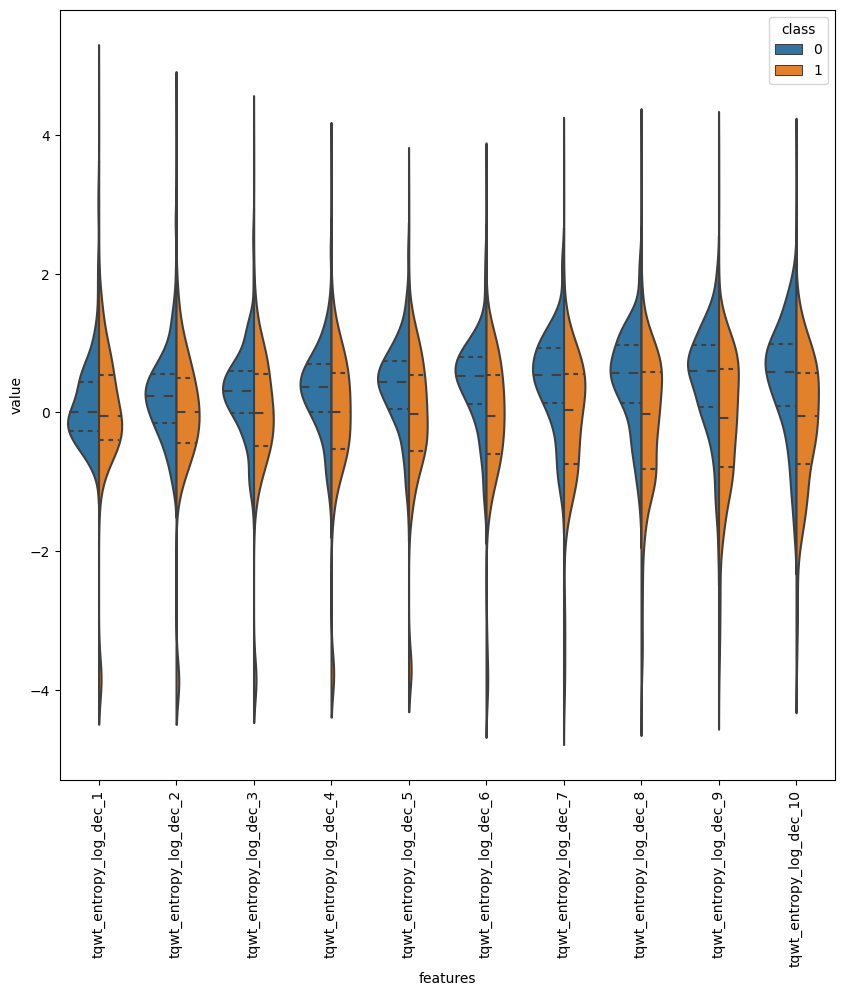

In [281]:
y= df['class']
data_dia = df['class']
x = 72
data =  df_TQWT.iloc[:,x:x+10]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_entropy_log_dec_1'),
  Text(1, 0, 'tqwt_entropy_log_dec_2'),
  Text(2, 0, 'tqwt_entropy_log_dec_3'),
  Text(3, 0, 'tqwt_entropy_log_dec_4'),
  Text(4, 0, 'tqwt_entropy_log_dec_5'),
  Text(5, 0, 'tqwt_entropy_log_dec_6'),
  Text(6, 0, 'tqwt_entropy_log_dec_7'),
  Text(7, 0, 'tqwt_entropy_log_dec_8'),
  Text(8, 0, 'tqwt_entropy_log_dec_9'),
  Text(9, 0, 'tqwt_entropy_log_dec_10')])

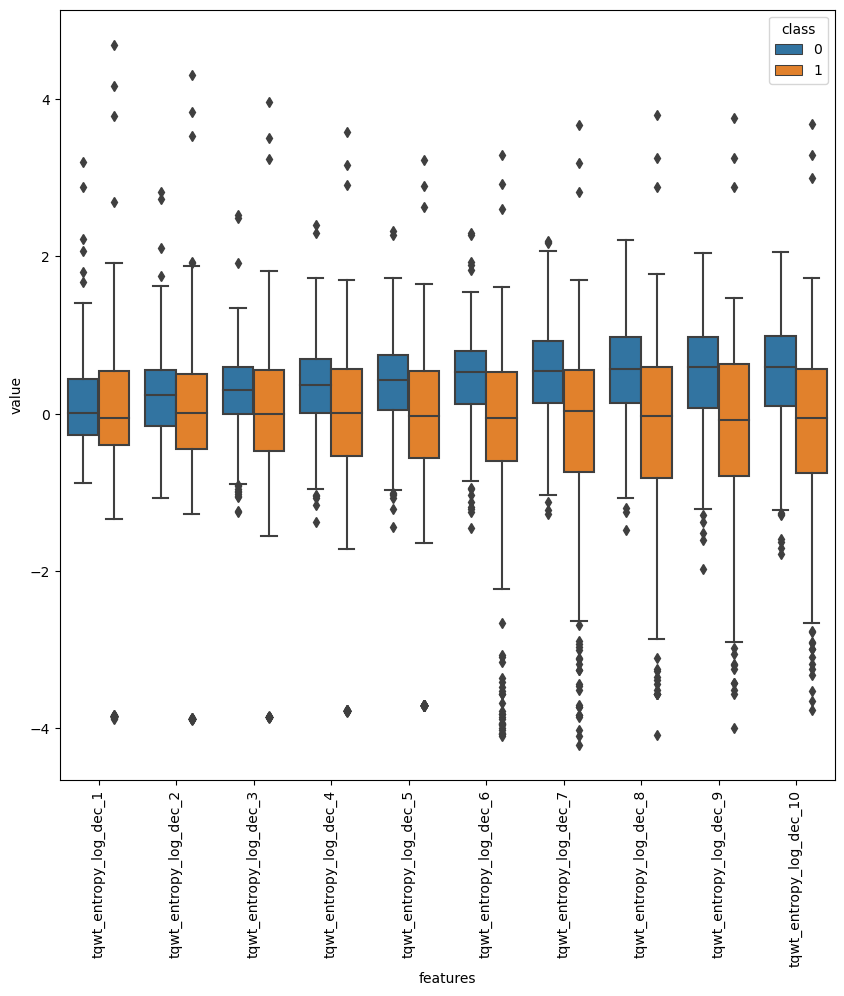

In [282]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9],
 [Text(0, 0, 'tqwt_entropy_log_dec_1'),
  Text(1, 0, 'tqwt_entropy_log_dec_2'),
  Text(2, 0, 'tqwt_entropy_log_dec_3'),
  Text(3, 0, 'tqwt_entropy_log_dec_4'),
  Text(4, 0, 'tqwt_entropy_log_dec_5'),
  Text(5, 0, 'tqwt_entropy_log_dec_6'),
  Text(6, 0, 'tqwt_entropy_log_dec_7'),
  Text(7, 0, 'tqwt_entropy_log_dec_8'),
  Text(8, 0, 'tqwt_entropy_log_dec_9'),
  Text(9, 0, 'tqwt_entropy_log_dec_10')])

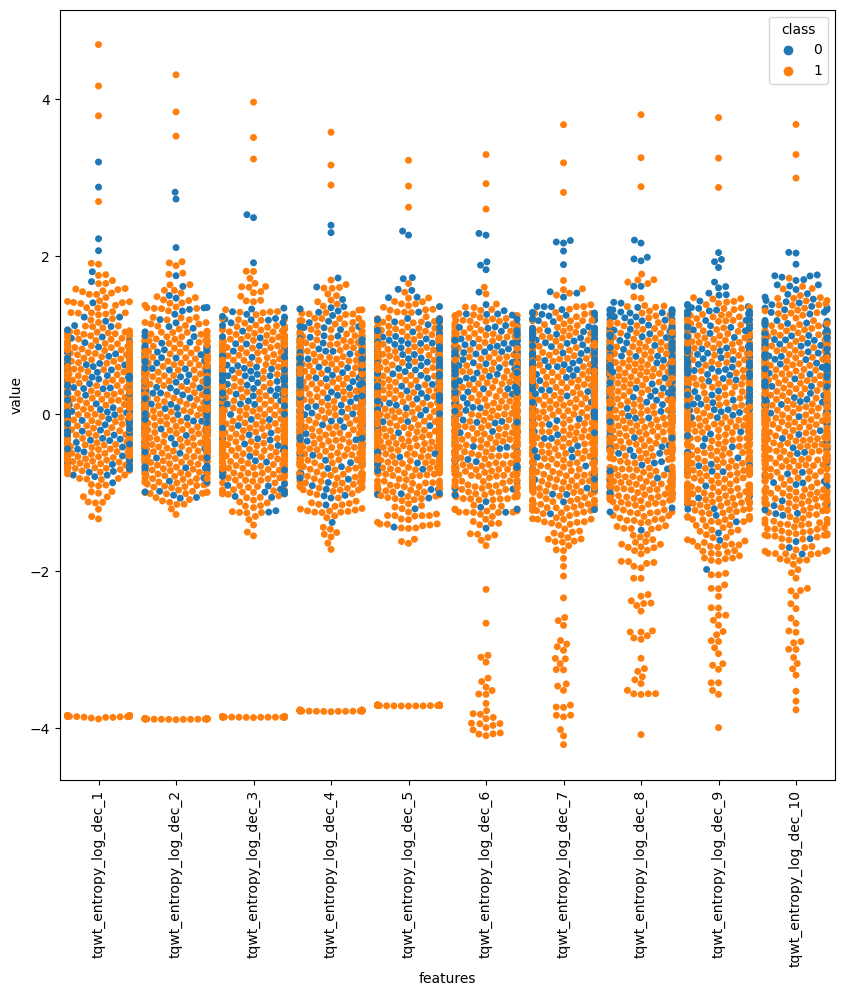

In [283]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_meanValue_dec_1'),
  Text(1, 0, 'tqwt_meanValue_dec_2'),
  Text(2, 0, 'tqwt_meanValue_dec_3'),
  Text(3, 0, 'tqwt_meanValue_dec_4'),
  Text(4, 0, 'tqwt_meanValue_dec_5'),
  Text(5, 0, 'tqwt_meanValue_dec_6'),
  Text(6, 0, 'tqwt_meanValue_dec_7'),
  Text(7, 0, 'tqwt_meanValue_dec_8'),
  Text(8, 0, 'tqwt_meanValue_dec_9'),
  Text(9, 0, 'tqwt_meanValue_dec_10')])

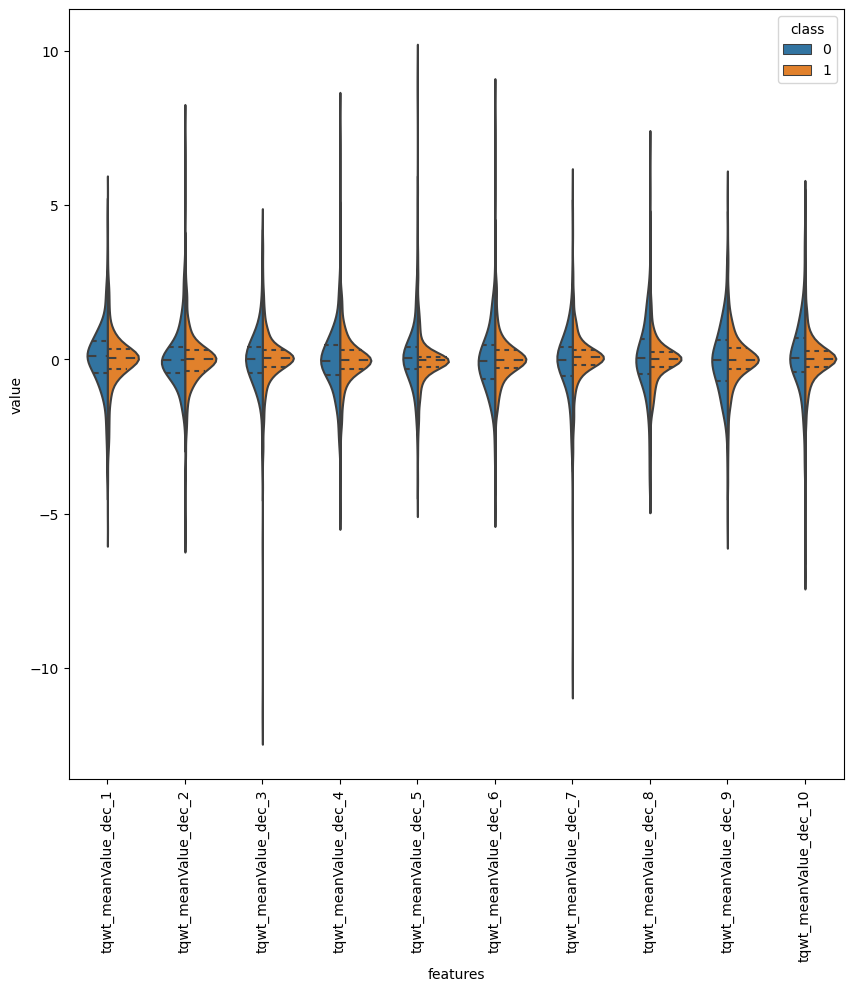

In [277]:
y= df['class']
data_dia = df['class']
x = 180+36
data =  df_TQWT.iloc[:,x:x+10]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_meanValue_dec_1'),
  Text(1, 0, 'tqwt_meanValue_dec_2'),
  Text(2, 0, 'tqwt_meanValue_dec_3'),
  Text(3, 0, 'tqwt_meanValue_dec_4'),
  Text(4, 0, 'tqwt_meanValue_dec_5'),
  Text(5, 0, 'tqwt_meanValue_dec_6'),
  Text(6, 0, 'tqwt_meanValue_dec_7'),
  Text(7, 0, 'tqwt_meanValue_dec_8'),
  Text(8, 0, 'tqwt_meanValue_dec_9'),
  Text(9, 0, 'tqwt_meanValue_dec_10')])

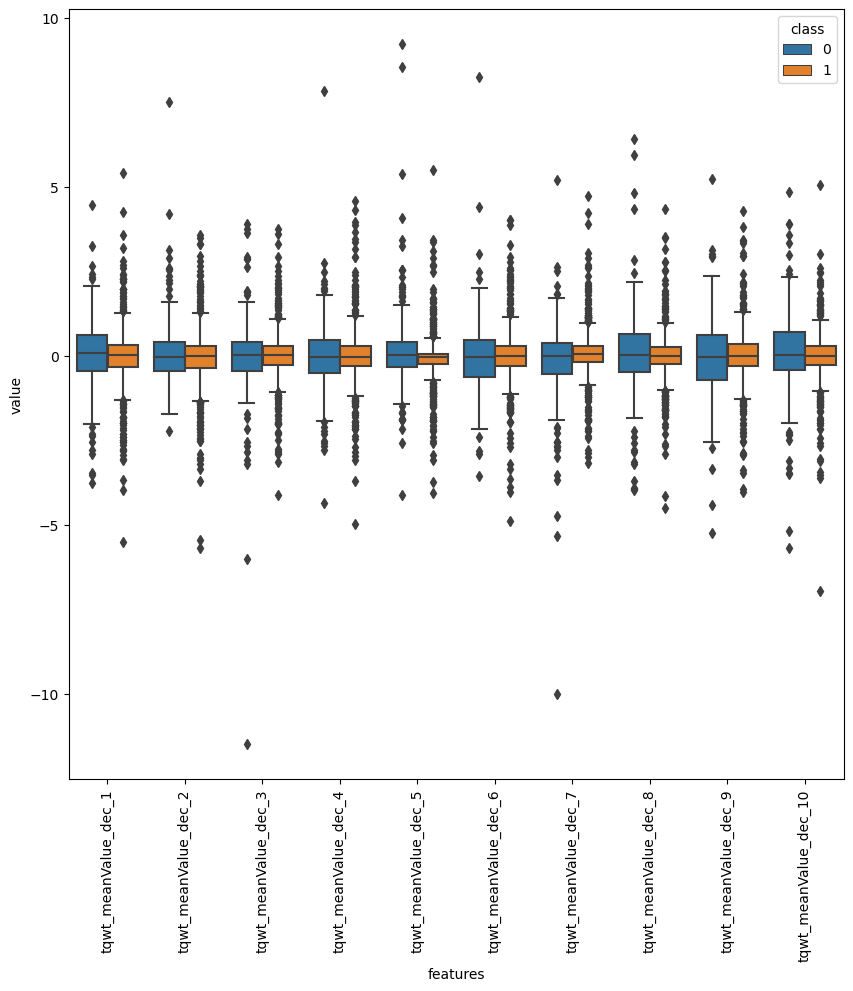

In [278]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_minValue_dec_1'),
  Text(1, 0, 'tqwt_minValue_dec_2'),
  Text(2, 0, 'tqwt_minValue_dec_3'),
  Text(3, 0, 'tqwt_minValue_dec_4'),
  Text(4, 0, 'tqwt_minValue_dec_5'),
  Text(5, 0, 'tqwt_minValue_dec_6'),
  Text(6, 0, 'tqwt_minValue_dec_7'),
  Text(7, 0, 'tqwt_minValue_dec_8'),
  Text(8, 0, 'tqwt_minValue_dec_9'),
  Text(9, 0, 'tqwt_minValue_dec_10')])

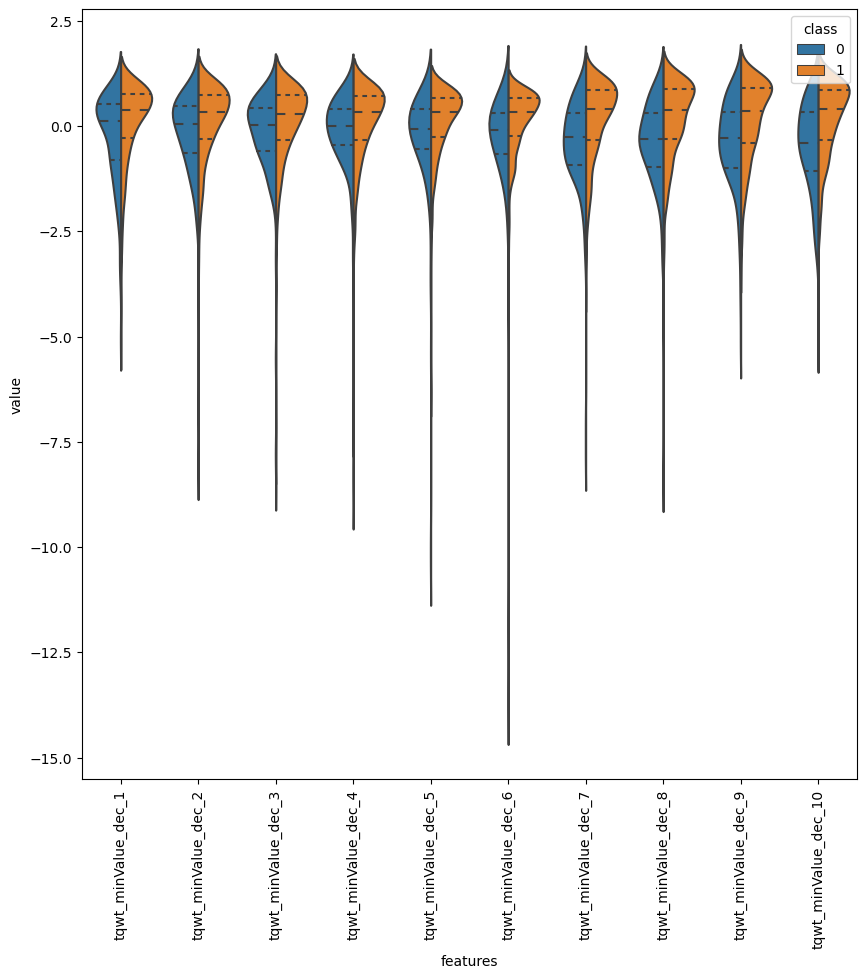

In [279]:
y= df['class']
data_dia = df['class']
x = 288
data =  df_TQWT.iloc[:,x:x+10]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_minValue_dec_1'),
  Text(1, 0, 'tqwt_minValue_dec_2'),
  Text(2, 0, 'tqwt_minValue_dec_3'),
  Text(3, 0, 'tqwt_minValue_dec_4'),
  Text(4, 0, 'tqwt_minValue_dec_5'),
  Text(5, 0, 'tqwt_minValue_dec_6'),
  Text(6, 0, 'tqwt_minValue_dec_7'),
  Text(7, 0, 'tqwt_minValue_dec_8'),
  Text(8, 0, 'tqwt_minValue_dec_9'),
  Text(9, 0, 'tqwt_minValue_dec_10')])

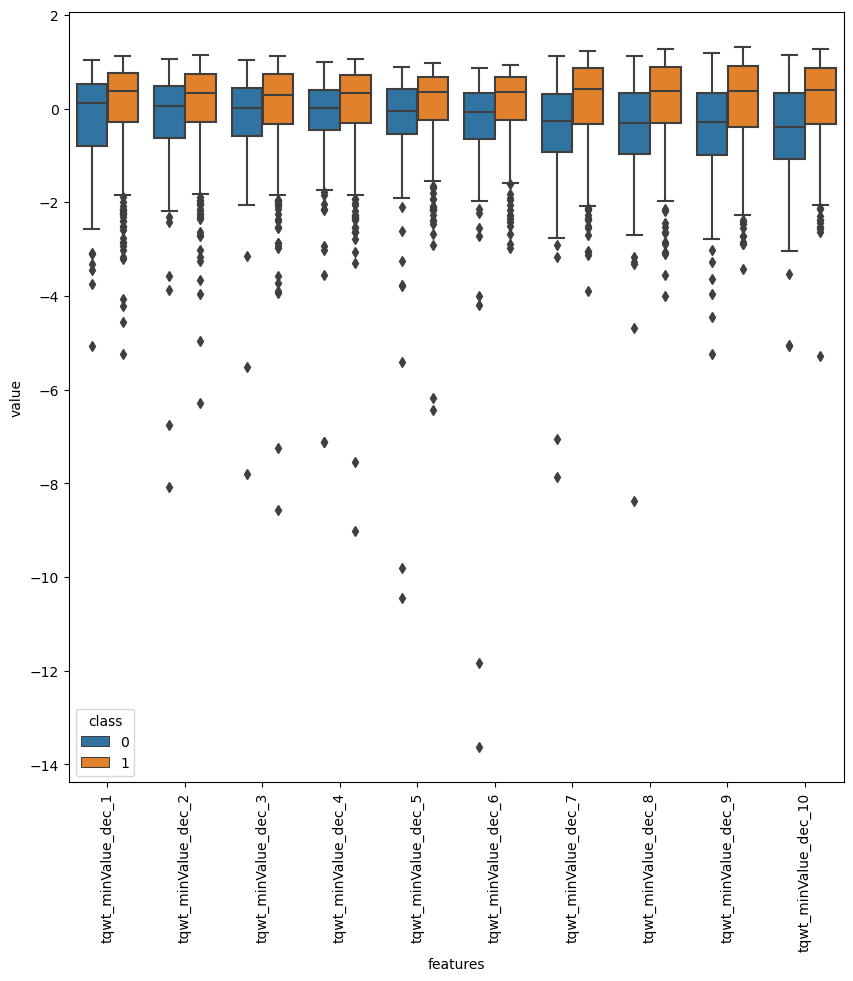

In [280]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_maxValue_dec_1'),
  Text(1, 0, 'tqwt_maxValue_dec_2'),
  Text(2, 0, 'tqwt_maxValue_dec_3'),
  Text(3, 0, 'tqwt_maxValue_dec_4'),
  Text(4, 0, 'tqwt_maxValue_dec_5'),
  Text(5, 0, 'tqwt_maxValue_dec_6'),
  Text(6, 0, 'tqwt_maxValue_dec_7'),
  Text(7, 0, 'tqwt_maxValue_dec_8'),
  Text(8, 0, 'tqwt_maxValue_dec_9'),
  Text(9, 0, 'tqwt_maxValue_dec_10')])

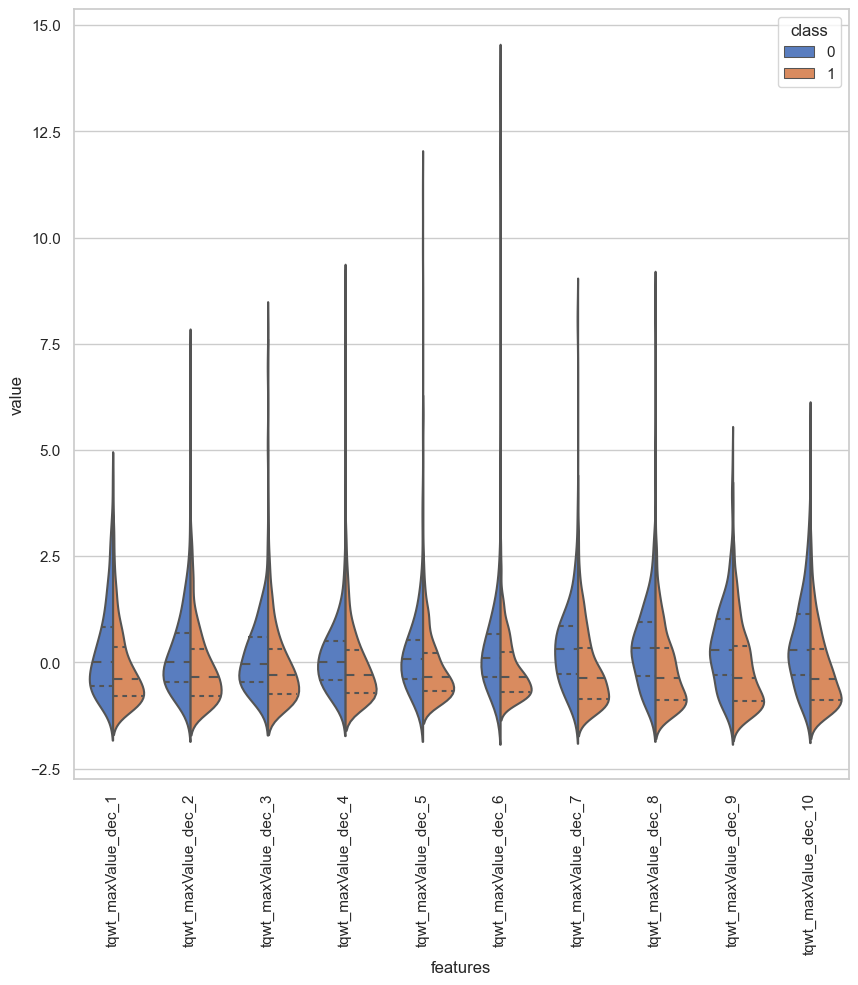

In [236]:
y= df['class']
data_dia = df['class']
x = 288+36
data =  df_TQWT.iloc[:,x:x+10]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="class", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]),
 [Text(0, 0, 'tqwt_maxValue_dec_1'),
  Text(1, 0, 'tqwt_maxValue_dec_2'),
  Text(2, 0, 'tqwt_maxValue_dec_3'),
  Text(3, 0, 'tqwt_maxValue_dec_4'),
  Text(4, 0, 'tqwt_maxValue_dec_5'),
  Text(5, 0, 'tqwt_maxValue_dec_6'),
  Text(6, 0, 'tqwt_maxValue_dec_7'),
  Text(7, 0, 'tqwt_maxValue_dec_8'),
  Text(8, 0, 'tqwt_maxValue_dec_9'),
  Text(9, 0, 'tqwt_maxValue_dec_10')])

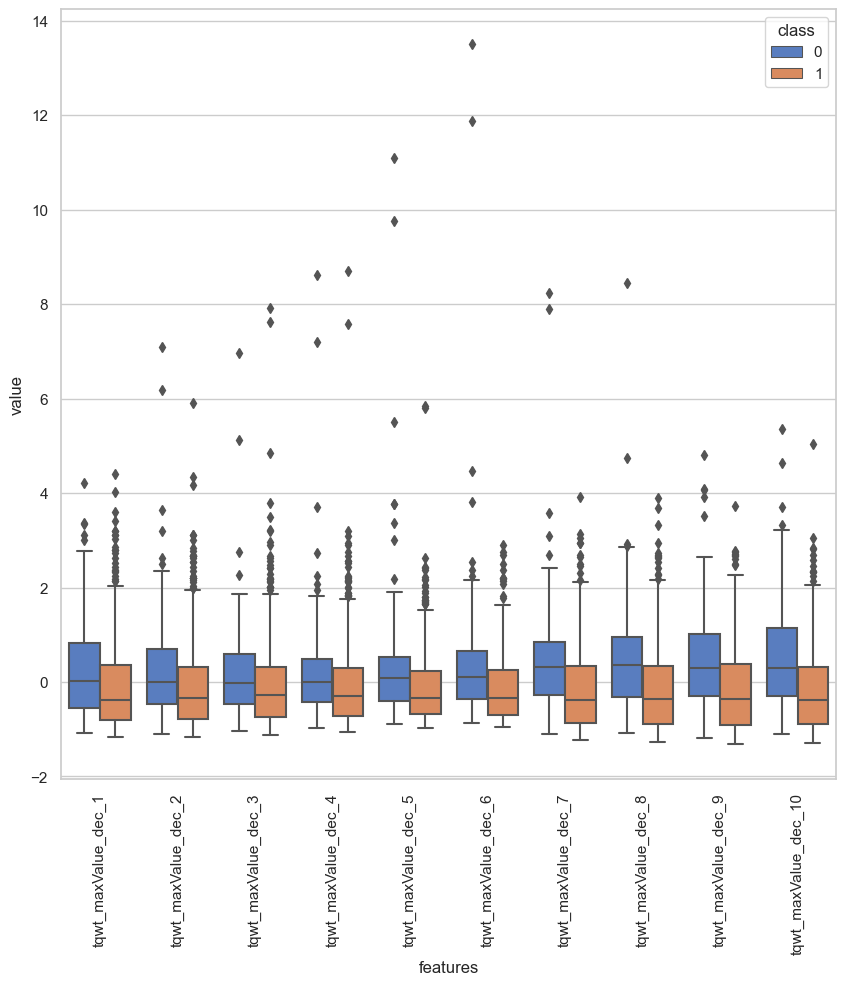

In [237]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="class", data=data)
plt.xticks(rotation=90)

### Balancing before and after splitting

In [56]:
X = df.drop(['class','id'],axis=1)
Y = df['class']

In [132]:
X = X[ET_features]
#X= X[RFE_features]
#X= X[MI_features]

In [57]:
sm=SMOTE(random_state=42)

In [58]:
X_bal,Y_bal=sm.fit_resample(X,Y)

In [59]:
df['id']

0        0
1        0
2        0
3        1
4        1
      ... 
751    250
752    250
753    251
754    251
755    251
Name: id, Length: 756, dtype: int64

In [60]:
x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size = 0.30, random_state = 42)
#x_train_bal, x_test_bal, y_train_bal, y_test_bal = train_test_split(X_bal, Y_bal, test_size = 0.30, random_state = 42)

In [61]:
x_test, x_cv, y_test, y_cv = train_test_split(x_test, y_test, test_size = 0.50, random_state = 42)
#x_test_bal, x_cv_bal, y_test_bal, y_cv_bal = train_test_split(x_test_bal, y_test_bal, test_size = 0.50, random_state = 42)

In [62]:
x_train.shape

(529, 753)

In [63]:
sc = StandardScaler()
x_train = sc.fit_transform(x_train)
x_test = sc.transform (x_test)
x_cv = sc.transform (x_cv)

# Feature Selection

## RFE Feature Selection

In [65]:
from sklearn.feature_selection import RFE

In [66]:
estimator = LogisticRegression()  # the algorithm for the RFE Model
rfe = RFE(estimator, n_features_to_select=50)
rfe.fit(x_train, y_train)

RFE(estimator=LogisticRegression(), n_features_to_select=50)

In [67]:
ranked_features_rfe = pd.Series(rfe.ranking_, index=X.columns)
ranked_features_rfe = ranked_features_rfe.sort_values(ascending=True)
ranked_features_rfe = ranked_features_rfe[0:50]
for i, (feature_name, ranking) in enumerate(ranked_features_rfe.iteritems(), start=1):
    print(f"Feature {i} = {feature_name}")

Feature 1 = b3
Feature 2 = b4
Feature 3 = tqwt_TKEO_std_dec_19
Feature 4 = tqwt_TKEO_std_dec_26
Feature 5 = tqwt_medianValue_dec_10
Feature 6 = std_9th_delta_delta
Feature 7 = std_MFCC_2nd_coef
Feature 8 = std_6th_delta_delta
Feature 9 = GNE_NSR_TKEO
Feature 10 = tqwt_meanValue_dec_22
Feature 11 = tqwt_maxValue_dec_20
Feature 12 = tqwt_maxValue_dec_17
Feature 13 = std_delta_delta_log_energy
Feature 14 = mean_MFCC_8th_coef
Feature 15 = tqwt_medianValue_dec_33
Feature 16 = mean_delta_log_energy
Feature 17 = tqwt_maxValue_dec_5
Feature 18 = std_9th_delta
Feature 19 = tqwt_meanValue_dec_3
Feature 20 = IMF_SNR_entropy
Feature 21 = std_7th_delta
Feature 22 = tqwt_minValue_dec_17
Feature 23 = mean_MFCC_0th_coef
Feature 24 = mean_MFCC_1st_coef
Feature 25 = tqwt_meanValue_dec_7
Feature 26 = std_MFCC_7th_coef
Feature 27 = std_MFCC_10th_coef
Feature 28 = tqwt_medianValue_dec_36
Feature 29 = tqwt_TKEO_std_dec_12
Feature 30 = mean_MFCC_7th_coef
Feature 31 = tqwt_skewnessValue_dec_17
Feature 32 = tq

In [68]:
RFE_features = ranked_features_rfe.index

## Extra Trees Classifier

In [69]:
ET=ExtraTreesClassifier()
ET.fit(x_train,y_train)

ExtraTreesClassifier()

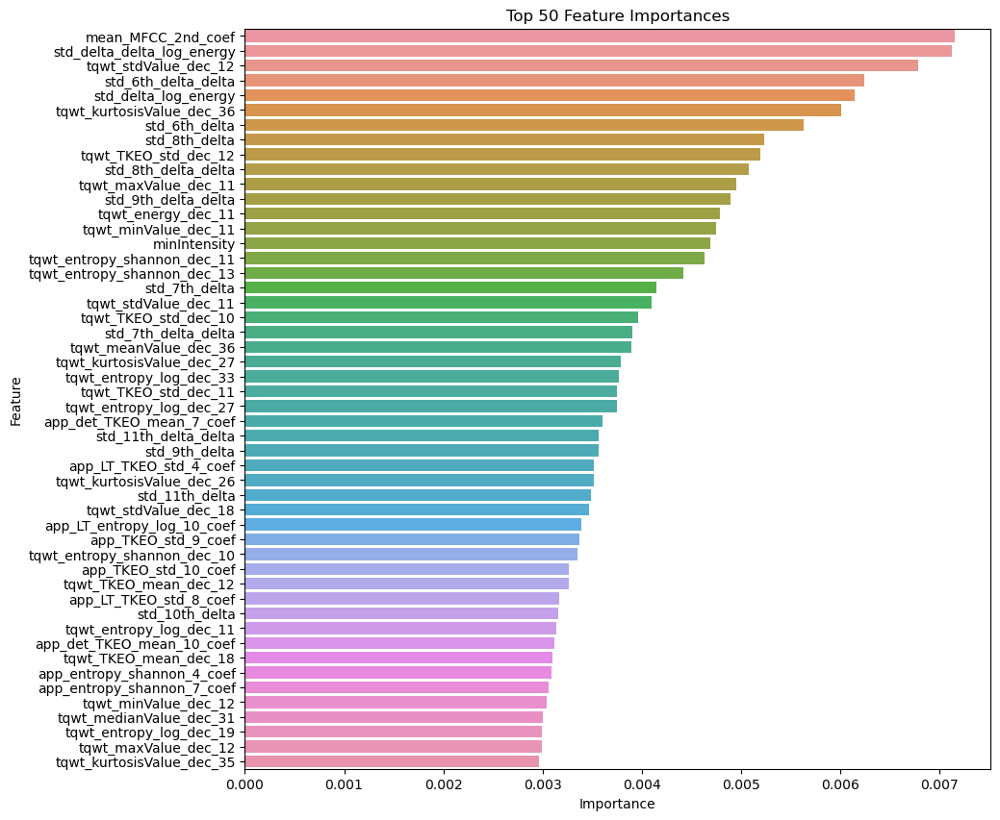

In [70]:
feature_importances = ET.feature_importances_
feature_names = X.columns

# Create a DataFrame to store feature names and importances
importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})

# Select the top 50 features based on importance values
top_50_importances = importance_df.nlargest(50, 'Importance')

# Sort the in descending order
top_50_importances = top_50_importances.sort_values(by='Importance', ascending=False)

# Create the bar plot
plt.figure(figsize=(10, 10))
sns.barplot(x='Importance', y='Feature', data=top_50_importances)
plt.title('Top 50 Feature Importances')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

In [71]:
ET_features = top_50_importances['Feature'].tolist()
ET_features

['mean_MFCC_2nd_coef',
 'std_delta_delta_log_energy',
 'tqwt_stdValue_dec_12',
 'std_6th_delta_delta',
 'std_delta_log_energy',
 'tqwt_kurtosisValue_dec_36',
 'std_6th_delta',
 'std_8th_delta',
 'tqwt_TKEO_std_dec_12',
 'std_8th_delta_delta',
 'tqwt_maxValue_dec_11',
 'std_9th_delta_delta',
 'tqwt_energy_dec_11',
 'tqwt_minValue_dec_11',
 'minIntensity',
 'tqwt_entropy_shannon_dec_11',
 'tqwt_entropy_shannon_dec_13',
 'std_7th_delta',
 'tqwt_stdValue_dec_11',
 'tqwt_TKEO_std_dec_10',
 'std_7th_delta_delta',
 'tqwt_meanValue_dec_36',
 'tqwt_kurtosisValue_dec_27',
 'tqwt_entropy_log_dec_33',
 'tqwt_TKEO_std_dec_11',
 'tqwt_entropy_log_dec_27',
 'app_det_TKEO_mean_7_coef',
 'std_11th_delta_delta',
 'std_9th_delta',
 'app_LT_TKEO_std_4_coef',
 'tqwt_kurtosisValue_dec_26',
 'std_11th_delta',
 'tqwt_stdValue_dec_18',
 'app_LT_entropy_log_10_coef',
 'app_TKEO_std_9_coef',
 'tqwt_entropy_shannon_dec_10',
 'app_TKEO_std_10_coef',
 'tqwt_TKEO_mean_dec_12',
 'app_LT_TKEO_std_8_coef',
 'std_10th_d

## Mutual Info Gain

In [72]:
MI=mutual_info_classif(x_train,y_train)
ranked_features=pd.Series(MI,index=X.columns)
mi_ranked_features = ranked_features.nlargest(50).index

In [73]:
for rank, feature in enumerate(mi_ranked_features, start=1):
    print(f"Rank {rank}: {feature}")

Rank 1: std_8th_delta
Rank 2: app_entropy_shannon_5_coef
Rank 3: std_delta_delta_log_energy
Rank 4: tqwt_entropy_log_dec_35
Rank 5: app_LT_entropy_log_8_coef
Rank 6: app_LT_entropy_log_9_coef
Rank 7: tqwt_kurtosisValue_dec_36
Rank 8: app_entropy_shannon_8_coef
Rank 9: app_LT_entropy_log_10_coef
Rank 10: app_entropy_log_3_coef
Rank 11: app_entropy_shannon_9_coef
Rank 12: app_LT_entropy_log_2_coef
Rank 13: tqwt_entropy_log_dec_16
Rank 14: std_8th_delta_delta
Rank 15: app_entropy_log_2_coef
Rank 16: app_LT_entropy_shannon_10_coef
Rank 17: app_LT_entropy_shannon_9_coef
Rank 18: app_LT_TKEO_std_5_coef
Rank 19: app_LT_entropy_shannon_8_coef
Rank 20: std_10th_delta_delta
Rank 21: std_6th_delta_delta
Rank 22: tqwt_minValue_dec_7
Rank 23: app_entropy_shannon_10_coef
Rank 24: std_11th_delta_delta
Rank 25: app_LT_entropy_shannon_3_coef
Rank 26: std_7th_delta_delta
Rank 27: tqwt_skewnessValue_dec_22
Rank 28: app_LT_entropy_log_3_coef
Rank 29: tqwt_kurtosisValue_dec_27
Rank 30: app_LT_TKEO_std_8_co

In [74]:
MI_features = mi_ranked_features 
MI_features

Index(['std_8th_delta', 'app_entropy_shannon_5_coef',
       'std_delta_delta_log_energy', 'tqwt_entropy_log_dec_35',
       'app_LT_entropy_log_8_coef', 'app_LT_entropy_log_9_coef',
       'tqwt_kurtosisValue_dec_36', 'app_entropy_shannon_8_coef',
       'app_LT_entropy_log_10_coef', 'app_entropy_log_3_coef',
       'app_entropy_shannon_9_coef', 'app_LT_entropy_log_2_coef',
       'tqwt_entropy_log_dec_16', 'std_8th_delta_delta',
       'app_entropy_log_2_coef', 'app_LT_entropy_shannon_10_coef',
       'app_LT_entropy_shannon_9_coef', 'app_LT_TKEO_std_5_coef',
       'app_LT_entropy_shannon_8_coef', 'std_10th_delta_delta',
       'std_6th_delta_delta', 'tqwt_minValue_dec_7',
       'app_entropy_shannon_10_coef', 'std_11th_delta_delta',
       'app_LT_entropy_shannon_3_coef', 'std_7th_delta_delta',
       'tqwt_skewnessValue_dec_22', 'app_LT_entropy_log_3_coef',
       'tqwt_kurtosisValue_dec_27', 'app_LT_TKEO_std_8_coef',
       'tqwt_entropy_log_dec_11', 'app_entropy_log_5_coef',
   

## Balancing the data

In [75]:
sm=SMOTE(random_state=42)

In [76]:
x_train,y_train=sm.fit_resample(x_train,y_train)


In [77]:
x_train.shape

(796, 753)

In [78]:
y_train.value_counts()

1    398
0    398
Name: class, dtype: int64

In [79]:
y_train.shape

(796,)

In [80]:
y_test.shape

(113,)

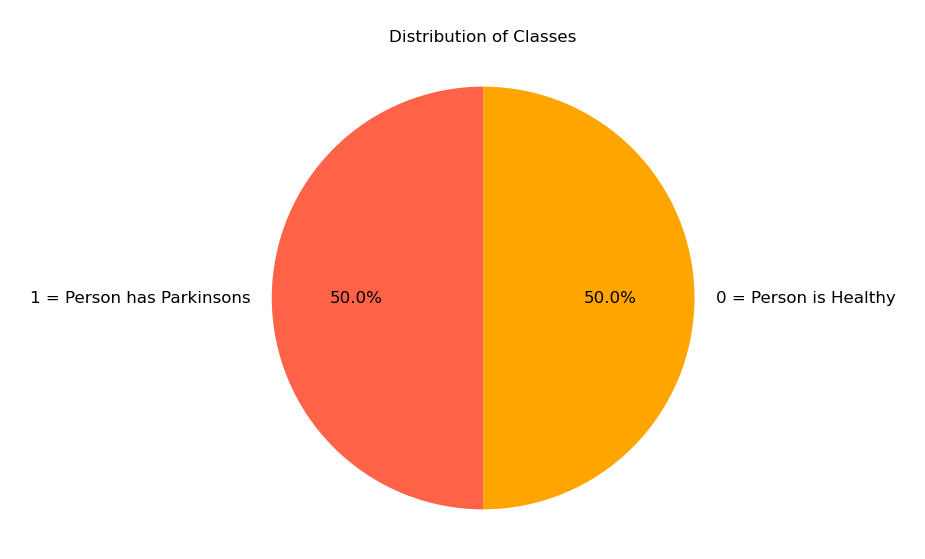

In [81]:
class_counts = y_train.value_counts()

colors = ['#FF6347', '#FFA500']

plt.figure(figsize=(2, 2), dpi=300)

plt.pie(class_counts, labels=['1 = Person has Parkinsons', '0 = Person is Healthy'], 
        autopct='%1.1f%%', startangle=90, colors=colors, textprops={'fontsize': 4})

plt.axis('equal')

plt.title('Distribution of Classes', fontsize=4)

plt.show()

## PCA

In [309]:
pca=PCA(100)
x_train=pca.fit_transform(x_train)
x_test=pca.transform(x_test)
x_cv=pca.transform(x_cv)

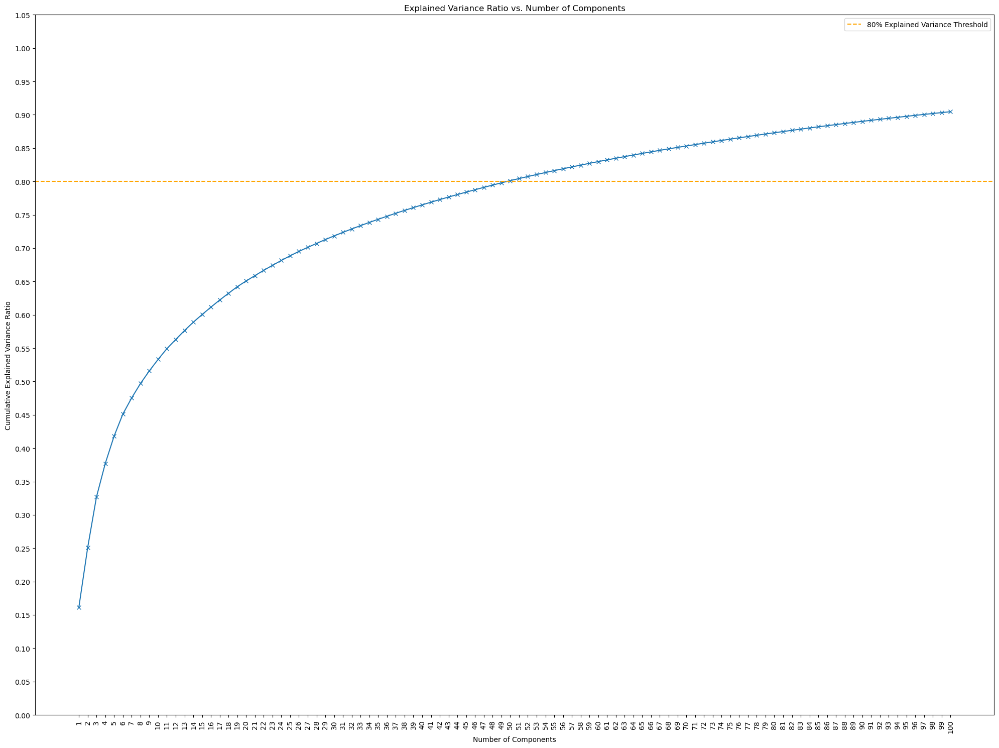

In [311]:
explained_variance_ratio_cumulative = np.cumsum(pca.explained_variance_ratio_)

plt.style.use('default')

plt.figure(figsize=(20, 15))
plt.plot(range(1, x_train.shape[1] + 1), explained_variance_ratio_cumulative, marker='x', linestyle='-')
plt.axhline(y=0.80, color='orange', linestyle='--', label='80% Explained Variance Threshold')

plt.xscale('linear')  # Use 'log' for logarithmic scale
plt.yscale('linear')  # Use 'log' for logarithmic scale
plt.xticks(np.arange(1, x_train.shape[1] + 1, 1))  # Add minor ticks on the x-axis
plt.yticks(np.arange(0, 1.1, 0.05))  # Add minor ticks on the y-axis

plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Explained Variance Ratio vs. Number of Components')
plt.grid(False)
plt.legend()
plt.xticks(rotation=90)  # Rotate x-axis tick labels by 90 degrees
plt.tight_layout()


plt.show()

In [82]:
pca=PCA(n_components=50)
x_train=pca.fit_transform(x_train)
x_test=pca.transform(x_test)
x_cv=pca.transform(x_cv)

In [83]:
y_test.value_counts()
y_test.value_counts()

1    83
0    30
Name: class, dtype: int64

In [84]:
y_train.value_counts()

1    398
0    398
Name: class, dtype: int64

In [85]:
x_train.shape[1]

50

# Neural Network Model

In [171]:
def create_model(regularizer_value, optimization, learning_rate):
    NN_cls = Sequential([
        Dense(60, activation='relu', name='L1', kernel_regularizer=regularizers.l2(regularizer_value)),
        Dense(30, activation='relu', name='L2', kernel_regularizer=regularizers.l2(regularizer_value)),
        Dense(15, activation='relu', name='L3', kernel_regularizer=regularizers.l2(regularizer_value)),
        Dense(2, activation='linear', name='L4')
    ])
    
    NN_cls.compile(
        loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        optimizer=optimization(learning_rate),
        metrics=['accuracy']
    )
    
    return NN_cls

In [172]:
NN_cls = KerasClassifier(build_fn=create_model, epochs=200, validation_data=(x_cv, y_cv), verbose=1)
NN_cls.fit(x_train,y_train)

Epoch 1/200
25/25 [==============================] - 1s 14ms/step - loss: 1.3135 - accuracy: 0.6307 - val_loss: 1.2053 - val_accuracy: 0.6404
Epoch 2/200
25/25 [==============================] - 0s 4ms/step - loss: 1.0807 - accuracy: 0.7663 - val_loss: 1.1153 - val_accuracy: 0.7018
Epoch 3/200
25/25 [==============================] - 0s 4ms/step - loss: 0.9790 - accuracy: 0.8141 - val_loss: 1.0505 - val_accuracy: 0.7193
Epoch 4/200
25/25 [==============================] - 0s 5ms/step - loss: 0.9114 - accuracy: 0.8405 - val_loss: 1.0148 - val_accuracy: 0.7368
Epoch 5/200
25/25 [==============================] - 0s 6ms/step - loss: 0.8582 - accuracy: 0.8706 - val_loss: 0.9789 - val_accuracy: 0.7719
Epoch 6/200
25/25 [==============================] - 0s 5ms/step - loss: 0.8139 - accuracy: 0.8982 - val_loss: 0.9539 - val_accuracy: 0.7807
Epoch 7/200
25/25 [==============================] - 0s 4ms/step - loss: 0.7753 - accuracy: 0.9083 - val_loss: 0.9305 - val_accuracy: 0.7807
Epoch 8/200


In [41]:
param_grid = {
    'regularizer_value': [0.001, 0.005 , 0.05 , 0.02 , 0.01],
    'optimization': [tf.keras.optimizers.Adam, tf.keras.optimizers.RMSprop, tf.keras.optimizers.SGD,tf.keras.optimizers.Adamax],
    'learning_rate': [0.0005, 0.001, 0.005]
}


In [42]:
grid_search = GridSearchCV(estimator=NN_cls, param_grid=param_grid, cv=5,scoring='recall_macro')

In [23]:
grid_result = grid_search.fit(x_cv, y_cv)

Epoch 1/100
3/3 [==============================] - 1s 179ms/step - loss: 0.8744 - accuracy: 0.4342 - val_loss: 0.8235 - val_accuracy: 0.5526
Epoch 2/100
3/3 [==============================] - 0s 26ms/step - loss: 0.7563 - accuracy: 0.5526 - val_loss: 0.7420 - val_accuracy: 0.5877
Epoch 3/100
3/3 [==============================] - 0s 26ms/step - loss: 0.6745 - accuracy: 0.5921 - val_loss: 0.6830 - val_accuracy: 0.6316
Epoch 4/100
3/3 [==============================] - 0s 26ms/step - loss: 0.6192 - accuracy: 0.6974 - val_loss: 0.6379 - val_accuracy: 0.7018
Epoch 5/100
3/3 [==============================] - 0s 24ms/step - loss: 0.5757 - accuracy: 0.7632 - val_loss: 0.6051 - val_accuracy: 0.7368
Epoch 6/100
3/3 [==============================] - 0s 25ms/step - loss: 0.5413 - accuracy: 0.7895 - val_loss: 0.5776 - val_accuracy: 0.7719
Epoch 7/100
3/3 [==============================] - 0s 25ms/step - loss: 0.5097 - accuracy: 0.8158 - val_loss: 0.5518 - val_accuracy: 0.7895
Epoch 8/100
3/3 [==

In [24]:
print("Best Parameters: ", grid_result.best_params_)

Best Parameters:  {'learning_rate': 0.0005, 'optimization': <class 'keras.optimizers.optimizer_v2.adam.Adam'>, 'regularizer_value': 0.005}


In [31]:
best_model = grid_result.best_estimator_
best_model.fit(x_train,y_train)
y_pred = np.array(best_model.predict(x_test))
y_pred

Epoch 1/100
25/25 [==============================] - 1s 13ms/step - loss: 1.2114 - accuracy: 0.7035 - val_loss: 1.1334 - val_accuracy: 0.7982
Epoch 2/100
25/25 [==============================] - 0s 4ms/step - loss: 1.0356 - accuracy: 0.7789 - val_loss: 1.0927 - val_accuracy: 0.8070
Epoch 3/100
25/25 [==============================] - 0s 4ms/step - loss: 0.9507 - accuracy: 0.8304 - val_loss: 1.0427 - val_accuracy: 0.8246
Epoch 4/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8916 - accuracy: 0.8505 - val_loss: 1.0241 - val_accuracy: 0.8246
Epoch 5/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8444 - accuracy: 0.8756 - val_loss: 0.9980 - val_accuracy: 0.8333
Epoch 6/100
25/25 [==============================] - 0s 4ms/step - loss: 0.8039 - accuracy: 0.9008 - val_loss: 0.9718 - val_accuracy: 0.8246
Epoch 7/100
25/25 [==============================] - 0s 4ms/step - loss: 0.7680 - accuracy: 0.9158 - val_loss: 0.9534 - val_accuracy: 0.8333
Epoch 8/100


array([1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1,
       0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0,
       1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1,
       0, 1, 1], dtype=int64)

In [86]:
start_time = time.time()

NN_cls = Sequential([
    Dense(60, activation='relu', name='L1', kernel_regularizer=regularizers.l2(0.02)),
    Dropout(0.1),
    Dense(30, activation='relu', name='L2', kernel_regularizer=regularizers.l2(0.02)),
    Dropout(0.1),
    Dense(15, activation='relu', name='L3', kernel_regularizer=regularizers.l2(0.02)),
    Dropout(0.1),
    Dense(2, activation='linear', name='L4')
])

NN_cls.compile(
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    optimizer=tf.keras.optimizers.Adam(0.0005),
    metrics=['accuracy']
)

history = NN_cls.fit(
    x_train, y_train,
    epochs=300, validation_data=(x_cv, y_cv))

end_time = time.time()
train_time = end_time - start_time
print("Time taken to train the model is: ", train_time)

Epoch 1/300
25/25 [==============================] - 1s 10ms/step - loss: 3.1588 - accuracy: 0.5415 - val_loss: 2.8537 - val_accuracy: 0.6842
Epoch 2/300
25/25 [==============================] - 0s 2ms/step - loss: 2.8783 - accuracy: 0.6193 - val_loss: 2.7002 - val_accuracy: 0.7193
Epoch 3/300
25/25 [==============================] - 0s 3ms/step - loss: 2.6827 - accuracy: 0.6734 - val_loss: 2.5640 - val_accuracy: 0.7632
Epoch 4/300
25/25 [==============================] - 0s 2ms/step - loss: 2.5259 - accuracy: 0.7236 - val_loss: 2.4317 - val_accuracy: 0.7632
Epoch 5/300
25/25 [==============================] - 0s 3ms/step - loss: 2.3965 - accuracy: 0.7437 - val_loss: 2.3138 - val_accuracy: 0.7982
Epoch 6/300
25/25 [==============================] - 0s 3ms/step - loss: 2.2712 - accuracy: 0.7776 - val_loss: 2.2000 - val_accuracy: 0.7982
Epoch 7/300
25/25 [==============================] - 0s 3ms/step - loss: 2.1649 - accuracy: 0.7739 - val_loss: 2.1005 - val_accuracy: 0.7982
Epoch 8/300


In [26]:
start_time = time.time()

NN_cls_bal = Sequential([
    Dense(60, activation='relu', name='L1', kernel_regularizer=regularizers.l2(0.02)),
    Dropout(0.1),
    Dense(30, activation='relu', name='L2', kernel_regularizer=regularizers.l2(0.02)),
    Dropout(0.1),
    Dense(15, activation='relu', name='L3', kernel_regularizer=regularizers.l2(0.02)),
    Dropout(0.1),
    Dense(2, activation='linear', name='L4')
])

NN_cls_bal.compile(
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    optimizer=tf.keras.optimizers.Adam(0.0005),
    metrics=['accuracy']
)

history_bal = NN_cls_bal.fit(
    x_train_bal, y_train_bal,
    epochs=300, validation_data=(x_cv_bal, y_cv_bal))

end_time = time.time()
train_time = end_time - start_time
print("Time taken to train the model is: ", train_time)

Epoch 1/300
25/25 [==============================] - 1s 14ms/step - loss: 3.3385 - accuracy: 0.4880 - val_loss: 2.9032 - val_accuracy: 0.6294
Epoch 2/300
25/25 [==============================] - 0s 4ms/step - loss: 2.9709 - accuracy: 0.6033 - val_loss: 2.7038 - val_accuracy: 0.7118
Epoch 3/300
25/25 [==============================] - 0s 4ms/step - loss: 2.7870 - accuracy: 0.6540 - val_loss: 2.5834 - val_accuracy: 0.7412
Epoch 4/300
25/25 [==============================] - 0s 4ms/step - loss: 2.6449 - accuracy: 0.6768 - val_loss: 2.4755 - val_accuracy: 0.7294
Epoch 5/300
25/25 [==============================] - 0s 4ms/step - loss: 2.5112 - accuracy: 0.7199 - val_loss: 2.3947 - val_accuracy: 0.7765
Epoch 6/300
25/25 [==============================] - 0s 4ms/step - loss: 2.4426 - accuracy: 0.7262 - val_loss: 2.3139 - val_accuracy: 0.7706
Epoch 7/300
25/25 [==============================] - 0s 4ms/step - loss: 2.3230 - accuracy: 0.7541 - val_loss: 2.2349 - val_accuracy: 0.7882
Epoch 8/300


In [87]:
NN_cls.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 L1 (Dense)                  (None, 60)                3060      
                                                                 
 dropout (Dropout)           (None, 60)                0         
                                                                 
 L2 (Dense)                  (None, 30)                1830      
                                                                 
 dropout_1 (Dropout)         (None, 30)                0         
                                                                 
 L3 (Dense)                  (None, 15)                465       
                                                                 
 dropout_2 (Dropout)         (None, 15)                0         
                                                                 
 L4 (Dense)                  (None, 2)                 3

In [88]:
predictions=NN_cls.predict(x_test)

4/4 [==============================] - 0s 2ms/step


In [89]:
#predictions_bal=NN_cls_bal.predict(x_test_bal)

In [90]:
predictions=tf.nn.softmax(predictions).numpy()
predictions.shape


(113, 2)

In [91]:
#predictions_bal=tf.nn.softmax(predictions_bal).numpy()
#predictions_bal.shape


In [92]:
Y_test=np.array(y_test)

Y_test

array([1, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1,
       0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1,
       1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1,
       1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1,
       0, 1, 1], dtype=int64)

In [93]:
#Y_test_bal = np.array(y_test_bal)

In [94]:
y_pred=Y_test

In [95]:
#y_pred_bal=Y_test_bal

In [96]:
for i in range(len(predictions)):
    y_pred[i] = np.argmax(predictions[i])


In [97]:
#for i in range(len(predictions_bal)):
   # y_pred_bal[i] = np.argmax(predictions_bal[i])


In [98]:
#evaluate_model(y_test_bal, y_pred_bal)

In [99]:
evaluate_model(y_test, y_pred)

Accuracy of the model is: 92.92 %
Precision of the model is: 96.30 %
Recall of the model is: 93.98 %
AUC value of the model is: 91.99 %
F1 score of the model is: 95.12 %


In [100]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.84      0.90      0.87        30
           1       0.96      0.94      0.95        83

    accuracy                           0.93       113
   macro avg       0.90      0.92      0.91       113
weighted avg       0.93      0.93      0.93       113



In [101]:
#print(classification_report(y_test_bal, y_pred_bal))

<Figure size 1000x800 with 0 Axes>

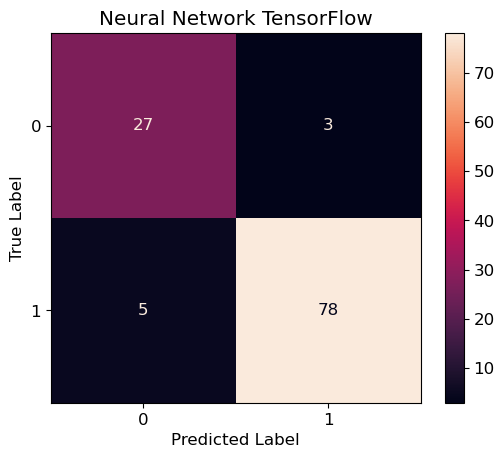

In [105]:
cm = confusion_matrix(y_test, y_pred)

# Increase the figure size and font size
plt.figure(figsize=(10, 8))
plt.rcParams.update({'font.size': 12})

# Display the confusion matrix with color normalization and a color bar
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0,1])
disp = disp.plot(cmap='rocket', values_format='d', colorbar=True)

# Set the title and axis labels
plt.title('Neural Network TensorFlow')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')

plt.show()

In [104]:
cm_bal = confusion_matrix(y_test_bal, y_pred_bal)

# Increase the figure size and font size
plt.figure(figsize=(10, 8))
plt.rcParams.update({'font.size': 12})

# Display the confusion matrix with color normalization and a color bar
disp = ConfusionMatrixDisplay(confusion_matrix=cm_bal, display_labels=[0,1])
disp = disp.plot(cmap='rocket', values_format='d', colorbar=True)

# Set the title and axis labels
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')

plt.show()

NameError: name 'y_test_bal' is not defined

4/4 [==============================] - 0s 1ms/step


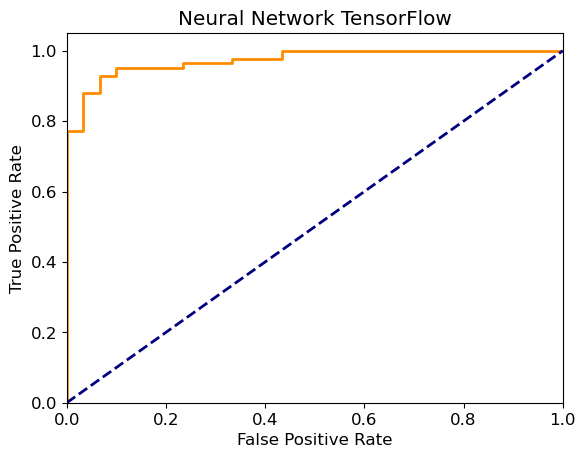

In [106]:
y_pred = NN_cls.predict(x_test)

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr, tpr, thresholds = roc_curve(y_test, y_pred[:, 1])  # Use y_pred[:, 1] for the positive class probabilities
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Neural Network TensorFlow')
plt.show()

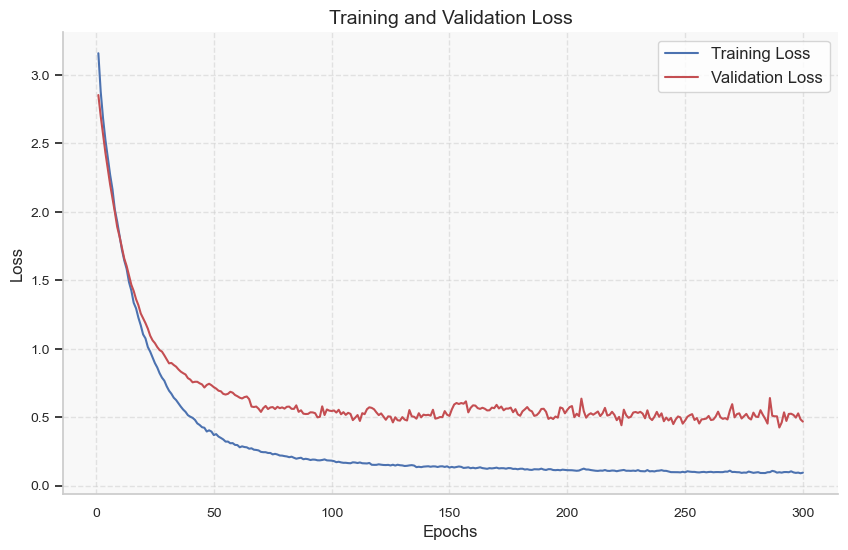

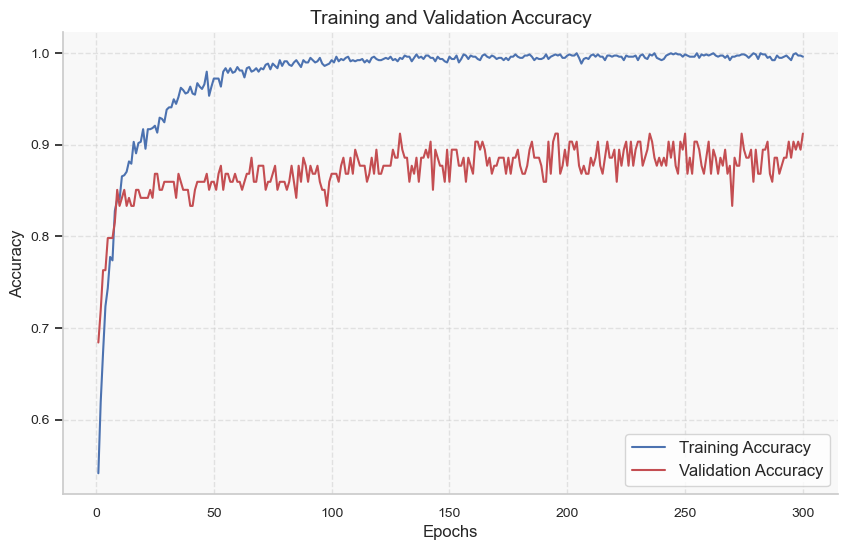

In [107]:
sns.set(style="whitegrid")

train_loss = history.history['loss']
val_loss = history.history['val_loss']
train_acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

# Plot the learning curves
epochs = range(1, len(train_loss) + 1)

# Plot loss curves
plt.figure(figsize=(10, 6))

plt.plot(epochs, train_loss, 'b-', label='Training Loss')
plt.plot(epochs, val_loss, 'r-', label='Validation Loss')

plt.xlabel('Epochs', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Training and Validation Loss', fontsize=14)
plt.legend(fontsize=12)

# Add grid lines
plt.grid(True, linestyle='--', alpha=0.5)

# Set the background color
plt.gca().set_facecolor('#f8f8f8')

# Customize the tick parameters
plt.tick_params(axis='both', which='both', bottom=False, top=False, left=True, right=False, labelsize=10)

# Remove the spines
sns.despine()

# Add a sleek border
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.show()

# Plot accuracy curves
plt.figure(figsize=(10, 6))

plt.plot(epochs, train_acc, 'b-', label='Training Accuracy')
plt.plot(epochs, val_acc, 'r-', label='Validation Accuracy')

plt.xlabel('Epochs', fontsize=12)
plt.ylabel('Accuracy', fontsize=12)
plt.title('Training and Validation Accuracy', fontsize=14)
plt.legend(fontsize=12)

# Add grid lines
plt.grid(True, linestyle='--', alpha=0.5)

# Set the background color
plt.gca().set_facecolor('#f8f8f8')

# Customize the tick parameters
plt.tick_params(axis='both', which='both', bottom=False, top=False, left=True, right=False, labelsize=10)

# Remove the spines
sns.despine()

# Add a sleek border
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.show()


# Random Forest Model

In [108]:
RF_Model = RandomForestClassifier()
#RF_Model_bal = RandomForestClassifier()

In [109]:
RF_Model.fit(x_train,y_train)
#RF_Model_bal.fit(x_train_bal,y_train_bal)

RandomForestClassifier()

In [110]:
y_pred1=RF_Model.predict(x_test)
#y_pred1_bal=RF_Model_bal.predict(x_test_bal)

### Predictions on pre-balanced dataset

In [111]:
#evaluate_model(y_test_bal,y_pred1_bal)

### Predictions on post split balanced dataset

In [112]:
evaluate_model(y_test,y_pred1)

Accuracy of the model is: 84.96 %
Precision of the model is: 90.24 %
Recall of the model is: 89.16 %
AUC value of the model is: 81.24 %
F1 score of the model is: 89.70 %


In [113]:
print(classification_report(y_test, y_pred1))

              precision    recall  f1-score   support

           0       0.71      0.73      0.72        30
           1       0.90      0.89      0.90        83

    accuracy                           0.85       113
   macro avg       0.81      0.81      0.81       113
weighted avg       0.85      0.85      0.85       113



In [114]:
#print(classification_report(y_test_bal, y_pred1_bal))

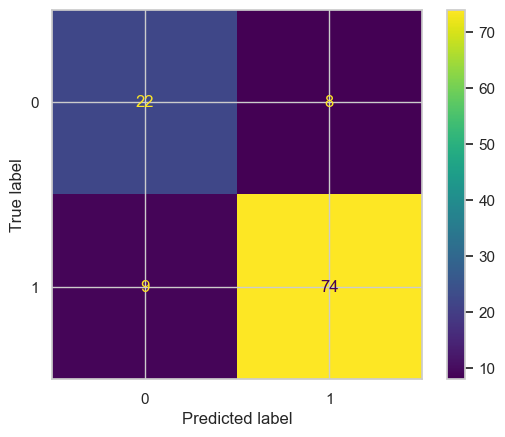

In [115]:
ConfusionMatrixDisplay.from_predictions(y_test, y_pred1)

### Grid Search CV

In [116]:
n_estimators = [100, 300, 700, 1000]
criterion = ['gini','entropy','log_loss']
max_depth = [10,20,50,100]
bootstrap=[True,False]
grid = dict(n_estimators=n_estimators, criterion=criterion, max_depth=max_depth, bootstrap=bootstrap) # creating dictionary to store the lists


In [117]:
GC_RF = GridSearchCV(estimator=RF_Model, param_grid=grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_RF_result = GC_RF.fit(x_cv ,y_cv) # fitting the grid search on the training data


In [118]:
print("Highest Recall is achieved using the parameters : " , ( GC_RF_result.best_params_))

Highest Recall is achieved using the parameters :  {'bootstrap': False, 'criterion': 'entropy', 'max_depth': 50, 'n_estimators': 1000}


In [119]:
RF_Model.n_estimators = GC_RF_result.best_params_['n_estimators']
RF_Model.criterion = GC_RF_result.best_params_['criterion']
RF_Model.max_depth = GC_RF_result.best_params_['max_depth']
RF_Model.bootstrap = GC_RF_result.best_params_['bootstrap']

In [120]:
RF_Model.fit(x_train,y_train)

RandomForestClassifier(bootstrap=False, criterion='entropy', max_depth=50,
                       n_estimators=1000)

In [121]:
ypred1=RF_Model.predict(x_test)

In [122]:
evaluate_model(y_test,ypred1)

Accuracy of the model is: 88.50 %
Precision of the model is: 89.77 %
Recall of the model is: 95.18 %
AUC value of the model is: 82.59 %
F1 score of the model is: 92.40 %


In [123]:
print(classification_report(y_test,ypred1))

              precision    recall  f1-score   support

           0       0.84      0.70      0.76        30
           1       0.90      0.95      0.92        83

    accuracy                           0.88       113
   macro avg       0.87      0.83      0.84       113
weighted avg       0.88      0.88      0.88       113



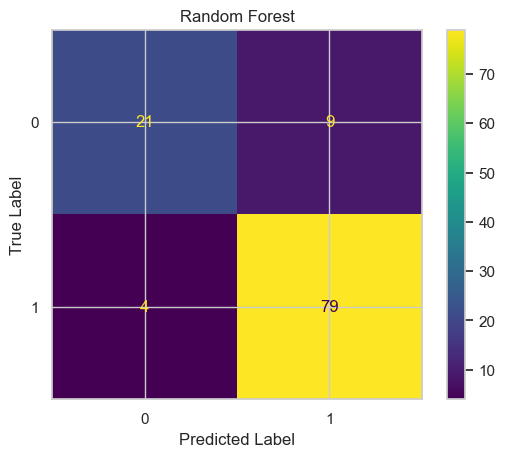

In [124]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred1)
plt.title('Random Forest')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

### Genetic Algorithm Search CV

In [61]:
param_grid = {'bootstrap': Categorical([True, False]),
              'max_depth': Integer(10, 100), 
              'n_estimators': Integer(100, 1000),
              'criterion' : Categorical(['gini','entropy','log_loss'])}
cv = StratifiedKFold(n_splits=3, shuffle=True)

In [62]:
RF_Model = RandomForestClassifier()
RF_evolved = GASearchCV(estimator=RF_Model,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=25,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

In [63]:
RF_evolved.fit(x_cv,y_cv)

gen	nevals	fitness	fitness_std	fitness_max	fitness_min
0  	10    	0.57845	0.0312182  	0.630624   	0.527381   
1  	19    	0.609206	0.0237678  	0.632243   	0.557464   
2  	18    	0.624736	0.0139603  	0.653243   	0.595779   
3  	19    	0.629062	0.0177463  	0.653243   	0.598365   
4  	19    	0.637787	0.0166103  	0.667953   	0.621425   
5  	18    	0.642419	0.0172588  	0.667953   	0.614927   
6  	17    	0.646046	0.0196294  	0.667953   	0.600216   
7  	18    	0.649313	0.0237026  	0.667953   	0.58539    
8  	17    	0.64982 	0.0274792  	0.667953   	0.589606   
9  	19    	0.654408	0.0211801  	0.667953   	0.594148   
10 	18    	0.655144	0.0227211  	0.667953   	0.589606   
11 	17    	0.662408	0.00726487 	0.667953   	0.644044   
12 	17    	0.651573	0.0214849  	0.668394   	0.612546   
13 	18    	0.65166 	0.0196368  	0.668394   	0.603022   
14 	19    	0.649039	0.0231653  	0.67316    	0.608975   
15 	18    	0.626996	0.0211001  	0.667953   	0.59707    
16 	16    	0.634365	0.0240911  	0.667953   	0.6089

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=3, random_state=None, shuffle=True),
           estimator=RandomForestClassifier(bootstrap=False,
                                            criterion='log_loss', max_depth=83,
                                            n_estimators=485),
           generations=25, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'bootstrap': <sklearn_genetic.space.space.Categorical object at 0x000001615358B370>,
                       'criterion': <sklearn_genetic.space.space.Categorical object at 0x0000016153637C10>,
                       'max_depth': <sklearn_genetic.space.space.Integer object at 0x00000161536369E0>,
                       'n_estimators': <sklearn_genetic.space.space.Integer object at 0x0000016153635360>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [64]:
RF_evolved.best_params_

{'bootstrap': False,
 'max_depth': 83,
 'n_estimators': 485,
 'criterion': 'log_loss'}

In [65]:
RF_Model.n_estimators = RF_evolved.best_params_['n_estimators']
RF_Model.criterion = RF_evolved.best_params_['criterion']
RF_Model.max_depth = RF_evolved.best_params_['max_depth']
RF_Model.bootstrap = RF_evolved.best_params_['bootstrap']

In [66]:
RF_Model.fit(x_train,y_train)

RandomForestClassifier(bootstrap=False, criterion='log_loss', max_depth=83,
                       n_estimators=485)

In [67]:
ypred1=RF_Model.predict(x_test)

In [68]:
evaluate_model(y_test,ypred1)

Accuracy of the model is: 86.73 %
Precision of the model is: 89.53 %
Recall of the model is: 92.77 %
AUC value of the model is: 81.39 %
F1 score of the model is: 91.12 %


In [69]:
print(classification_report(y_test,ypred1))

              precision    recall  f1-score   support

           0       0.78      0.70      0.74        30
           1       0.90      0.93      0.91        83

    accuracy                           0.87       113
   macro avg       0.84      0.81      0.82       113
weighted avg       0.86      0.87      0.86       113



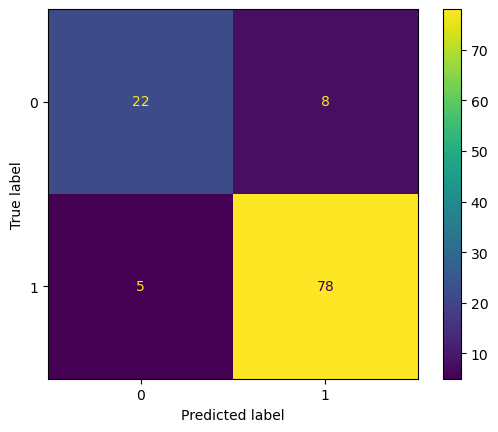

In [679]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred1)

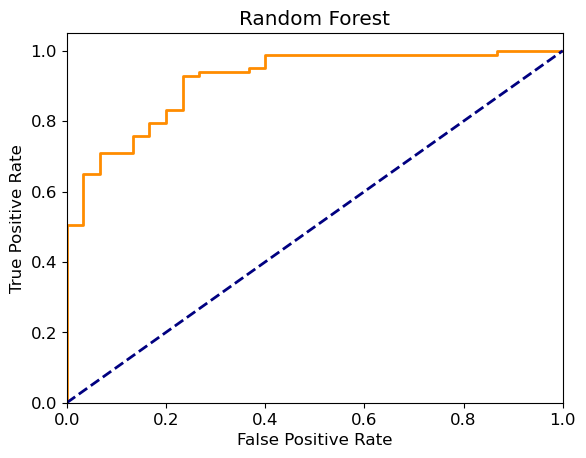

In [490]:
y_pred1 = RF_Model.predict_proba(x_test)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr1, tpr1, thresholds1 = roc_curve(y_test, y_pred1)
roc_auc1 = roc_auc_score(y_test, y_pred1)

# Plot the ROC curve for RandomForest model
plt.figure()
plt.plot(fpr1, tpr1, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest')
plt.show()

In [481]:
roc_auc1 = auc(fpr, tpr)
roc_auc1

0.9164658634538152

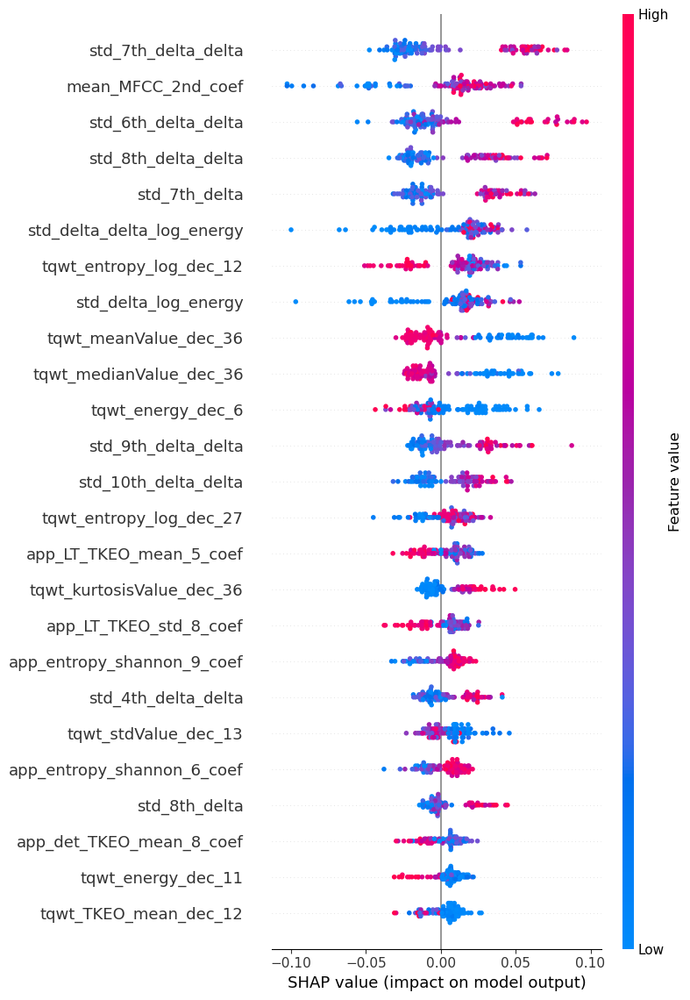

In [82]:
explainer = shap.TreeExplainer(RF_Model)


shap_values = explainer.shap_values(x_test)


feature_names = X.columns


shap.summary_plot(shap_values[1], x_test, feature_names=feature_names, max_display=25)

# Decision Tree Model

In [125]:
DT_Model=DecisionTreeClassifier()

In [126]:
DT_Model.fit(x_train,y_train)

DecisionTreeClassifier()

In [127]:
ypred2=DT_Model.predict(x_test)

In [128]:
evaluate_model(y_test,ypred2)

Accuracy of the model is: 75.22 %
Precision of the model is: 84.81 %
Recall of the model is: 80.72 %
AUC value of the model is: 70.36 %
F1 score of the model is: 82.72 %


In [129]:
print(classification_report(y_test,ypred2))

              precision    recall  f1-score   support

           0       0.53      0.60      0.56        30
           1       0.85      0.81      0.83        83

    accuracy                           0.75       113
   macro avg       0.69      0.70      0.69       113
weighted avg       0.76      0.75      0.76       113



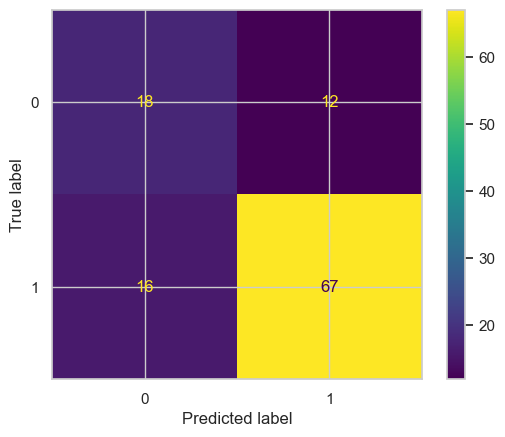

In [130]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred2)

### Grid Search CV

In [131]:
splitter= ['best','random']
criterion = ['gini','entropy','log_loss']
max_depth = [10,20,50,100,200,500]
grid = dict(splitter=splitter, criterion=criterion, max_depth=max_depth) # creating dictionary to store the lists


In [132]:
GC_DT = GridSearchCV(estimator=DT_Model, param_grid=grid, n_jobs=-1, cv=10, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_DT_result = GC_DT.fit(x_cv, y_cv)

In [133]:
print("Highest Recall is achieved using the parameters : " , ( GC_DT_result.best_params_))

Highest Recall is achieved using the parameters :  {'criterion': 'gini', 'max_depth': 20, 'splitter': 'random'}


In [134]:
DT_Model.splitter = GC_DT_result.best_params_['splitter']
DT_Model.criterion = GC_DT_result.best_params_['criterion']
DT_Model.max_depth = GC_DT_result.best_params_['max_depth']

In [135]:
DT_Model.fit(x_train,y_train)

DecisionTreeClassifier(max_depth=20, splitter='random')

In [136]:
ypred2=DT_Model.predict(x_test)

In [137]:
evaluate_model(y_test,ypred2)

Accuracy of the model is: 68.14 %
Precision of the model is: 84.06 %
Recall of the model is: 69.88 %
AUC value of the model is: 66.61 %
F1 score of the model is: 76.32 %


In [138]:
print(classification_report(y_test,ypred2))

              precision    recall  f1-score   support

           0       0.43      0.63      0.51        30
           1       0.84      0.70      0.76        83

    accuracy                           0.68       113
   macro avg       0.64      0.67      0.64       113
weighted avg       0.73      0.68      0.70       113



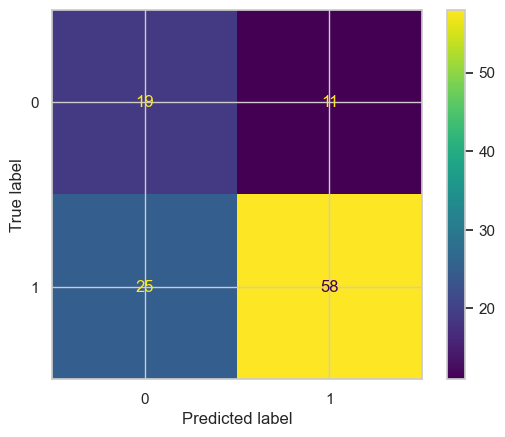

In [139]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred2)

### Genetic Algorithm CV

In [140]:
param_grid = { 'splitter' : Categorical(['best','random']),
              'criterion' : Categorical(['gini','entropy','log_loss']),
               'max_depth' : Integer(10,500)
             }

In [141]:
cv = StratifiedKFold(n_splits=10, shuffle=True)
DT_Model=DecisionTreeClassifier()
DT_evolved = GASearchCV(estimator=DT_Model,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=50,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

In [142]:
DT_evolved.fit(x_cv,y_cv)

gen	nevals	fitness 	fitness_std	fitness_max	fitness_min
0  	10    	0.583125	0.0548005  	0.679861   	0.510417   
1  	18    	0.599444	0.0400084  	0.65       	0.54375    
2  	17    	0.631389	0.0294559  	0.663194   	0.566667   
3  	17    	0.639306	0.0247093  	0.663194   	0.583333   
4  	20    	0.652708	0.0252408  	0.685417   	0.603472   
5  	20    	0.658194	0.0356647  	0.700694   	0.5625     
6  	18    	0.641597	0.0279102  	0.684722   	0.586806   
7  	19    	0.649306	0.0281486  	0.686111   	0.604861   
8  	16    	0.640764	0.0313656  	0.684722   	0.5625     
9  	19    	0.631597	0.0185177  	0.663194   	0.597222   
10 	18    	0.633333	0.0196884  	0.663194   	0.592361   
11 	17    	0.636736	0.0250336  	0.671528   	0.581944   
12 	19    	0.632639	0.037406   	0.700694   	0.565972   
13 	19    	0.637569	0.0466876  	0.700694   	0.573611   
14 	19    	0.650139	0.0351677  	0.700694   	0.609722   
15 	17    	0.671597	0.0418058  	0.700694   	0.56875    
16 	18    	0.675278	0.0357827  	0.700694   	0.58

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
           estimator=DecisionTreeClassifier(max_depth=417, splitter='random'),
           generations=50, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'criterion': <sklearn_genetic.space.space.Categorical object at 0x000002D8201F3250>,
                       'max_depth': <sklearn_genetic.space.space.Integer object at 0x000002D820247100>,
                       'splitter': <sklearn_genetic.space.space.Categorical object at 0x000002D8201F3790>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [143]:
DT_evolved.best_params_

{'splitter': 'random', 'criterion': 'gini', 'max_depth': 417}

In [144]:
DT_Model.splitter = DT_evolved.best_params_['splitter']
DT_Model.criterion = DT_evolved.best_params_['criterion']
DT_Model.max_depth = DT_evolved.best_params_['max_depth']

In [145]:
DT_Model.fit(x_train,y_train)

DecisionTreeClassifier(max_depth=417, splitter='random')

In [146]:
ypred2=DT_Model.predict(x_test)

In [147]:
evaluate_model(y_test,ypred2)

Accuracy of the model is: 78.76 %
Precision of the model is: 86.42 %
Recall of the model is: 84.34 %
AUC value of the model is: 73.84 %
F1 score of the model is: 85.37 %


In [148]:
print(classification_report(y_test,ypred2))

              precision    recall  f1-score   support

           0       0.59      0.63      0.61        30
           1       0.86      0.84      0.85        83

    accuracy                           0.79       113
   macro avg       0.73      0.74      0.73       113
weighted avg       0.79      0.79      0.79       113



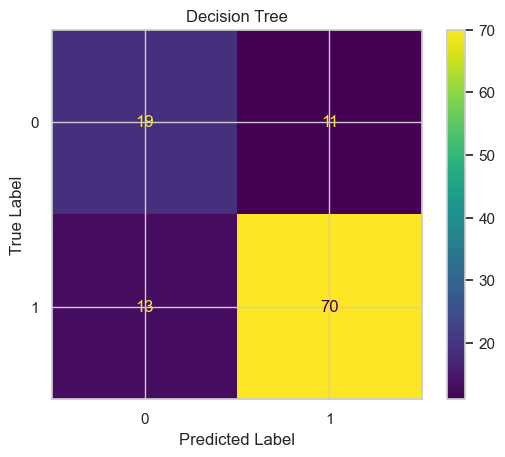

In [149]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred2)
plt.title('Decision Tree')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

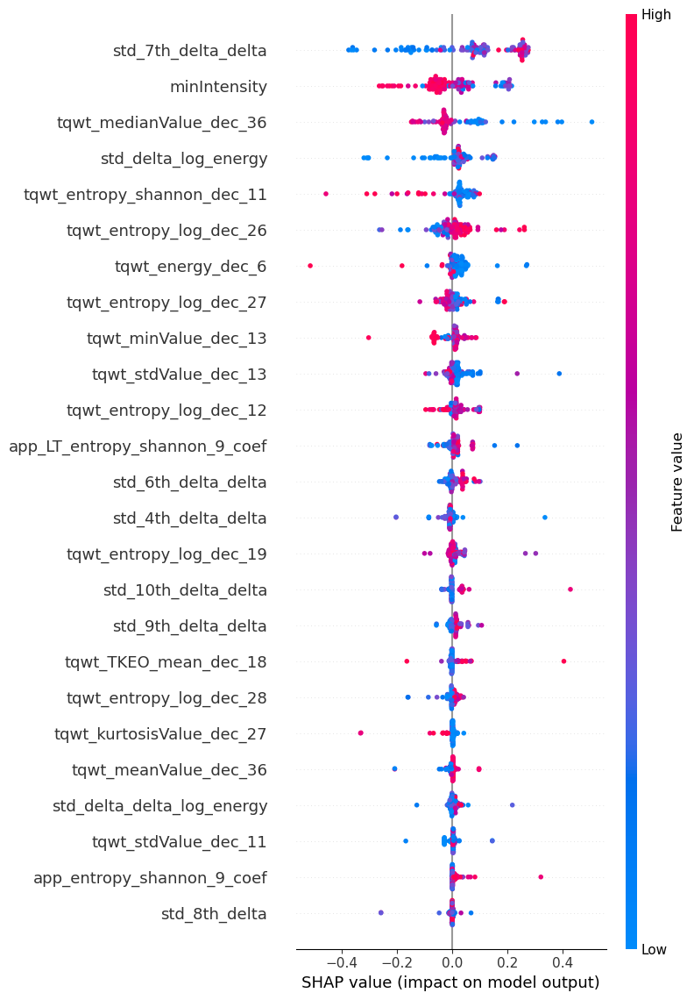

In [98]:
explainer = shap.TreeExplainer(DT_Model)

# Calculate SHAP values
shap_values = explainer.shap_values(x_test, check_additivity=False)

# Define feature names
feature_names = X.columns

# Create a summary plot for class 1 (positive class)
shap.summary_plot(shap_values[1], x_test, feature_names=feature_names, max_display=25)

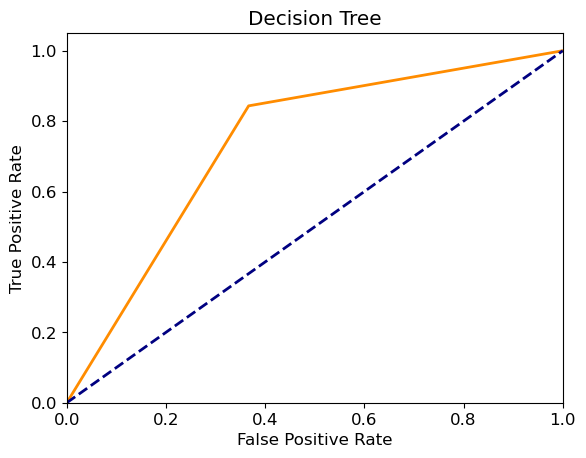

In [494]:
y_pred2 = DT_Model.predict_proba(x_test)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr2, tpr2, thresholds2 = roc_curve(y_test, y_pred2)
roc_auc2 = roc_auc_score(y_test, y_pred2)

# Plot the ROC curve for Decision Tree model
plt.figure()
plt.plot(fpr2, tpr2, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree')
plt.show()

# SVM Model

In [174]:
SVM_Model=SVC(probability=True)

In [175]:
SVM_Model.fit(x_train,y_train)

SVC(probability=True)

In [176]:
ypred3= SVM_Model.predict(x_test)

In [177]:
evaluate_model(y_test,ypred3)

Accuracy of the model is: 86.73 %
Precision of the model is: 92.50 %
Recall of the model is: 89.16 %
AUC value of the model is: 84.58 %
F1 score of the model is: 90.80 %


In [178]:
print(classification_report(y_test,ypred3))

              precision    recall  f1-score   support

           0       0.73      0.80      0.76        30
           1       0.93      0.89      0.91        83

    accuracy                           0.87       113
   macro avg       0.83      0.85      0.83       113
weighted avg       0.87      0.87      0.87       113



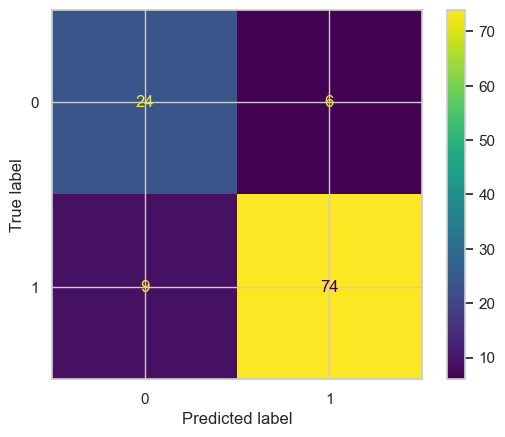

In [179]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred3)

In [180]:
C = [1.0 , 5.0, 10.0 , 20.0]
kernel = ['linear','poly','rbf','sigmoid']
degree =[2,3,5,7]
gamma = ['scale','auto']
grid = dict(C =C , kernel = kernel , gamma =gamma , degree = degree) # creating dictionary to store the lists


In [181]:
GC_SVM = GridSearchCV(estimator=SVM_Model, param_grid=grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_SVM_result = GC_SVM.fit(x_cv, y_cv) # fitting the grid search on the training data


In [182]:
print("Highest Recall is achieved using the parameters : " , ( GC_SVM_result.best_params_))

Highest Recall is achieved using the parameters :  {'C': 20.0, 'degree': 2, 'gamma': 'scale', 'kernel': 'rbf'}


In [183]:
SVM_Model.C = GC_SVM_result.best_params_['C']
SVM_Model.kernel = GC_SVM_result.best_params_['kernel']
SVM_Model.gamma = GC_SVM_result.best_params_['gamma']
SVM_Model.degree = GC_SVM_result.best_params_['degree']

In [184]:
SVM_Model.fit(x_train,y_train)

SVC(C=20.0, degree=2, probability=True)

In [185]:
ypred3=SVM_Model.predict(x_test)

In [186]:
evaluate_model(y_test,ypred3)

Accuracy of the model is: 93.81 %
Precision of the model is: 96.34 %
Recall of the model is: 95.18 %
AUC value of the model is: 92.59 %
F1 score of the model is: 95.76 %


In [187]:
print(classification_report(y_test,ypred3))

              precision    recall  f1-score   support

           0       0.87      0.90      0.89        30
           1       0.96      0.95      0.96        83

    accuracy                           0.94       113
   macro avg       0.92      0.93      0.92       113
weighted avg       0.94      0.94      0.94       113



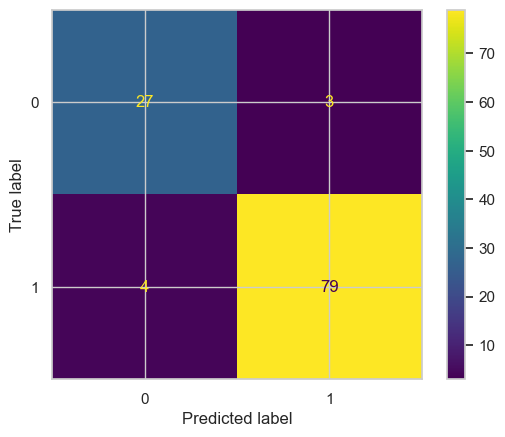

In [188]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred3)

In [189]:
param_grid = {'kernel': Categorical(['linear','poly','rbf','sigmoid']),
              'C': Integer(1, 20), 
              'degree': Integer(2, 10), 
              'gamma': Categorical(['scale','auto'])}
cv = StratifiedKFold(n_splits=10, shuffle=True)



In [190]:
SVM_Model=SVC()
SVM_evolved = GASearchCV(estimator=SVM_Model,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=50,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

In [191]:
SVM_evolved.fit(x_cv,y_cv)

gen	nevals	fitness 	fitness_std	fitness_max	fitness_min
0  	10    	0.597778	0.0522366  	0.703472   	0.545833   
1  	17    	0.651875	0.0625787  	0.740278   	0.558333   
2  	20    	0.705347	0.0462805  	0.75       	0.636806   
3  	18    	0.732361	0.0241167  	0.75       	0.66875    
4  	20    	0.745417	0.00733749 	0.75       	0.727083   
5  	18    	0.750764	0.0018491  	0.753472   	0.748611   
6  	19    	0.753542	0.00462158 	0.766667   	0.75       
7  	19    	0.75    	0.011587   	0.766667   	0.726389   
8  	18    	0.743819	0.0171612  	0.766667   	0.70625    
9  	19    	0.749306	0.0133832  	0.766667   	0.726389   
10 	16    	0.755486	0.0130232  	0.766667   	0.725694   
11 	16    	0.753403	0.00986233 	0.766667   	0.734028   
12 	18    	0.755   	0.00763763 	0.766667   	0.75       
13 	16    	0.757431	0.0116784  	0.766667   	0.728472   
14 	18    	0.759861	0.00879398 	0.766667   	0.74375    
15 	17    	0.758264	0.0123191  	0.766667   	0.727778   
16 	18    	0.756597	0.0121686  	0.766667   	0.72

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
           estimator=SVC(C=12, degree=9), generations=50, keep_top_k=4,
           mutation_probability=0.1, n_jobs=-1,
           param_grid={'C': <sklearn_genetic.space.space.Integer object at 0x000002D825684AC0>,
                       'degree': <sklearn_genetic.space.space.Integer object at 0x000002D825684D00>,
                       'gamma': <sklearn_genetic.space.space.Categorical object at 0x000002D825698A00>,
                       'kernel': <sklearn_genetic.space.space.Categorical object at 0x000002D8256844F0>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [192]:
SVM_Model.C = SVM_evolved.best_params_['C']
SVM_Model.kernel = SVM_evolved.best_params_['kernel']
SVM_Model.gamma = SVM_evolved.best_params_['gamma']
SVM_Model.degree = SVM_evolved.best_params_['degree']
SVM_Model.probability = True

In [193]:
SVM_Model.fit(x_train,y_train)

SVC(C=12, degree=9, probability=True)

In [194]:
ypred3=SVM_evolved.predict(x_test)

In [195]:
evaluate_model(y_test,ypred3)

Accuracy of the model is: 93.81 %
Precision of the model is: 97.50 %
Recall of the model is: 93.98 %
AUC value of the model is: 93.65 %
F1 score of the model is: 95.71 %


In [196]:
print(classification_report(y_test,ypred3))

              precision    recall  f1-score   support

           0       0.85      0.93      0.89        30
           1       0.97      0.94      0.96        83

    accuracy                           0.94       113
   macro avg       0.91      0.94      0.92       113
weighted avg       0.94      0.94      0.94       113



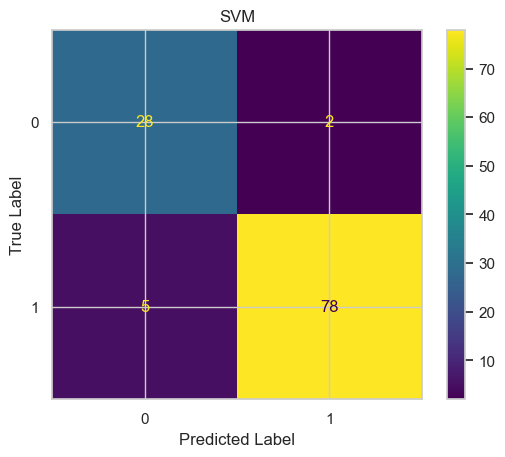

In [197]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred3)
plt.title('SVM')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

  0%|          | 0/113 [00:00<?, ?it/s]

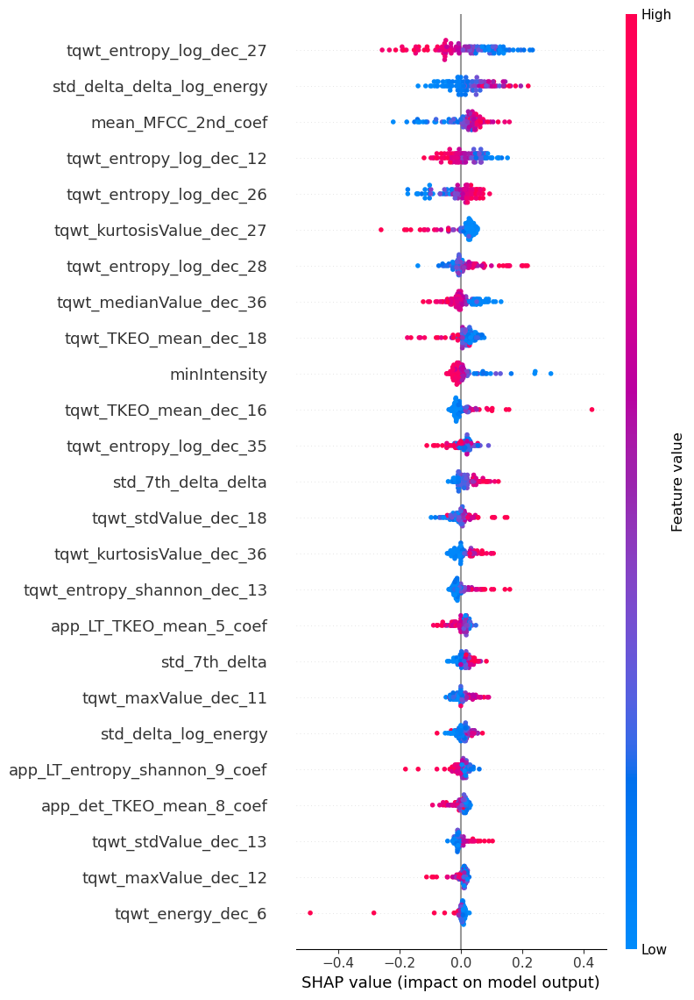

In [116]:
explainer = shap.KernelExplainer(SVM_Model.predict_proba, shap.sample(x_train, 30))

#Compute SHAP values for the test data
shap_values = explainer.shap_values(x_test)

#Plot the summary plot
shap.summary_plot(shap_values[1], x_test, feature_names=feature_names, max_display=25)

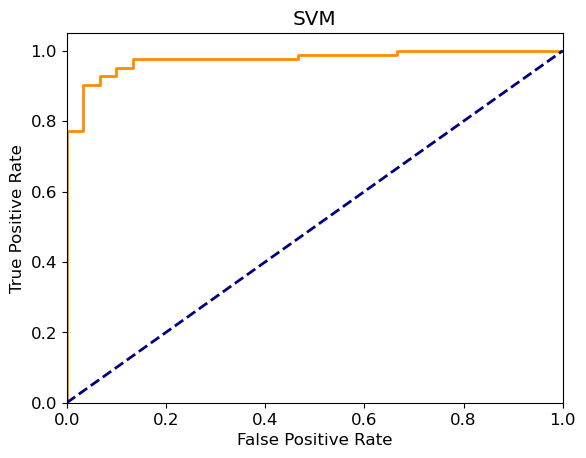

In [496]:
y_pred3 = SVM_Model.predict_proba(x_test)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr3, tpr3, thresholds3 = roc_curve(y_test, y_pred3)

# Plot the ROC curve for Decision Tree model
plt.figure()
plt.plot(fpr3, tpr3, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('SVM')
plt.show()

# Logistic Regression

In [198]:
LR_Model = LogisticRegression()

In [199]:
LR_Model.fit(x_train,y_train)

LogisticRegression()

In [200]:
ypred4=LR_Model.predict(x_test)

In [201]:
evaluate_model(y_test,ypred4)

Accuracy of the model is: 80.53 %
Precision of the model is: 90.67 %
Recall of the model is: 81.93 %
AUC value of the model is: 79.30 %
F1 score of the model is: 86.08 %


In [202]:
print(classification_report(y_test, ypred4))

              precision    recall  f1-score   support

           0       0.61      0.77      0.68        30
           1       0.91      0.82      0.86        83

    accuracy                           0.81       113
   macro avg       0.76      0.79      0.77       113
weighted avg       0.83      0.81      0.81       113



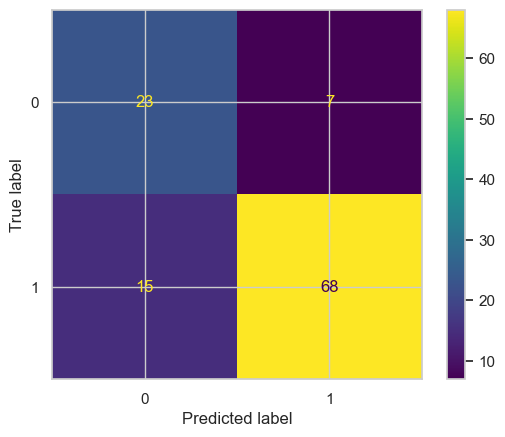

In [203]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred4)

In [204]:
solver =  ['lbfgs', 'liblinear', 'newton-cg', 'sag']
max_iter = [100,300,500,1000]
LR_Grid = dict(solver=solver , max_iter=max_iter)

In [205]:
GC_LR = GridSearchCV(estimator=LR_Model, param_grid=LR_Grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_LR_result = GC_LR.fit(x_cv, y_cv) # fitting the grid search on the training data


In [206]:
print("Best parameters : %s" % GC_LR_result.best_params_)

Best parameters : {'max_iter': 100, 'solver': 'sag'}


In [207]:
LR_Model.solver = GC_LR_result.best_params_['solver']
LR_Model.max_iter = GC_LR_result.best_params_['max_iter']

In [208]:
LR_Model.fit(x_train,y_train)

LogisticRegression(solver='sag')

In [209]:
ypred4=LR_Model.predict(x_test)

In [210]:
evaluate_model(y_test,ypred4)

Accuracy of the model is: 81.42 %
Precision of the model is: 90.79 %
Recall of the model is: 83.13 %
AUC value of the model is: 79.90 %
F1 score of the model is: 86.79 %


In [211]:
print(classification_report(y_test, ypred4))

              precision    recall  f1-score   support

           0       0.62      0.77      0.69        30
           1       0.91      0.83      0.87        83

    accuracy                           0.81       113
   macro avg       0.76      0.80      0.78       113
weighted avg       0.83      0.81      0.82       113



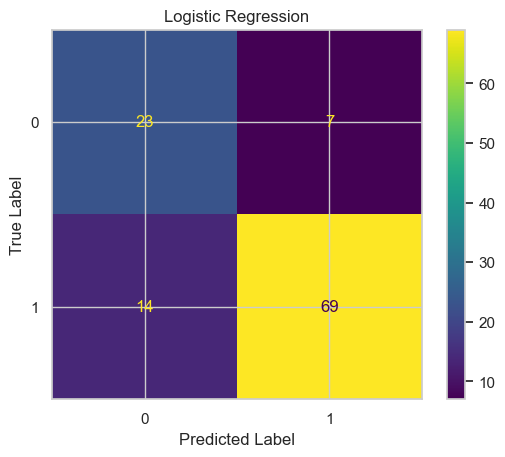

In [212]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred4)
plt.title('Logistic Regression')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [213]:
param_grid = {'solver': Categorical(['lbfgs', 'liblinear', 'newton-cg', 'sag']),
              'max_iter': Integer(10, 1000)}
cv = StratifiedKFold(n_splits=10, shuffle=True)

In [214]:
LR_Model=LR_Model = LogisticRegression()
LR_evolved = GASearchCV(estimator=LR_Model,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=50,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

In [215]:
LR_evolved.fit(x_cv,y_cv)

gen	nevals	fitness 	fitness_std	fitness_max	fitness_min
0  	10    	0.680972	0.0340266  	0.730556   	0.615972   
1  	19    	0.707778	0.016813   	0.730556   	0.684028   
2  	18    	0.724583	0.00888346 	0.734722   	0.709028   
3  	20    	0.727153	0.0134531  	0.751389   	0.697222   
4  	18    	0.732222	0.00992934 	0.751389   	0.723611   
5  	15    	0.737778	0.0111855  	0.751389   	0.723611   
6  	17    	0.741319	0.00945695 	0.751389   	0.73125    
7  	17    	0.743958	0.00756307 	0.751389   	0.73125    
8  	20    	0.744861	0.0154947  	0.765972   	0.720139   
9  	17    	0.743264	0.0174112  	0.765972   	0.717361   
10 	18    	0.744722	0.0165482  	0.765972   	0.727778   
11 	19    	0.747986	0.0162371  	0.765972   	0.727778   
12 	18    	0.742778	0.0153257  	0.765972   	0.720139   
13 	20    	0.744375	0.0176762  	0.765972   	0.715278   
14 	17    	0.741597	0.0173067  	0.765972   	0.713194   
15 	18    	0.746319	0.015729   	0.765972   	0.720833   
16 	16    	0.763125	0.00563699 	0.765972   	0.74

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
           estimator=LogisticRegression(max_iter=241, solver='sag'),
           generations=50, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'max_iter': <sklearn_genetic.space.space.Integer object at 0x000002D827BC6D10>,
                       'solver': <sklearn_genetic.space.space.Categorical object at 0x000002D827BC5240>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [240]:
LR_evolved.best_params_

{'solver': 'sag', 'max_iter': 188}

In [216]:
LR_Model.solver =LR_evolved.best_params_['solver']
LR_Model.max_iter = LR_evolved.best_params_['max_iter']

In [217]:
LR_Model.fit(x_train,y_train)

LogisticRegression(max_iter=241, solver='sag')

In [218]:
ypred4=LR_Model.predict(x_test)

In [219]:
evaluate_model(y_test,ypred4)

Accuracy of the model is: 80.53 %
Precision of the model is: 90.67 %
Recall of the model is: 81.93 %
AUC value of the model is: 79.30 %
F1 score of the model is: 86.08 %


In [280]:
print(classification_report(y_test, ypred4))


              precision    recall  f1-score   support

           0       0.66      0.70      0.68        30
           1       0.89      0.87      0.88        83

    accuracy                           0.82       113
   macro avg       0.77      0.78      0.78       113
weighted avg       0.83      0.82      0.82       113



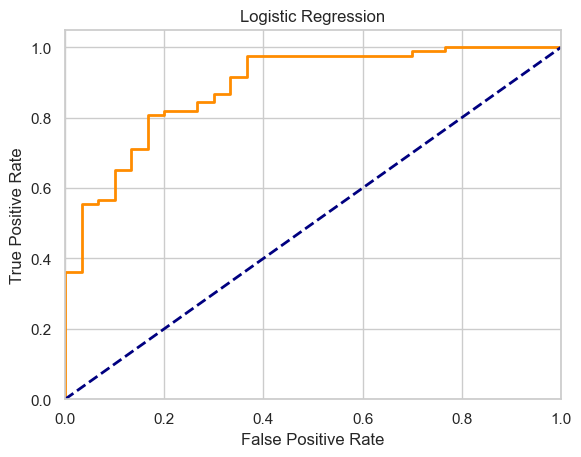

In [221]:
y_pred4 = LR_Model.predict_proba(x_test)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr4, tpr4, thresholds4 = roc_curve(y_test, y_pred4)

plt.figure()
plt.plot(fpr4, tpr4, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Logistic Regression')
plt.show()

# XGBoost

In [222]:
XGB_Model = XGBClassifier() 


In [223]:
XGB_Model.fit(x_train, y_train) #fitting the model 
ypred4 = XGB_Model.predict(x_test)

In [224]:
evaluate_model(y_test,ypred4)

Accuracy of the model is: 82.30 %
Precision of the model is: 88.89 %
Recall of the model is: 86.75 %
AUC value of the model is: 78.37 %
F1 score of the model is: 87.80 %


In [225]:
print(classification_report(y_test, ypred4))

              precision    recall  f1-score   support

           0       0.66      0.70      0.68        30
           1       0.89      0.87      0.88        83

    accuracy                           0.82       113
   macro avg       0.77      0.78      0.78       113
weighted avg       0.83      0.82      0.82       113



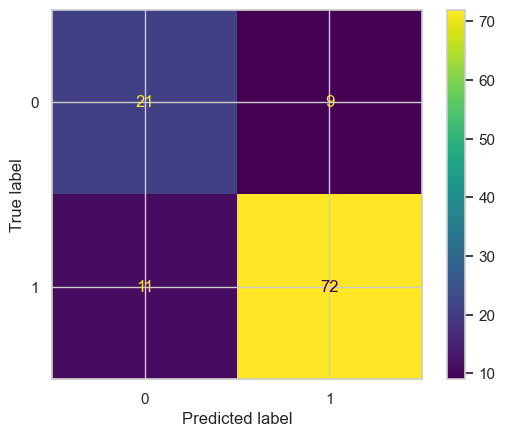

In [226]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred4)

### GridSearch CV

In [227]:
n_estimators = [100, 300, 700, 1000]
subsample = [0.3,0.5,0.7,1.0]
max_depth = [2,4,10,20]
grid = dict(n_estimators=n_estimators, subsample=subsample, max_depth=max_depth) # creating dictionary to store the lists
grid_search = GridSearchCV(estimator=XGB_Model, param_grid=grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
grid_result = grid_search.fit(x_cv, y_cv) # fitting the grid search on the training data
print("Highest ROC AUC is achieved using the parameters : " , ( grid_result.best_params_))

Highest ROC AUC is achieved using the parameters :  {'max_depth': 4, 'n_estimators': 300, 'subsample': 0.3}


In [228]:
XGB_Model.n_estimators = grid_result.best_params_['n_estimators']
XGB_Model.subsample = grid_result.best_params_['subsample']
XGB_Model.max_depth = grid_result.best_params_['max_depth']

In [229]:
XGB_Model.fit(x_train, y_train) #fitting the model 
y_pred2 = XGB_Model.predict(x_test)

In [230]:
evaluate_model(y_test,y_pred2)

Accuracy of the model is: 83.19 %
Precision of the model is: 94.44 %
Recall of the model is: 81.93 %
AUC value of the model is: 84.30 %
F1 score of the model is: 87.74 %


In [231]:
print(classification_report(y_test, y_pred2))

              precision    recall  f1-score   support

           0       0.63      0.87      0.73        30
           1       0.94      0.82      0.88        83

    accuracy                           0.83       113
   macro avg       0.79      0.84      0.80       113
weighted avg       0.86      0.83      0.84       113



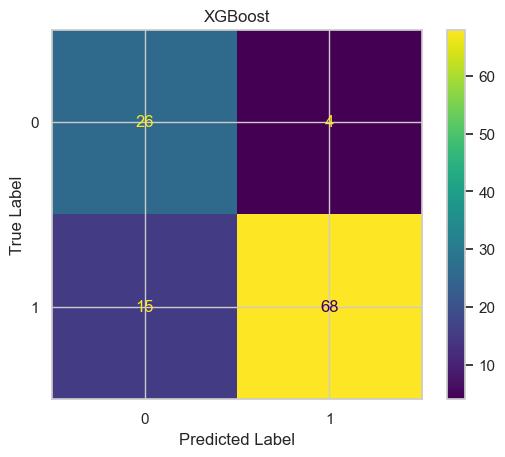

In [232]:
ConfusionMatrixDisplay.from_predictions(y_test, y_pred2)
plt.title('XGBoost')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

### Genetic Algorithm Search CV

In [257]:
param_grid = {'n_estimators' : Integer(100, 1000),
              'subsample' : Continuous(0.3,1.0),
              'max_depth' : Integer(2,20)
             }
cv = StratifiedKFold(n_splits=5, shuffle=True)



In [258]:
XGB_Model = XGBClassifier() 
XGB_evolved = GASearchCV(estimator=XGB_Model,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=30,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)


In [259]:
XGB_evolved.fit(x_cv,y_cv)

gen	nevals	fitness 	fitness_std	fitness_max	fitness_min
0  	10    	0.607652	0.0350117  	0.6743     	0.558473   
1  	18    	0.647614	0.0252028  	0.686064   	0.601611   
2  	15    	0.668775	0.0255891  	0.699177   	0.613743   
3  	15    	0.666106	0.0299355  	0.686064   	0.60548    
4  	19    	0.661064	0.0247906  	0.686064   	0.622742   
5  	18    	0.678797	0.00941921 	0.686064   	0.6566     
6  	16    	0.677511	0.0119411  	0.686064   	0.647829   
7  	19    	0.675229	0.0157811  	0.701698   	0.650945   
8  	20    	0.664657	0.0139325  	0.686064   	0.647584   
9  	20    	0.646907	0.0259979  	0.686064   	0.583316   
10 	15    	0.671243	0.0132798  	0.686064   	0.655777   
11 	19    	0.67198 	0.0306514  	0.709349   	0.605847   
12 	19    	0.679935	0.0139083  	0.694695   	0.644555   
13 	16    	0.675732	0.0174451  	0.694695   	0.640161   
14 	18    	0.677812	0.0144295  	0.686064   	0.640756   
15 	20    	0.663934	0.0211766  	0.686064   	0.613375   
16 	17    	0.670403	0.00867527 	0.686064   	0.66

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=True),
           estimator=XGBClassifier(base_score=None, booster=None,
                                   callbacks=None, colsample_bylevel=None,
                                   colsample_bynode=None, colsample_bytree=None,
                                   early_stopping_rounds=None,
                                   enable_categorical=False, eval_metric=None,
                                   feature_types=None, gamma=None, gpu_id=None,
                                   grow_...
           generations=30, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'max_depth': <sklearn_genetic.space.space.Integer object at 0x00000161583400D0>,
                       'n_estimators': <sklearn_genetic.space.space.Integer object at 0x00000161583403A0>,
                       'subsample': <sklearn_genetic.space.space.Continuous object at 0x0000016158340100>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [260]:
XGB_Model.n_estimators = XGB_evolved.best_params_['n_estimators']
XGB_Model.subsample = XGB_evolved.best_params_['subsample']
XGB_Model.max_depth = XGB_evolved.best_params_['max_depth']

In [261]:
XGB_Model.fit(x_train, y_train)
ypred4 = XGB_Model.predict(x_test)

In [262]:
evaluate_model(y_test,y_pred2)

Accuracy of the model is: 90.27 %
Precision of the model is: 93.90 %
Recall of the model is: 92.77 %
AUC value of the model is: 88.05 %
F1 score of the model is: 93.33 %


In [263]:
print(classification_report(y_test, y_pred2))

              precision    recall  f1-score   support

           0       0.81      0.83      0.82        30
           1       0.94      0.93      0.93        83

    accuracy                           0.90       113
   macro avg       0.87      0.88      0.88       113
weighted avg       0.90      0.90      0.90       113



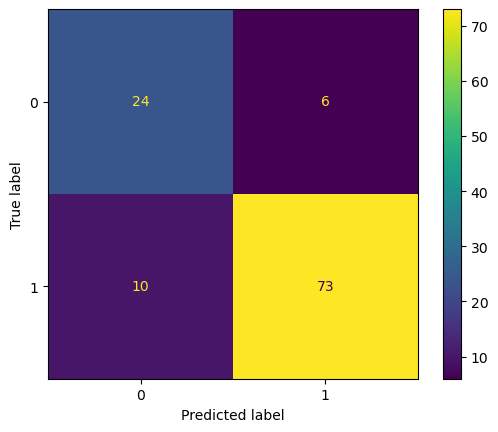

In [264]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred4)

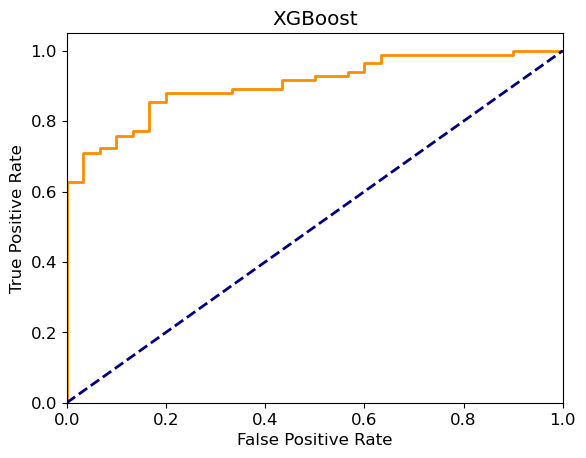

In [498]:
y_pred5 = XGB_Model.predict_proba(x_test)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr5, tpr5, thresholds5 = roc_curve(y_test, y_pred5)

plt.figure()
plt.plot(fpr5, tpr5, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('XGBoost')
plt.show()

# KNN Model

In [233]:
KNN_Model = KNeighborsClassifier(n_neighbors=1)

In [234]:
KNN_Model.fit(x_train,y_train)

KNeighborsClassifier(n_neighbors=1)

In [235]:
ypred6=KNN_Model.predict(x_test)

In [236]:
evaluate_model(y_test,ypred6)

Accuracy of the model is: 88.50 %
Precision of the model is: 93.75 %
Recall of the model is: 90.36 %
AUC value of the model is: 86.85 %
F1 score of the model is: 92.02 %


In [237]:
print(classification_report(y_test, ypred6))

              precision    recall  f1-score   support

           0       0.76      0.83      0.79        30
           1       0.94      0.90      0.92        83

    accuracy                           0.88       113
   macro avg       0.85      0.87      0.86       113
weighted avg       0.89      0.88      0.89       113



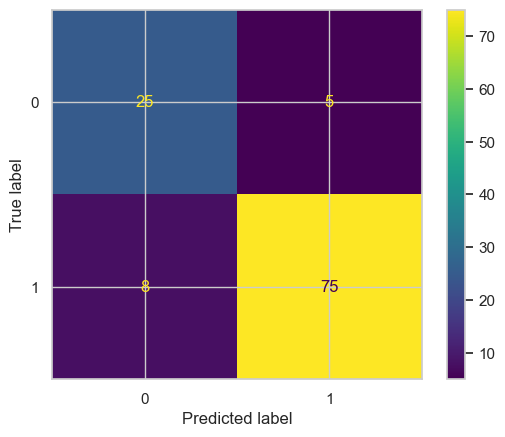

In [238]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred6)

In [239]:
n_neighbors = [1,2,5,10,20]
weights =['uniform', 'distance']
algorithm =['auto', 'ball_tree', 'kd_tree', 'brute']
p=[2,5,10,20]
grid = dict(n_neighbors =n_neighbors,weights =weights,algorithm =algorithm , p=p) # creating dictionary to store the lists


In [240]:
GC_KNN = GridSearchCV(estimator=KNN_Model, param_grid=grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_KNN_result = GC_KNN.fit(x_cv, y_cv) # fitting the grid search on the training data


In [241]:
print("Highest Recall is achieved using the parameters : " , ( GC_KNN_result.best_params_))

Highest Recall is achieved using the parameters :  {'algorithm': 'auto', 'n_neighbors': 1, 'p': 10, 'weights': 'uniform'}


In [242]:
KNN_Model.n_neighbors= GC_KNN_result.best_params_['n_neighbors']
KNN_Model.weights= GC_KNN_result.best_params_['weights']
KNN_Model.algorithm = GC_KNN_result.best_params_['algorithm']
KNN_Model.p= GC_KNN_result.best_params_['p']

In [243]:
KNN_Model.fit(x_train,y_train)

KNeighborsClassifier(n_neighbors=1, p=10)

In [244]:
ypred6=KNN_Model.predict(x_test)

In [245]:
evaluate_model(y_test,ypred6)

Accuracy of the model is: 83.19 %
Precision of the model is: 91.03 %
Recall of the model is: 85.54 %
AUC value of the model is: 81.10 %
F1 score of the model is: 88.20 %


In [246]:
print(classification_report(y_test, ypred6))

              precision    recall  f1-score   support

           0       0.66      0.77      0.71        30
           1       0.91      0.86      0.88        83

    accuracy                           0.83       113
   macro avg       0.78      0.81      0.79       113
weighted avg       0.84      0.83      0.84       113



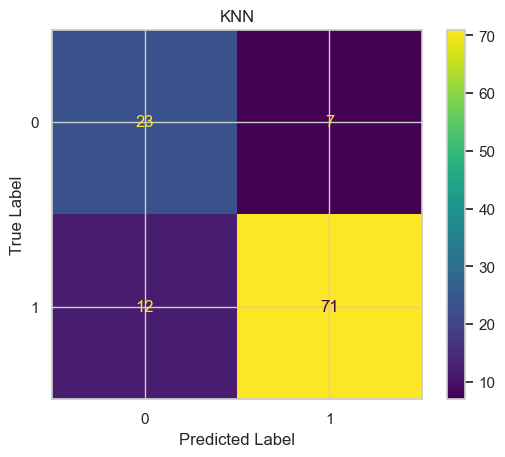

In [247]:
ConfusionMatrixDisplay.from_predictions(y_test, ypred6)
plt.title('KNN')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [248]:
param_grid = {'n_neighbors' : Integer(1,10),
               'weights': Categorical(['uniform', 'distance']),
               'algorithm' : Categorical(['auto', 'ball_tree', 'kd_tree', 'brute']),
               'p':Integer(2,20)
             }
cv = StratifiedKFold(n_splits=3, shuffle=True)

In [249]:
KNN_Model =  KNeighborsClassifier() 
KNN_evolved = GASearchCV(estimator=KNN_Model,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=50,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

In [250]:
KNN_evolved.fit(x_cv,y_cv)

gen	nevals	fitness 	fitness_std	fitness_max	fitness_min
0  	10    	0.651805	0.0571394  	0.701271   	0.518827   
1  	16    	0.696175	0.0317996  	0.738628   	0.625966   
2  	19    	0.735198	0.023916   	0.759175   	0.693923   
3  	19    	0.746112	0.0113396  	0.761997   	0.726082   
4  	17    	0.749598	0.0175883  	0.761997   	0.703648   
5  	17    	0.747435	0.0191691  	0.761997   	0.703648   
6  	16    	0.754881	0.0215257  	0.77684    	0.715232   
7  	20    	0.758941	0.0159721  	0.77684    	0.72001    
8  	20    	0.751253	0.0158152  	0.77684    	0.710915   
9  	19    	0.751242	0.0171977  	0.77684    	0.719793   
10 	18    	0.759535	0.018371   	0.77684    	0.731914   
11 	17    	0.757595	0.0190857  	0.77684    	0.715793   
12 	20    	0.742085	0.017778   	0.774667   	0.711981   
13 	18    	0.733651	0.032171   	0.774667   	0.668823   
14 	18    	0.729229	0.0233991  	0.754842   	0.668823   
15 	20    	0.737554	0.0174205  	0.754842   	0.703868   
16 	18    	0.745239	0.014828   	0.760927   	0.70

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=3, random_state=None, shuffle=True),
           estimator=KNeighborsClassifier(algorithm='ball_tree', n_neighbors=2,
                                          p=4, weights='distance'),
           generations=50, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'algorithm': <sklearn_genetic.space.space.Categorical object at 0x000002D827EECF10>,
                       'n_neighbors': <sklearn_genetic.space.space.Integer object at 0x000002D827EEE590>,
                       'p': <sklearn_genetic.space.space.Integer object at 0x000002D827EEE6E0>,
                       'weights': <sklearn_genetic.space.space.Categorical object at 0x000002D827F129B0>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [251]:
KNN_evolved.best_params_

{'n_neighbors': 2, 'weights': 'distance', 'algorithm': 'ball_tree', 'p': 4}

In [252]:
KNN_Model.n_neighbors= KNN_evolved.best_params_['n_neighbors']
KNN_Model.weights= KNN_evolved.best_params_['weights']
KNN_Model.algorithm = KNN_evolved.best_params_['algorithm']
KNN_Model.p= KNN_evolved.best_params_['p']

In [253]:
KNN_Model.fit(x_train,y_train)

KNeighborsClassifier(algorithm='ball_tree', n_neighbors=2, p=4,
                     weights='distance')

In [254]:
ypred6=KNN_Model.predict(x_test)

In [255]:
evaluate_model(y_test,ypred6)

Accuracy of the model is: 87.61 %
Precision of the model is: 92.59 %
Recall of the model is: 90.36 %
AUC value of the model is: 85.18 %
F1 score of the model is: 91.46 %


In [256]:
print(classification_report(y_test, ypred6))

              precision    recall  f1-score   support

           0       0.75      0.80      0.77        30
           1       0.93      0.90      0.91        83

    accuracy                           0.88       113
   macro avg       0.84      0.85      0.84       113
weighted avg       0.88      0.88      0.88       113



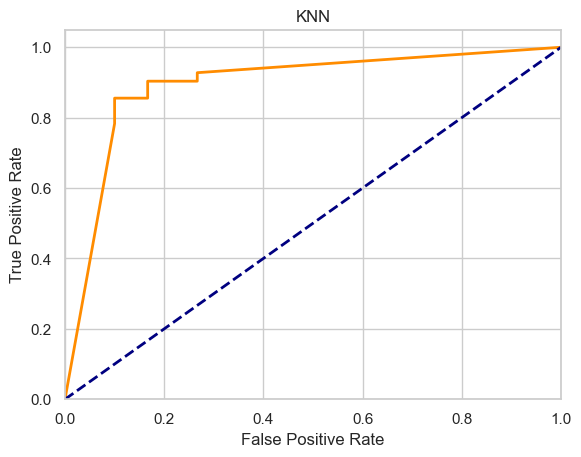

In [257]:
y_pred6 = KNN_Model.predict_proba(x_test)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr6, tpr6, thresholds6 = roc_curve(y_test, y_pred6)

plt.figure()
plt.plot(fpr6, tpr6, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('KNN')
plt.show()

## MLP

In [258]:
from sklearn.neural_network import MLPClassifier

mlp_model = MLPClassifier()


mlp_model.fit(x_train, y_train)

MLPClassifier()

In [259]:
y_pred_m= mlp_model.predict(x_test)

In [260]:
evaluate_model(y_pred_m,y_test)

Accuracy of the model is: 92.04 %
Precision of the model is: 96.39 %
Recall of the model is: 93.02 %
AUC value of the model is: 90.96 %
F1 score of the model is: 94.67 %


In [261]:
print(classification_report(y_test, y_pred_m))

              precision    recall  f1-score   support

           0       0.89      0.80      0.84        30
           1       0.93      0.96      0.95        83

    accuracy                           0.92       113
   macro avg       0.91      0.88      0.89       113
weighted avg       0.92      0.92      0.92       113



In [262]:
hidden_layer_sizes = [(100,), (100, 50), (50, 50),(100,50,25),(100,50,25,10)]
activation = ['relu', 'logistic']
solver = ['adam', 'sgd']
alpha = [0.0001, 0.001, 0.01]
max_iter = [200, 500, 1000]
param_grid = dict(hidden_layer_sizes=hidden_layer_sizes, activation=activation, solver=solver, alpha=alpha, max_iter=max_iter)
mlp_model = MLPClassifier()

grid_mlp = GridSearchCV(estimator=mlp_model, param_grid=param_grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0)


grid_mlp_result = grid_mlp.fit(x_cv, y_cv)

print("Highest Recall is achieved using the parameters:", grid_mlp_result.best_params_)

mlp_model.set_params(**grid_mlp_result.best_params_)

Highest Recall is achieved using the parameters: {'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 500, 'solver': 'adam'}


MLPClassifier(alpha=0.001, max_iter=500)

In [263]:
mlp_model.fit(x_train, y_train)

MLPClassifier(alpha=0.001, max_iter=500)

In [264]:
y_pred_m= mlp_model.predict(x_test)

In [265]:
evaluate_model(y_pred_m,y_test)

Accuracy of the model is: 92.04 %
Precision of the model is: 93.98 %
Recall of the model is: 95.12 %
AUC value of the model is: 89.50 %
F1 score of the model is: 94.55 %


In [266]:
print(classification_report(y_test, y_pred_m))

              precision    recall  f1-score   support

           0       0.84      0.87      0.85        30
           1       0.95      0.94      0.95        83

    accuracy                           0.92       113
   macro avg       0.89      0.90      0.90       113
weighted avg       0.92      0.92      0.92       113



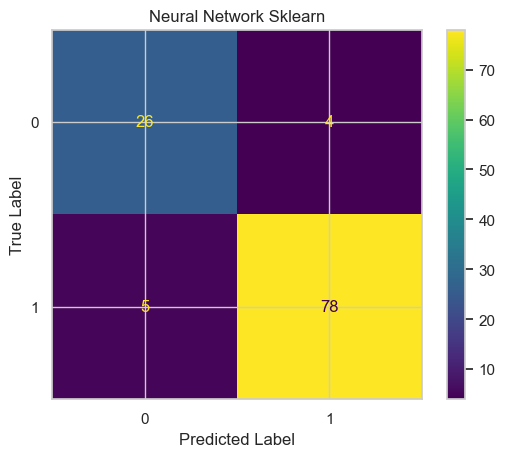

In [267]:
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_m)
plt.title('Neural Network Sklearn')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

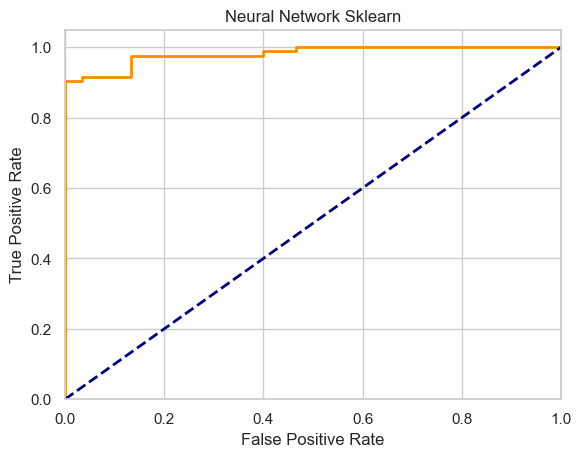

In [268]:
y_predm = mlp_model.predict_proba(x_test)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fprm, tprm, thresholdsm = roc_curve(y_test, y_predm)

plt.figure()
plt.plot(fprm, tprm, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Neural Network Sklearn')
plt.show()

Using 796 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/113 [00:00<?, ?it/s]

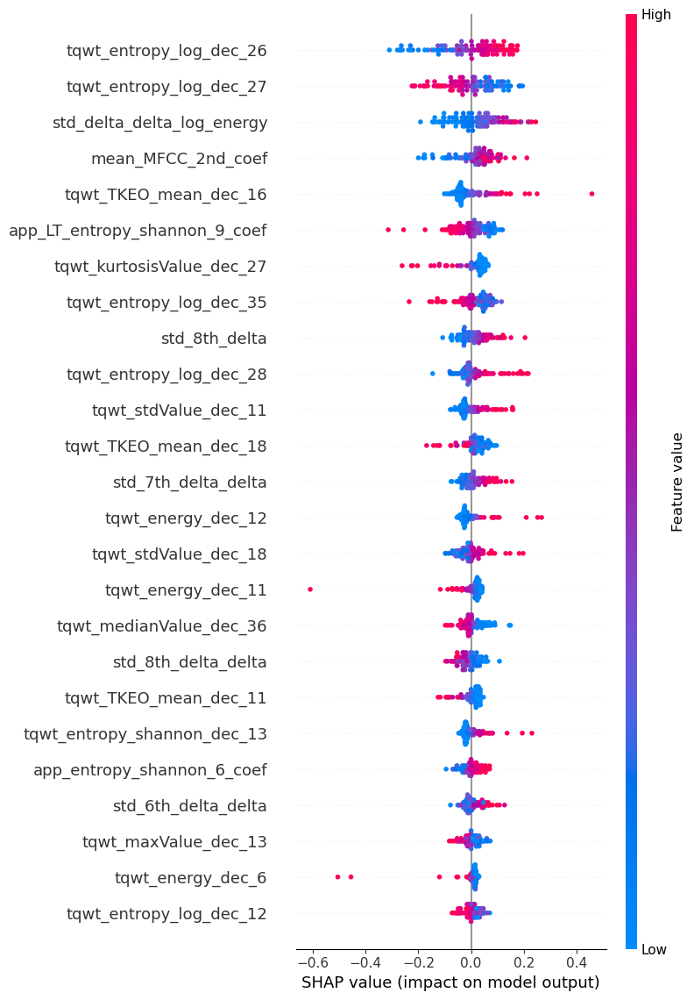

In [127]:
explainer = shap.KernelExplainer(mlp_model.predict_proba, x_train)


shap_values = explainer.shap_values(x_test)


feature_names = X.columns


shap.summary_plot(shap_values[1], x_test, feature_names=feature_names, max_display=25)

## Naive Bayes

In [269]:
from sklearn.naive_bayes import GaussianNB

In [270]:
NB_Model = GaussianNB()

In [271]:
NB_Model.fit(x_train, y_train)

GaussianNB()

In [272]:
y_pred_n= NB_Model.predict(x_test)

In [273]:
evaluate_model(y_test,y_pred_n)

Accuracy of the model is: 71.68 %
Precision of the model is: 93.22 %
Recall of the model is: 66.27 %
AUC value of the model is: 76.47 %
F1 score of the model is: 77.46 %


In [274]:
print(classification_report(y_test, y_pred_n))

              precision    recall  f1-score   support

           0       0.48      0.87      0.62        30
           1       0.93      0.66      0.77        83

    accuracy                           0.72       113
   macro avg       0.71      0.76      0.70       113
weighted avg       0.81      0.72      0.73       113



In [275]:
var_smoothing = [0.000000001,0.000000005,0.00000001,0.0000001,0.000001]
param_grid_nb = dict(var_smoothing=var_smoothing)



grid_nb = GridSearchCV(estimator=NB_Model, param_grid=param_grid_nb, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0)


grid_nb_result = grid_nb.fit(x_cv, y_cv)


print("Highest Recall is achieved using the parameters:", grid_nb_result.best_params_)


NB_Model.set_params(**grid_nb_result.best_params_)

Highest Recall is achieved using the parameters: {'var_smoothing': 1e-09}


GaussianNB()

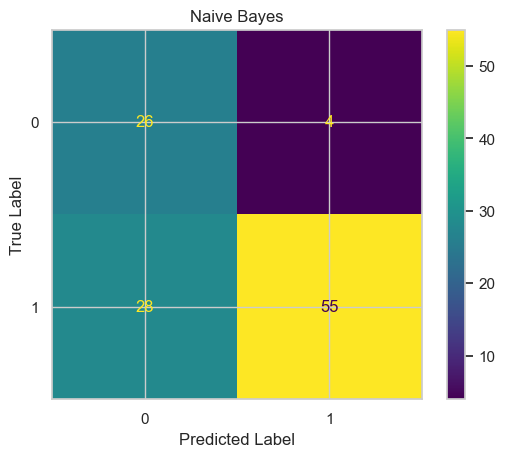

In [276]:
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_n)
plt.title('Naive Bayes')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

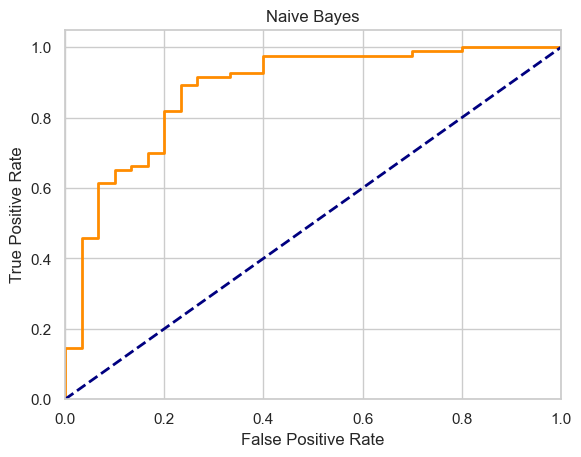

In [277]:
y_predn = NB_Model.predict_proba(x_test)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fprn, tprn, thresholdsn = roc_curve(y_test, y_predn)

plt.figure()
plt.plot(fprn, tprn, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Naive Bayes')
plt.show()

## Stacking Classifier

In [278]:
estimators = [
    ('RF_Model',RF_Model),
    ('SVM_Model', SVM_Model),
    ('MLP_Model', mlp_model)
]
Stacking_Model = StackingClassifier(estimators=estimators, final_estimator=LogisticRegression())

In [279]:
Stacking_Model.fit(x_train,y_train)

StackingClassifier(estimators=[('RF_Model',
                                RandomForestClassifier(bootstrap=False,
                                                       criterion='entropy',
                                                       max_depth=50,
                                                       n_estimators=1000)),
                               ('SVM_Model',
                                SVC(C=12, degree=9, probability=True)),
                               ('MLP_Model',
                                MLPClassifier(alpha=0.001, max_iter=500))],
                   final_estimator=LogisticRegression())

In [257]:
y_pred_s= Stacking_Model.predict(x_test)

In [258]:
evaluate_model(y_pred_s,y_test)

Accuracy of the model is: 95.58 %
Precision of the model is: 97.59 %
Recall of the model is: 96.43 %
AUC value of the model is: 94.77 %
F1 score of the model is: 97.01 %


In [259]:
print(classification_report(y_test, y_pred_s))

              precision    recall  f1-score   support

           0       0.93      0.90      0.92        30
           1       0.96      0.98      0.97        83

    accuracy                           0.96       113
   macro avg       0.95      0.94      0.94       113
weighted avg       0.96      0.96      0.96       113



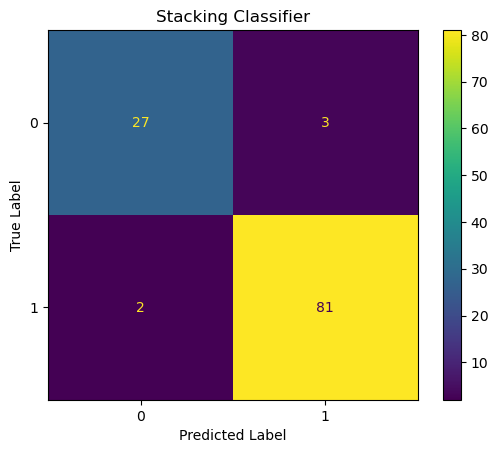

In [260]:
ConfusionMatrixDisplay.from_predictions(y_test, y_pred_s)
plt.title('Stacking Classifier')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

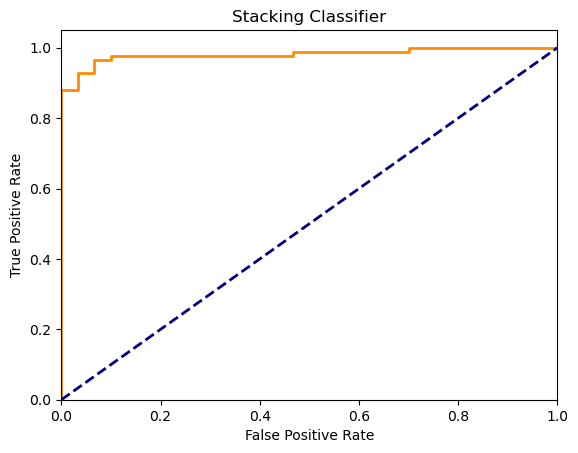

In [261]:
y_preds = Stacking_Model.predict_proba(x_test)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fprs, tprs, thresholdss = roc_curve(y_test, y_preds)

plt.figure()
plt.plot(fprs, tprs, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Stacking Classifier')
plt.show()

# 2008 Dataset

In [6]:
df1.head()

,name,MDVP:Fo(Hz),MDVP:Fhi(Hz),MDVP:Flo(Hz),MDVP:Jitter(%),MDVP:Jitter(Abs),MDVP:RAP,MDVP:PPQ,Jitter:DDP,MDVP:Shimmer,...,Shimmer:DDA,NHR,HNR,status,RPDE,DFA,spread1,spread2,D2,PPE
0,phon_R01_S01_1,119.992,157.302,74.997,0.00784,0.00007,0.00370,0.00554,0.01109,0.04374,...,0.06545,0.02211,21.033,1,0.414783,0.815285,-4.813031,0.266482,2.301442,0.284654
1,phon_R01_S01_2,122.400,148.650,113.819,0.00968,0.00008,0.00465,0.00696,0.01394,0.06134,...,0.09403,0.01929,19.085,1,0.458359,0.819521,-4.075192,0.335590,2.486855,0.368674
2,phon_R01_S01_3,116.682,131.111,111.555,0.01050,0.00009,0.00544,0.00781,0.01633,0.05233,...,0.08270,0.01309,20.651,1,0.429895,0.825288,-4.443179,0.311173,2.342259,0.332634
3,phon_R01_S01_4,116.676,137.871,111.366,0.00997,0.00009,0.00502,0.00698,0.01505,0.05492,...,0.08771,0.01353,20.644,1,0.434969,0.819235,-4.117501,0.334147,2.405554,0.368975
4,phon_R01_S01_5,116.014,141.781,110.655,0.01284,0.00011,0.00655,0.00908,0.01966,0.06425,...,0.10470,0.01767,19.649,1,0.417356,0.823484,-3.747787,0.234513,2.332180,0.410335


In [7]:
df1.shape

(195, 24)

In [8]:
df1.dtypes

name                 object
MDVP:Fo(Hz)         float64
MDVP:Fhi(Hz)        float64
MDVP:Flo(Hz)        float64
MDVP:Jitter(%)      float64
MDVP:Jitter(Abs)    float64
MDVP:RAP            float64
MDVP:PPQ            float64
Jitter:DDP          float64
MDVP:Shimmer        float64
MDVP:Shimmer(dB)    float64
Shimmer:APQ3        float64
Shimmer:APQ5        float64
MDVP:APQ            float64
Shimmer:DDA         float64
NHR                 float64
HNR                 float64
status                int64
RPDE                float64
DFA                 float64
spread1             float64
spread2             float64
D2                  float64
PPE                 float64
dtype: object

In [9]:
categorical_columns = df1.select_dtypes(include=['object']).columns.tolist()

print(categorical_columns)

['name']


In [10]:
df.isnull().sum().sum()

0

In [11]:
df1['status'].value_counts()

1    147
0     48
Name: status, dtype: int64

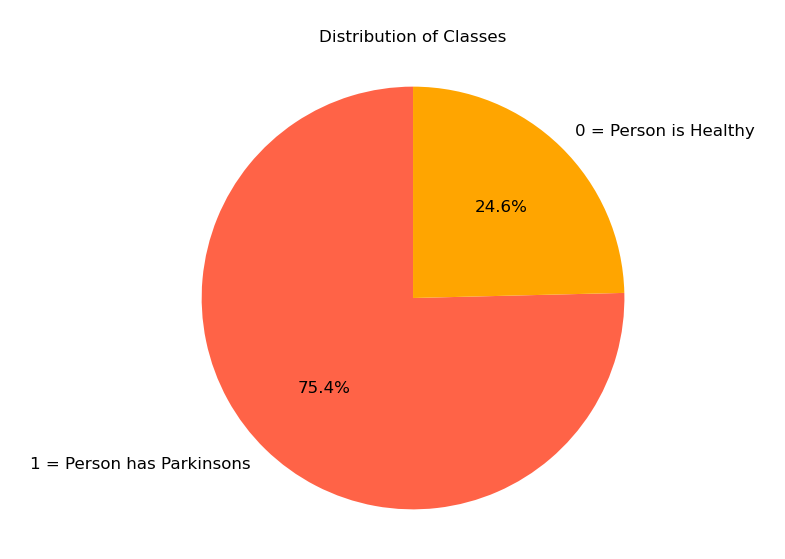

In [12]:
class_counts = df1['status'].value_counts()

colors = ['#FF6347', '#FFA500'] #setting custom colours for the pie chart

plt.figure(figsize=(2, 2), dpi=300) #setting the display size and choosing a higher resolution for clearer plots

#the code below sets the data and labels for the pie chart, chooses a percentage distribution and sets colors 

plt.pie(class_counts, labels=['1 = Person has Parkinsons', '0 = Person is Healthy'], 
        autopct='%1.1f%%', startangle=90, colors=colors, textprops={'fontsize': 4})

plt.axis('equal') #this ensures the plot is a circle

plt.title('Distribution of Classes', fontsize=4) #setting title for the plot

plt.show() #displaying the plot 

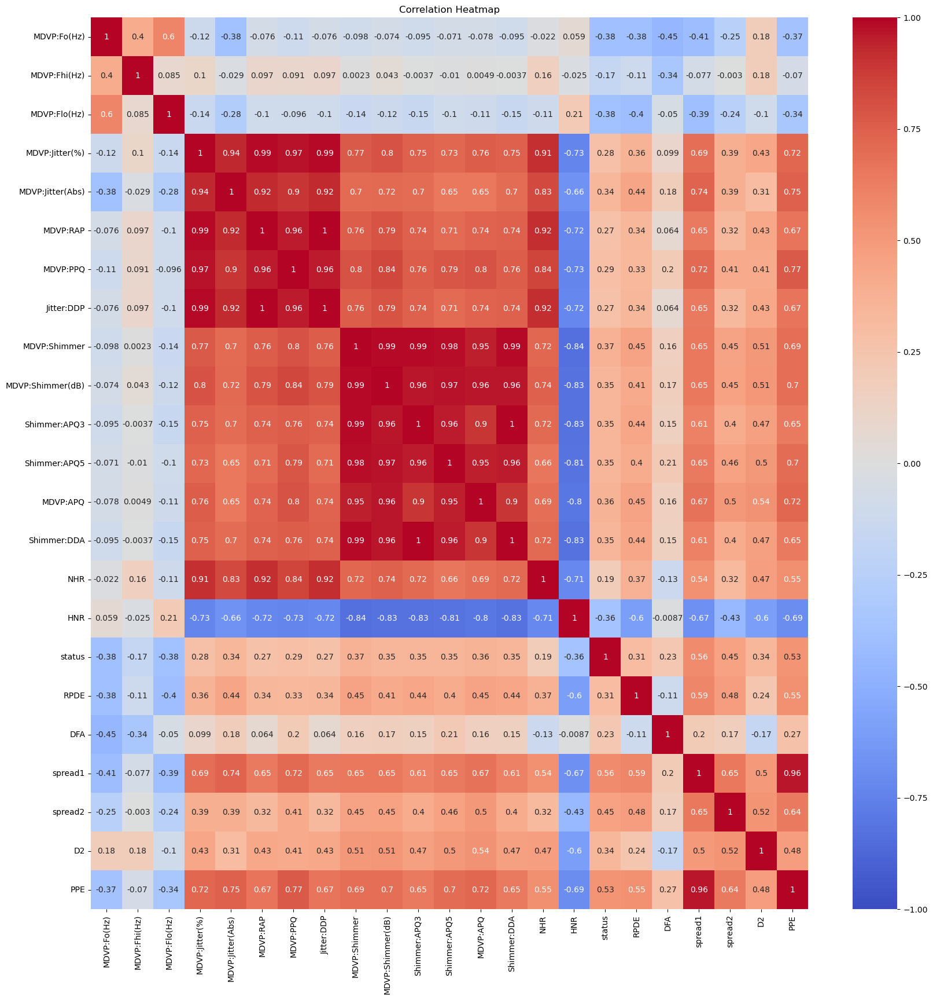

In [17]:
correlation_matrix = df1.corr()

# Set up the matplotlib figure
plt.figure(figsize=(20, 20))

# Create a heatmap using seaborn
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1)

plt.title('Correlation Heatmap')
plt.show()

(array([0, 1, 2]),
 [Text(0, 0, 'MDVP:Fo(Hz)'),
  Text(1, 0, 'MDVP:Fhi(Hz)'),
  Text(2, 0, 'MDVP:Flo(Hz)')])

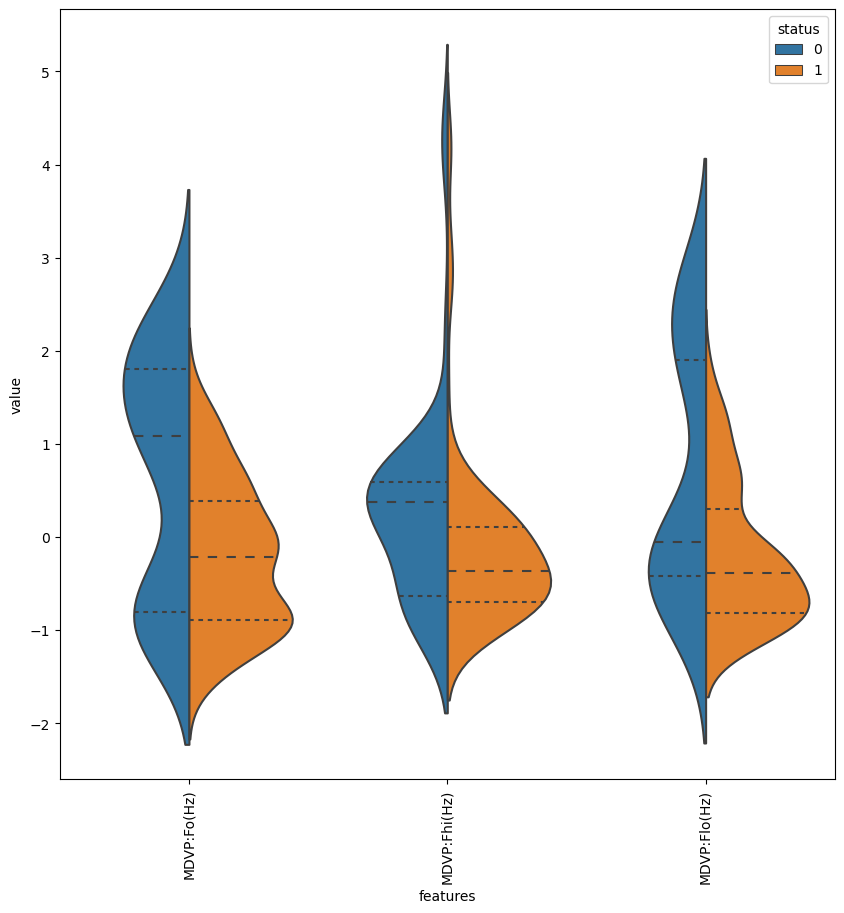

In [12]:
y= df1['status']
data_dia = df1['status']
data =  df1.iloc[:, 1:4]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
#the following line adds the values of the features in a single column for ease of visualization 
data = pd.melt(data,id_vars="status",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="status", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2]),
 [Text(0, 0, 'MDVP:Fo(Hz)'),
  Text(1, 0, 'MDVP:Fhi(Hz)'),
  Text(2, 0, 'MDVP:Flo(Hz)')])

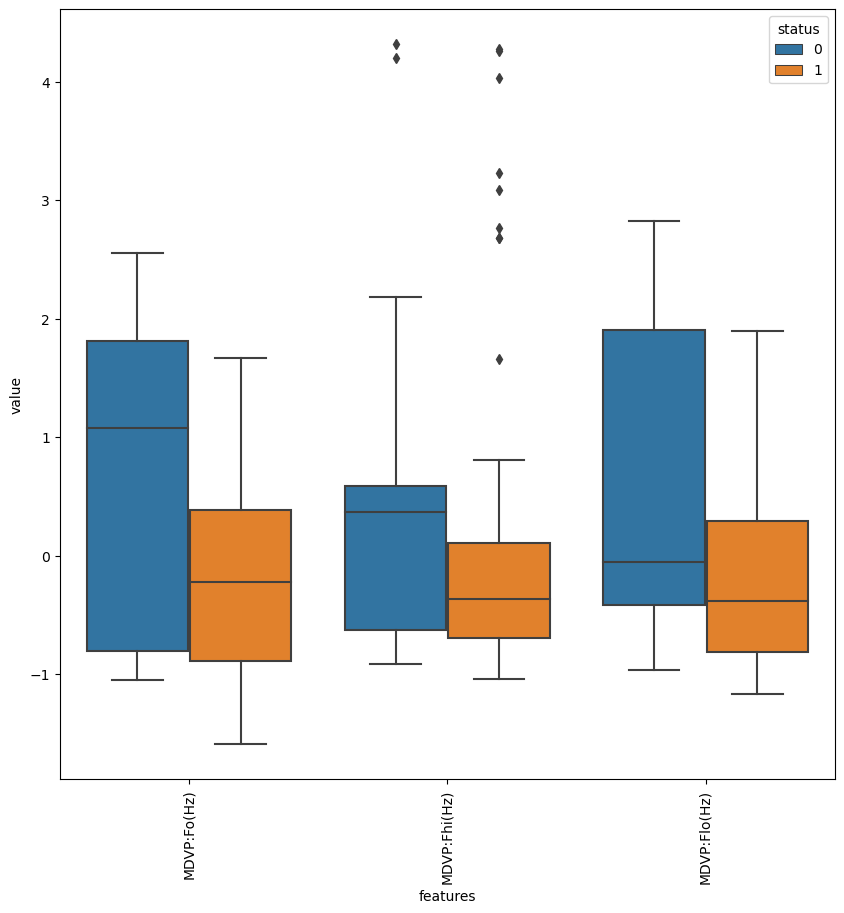

In [13]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

([0, 1, 2],
 [Text(0, 0, 'MDVP:Fo(Hz)'),
  Text(1, 0, 'MDVP:Fhi(Hz)'),
  Text(2, 0, 'MDVP:Flo(Hz)')])

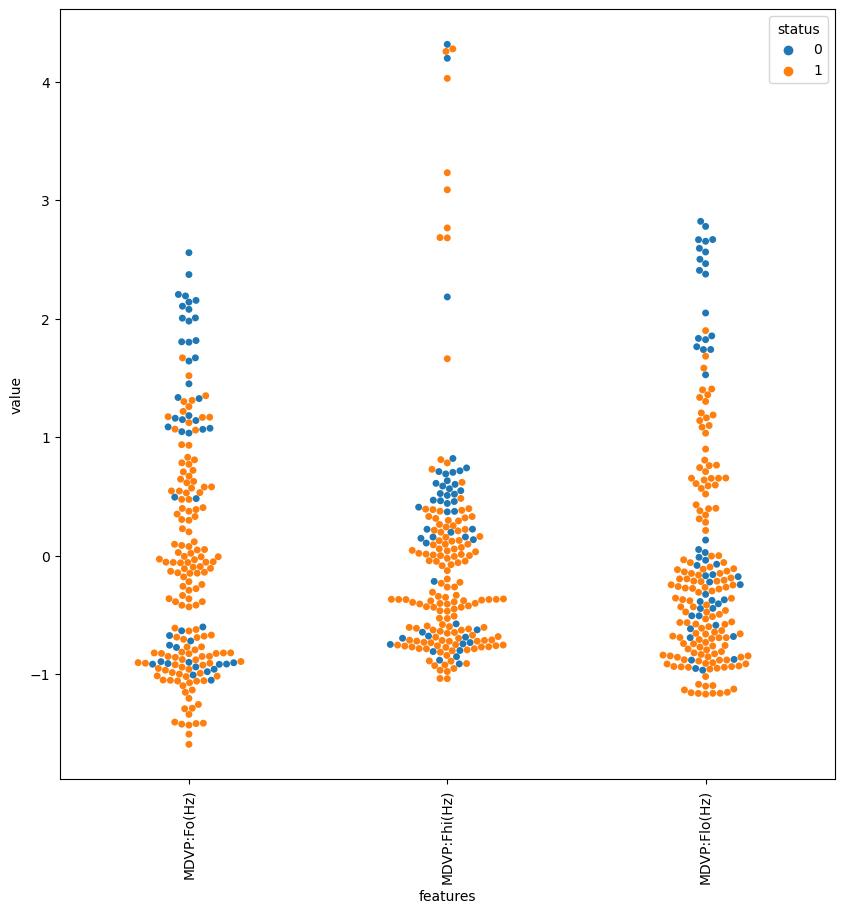

In [14]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4]),
 [Text(0, 0, 'MDVP:Jitter(%)'),
  Text(1, 0, 'MDVP:Jitter(Abs)'),
  Text(2, 0, 'MDVP:RAP'),
  Text(3, 0, 'MDVP:PPQ'),
  Text(4, 0, 'Jitter:DDP')])

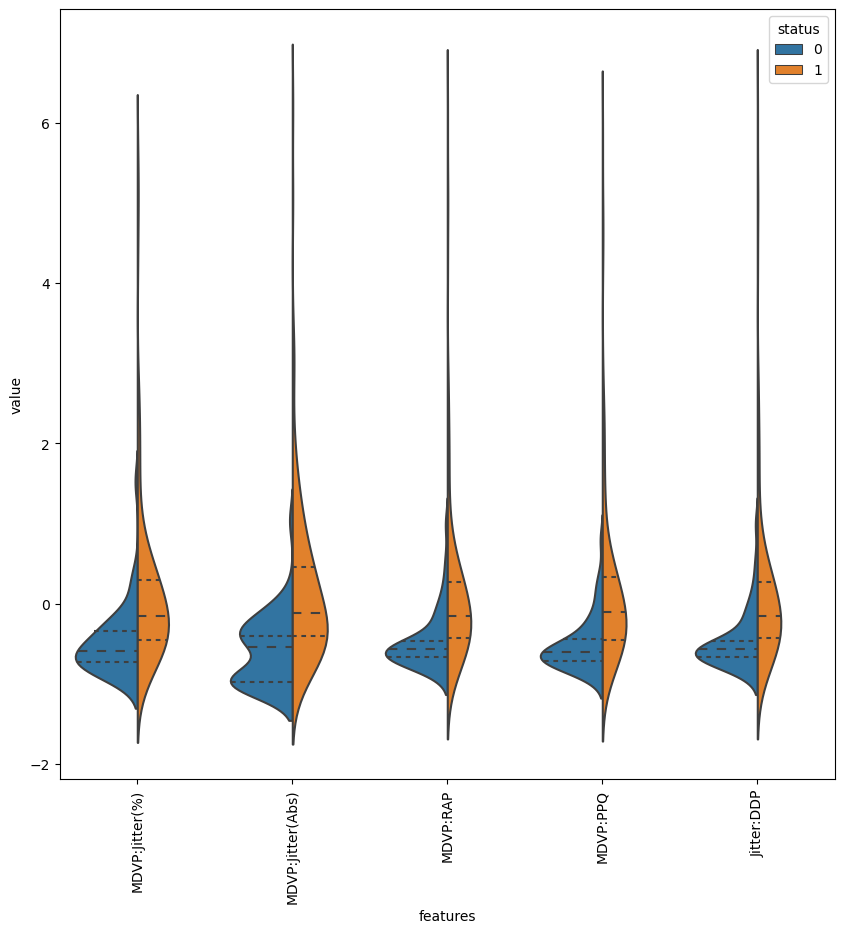

In [15]:
y= df1['status']
data_dia = df1['status']
data =  df1.iloc[:, 4:9]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
#the following line adds the values of the features in a single column for ease of visualization 
data = pd.melt(data,id_vars="status",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="status", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4]),
 [Text(0, 0, 'MDVP:Jitter(%)'),
  Text(1, 0, 'MDVP:Jitter(Abs)'),
  Text(2, 0, 'MDVP:RAP'),
  Text(3, 0, 'MDVP:PPQ'),
  Text(4, 0, 'Jitter:DDP')])

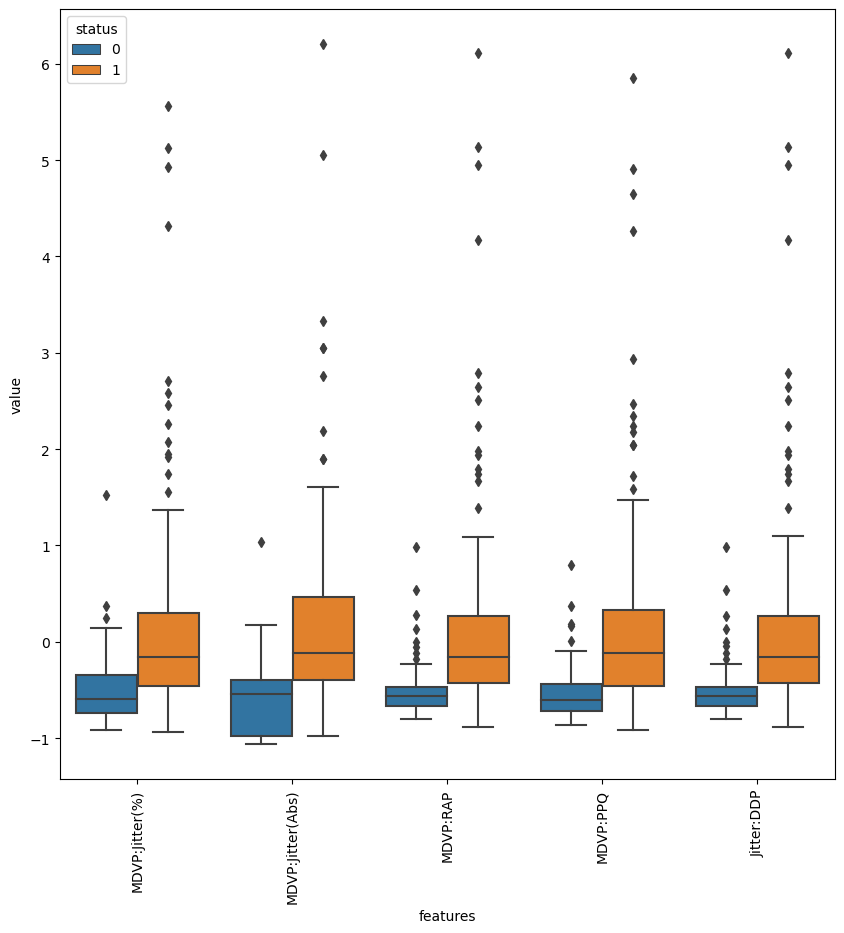

In [16]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4],
 [Text(0, 0, 'MDVP:Jitter(%)'),
  Text(1, 0, 'MDVP:Jitter(Abs)'),
  Text(2, 0, 'MDVP:RAP'),
  Text(3, 0, 'MDVP:PPQ'),
  Text(4, 0, 'Jitter:DDP')])

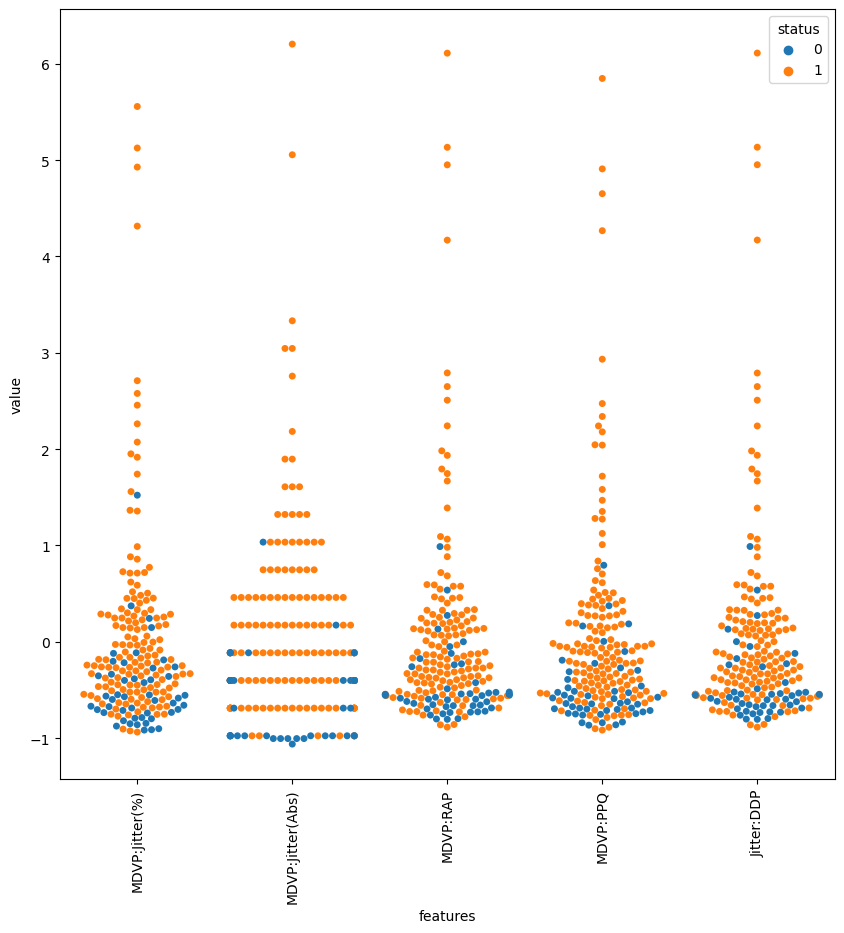

In [17]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'MDVP:Shimmer'),
  Text(1, 0, 'MDVP:Shimmer(dB)'),
  Text(2, 0, 'Shimmer:APQ3'),
  Text(3, 0, 'Shimmer:APQ5'),
  Text(4, 0, 'MDVP:APQ'),
  Text(5, 0, 'Shimmer:DDA')])

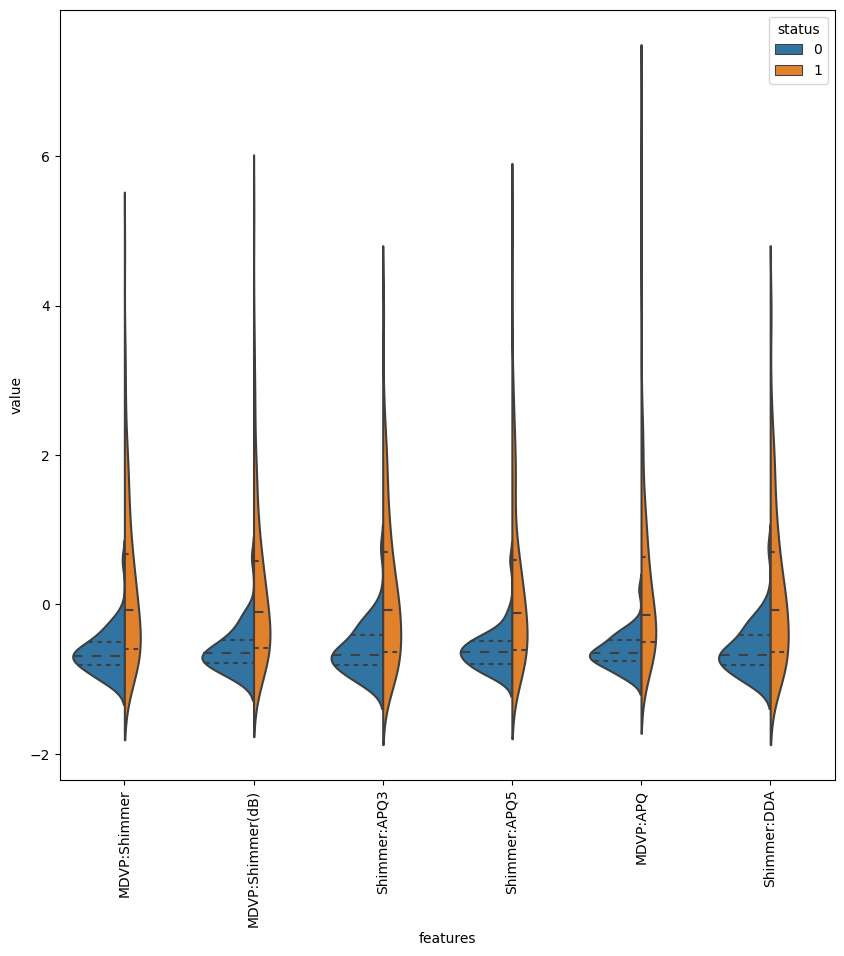

In [18]:
y= df1['status']
data_dia = df1['status']
data =  df1.iloc[:, 9:15]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
#the following line adds the values of the features in a single column for ease of visualization 
data = pd.melt(data,id_vars="status",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="status", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'MDVP:Shimmer'),
  Text(1, 0, 'MDVP:Shimmer(dB)'),
  Text(2, 0, 'Shimmer:APQ3'),
  Text(3, 0, 'Shimmer:APQ5'),
  Text(4, 0, 'MDVP:APQ'),
  Text(5, 0, 'Shimmer:DDA')])

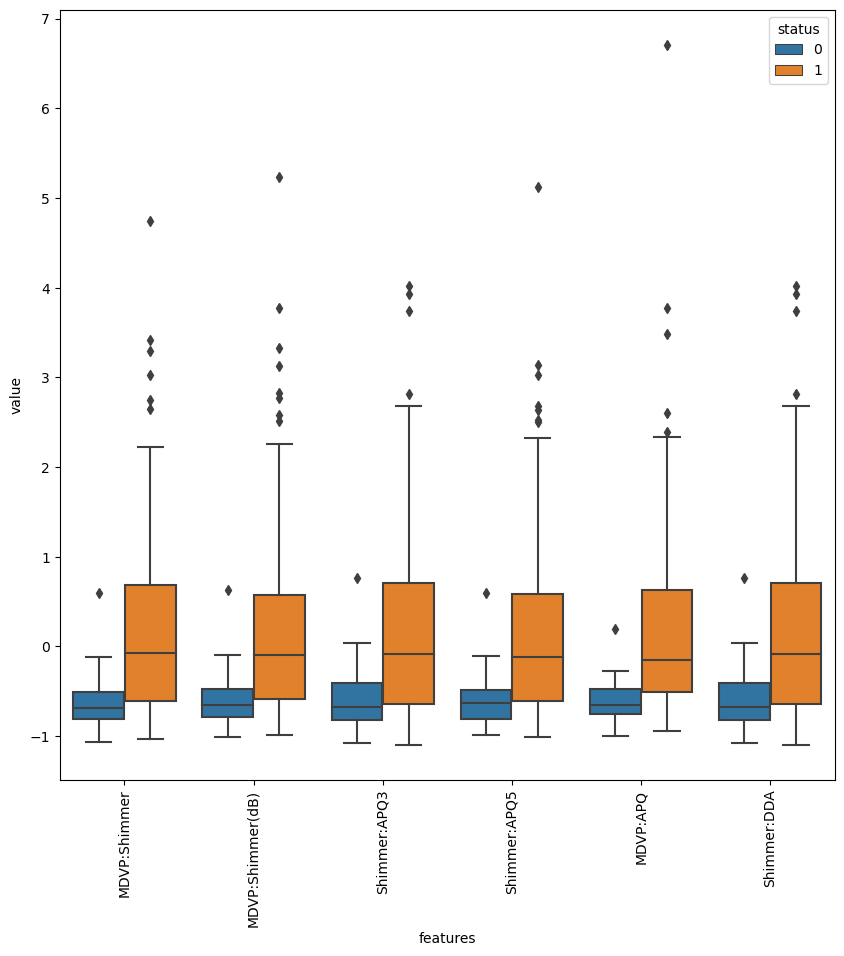

In [19]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3, 4, 5],
 [Text(0, 0, 'MDVP:Shimmer'),
  Text(1, 0, 'MDVP:Shimmer(dB)'),
  Text(2, 0, 'Shimmer:APQ3'),
  Text(3, 0, 'Shimmer:APQ5'),
  Text(4, 0, 'MDVP:APQ'),
  Text(5, 0, 'Shimmer:DDA')])

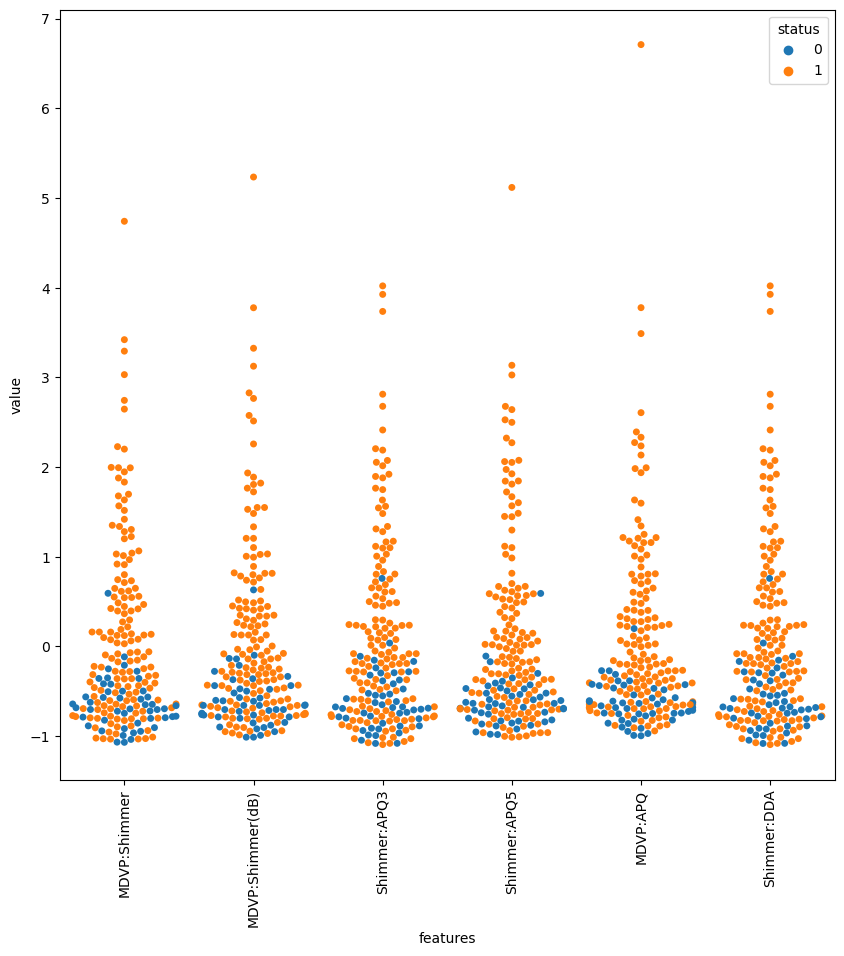

In [20]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

(array([0, 1]), [Text(0, 0, 'NHR'), Text(1, 0, 'HNR')])

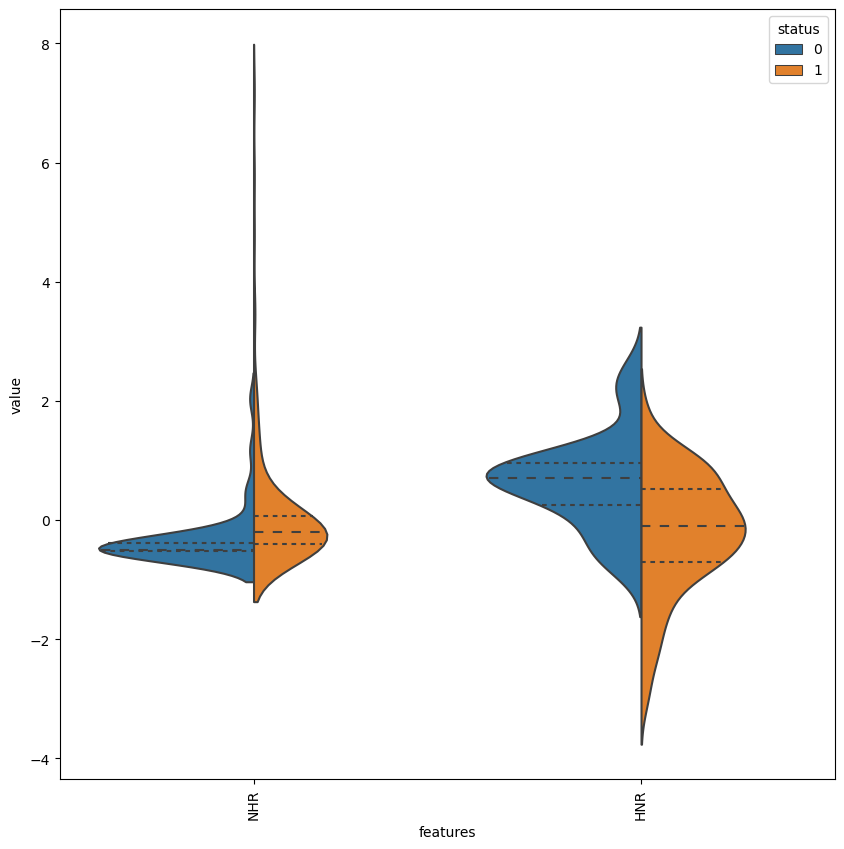

In [21]:
y= df1['status']
data_dia = df1['status']
data =  df1.iloc[:, 15:17]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
#the following line adds the values of the features in a single column for ease of visualization 
data = pd.melt(data,id_vars="status",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="status", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1]), [Text(0, 0, 'NHR'), Text(1, 0, 'HNR')])

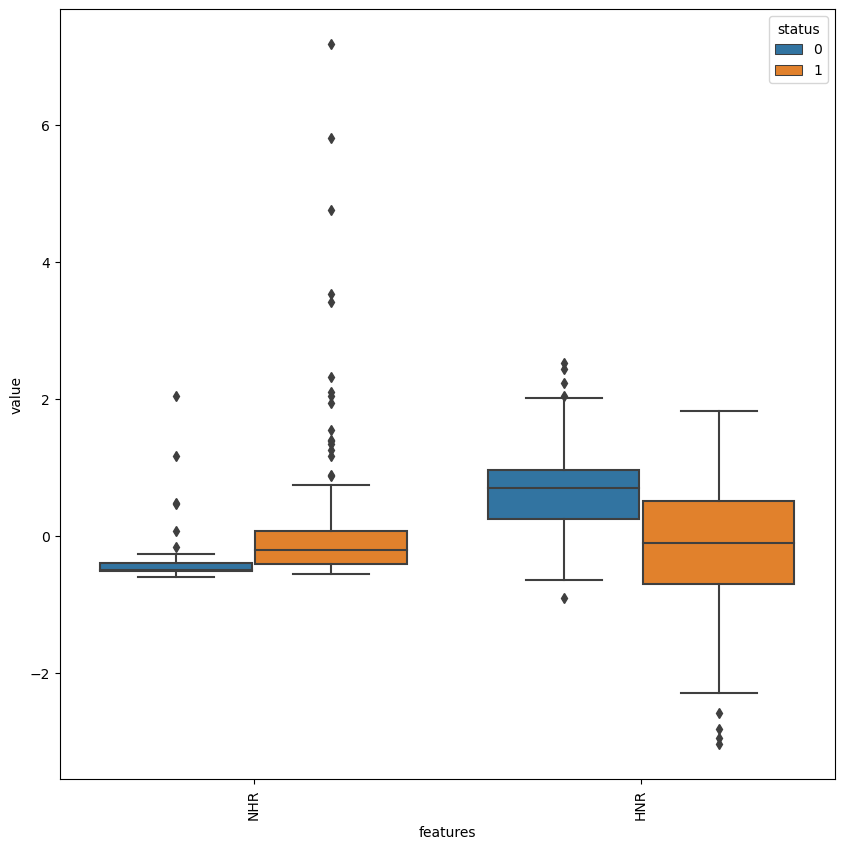

In [22]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

([0, 1], [Text(0, 0, 'NHR'), Text(1, 0, 'HNR')])

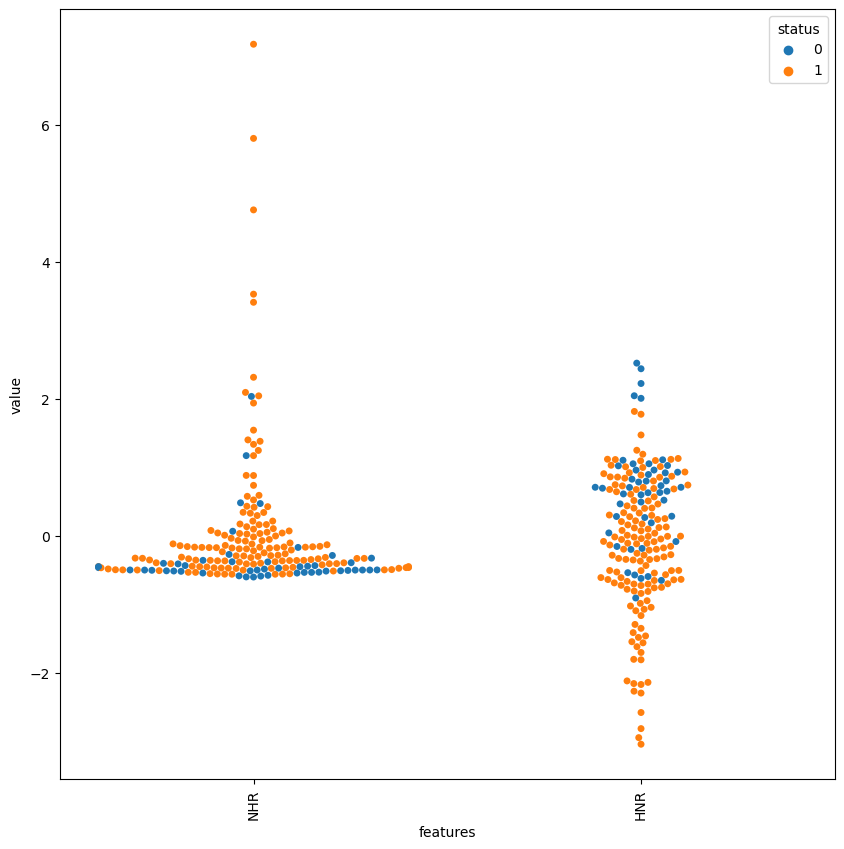

In [23]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

(array([0, 1, 2, 3]),
 [Text(0, 0, 'RPDE'),
  Text(1, 0, 'DFA'),
  Text(2, 0, 'spread1'),
  Text(3, 0, 'spread2')])

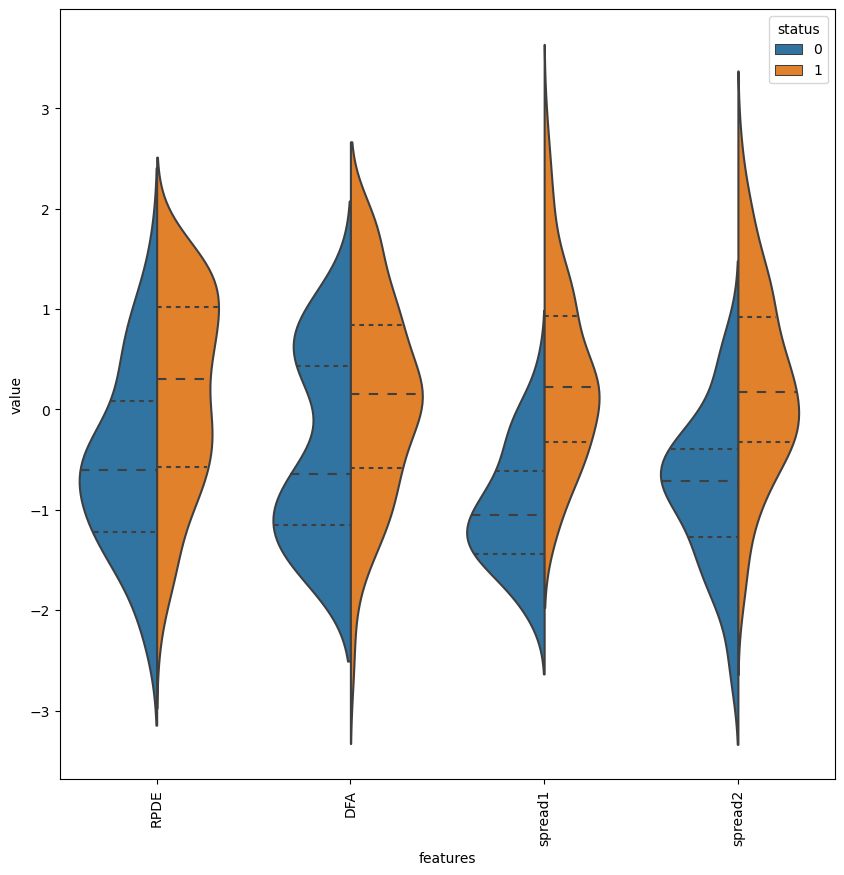

In [24]:
y= df1['status']
data_dia = df1['status']
data =  df1.iloc[:, 18:22]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
#the following line adds the values of the features in a single column for ease of visualization 
data = pd.melt(data,id_vars="status",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="status", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3]),
 [Text(0, 0, 'RPDE'),
  Text(1, 0, 'DFA'),
  Text(2, 0, 'spread1'),
  Text(3, 0, 'spread2')])

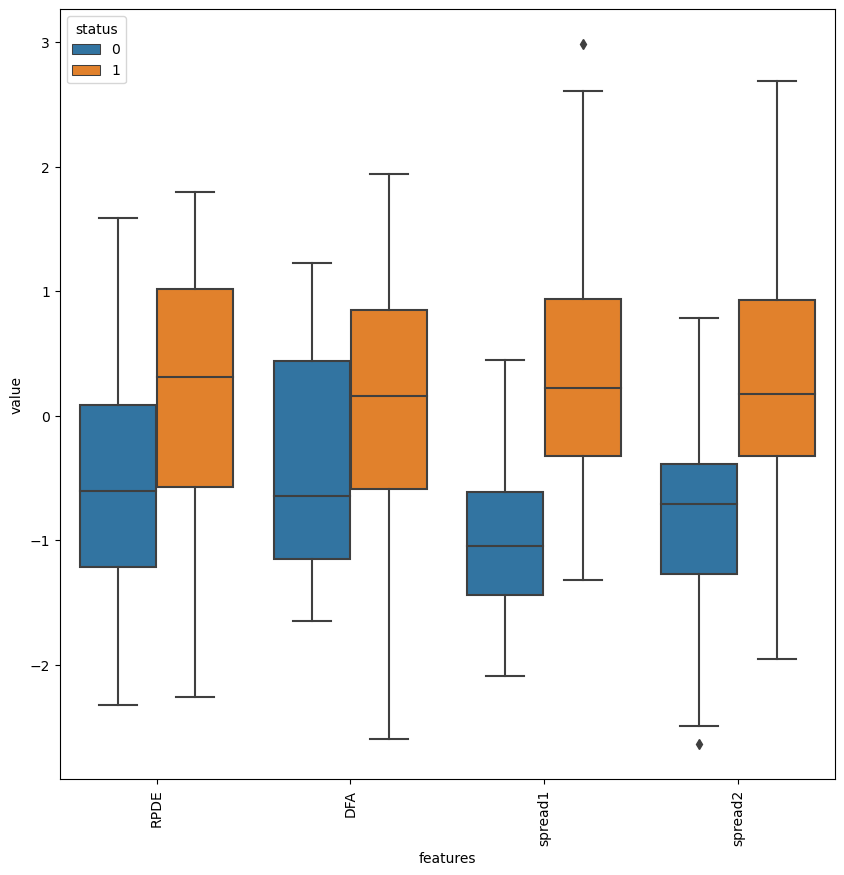

In [25]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

([0, 1, 2, 3],
 [Text(0, 0, 'RPDE'),
  Text(1, 0, 'DFA'),
  Text(2, 0, 'spread1'),
  Text(3, 0, 'spread2')])

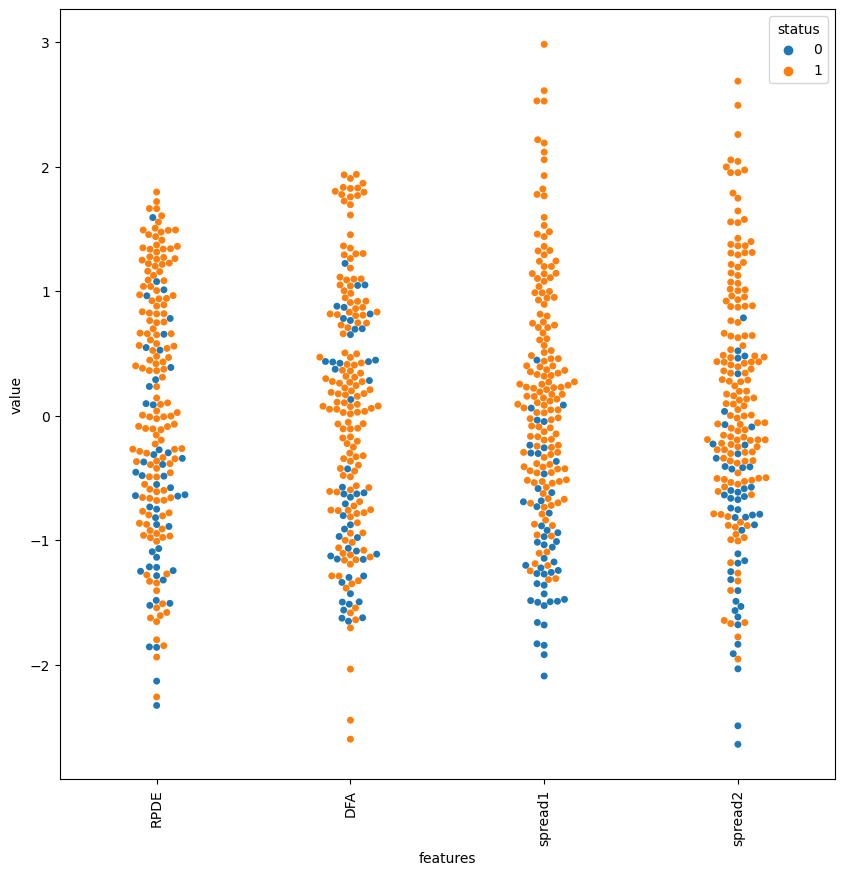

In [26]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

(array([0, 1]), [Text(0, 0, 'D2'), Text(1, 0, 'PPE')])

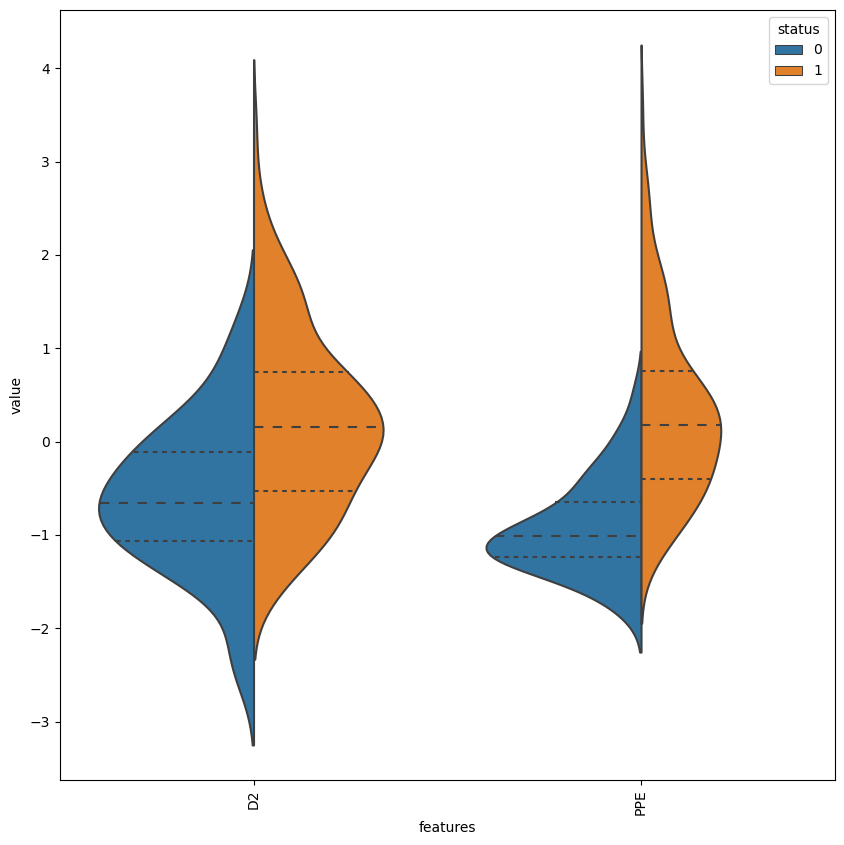

In [27]:
y= df1['status']
data_dia = df1['status']
data =  df1.iloc[:, 22:]
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([y,data_n_2],axis=1)
#the following line adds the values of the features in a single column for ease of visualization 
data = pd.melt(data,id_vars="status",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
sns.violinplot(x="features", y="value", hue="status", data=data,split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1]), [Text(0, 0, 'D2'), Text(1, 0, 'PPE')])

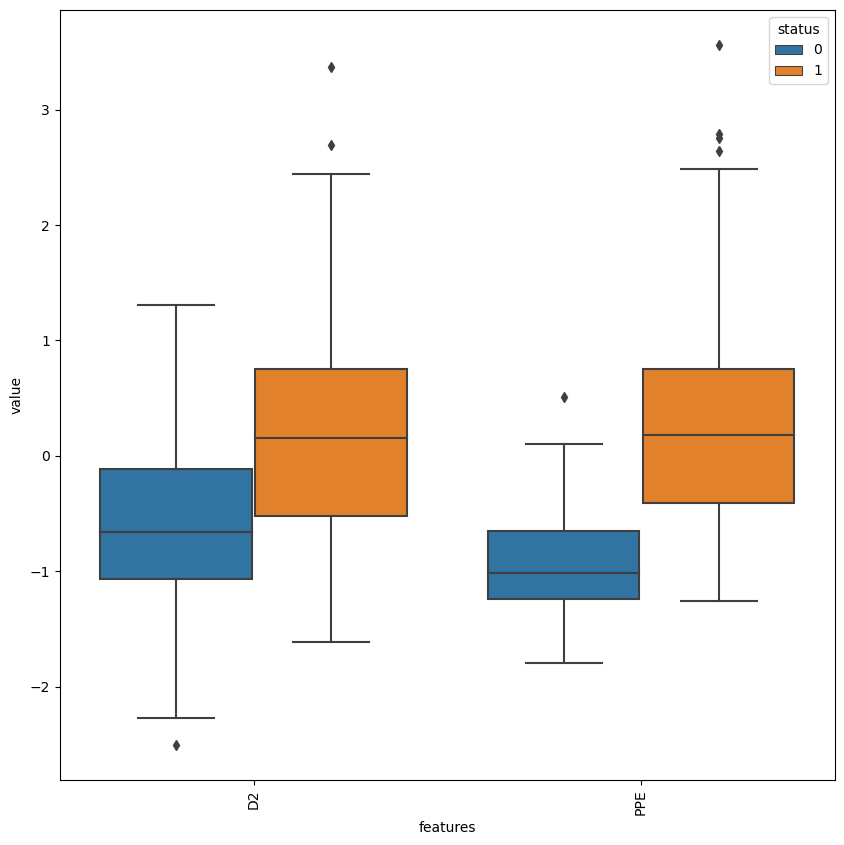

In [28]:
plt.figure(figsize=(10,10))
sns.boxplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

([0, 1], [Text(0, 0, 'D2'), Text(1, 0, 'PPE')])

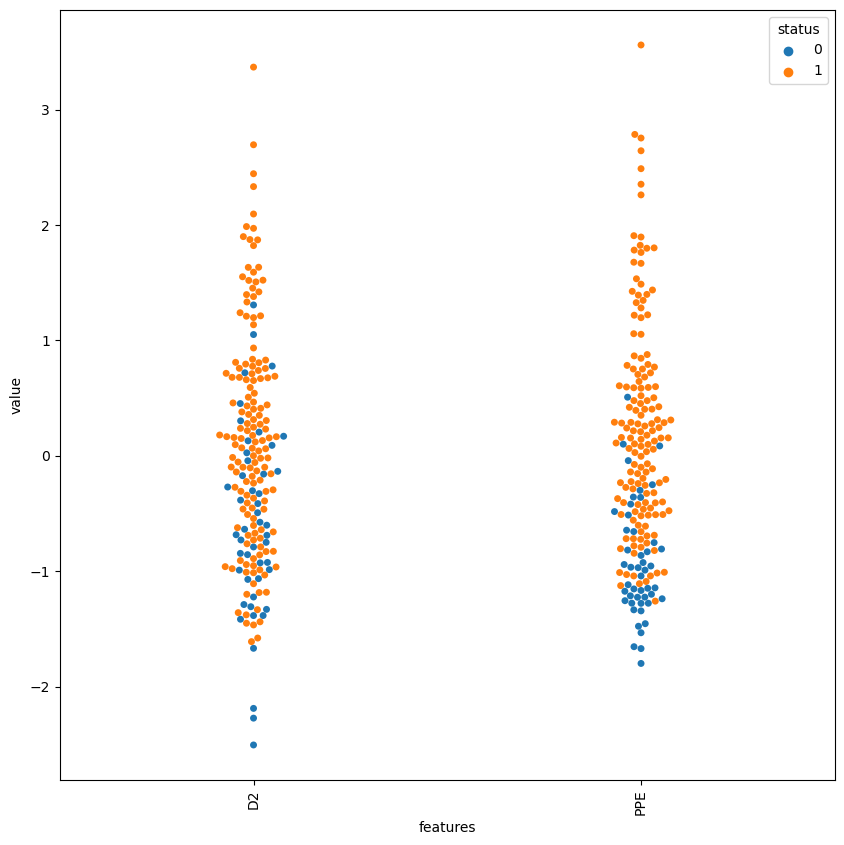

In [29]:
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="status", data=data)
plt.xticks(rotation=90)

## Splitting the Data

In [20]:
X1 = df1.drop(['status','name'],axis=1)
Y1 = df1['status']

In [22]:
X1=X1[ET_features]
#X1=X1[RFE_features]
#X1=X1[MI_features]

In [23]:
x_train1, x_test1, y_train1, y_test1 = train_test_split(X1, Y1, test_size = 0.30, random_state = 42)

In [24]:
x_train1

,MDVP:Fo(Hz),PPE,spread1,D2,MDVP:Flo(Hz),spread2,MDVP:Jitter(Abs),MDVP:Fhi(Hz),DFA,MDVP:Shimmer,RPDE,MDVP:APQ
38,180.198,0.141929,-6.452058,2.269398,175.456,0.212294,0.00002,201.249,0.766209,0.01444,0.403884,0.01190
31,199.228,0.068501,-7.682587,2.103106,192.091,0.173319,0.00001,209.512,0.742055,0.01015,0.432439,0.00762
173,113.715,0.179677,-5.943501,1.852542,96.913,0.192150,0.00003,116.443,0.766700,0.01472,0.380253,0.01148
12,136.926,0.138512,-6.547148,2.041277,131.276,0.152813,0.00002,159.866,0.646846,0.01259,0.460600,0.01140
109,193.030,0.185668,-5.845099,2.608749,80.297,0.278679,0.00004,208.900,0.740539,0.03044,0.497554,0.02084
...,...,...,...,...,...,...,...,...,...,...,...,...
106,155.078,0.106802,-6.981201,2.129924,144.148,0.184550,0.00001,163.736,0.677930,0.01064,0.334171,0.00928
14,152.845,0.170100,-6.105098,2.125618,75.836,0.203653,0.00002,163.305,0.654027,0.01828,0.474791,0.01246
92,148.272,0.186489,-5.952058,2.344336,142.299,0.087840,0.00003,164.989,0.734504,0.04190,0.454444,0.03051
179,148.143,0.192730,-5.711205,2.845109,135.041,0.240875,0.00003,155.982,0.778349,0.01450,0.398499,0.01263


In [25]:
sc = StandardScaler()
x_train1 = sc.fit_transform(x_train1)
x_test1 = sc.transform (x_test1)

# Feature Selection

## RFE

In [606]:
from sklearn.feature_selection import RFE
estimator = LogisticRegression()  # the algorithm for the RFE Model
rfe = RFE(estimator, n_features_to_select=12)
rfe.fit(x_train1, y_train1)

RFE(estimator=LogisticRegression(), n_features_to_select=12)

In [607]:
ranked_features_rfe = pd.Series(rfe.ranking_, index=X1.columns)
ranked_features_rfe = ranked_features_rfe.sort_values(ascending=True)
ranked_features_rfe = ranked_features_rfe[0:12]
for i, (feature_name, ranking) in enumerate(ranked_features_rfe.iteritems(), start=1):
    print(f"Feature {i} = {feature_name}")

Feature 1 = PPE
Feature 2 = MDVP:Fo(Hz)
Feature 3 = MDVP:Flo(Hz)
Feature 4 = MDVP:Jitter(Abs)
Feature 5 = spread1
Feature 6 = NHR
Feature 7 = MDVP:APQ
Feature 8 = MDVP:Fhi(Hz)
Feature 9 = MDVP:Shimmer
Feature 10 = spread2
Feature 11 = Shimmer:APQ5
Feature 12 = Shimmer:DDA


In [608]:
RFE_features = ranked_features_rfe.index

# Extra Trees Feature Selection

In [17]:
ET=ExtraTreesClassifier()
ET.fit(x_train1,y_train1)

ExtraTreesClassifier()

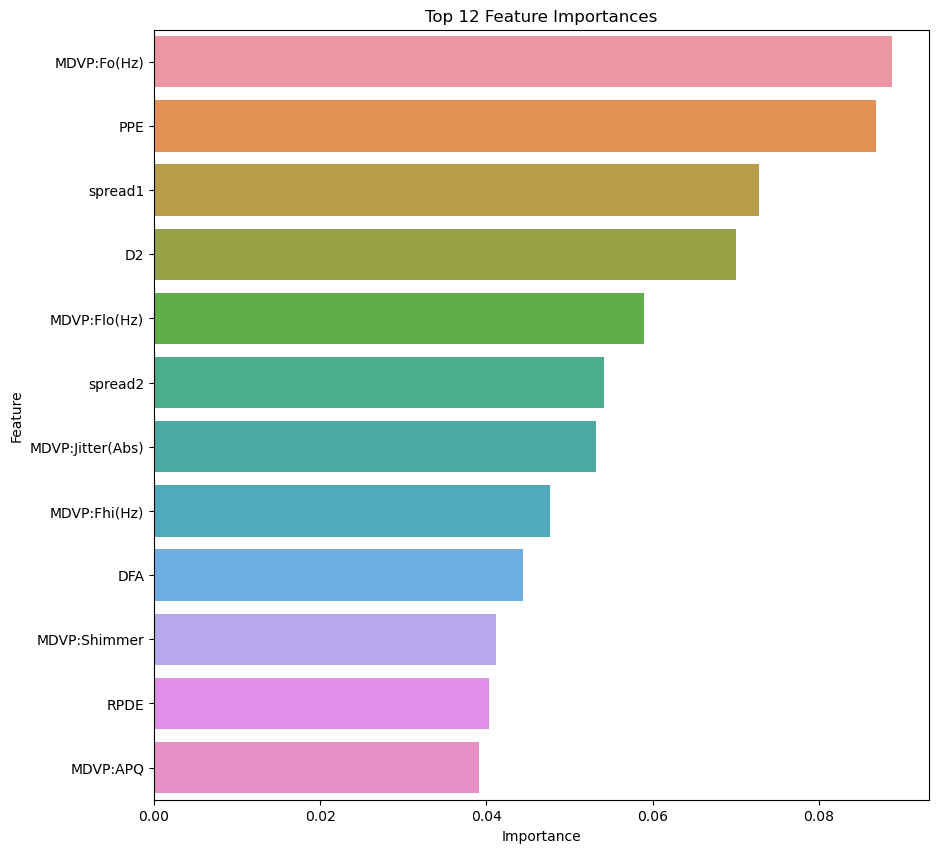

In [18]:
feature_importances = ET.feature_importances_
feature_names = X1.columns

# Create a DataFrame to store feature names and importances
importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})

# Select the top 50 features based on importance values
top_12_importances = importance_df.nlargest(12, 'Importance')

# Sort the in descending order
top_12_importances = top_12_importances.sort_values(by='Importance', ascending=False)

# Create the bar plot
plt.figure(figsize=(10, 10))
sns.barplot(x='Importance', y='Feature', data=top_12_importances)
plt.title('Top 12 Feature Importances')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

In [19]:
ET_features = top_12_importances['Feature'].tolist()
ET_features

['MDVP:Fo(Hz)',
 'PPE',
 'spread1',
 'D2',
 'MDVP:Flo(Hz)',
 'spread2',
 'MDVP:Jitter(Abs)',
 'MDVP:Fhi(Hz)',
 'DFA',
 'MDVP:Shimmer',
 'RPDE',
 'MDVP:APQ']

# Mutual Information Gain Feature Selection

In [609]:
MI=mutual_info_classif(x_train1,y_train1)
ranked_features=pd.Series(MI,index=X1.columns)
mi_ranked_features = ranked_features.nlargest(12).index

In [610]:
for rank, feature in enumerate(mi_ranked_features, start=1):
    print(f"Rank {rank}: {feature}")

Rank 1: PPE
Rank 2: MDVP:Fo(Hz)
Rank 3: MDVP:Flo(Hz)
Rank 4: spread1
Rank 5: MDVP:Jitter(Abs)
Rank 6: NHR
Rank 7: MDVP:APQ
Rank 8: MDVP:Fhi(Hz)
Rank 9: MDVP:Shimmer
Rank 10: spread2
Rank 11: Shimmer:APQ5
Rank 12: Shimmer:DDA


In [611]:
MI_features = mi_ranked_features 
MI_features

Index(['PPE', 'MDVP:Fo(Hz)', 'MDVP:Flo(Hz)', 'spread1', 'MDVP:Jitter(Abs)',
       'NHR', 'MDVP:APQ', 'MDVP:Fhi(Hz)', 'MDVP:Shimmer', 'spread2',
       'Shimmer:APQ5', 'Shimmer:DDA'],
      dtype='object')

## Balancing the Data

In [26]:
sm=SMOTE(random_state=42)
x_train1,y_train1=sm.fit_resample(x_train1,y_train1)

In [27]:
x_train1.shape

(206, 12)

In [28]:
y_train1.value_counts()

1    103
0    103
Name: status, dtype: int64

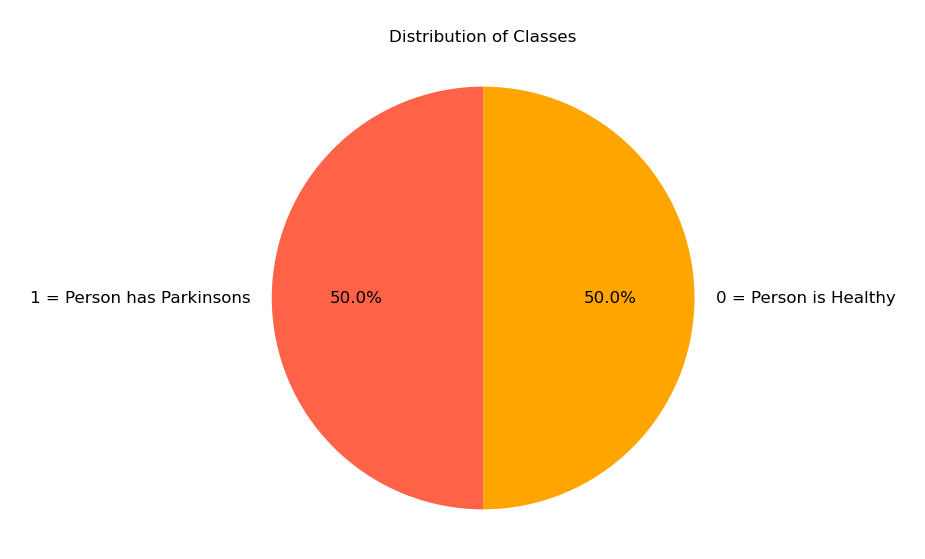

In [29]:
class_counts = y_train1.value_counts()

colors = ['#FF6347', '#FFA500']

plt.figure(figsize=(2, 2), dpi=300)

plt.pie(class_counts, labels=['1 = Person has Parkinsons', '0 = Person is Healthy'], 
        autopct='%1.1f%%', startangle=90, colors=colors, textprops={'fontsize': 4})

plt.axis('equal')

plt.title('Distribution of Classes', fontsize=4)

plt.show()

# PCA

In [84]:
pca=PCA(n_components=20)
x_train1=pca.fit_transform(x_train1)
x_test1=pca.transform(x_test1)

In [85]:
x_train1.shape

(206, 20)

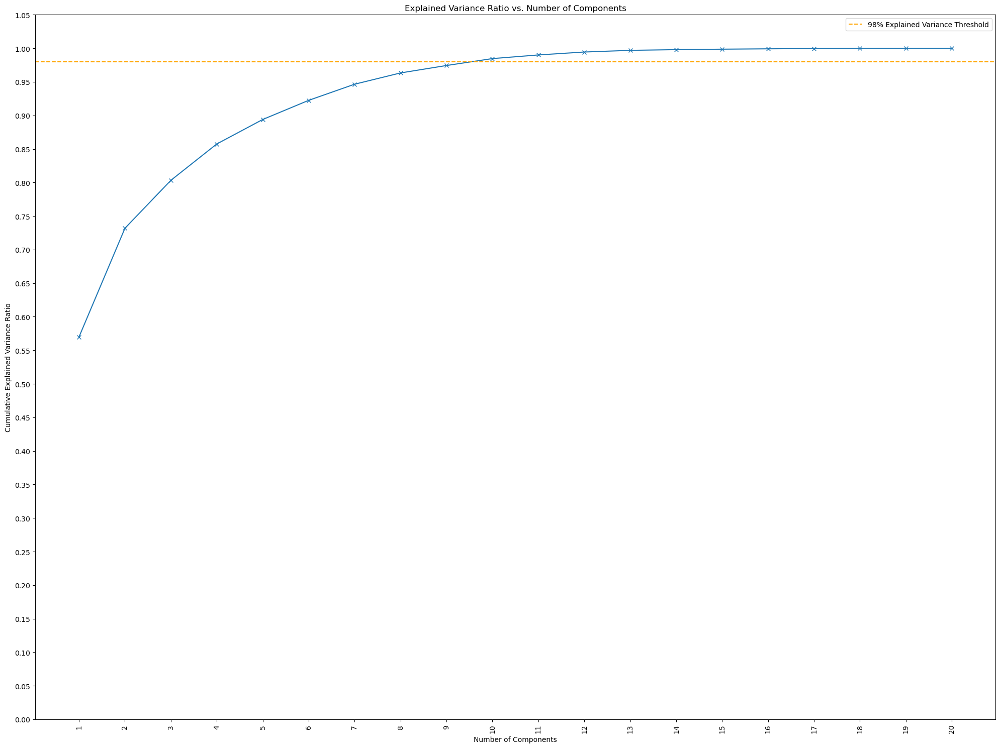

In [91]:
explained_variance_ratio_cumulative = np.cumsum(pca.explained_variance_ratio_)

plt.style.use('default')

plt.figure(figsize=(20, 15))
plt.plot(range(1, x_train1.shape[1] + 1), explained_variance_ratio_cumulative, marker='x', linestyle='-')
plt.axhline(y=0.98, color='orange', linestyle='--', label='98% Explained Variance Threshold')

plt.xscale('linear')  # Use 'log' for logarithmic scale
plt.yscale('linear')  # Use 'log' for logarithmic scale
plt.xticks(np.arange(1, x_train1.shape[1] + 1, 1))  # Add minor ticks on the x-axis
plt.yticks(np.arange(0, 1.1, 0.05))  # Add minor ticks on the y-axis

plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance Ratio')
plt.title('Explained Variance Ratio vs. Number of Components')
plt.grid(False)
plt.legend()
plt.xticks(rotation=90)  # Rotate x-axis tick labels by 90 degrees
plt.tight_layout()



In [571]:
pca=PCA(n_components=12)
x_train1=pca.fit_transform(x_train1)
x_test1=pca.transform(x_test1)

# Neural Network

In [695]:
start_time = time.time()

NN_cls1 = Sequential([ 
    Dense(30, activation='relu', name='L1', kernel_regularizer=regularizers.l2(0.005)),
    Dense(15, activation='relu', name='L2', kernel_regularizer=regularizers.l2(0.005)),
    Dense(2, activation='linear', name='L3')
])

NN_cls1.compile(
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
    optimizer=tf.keras.optimizers.RMSprop(0.0005),
    metrics=['accuracy']
)

history = NN_cls1.fit(
    x_train1, y_train1,
    epochs=300, validation_data=(x_test1, y_test1)
)

end_time = time.time()
train_time = end_time - start_time
print("Time taken to train the model is: ", train_time)

Epoch 1/300
7/7 [==============================] - 1s 37ms/step - loss: 0.8565 - accuracy: 0.5485 - val_loss: 0.8486 - val_accuracy: 0.4915
Epoch 2/300
7/7 [==============================] - 0s 7ms/step - loss: 0.8072 - accuracy: 0.5922 - val_loss: 0.8195 - val_accuracy: 0.6271
Epoch 3/300
7/7 [==============================] - 0s 7ms/step - loss: 0.7778 - accuracy: 0.6602 - val_loss: 0.7947 - val_accuracy: 0.6271
Epoch 4/300
7/7 [==============================] - 0s 8ms/step - loss: 0.7557 - accuracy: 0.7184 - val_loss: 0.7734 - val_accuracy: 0.6949
Epoch 5/300
7/7 [==============================] - 0s 7ms/step - loss: 0.7364 - accuracy: 0.7476 - val_loss: 0.7563 - val_accuracy: 0.7119
Epoch 6/300
7/7 [==============================] - 0s 8ms/step - loss: 0.7192 - accuracy: 0.7670 - val_loss: 0.7386 - val_accuracy: 0.7288
Epoch 7/300
7/7 [==============================] - 0s 7ms/step - loss: 0.7044 - accuracy: 0.7621 - val_loss: 0.7196 - val_accuracy: 0.7288
Epoch 8/300
7/7 [=========

In [696]:
predictions1=NN_cls1.predict(x_test1)


2/2 [==============================] - 0s 3ms/step


In [697]:
predictions1=tf.nn.softmax(predictions1).numpy()
predictions1.shape


(59, 2)

In [698]:
Y_test1=np.array(y_test1)
y_pred1=Y_test1

In [699]:
for i in range(len(predictions1)):
    y_pred1[i] = np.argmax(predictions1[i])

In [700]:
y_pred1

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1,
       1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0], dtype=int64)

In [701]:
evaluate_model(y_test1, y_pred1)

Accuracy of the model is: 93.22 %
Precision of the model is: 93.48 %
Recall of the model is: 97.73 %
AUC value of the model is: 88.86 %
F1 score of the model is: 95.56 %


In [702]:
print(classification_report(y_test1, y_pred1))

              precision    recall  f1-score   support

           0       0.92      0.80      0.86        15
           1       0.93      0.98      0.96        44

    accuracy                           0.93        59
   macro avg       0.93      0.89      0.91        59
weighted avg       0.93      0.93      0.93        59



<Figure size 1000x800 with 0 Axes>

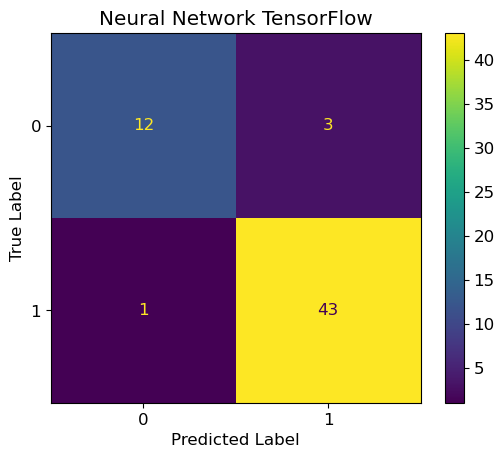

In [359]:
cm = confusion_matrix(y_test1, y_pred1)

# Increase the figure size and font size
plt.figure(figsize=(10, 8))
plt.rcParams.update({'font.size': 12})

# Display the confusion matrix with color normalization and a color bar
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0,1])
disp = disp.plot(values_format='d', colorbar=True)

# Set the title and axis labels
plt.title('Neural Network TensorFlow')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')

plt.show()

In [150]:
def create_model(regularizer_value = 0.02, optimization = tf.keras.optimizers.RMSprop, learning_rate=0.0005):
    NN_cls1 = Sequential([
        Dense(30, activation='relu', name='L1', kernel_regularizer=regularizers.l2(regularizer_value)),
        Dense(15, activation='relu', name='L2', kernel_regularizer=regularizers.l2(regularizer_value)),
        Dense(2, activation='linear', name='L3')
    ])
    
    NN_cls1.compile(
        loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        optimizer=optimization(learning_rate),
        metrics=['accuracy']
    )
    
    return NN_cls1

In [151]:
NN_cls1 = KerasClassifier(build_fn=create_model, epochs=200, validation_data=(x_test1, y_test1), verbose=1)
NN_cls1.fit(x_train1,y_train1)

Epoch 1/200
5/5 [==============================] - 1s 56ms/step - loss: 1.5656 - accuracy: 0.3162 - val_loss: 1.5493 - val_accuracy: 0.3220
Epoch 2/200
5/5 [==============================] - 0s 10ms/step - loss: 1.4920 - accuracy: 0.4044 - val_loss: 1.5044 - val_accuracy: 0.4407
Epoch 3/200
5/5 [==============================] - 0s 11ms/step - loss: 1.4456 - accuracy: 0.4853 - val_loss: 1.4739 - val_accuracy: 0.4407
Epoch 4/200
5/5 [==============================] - 0s 10ms/step - loss: 1.4130 - accuracy: 0.5368 - val_loss: 1.4465 - val_accuracy: 0.4407
Epoch 5/200
5/5 [==============================] - 0s 11ms/step - loss: 1.3844 - accuracy: 0.6103 - val_loss: 1.4214 - val_accuracy: 0.4576
Epoch 6/200
5/5 [==============================] - 0s 10ms/step - loss: 1.3582 - accuracy: 0.6765 - val_loss: 1.3965 - val_accuracy: 0.4746
Epoch 7/200
5/5 [==============================] - 0s 11ms/step - loss: 1.3330 - accuracy: 0.6912 - val_loss: 1.3722 - val_accuracy: 0.5763
Epoch 8/200
5/5 [===

KeyboardInterrupt: 

In [368]:
param_grid = {
    'regularizer_value': [0.001, 0.005 , 0.05 , 0.02 , 0.01],
    'optimization': [tf.keras.optimizers.Adam, tf.keras.optimizers.RMSprop, tf.keras.optimizers.SGD,tf.keras.optimizers.Adamax],
    'learning_rate': [0.0005, 0.001, 0.005]
}


In [369]:
grid_search = GridSearchCV(estimator=NN_cls1, param_grid=param_grid, cv=5,scoring='recall_macro')

In [370]:
grid_result = grid_search.fit(x_test1, y_test1)

Epoch 1/200
2/2 [==============================] - 1s 227ms/step - loss: 0.6221 - accuracy: 0.7660 - val_loss: 0.6068 - val_accuracy: 0.7797
Epoch 2/200
2/2 [==============================] - 0s 42ms/step - loss: 0.6099 - accuracy: 0.7872 - val_loss: 0.5961 - val_accuracy: 0.7966
Epoch 3/200
2/2 [==============================] - 0s 43ms/step - loss: 0.5989 - accuracy: 0.8085 - val_loss: 0.5858 - val_accuracy: 0.7966
Epoch 4/200
2/2 [==============================] - 0s 46ms/step - loss: 0.5889 - accuracy: 0.8085 - val_loss: 0.5759 - val_accuracy: 0.8136
Epoch 5/200
2/2 [==============================] - 0s 45ms/step - loss: 0.5785 - accuracy: 0.8085 - val_loss: 0.5666 - val_accuracy: 0.8305
Epoch 6/200
2/2 [==============================] - 0s 39ms/step - loss: 0.5688 - accuracy: 0.8085 - val_loss: 0.5577 - val_accuracy: 0.8305
Epoch 7/200
2/2 [==============================] - 0s 41ms/step - loss: 0.5600 - accuracy: 0.8085 - val_loss: 0.5492 - val_accuracy: 0.8475
Epoch 8/200
2/2 [==

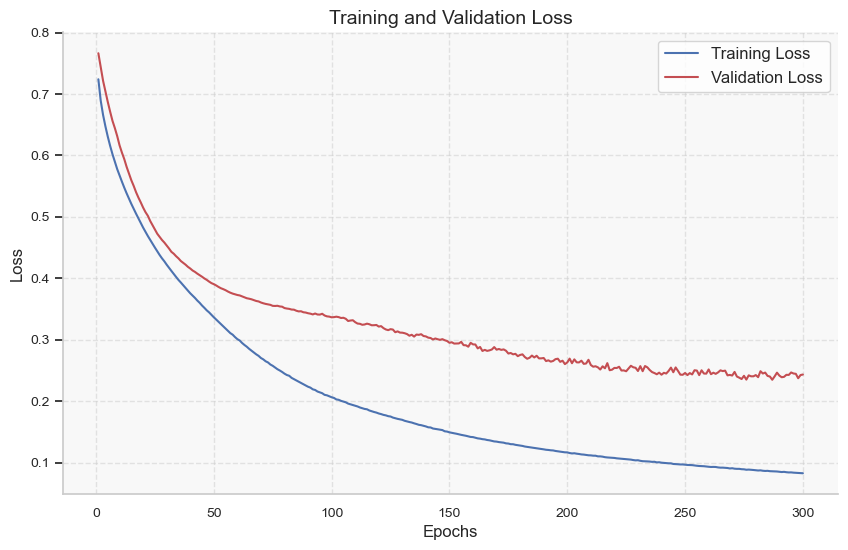

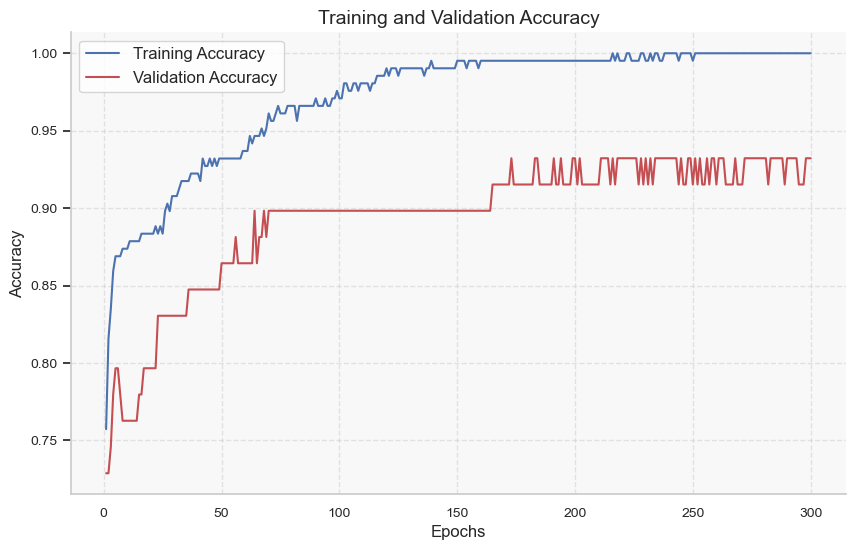

In [24]:
sns.set(style="whitegrid")

train_loss = history.history['loss']
val_loss = history.history['val_loss']
train_acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

# Plot the learning curves
epochs = range(1, len(train_loss) + 1)

# Plot loss curves
plt.figure(figsize=(10, 6))

plt.plot(epochs, train_loss, 'b-', label='Training Loss')
plt.plot(epochs, val_loss, 'r-', label='Validation Loss')

plt.xlabel('Epochs', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Training and Validation Loss', fontsize=14)
plt.legend(fontsize=12)

# Add grid lines
plt.grid(True, linestyle='--', alpha=0.5)

# Set the background color
plt.gca().set_facecolor('#f8f8f8')

# Customize the tick parameters
plt.tick_params(axis='both', which='both', bottom=False, top=False, left=True, right=False, labelsize=10)

# Remove the spines
sns.despine()

# Add a sleek border
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.show()

# Plot accuracy curves
plt.figure(figsize=(10, 6))

plt.plot(epochs, train_acc, 'b-', label='Training Accuracy')
plt.plot(epochs, val_acc, 'r-', label='Validation Accuracy')

plt.xlabel('Epochs', fontsize=12)
plt.ylabel('Accuracy', fontsize=12)
plt.title('Training and Validation Accuracy', fontsize=14)
plt.legend(fontsize=12)

# Add grid lines
plt.grid(True, linestyle='--', alpha=0.5)

# Set the background color
plt.gca().set_facecolor('#f8f8f8')

# Customize the tick parameters
plt.tick_params(axis='both', which='both', bottom=False, top=False, left=True, right=False, labelsize=10)

# Remove the spines
sns.despine()

# Add a sleek border
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)

plt.show()


2/2 [==============================] - 0s 2ms/step


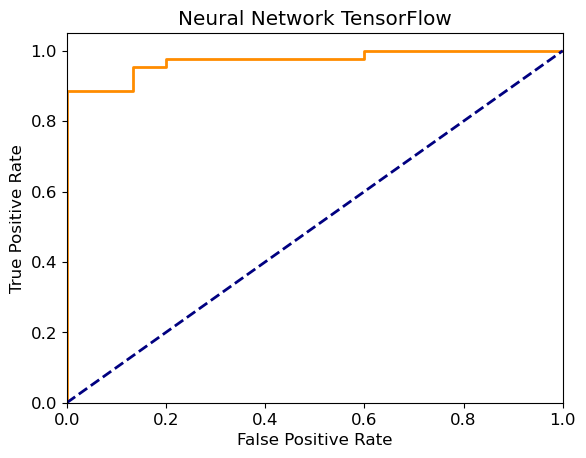

In [703]:
y_pred = NN_cls1.predict(x_test1)

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr, tpr, thresholds = roc_curve(y_test1, y_pred[:, 1])  # Use y_pred[:, 1] for the positive class probabilities
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Neural Network TensorFlow')
plt.show()

# Random Forest

In [689]:
RF_Model1 = RandomForestClassifier()
RF_Model1.fit(x_train1,y_train1)
ypred1=RF_Model1.predict(x_test1)

In [690]:
evaluate_model(y_test1,ypred1)

Accuracy of the model is: 91.53 %
Precision of the model is: 93.33 %
Recall of the model is: 95.45 %
AUC value of the model is: 87.73 %
F1 score of the model is: 94.38 %


In [691]:
print(classification_report(y_test1,ypred1))

              precision    recall  f1-score   support

           0       0.86      0.80      0.83        15
           1       0.93      0.95      0.94        44

    accuracy                           0.92        59
   macro avg       0.90      0.88      0.89        59
weighted avg       0.91      0.92      0.91        59



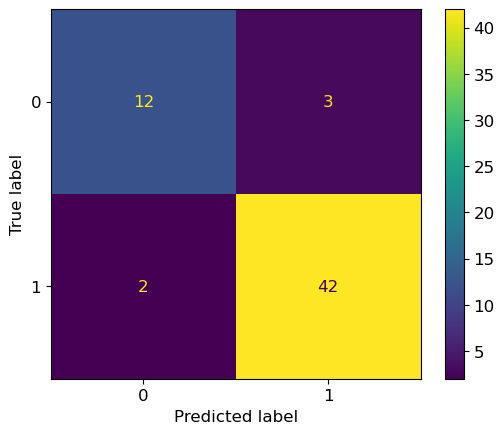

In [692]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred1)

### Grid Search CV

In [576]:
n_estimators = [100, 300, 700, 1000]
criterion = ['gini','entropy','log_loss']
max_depth = [10,20,50,100]
bootstrap=[True,False]
grid = dict(n_estimators=n_estimators, criterion=criterion, max_depth=max_depth, bootstrap=bootstrap) # creating dictionary to store the lists

In [577]:
GC_RF1 = GridSearchCV(estimator=RF_Model1, param_grid=grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_RF1_result = GC_RF1.fit(x_test1, y_test1) # fitting the grid search on the training data



In [578]:
print("Highest Recall is achieved using the parameters : " , ( GC_RF1_result.best_params_))

Highest Recall is achieved using the parameters :  {'bootstrap': False, 'criterion': 'entropy', 'max_depth': 10, 'n_estimators': 300}


In [579]:
RF_Model1.n_estimators = GC_RF1_result.best_params_['n_estimators']
RF_Model1.criterion = GC_RF1_result.best_params_['criterion']
RF_Model1.max_depth = GC_RF1_result.best_params_['max_depth']
RF_Model1.bootstrap = GC_RF1_result.best_params_['bootstrap']

In [580]:
RF_Model1.fit(x_train1,y_train1)


RandomForestClassifier(bootstrap=False, criterion='entropy', max_depth=10,
                       n_estimators=300)

In [581]:
ypred1=RF_Model1.predict(x_test1)

In [582]:
evaluate_model(y_test1,ypred1)

Accuracy of the model is: 89.83 %
Precision of the model is: 88.00 %
Recall of the model is: 100.00 %
AUC value of the model is: 80.00 %
F1 score of the model is: 93.62 %


In [583]:
print(classification_report(y_test1,ypred1))

              precision    recall  f1-score   support

           0       1.00      0.60      0.75        15
           1       0.88      1.00      0.94        44

    accuracy                           0.90        59
   macro avg       0.94      0.80      0.84        59
weighted avg       0.91      0.90      0.89        59



Text(0.5, 1.0, 'Random Forest')

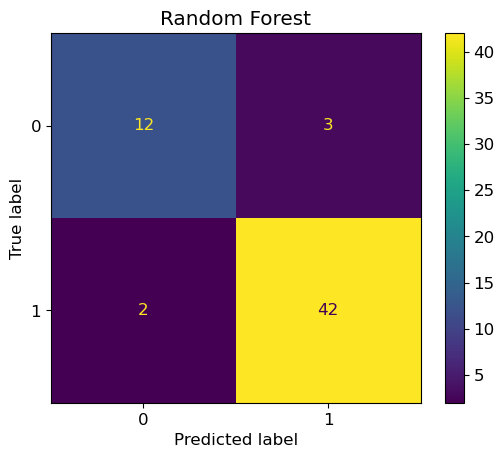

In [632]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred1)
plt.title('Random Forest')

### Genetic Algorithm Search CV

In [372]:
param_grid = {'bootstrap': Categorical([True, False]),
              'max_depth': Integer(2, 30), 
              'max_leaf_nodes': Integer(2, 35), 
              'n_estimators': Integer(100, 1000),
              'criterion' : Categorical(['gini','entropy','log_loss'])}
cv = StratifiedKFold(n_splits=3, shuffle=True)



In [373]:
RF1_evolved = GASearchCV(estimator=RF_Model1,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=15,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

In [374]:
RF1_evolved.fit(x_test1,y_test1)


gen	nevals	fitness 	fitness_std	fitness_max	fitness_min
0  	10    	0.751667	0.0551875  	0.811111   	0.620635   
1  	20    	0.776429	0.022462   	0.811111   	0.754762   
2  	17    	0.780794	0.0244872  	0.811111   	0.73254    
3  	19    	0.788571	0.0242738  	0.811111   	0.744444   
4  	20    	0.791746	0.022755   	0.811111   	0.744444   
5  	19    	0.776111	0.0310001  	0.810317   	0.722222   
6  	18    	0.793968	0.0184332  	0.811111   	0.754762   
7  	18    	0.788254	0.0185103  	0.811111   	0.754762   
8  	18    	0.797302	0.0109581  	0.811111   	0.776984   
9  	19    	0.780397	0.0343387  	0.811111   	0.721429   
10 	19    	0.78619 	0.0244934  	0.811111   	0.742857   
11 	19    	0.789444	0.0185994  	0.811111   	0.742857   
12 	17    	0.790794	0.0237968  	0.811111   	0.733333   
13 	19    	0.784206	0.0391189  	0.811111   	0.688889   
14 	18    	0.792063	0.0304993  	0.811111   	0.722222   
15 	19    	0.791905	0.0215803  	0.811111   	0.742857   


GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=3, random_state=None, shuffle=True),
           estimator=RandomForestClassifier(criterion='log_loss', max_depth=13,
                                            max_leaf_nodes=28,
                                            n_estimators=106),
           generations=15, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'bootstrap': <sklearn_genetic.space.space.Categorical object at 0x00000255A3B...
                       'criterion': <sklearn_genetic.space.space.Categorical object at 0x00000255A3BAC9D0>,
                       'max_depth': <sklearn_genetic.space.space.Integer object at 0x00000255A3BAF880>,
                       'max_leaf_nodes': <sklearn_genetic.space.space.Integer object at 0x00000255A3BAFA00>,
                       'n_estimators': <sklearn_genetic.space.space.Integer object at 0x00000255A3BAD600>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [375]:
RF1_evolved.best_params_

{'bootstrap': True,
 'max_depth': 13,
 'max_leaf_nodes': 28,
 'n_estimators': 106,
 'criterion': 'log_loss'}

In [376]:
RF_Model1.n_estimators = RF1_evolved.best_params_['n_estimators']
RF_Model1.criterion = RF1_evolved.best_params_['criterion']
RF_Model1.max_depth = RF1_evolved.best_params_['max_depth']
RF_Model1.bootstrap = RF1_evolved.best_params_['bootstrap']

In [377]:
RF_Model1.fit(x_train1,y_train1)
ypred1 = RF_Model1.predict(x_test1)


In [378]:
evaluate_model(y_test1,ypred1)

Accuracy of the model is: 88.14 %
Precision of the model is: 87.76 %
Recall of the model is: 97.73 %
AUC value of the model is: 78.86 %
F1 score of the model is: 92.47 %


In [379]:
print(classification_report(y_test1,ypred1))

              precision    recall  f1-score   support

           0       0.90      0.60      0.72        15
           1       0.88      0.98      0.92        44

    accuracy                           0.88        59
   macro avg       0.89      0.79      0.82        59
weighted avg       0.88      0.88      0.87        59



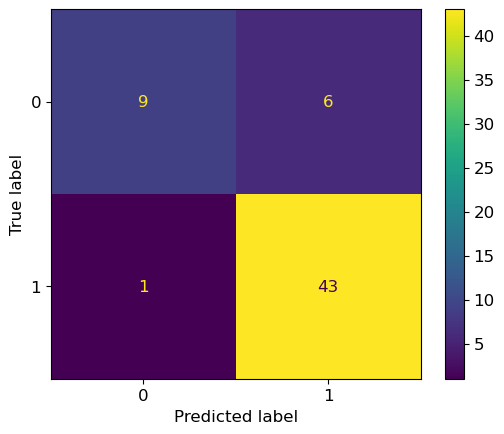

In [380]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred1)

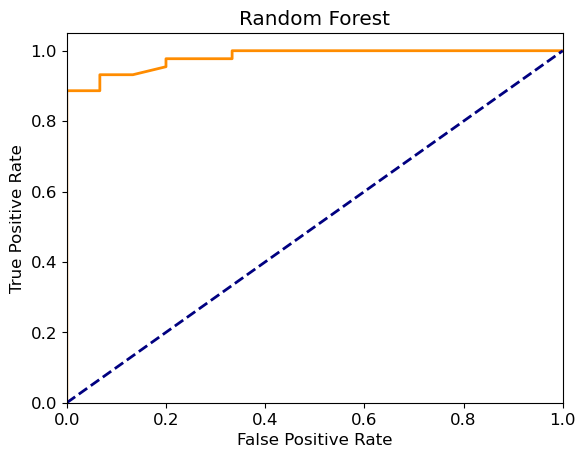

In [693]:
y_pred1 = RF_Model1.predict_proba(x_test1)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr1, tpr1, thresholds1 = roc_curve(y_test1, y_pred1)
roc_auc1 = roc_auc_score(y_test1, y_pred1)

# Plot the ROC curve for RandomForest model
plt.figure()
plt.plot(fpr1, tpr1, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest')
plt.show()

In [135]:
explainer = shap.TreeExplainer(RF_Model1)
shap_values = explainer.shap_values(x_test1, check_additivity=False)


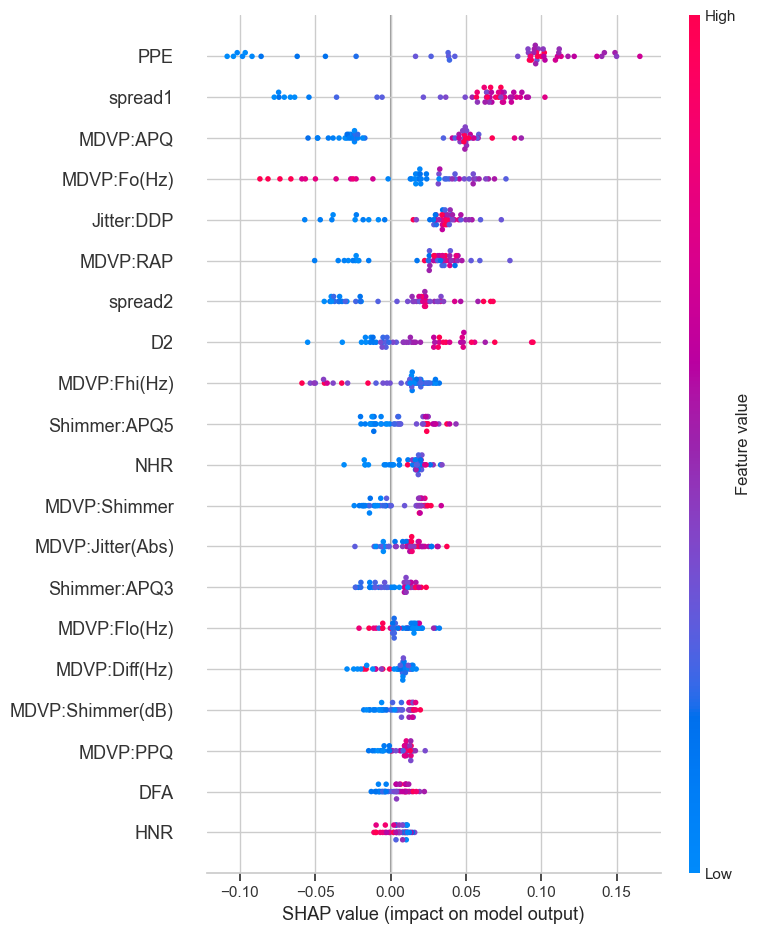

In [136]:
feature_names = X1.columns
# For class 1 (positive class)
shap.summary_plot(shap_values[1], x_test1, feature_names=feature_names)

# Decision Tree

In [633]:
DT_Model1=DecisionTreeClassifier()

In [634]:
DT_Model1.fit(x_train1,y_train1)
ypred2=DT_Model1.predict(x_test1)

In [635]:
evaluate_model(y_test1,ypred2)

Accuracy of the model is: 94.92 %
Precision of the model is: 93.62 %
Recall of the model is: 100.00 %
AUC value of the model is: 90.00 %
F1 score of the model is: 96.70 %


In [636]:
print(classification_report(y_test1,ypred2))

              precision    recall  f1-score   support

           0       1.00      0.80      0.89        15
           1       0.94      1.00      0.97        44

    accuracy                           0.95        59
   macro avg       0.97      0.90      0.93        59
weighted avg       0.95      0.95      0.95        59



Text(0.5, 1.0, 'Decision Tree')

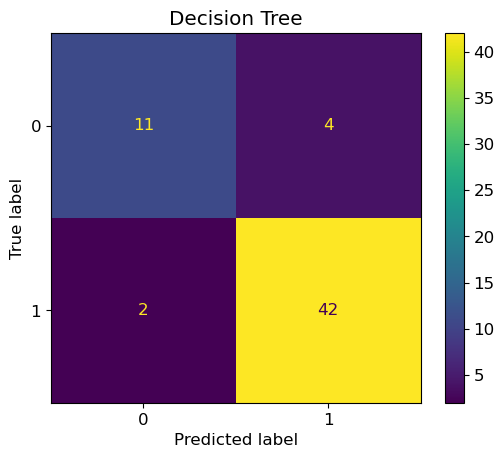

In [645]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred2)
plt.title('Decision Tree')

### Grid Search CV

In [638]:
splitter= ['best','random']
criterion = ['gini','entropy','log_loss']
max_depth = [10,20,50,100,200,500]
grid = dict(splitter=splitter, criterion=criterion, max_depth=max_depth) # creating dictionary to store the lists

In [639]:
GC_DT1 = GridSearchCV(estimator=DT_Model1, param_grid=grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_DT1_result = GC_DT1.fit(x_test1, y_test1) # fitting the grid search on the training data
print("Highest Recall is achieved using the parameters : " , ( GC_DT1_result.best_params_))


Highest Recall is achieved using the parameters :  {'criterion': 'log_loss', 'max_depth': 20, 'splitter': 'best'}


In [640]:

DT_Model1.splitter = GC_DT1_result.best_params_['splitter']
DT_Model1.criterion = GC_DT1_result.best_params_['criterion']
DT_Model1.max_depth = GC_DT1_result.best_params_['max_depth']

In [641]:
DT_Model1.fit(x_train1,y_train1)
ypred2=DT_Model1.predict(x_test1)

In [642]:
evaluate_model(y_test1,ypred2)

Accuracy of the model is: 89.83 %
Precision of the model is: 91.30 %
Recall of the model is: 95.45 %
AUC value of the model is: 84.39 %
F1 score of the model is: 93.33 %


In [643]:
print(classification_report(y_test1,ypred2))

              precision    recall  f1-score   support

           0       0.85      0.73      0.79        15
           1       0.91      0.95      0.93        44

    accuracy                           0.90        59
   macro avg       0.88      0.84      0.86        59
weighted avg       0.90      0.90      0.90        59



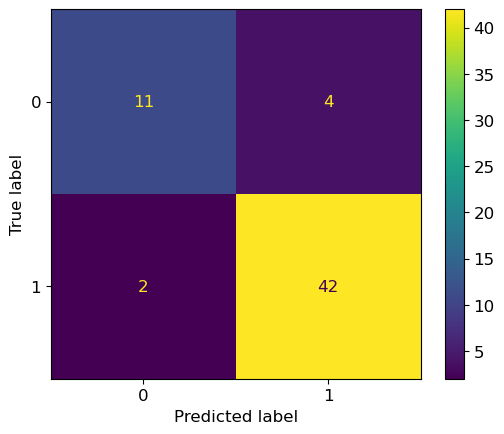

In [644]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred2)

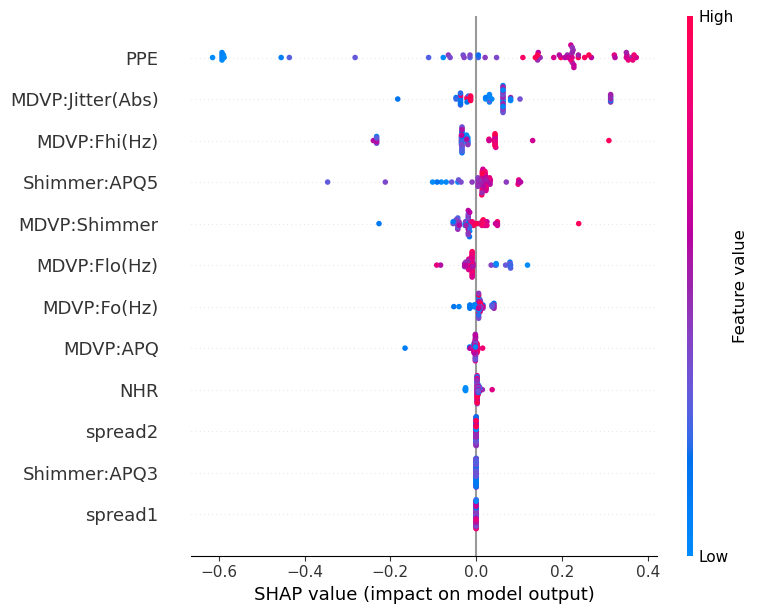

In [409]:
explainer = shap.TreeExplainer(DT_Model1)

# Calculate SHAP values
shap_values = explainer.shap_values(x_test1, check_additivity=False)

# Define feature names
feature_names = X1.columns

# Create a summary plot for class 1 (positive class)
shap.summary_plot(shap_values[1], x_test1, feature_names=feature_names)

### Genetic Algorithm Search CV

In [410]:
param_grid = { 'splitter' : Categorical(['best','random']),
              'criterion' : Categorical(['gini','entropy','log_loss']),
               'max_depth' : Integer(10,500)
             }
cv = StratifiedKFold(n_splits=3, shuffle=True)


In [411]:
DT_Model1=DecisionTreeClassifier()
DT1_evolved = GASearchCV(estimator=DT_Model1,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=30,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

In [412]:
DT1_evolved.fit(x_test1,y_test1)

gen	nevals	fitness 	fitness_std	fitness_max	fitness_min
0  	10    	0.709762	0.0569408  	0.77619    	0.630159   
1  	19    	0.744206	0.0305984  	0.788095   	0.685714   
2  	16    	0.755317	0.0236344  	0.788095   	0.720635   
3  	17    	0.757857	0.0335696  	0.788095   	0.698413   
4  	17    	0.794683	0.0322188  	0.888889   	0.765873   
5  	17    	0.798175	0.0302381  	0.888889   	0.788095   
6  	17    	0.79127 	0.0385047  	0.888889   	0.719048   
7  	17    	0.826905	0.0576678  	0.888889   	0.719048   
8  	17    	0.828175	0.055373   	0.888889   	0.731746   
9  	18    	0.775397	0.073589   	0.888889   	0.663492   
10 	18    	0.836667	0.055286   	0.888889   	0.719841   
11 	20    	0.824921	0.0592514  	0.888889   	0.719841   
12 	20    	0.816905	0.0772684  	0.888889   	0.684921   
13 	18    	0.827063	0.0676072  	0.888889   	0.719048   
14 	18    	0.835159	0.0663399  	0.888889   	0.743651   
15 	20    	0.855476	0.0675345  	0.888889   	0.7        
16 	16    	0.850873	0.0585201  	0.888889   	0.74

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=3, random_state=None, shuffle=True),
           estimator=DecisionTreeClassifier(criterion='log_loss', max_depth=279,
                                            splitter='random'),
           generations=30, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'criterion': <sklearn_genetic.space.space.Categorical object at 0x00000255A61213F0>,
                       'max_depth': <sklearn_genetic.space.space.Integer object at 0x00000255A6121C90>,
                       'splitter': <sklearn_genetic.space.space.Categorical object at 0x00000255A6122D70>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [413]:
DT_Model1.splitter = DT1_evolved.best_params_['splitter']
DT_Model1.criterion = DT1_evolved.best_params_['criterion']
DT_Model1.max_depth = DT1_evolved.best_params_['max_depth']

In [414]:
DT_Model1.fit(x_train1,y_train1)

DecisionTreeClassifier(criterion='log_loss', max_depth=279, splitter='random')

In [415]:
ypred2=DT_Model1.predict(x_test1)

In [416]:
evaluate_model(y_test1,ypred2)

Accuracy of the model is: 91.53 %
Precision of the model is: 91.49 %
Recall of the model is: 97.73 %
AUC value of the model is: 85.53 %
F1 score of the model is: 94.51 %


In [417]:
print(classification_report(y_test1,ypred2))

              precision    recall  f1-score   support

           0       0.92      0.73      0.81        15
           1       0.91      0.98      0.95        44

    accuracy                           0.92        59
   macro avg       0.92      0.86      0.88        59
weighted avg       0.92      0.92      0.91        59



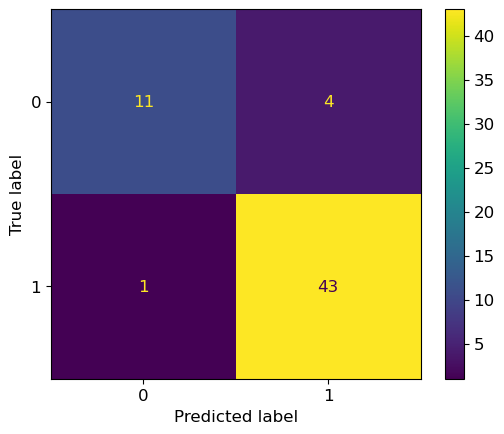

In [418]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred2)

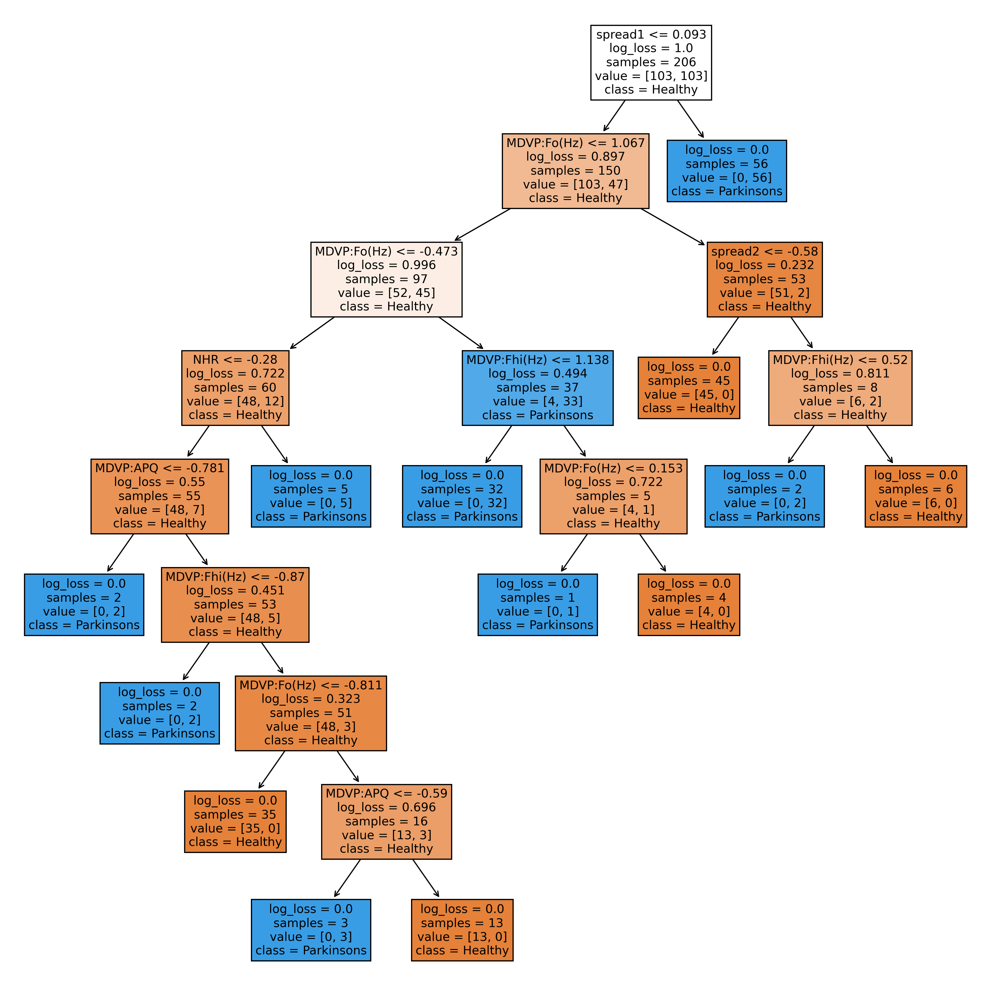

In [756]:
from sklearn.tree import plot_tree

# Plot the decision tree
plt.figure(figsize=(15, 15), dpi = 300)
plot_tree(DT_Model1, feature_names=X1.columns, class_names=['Healthy', 'Parkinsons'], filled=True)
plt.show()

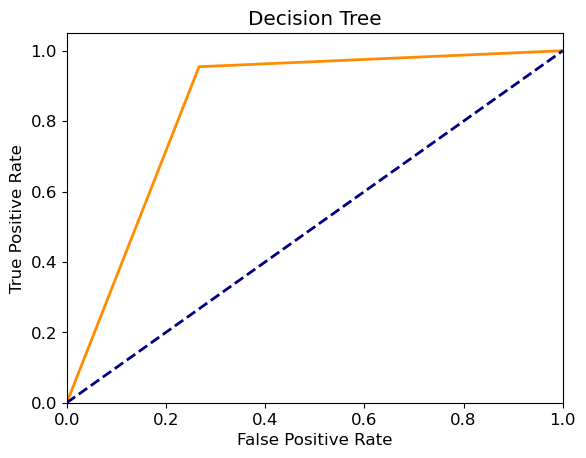

In [705]:
y_pred2 = DT_Model1.predict_proba(x_test1)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr2, tpr2, thresholds2 = roc_curve(y_test1, y_pred2)
roc_auc2 = roc_auc_score(y_test1, y_pred2)

# Plot the ROC curve for Decision Tree model
plt.figure()
plt.plot(fpr2, tpr2, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Decision Tree')
plt.show()

# SVM Model

In [646]:
SVM_Model1=SVC()

In [647]:
SVM_Model1.fit(x_train1,y_train1)
ypred3=SVM_Model1.predict(x_test1)

In [648]:
evaluate_model(y_test1,ypred3)

Accuracy of the model is: 91.53 %
Precision of the model is: 95.35 %
Recall of the model is: 93.18 %
AUC value of the model is: 89.92 %
F1 score of the model is: 94.25 %


In [649]:
print(classification_report(y_test1,ypred3))

              precision    recall  f1-score   support

           0       0.81      0.87      0.84        15
           1       0.95      0.93      0.94        44

    accuracy                           0.92        59
   macro avg       0.88      0.90      0.89        59
weighted avg       0.92      0.92      0.92        59



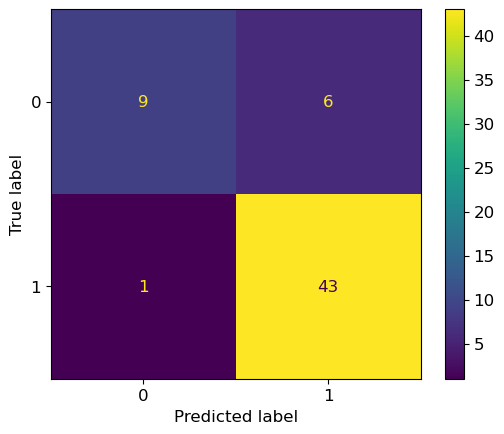

In [424]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred3)

### Grid Search CV

In [650]:
C = [1.0 , 5.0, 10.0 , 20.0]
kernel = ['linear','poly','rbf','sigmoid']
degree =[2,3,5,7]
gamma = ['scale','auto']
grid = dict(C =C , kernel = kernel , gamma =gamma , degree = degree)

In [651]:
GC_SVM1 = GridSearchCV(estimator=SVM_Model1, param_grid=grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_SVM1_result = GC_SVM1.fit(x_test1, y_test1) 
print("Highest Recall is achieved using the parameters : " , ( GC_SVM1_result.best_params_))

Highest Recall is achieved using the parameters :  {'C': 10.0, 'degree': 2, 'gamma': 'scale', 'kernel': 'linear'}


In [708]:
SVM_Model1.C = GC_SVM1_result.best_params_['C']
SVM_Model1.kernel = GC_SVM1_result.best_params_['kernel']
SVM_Model1.gamma = GC_SVM1_result.best_params_['gamma']
SVM_Model1.degree = GC_SVM1_result.best_params_['degree']
SVM_Model1.probability = True

In [710]:
SVM_Model1.fit(x_train1,y_train1)
ypred3=SVM_Model1.predict(x_test1)

In [711]:
evaluate_model(y_test1,ypred3)

Accuracy of the model is: 89.83 %
Precision of the model is: 97.50 %
Recall of the model is: 88.64 %
AUC value of the model is: 90.98 %
F1 score of the model is: 92.86 %


In [712]:
print(classification_report(y_test1,ypred3))

              precision    recall  f1-score   support

           0       0.74      0.93      0.82        15
           1       0.97      0.89      0.93        44

    accuracy                           0.90        59
   macro avg       0.86      0.91      0.88        59
weighted avg       0.91      0.90      0.90        59



Text(0.5, 1.0, 'SVM')

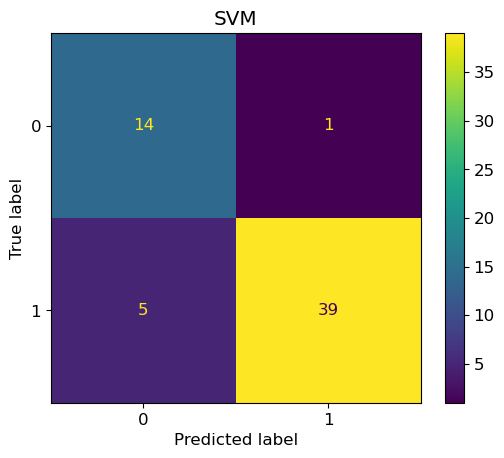

In [656]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred3)
plt.title('SVM')

### Genetic Algorithm Search CV

In [432]:
param_grid = {'kernel': Categorical(['linear','poly','rbf','sigmoid']),
              'C': Integer(1, 20), 
              'degree': Integer(2, 10), 
              'gamma': Categorical(['scale','auto'])}
cv = StratifiedKFold(n_splits=3, shuffle=True)

In [433]:
SVM1_evolved = GASearchCV(estimator=SVM_Model1,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=50,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

In [434]:
SVM1_evolved.fit(x_test1,y_test1)

gen	nevals	fitness	fitness_std	fitness_max	fitness_min
0  	10    	0.74   	0.073726   	0.876984   	0.64127    
1  	18    	0.776429	0.0465286  	0.876984   	0.710317   
2  	19    	0.793413	0.0338007  	0.876984   	0.753175   
3  	19    	0.777698	0.0243496  	0.819841   	0.742063   
4  	19    	0.796349	0.0192391  	0.819841   	0.766667   
5  	19    	0.793492	0.0227289  	0.819841   	0.755556   
6  	19    	0.813968	0.00667044 	0.819841   	0.799206   
7  	19    	0.815714	0.00963428 	0.819841   	0.788095   
8  	17    	0.817143	0.00969554 	0.821429   	0.788095   
9  	18    	0.819762	0.00320324 	0.821429   	0.810317   
10 	18    	0.815   	0.0129024  	0.831746   	0.785714   
11 	19    	0.829762	0.0186609  	0.852381   	0.797619   
12 	19    	0.832222	0.0164621  	0.844444   	0.796825   
13 	18    	0.825159	0.0175756  	0.844444   	0.796825   
14 	19    	0.830873	0.0117152  	0.844444   	0.809524   
15 	17    	0.831825	0.0200165  	0.844444   	0.77619    
16 	17    	0.834524	0.0188857  	0.844444   	0.7873

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=3, random_state=None, shuffle=True),
           estimator=SVC(C=20), generations=50, keep_top_k=4,
           mutation_probability=0.1, n_jobs=-1,
           param_grid={'C': <sklearn_genetic.space.space.Integer object at 0x00000255A3E10280>,
                       'degree': <sklearn_genetic.space.space.Integer object at 0x00000255A9990220>,
                       'gamma': <sklearn_genetic.space.space.Categorical object at 0x00000255A99901F0>,
                       'kernel': <sklearn_genetic.space.space.Categorical object at 0x00000255A2755390>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [435]:
SVM1_evolved.best_params_

{'kernel': 'rbf', 'C': 20, 'degree': 3, 'gamma': 'scale'}

In [707]:
SVM_Model1.C = SVM1_evolved.best_params_['C']
SVM_Model1.kernel = SVM1_evolved.best_params_['kernel']
SVM_Model1.gamma = SVM1_evolved.best_params_['gamma']
SVM_Model1.degree = SVM1_evolved.best_params_['degree']
SVM_Model1.probability = True

In [437]:
SVM_Model1.fit(x_train1,y_train1)
ypred3 = SVM_Model1.predict(x_test1)


In [438]:
evaluate_model(y_test1,ypred3)

Accuracy of the model is: 93.22 %
Precision of the model is: 91.67 %
Recall of the model is: 100.00 %
AUC value of the model is: 86.67 %
F1 score of the model is: 95.65 %


In [439]:
print(classification_report(y_test1,ypred3))

              precision    recall  f1-score   support

           0       1.00      0.73      0.85        15
           1       0.92      1.00      0.96        44

    accuracy                           0.93        59
   macro avg       0.96      0.87      0.90        59
weighted avg       0.94      0.93      0.93        59



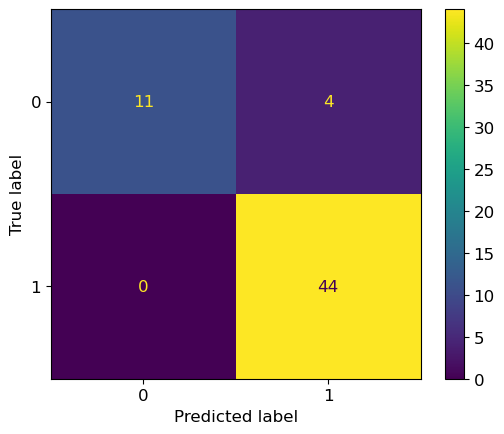

In [440]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred3)

In [161]:
explainer = shap.KernelExplainer(SVM_Model1.predict_proba, x_train1)

# Calculate SHAP values
shap_values = explainer.shap_values(x_test1, check_additivity=False)

# Define feature names
feature_names = X1.columns

# Create a summary plot for class 1 (positive class)
shap.summary_plot(shap_values[1], x_test1, feature_names=feature_names)

AttributeError: predict_proba is not available when  probability=False

Using 218 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/49 [00:00<?, ?it/s]

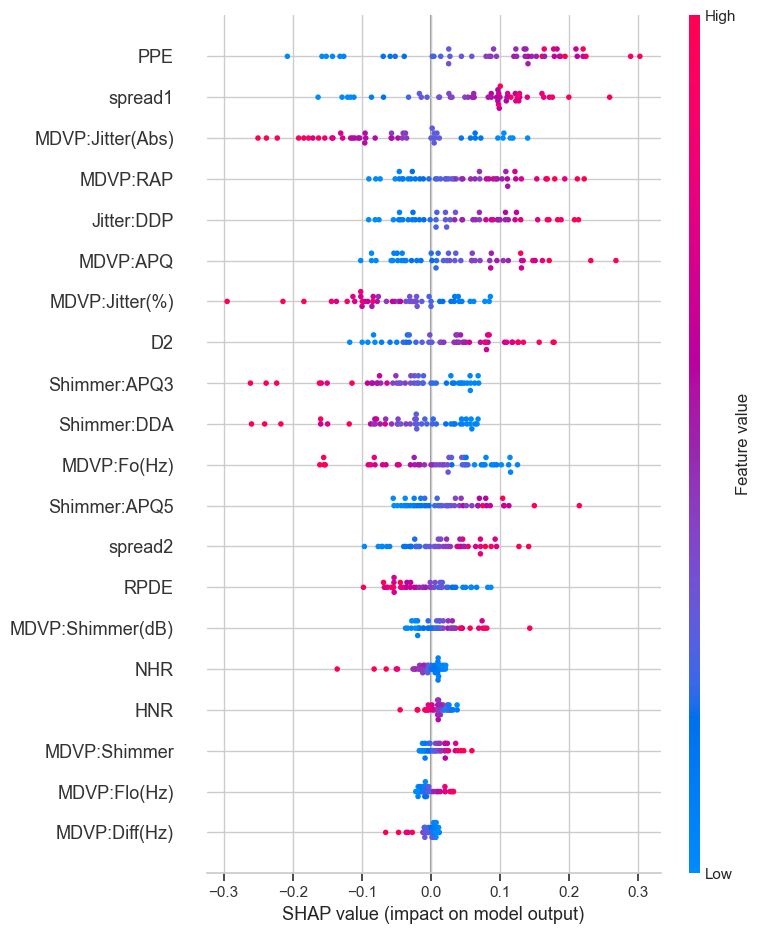

In [163]:
SVM_Model1 = SVC(kernel='linear', probability=True)  # Note the probability=True to enable SHAP values
SVM_Model1.fit(x_train1, y_train1)

# Step 2: Create a SHAP explainer
explainer = shap.KernelExplainer(SVM_Model1.predict_proba, x_train1)

# Step 3: Compute SHAP values for the test data
shap_values = explainer.shap_values(x_test1)

# Step 4: Plot the summary plot
shap.summary_plot(shap_values[1], x_test1, feature_names=X1.columns)

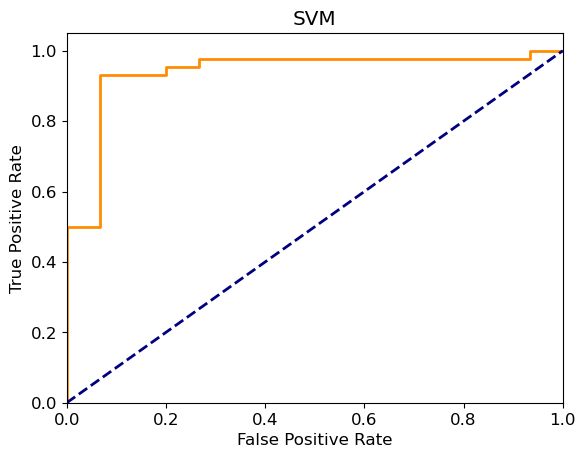

In [713]:
y_pred3 = SVM_Model1.predict_proba(x_test1)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr3, tpr3, thresholds3 = roc_curve(y_test1, y_pred3)

# Plot the ROC curve for Decision Tree model
plt.figure()
plt.plot(fpr3, tpr3, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('SVM')
plt.show()

# Logistic Regression

In [657]:
LR_Model1 = LogisticRegression()
LR_Model1.fit(x_train1,y_train1)
ypred4=LR_Model1.predict(x_test1)

In [658]:
evaluate_model(y_test1,ypred4)

Accuracy of the model is: 91.53 %
Precision of the model is: 95.35 %
Recall of the model is: 93.18 %
AUC value of the model is: 89.92 %
F1 score of the model is: 94.25 %


In [659]:
print(classification_report(y_test1,ypred4))

              precision    recall  f1-score   support

           0       0.81      0.87      0.84        15
           1       0.95      0.93      0.94        44

    accuracy                           0.92        59
   macro avg       0.88      0.90      0.89        59
weighted avg       0.92      0.92      0.92        59



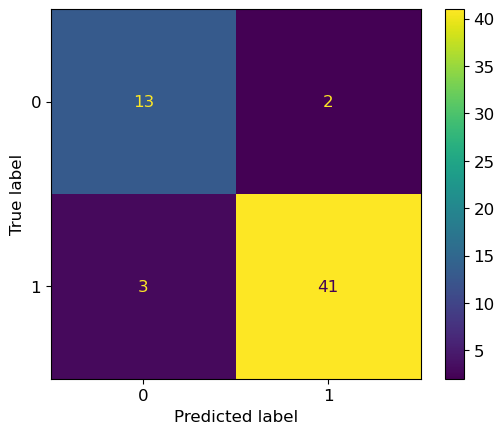

In [660]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred4)

### Grid Search CV

In [453]:
solver =  ['lbfgs', 'liblinear', 'newton-cg', 'sag']
max_iter = [100,300,500,1000]
LR_Grid = dict(solver=solver , max_iter=max_iter)
GC_LR1 = GridSearchCV(estimator=LR_Model1, param_grid=LR_Grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_LR1_result = GC_LR1.fit(x_test1, y_test1) # fitting the grid search on the training data
print("Best parameters : %s" % GC_LR1_result.best_params_)

Best parameters : {'max_iter': 100, 'solver': 'liblinear'}


In [454]:
LR_Model1.solver = GC_LR1_result.best_params_['solver']
LR_Model1.max_iter = GC_LR1_result.best_params_['max_iter']

In [455]:
LR_Model1.fit(x_train1,y_train1)
ypred4=LR_Model1.predict(x_test1)

In [456]:
evaluate_model(y_test1,ypred4)

Accuracy of the model is: 86.44 %
Precision of the model is: 87.50 %
Recall of the model is: 95.45 %
AUC value of the model is: 77.73 %
F1 score of the model is: 91.30 %


In [457]:
print(classification_report(y_test1,ypred4))

              precision    recall  f1-score   support

           0       0.82      0.60      0.69        15
           1       0.88      0.95      0.91        44

    accuracy                           0.86        59
   macro avg       0.85      0.78      0.80        59
weighted avg       0.86      0.86      0.86        59



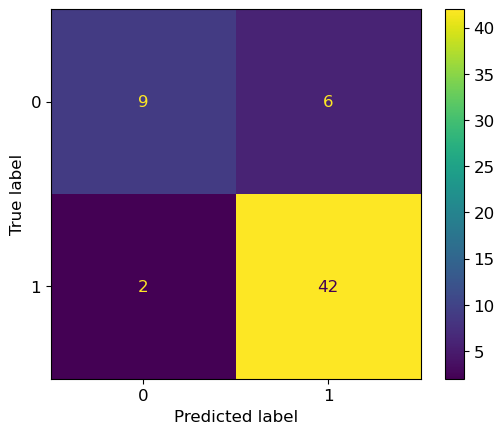

In [458]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred4)

### Genetic Algorithm Search CV

In [459]:
param_grid = {'solver': Categorical(['lbfgs', 'liblinear', 'newton-cg', 'sag']),
              'max_iter': Integer(10, 1000)}
cv = StratifiedKFold(n_splits=10, shuffle=True)

In [460]:
LR_Model1= LogisticRegression()
LR_evolved1 = GASearchCV(estimator=LR_Model1,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=30,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

LR_evolved1.fit(x_test1,y_test1)

gen	nevals	fitness	fitness_std	fitness_max	fitness_min
0  	10    	0.7645 	0.0218746  	0.795      	0.725      
1  	17    	0.81125	0.0359905  	0.865      	0.7675     
2  	18    	0.82375	0.0359209  	0.865      	0.7675     
3  	18    	0.836  	0.0302118  	0.865      	0.79       
4  	15    	0.82575	0.041368   	0.865      	0.7675     
5  	20    	0.825  	0.0357771  	0.865      	0.77       
6  	18    	0.83525	0.0259675  	0.865      	0.79       
7  	17    	0.82075	0.0361429  	0.865      	0.79       
8  	19    	0.8525 	0.0256174  	0.865      	0.79       
9  	18    	0.84   	0.0267628  	0.865      	0.795      
10 	19    	0.843  	0.0349249  	0.865      	0.77       
11 	18    	0.85325	0.0240325  	0.865      	0.795      
12 	19    	0.86225	0.00825    	0.865      	0.8375     
13 	14    	0.85775	0.02175    	0.865      	0.7925     
14 	14    	0.84775	0.0239126  	0.865      	0.7925     
15 	20    	0.84025	0.0291644  	0.865      	0.79       
16 	18    	0.843  	0.0230163  	0.865      	0.815      
17 	19    

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=True),
           estimator=LogisticRegression(max_iter=703, solver='liblinear'),
           generations=30, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'max_iter': <sklearn_genetic.space.space.Integer object at 0x00000255AA2337F0>,
                       'solver': <sklearn_genetic.space.space.Categorical object at 0x00000255AA2329E0>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [461]:
LR_evolved1.best_params_

{'solver': 'liblinear', 'max_iter': 703}

In [462]:
LR_Model1.solver =LR_evolved1.best_params_['solver']
LR_Model1.max_iter = LR_evolved1.best_params_['max_iter']

In [463]:
LR_Model1.fit(x_train1,y_train1)
ypred4=LR_Model1.predict(x_test1)

In [464]:
evaluate_model(y_test1,ypred4)

Accuracy of the model is: 86.44 %
Precision of the model is: 87.50 %
Recall of the model is: 95.45 %
AUC value of the model is: 77.73 %
F1 score of the model is: 91.30 %


In [465]:
print(classification_report(y_test1,ypred4))

              precision    recall  f1-score   support

           0       0.82      0.60      0.69        15
           1       0.88      0.95      0.91        44

    accuracy                           0.86        59
   macro avg       0.85      0.78      0.80        59
weighted avg       0.86      0.86      0.86        59



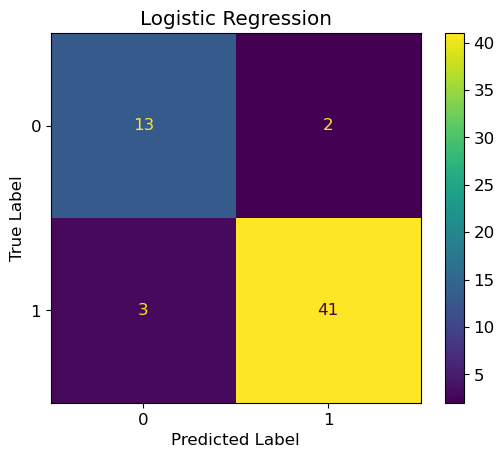

In [661]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred4)
plt.title('Logistic Regression')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

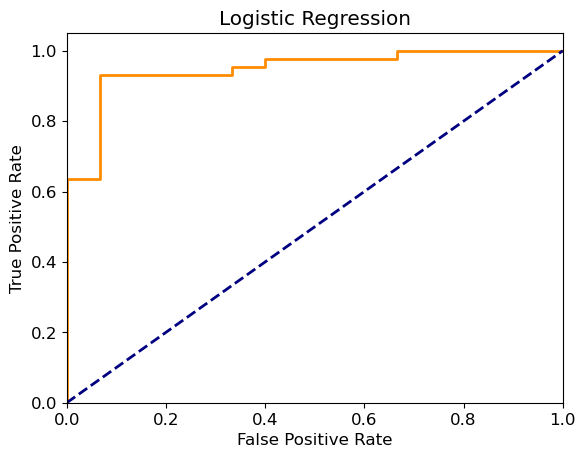

In [714]:
y_pred4 = LR_Model1.predict_proba(x_test1)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr4, tpr4, thresholds4 = roc_curve(y_test1, y_pred4)

plt.figure()
plt.plot(fpr4, tpr4, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Logistic Regression')
plt.show()

## XGBoost

In [662]:
XGB_Model1 = XGBClassifier()
XGB_Model1.fit(x_train1,y_train1)
ypred5=XGB_Model1.predict(x_test1)

In [663]:
evaluate_model(y_test1,ypred5)

Accuracy of the model is: 94.92 %
Precision of the model is: 95.56 %
Recall of the model is: 97.73 %
AUC value of the model is: 92.20 %
F1 score of the model is: 96.63 %


In [664]:
print(classification_report(y_test1, ypred5))

              precision    recall  f1-score   support

           0       0.93      0.87      0.90        15
           1       0.96      0.98      0.97        44

    accuracy                           0.95        59
   macro avg       0.94      0.92      0.93        59
weighted avg       0.95      0.95      0.95        59



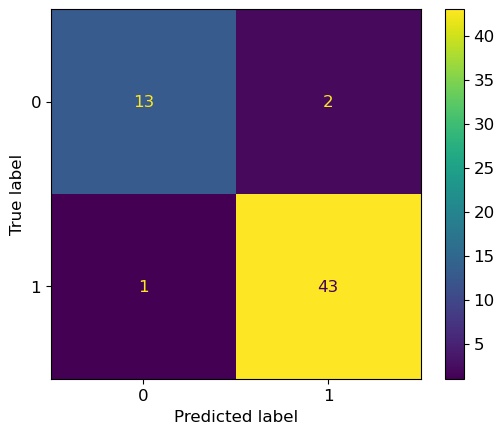

In [665]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred5)

In [596]:
n_estimators = [100, 300, 700, 1000]
subsample = [0.3,0.5,0.7,1.0]
max_depth = [2,4,10,20]
grid = dict(n_estimators=n_estimators, subsample=subsample, max_depth=max_depth) # creating dictionary to store the lists
grid_search = GridSearchCV(estimator=XGB_Model1, param_grid=grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
grid_result = grid_search.fit(x_test1, y_test1) # fitting the grid search on the training data
print("Highest ROC AUC is achieved using the parameters : " , ( grid_result.best_params_))

Highest ROC AUC is achieved using the parameters :  {'max_depth': 2, 'n_estimators': 100, 'subsample': 0.3}


In [597]:
XGB_Model1.n_estimators = grid_result.best_params_['n_estimators']
XGB_Model1.subsample = grid_result.best_params_['subsample']
XGB_Model1.max_depth = grid_result.best_params_['max_depth']

In [598]:
XGB_Model1.fit(x_train1,y_train1)
ypred5=XGB_Model1.predict(x_test1)

In [599]:
evaluate_model(y_test1,ypred5)

Accuracy of the model is: 86.44 %
Precision of the model is: 90.91 %
Recall of the model is: 90.91 %
AUC value of the model is: 82.12 %
F1 score of the model is: 90.91 %


In [600]:
print(classification_report(y_test1, ypred5))

              precision    recall  f1-score   support

           0       0.73      0.73      0.73        15
           1       0.91      0.91      0.91        44

    accuracy                           0.86        59
   macro avg       0.82      0.82      0.82        59
weighted avg       0.86      0.86      0.86        59



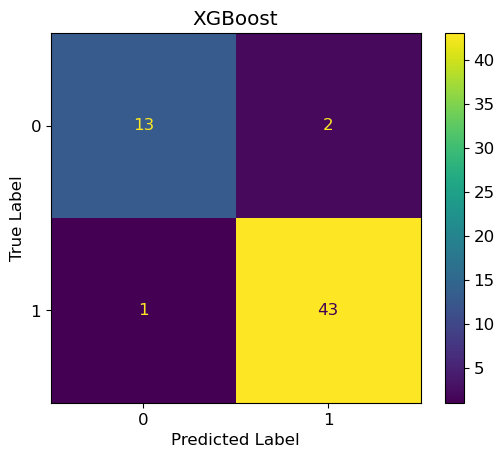

In [666]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred5)
plt.title('XGBoost')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [503]:
param_grid = {'n_estimators' : Integer(100, 1000),
              'subsample' : Continuous(0.3,1.0),
              'max_depth' : Integer(2,20)
             }
cv = StratifiedKFold(n_splits=5, shuffle=True)


In [504]:
XGB_Model1 = XGBClassifier() 
XGB_evolved1 = GASearchCV(estimator=XGB_Model1,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=25,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

XGB_evolved1.fit(x_test1,y_test1)

gen	nevals	fitness	fitness_std	fitness_max	fitness_min
0  	10    	0.7525 	0.0342738  	0.798611   	0.7        
1  	19    	0.771667	0.0191163  	0.8        	0.733333   
2  	19    	0.786667	0.0138778  	0.8        	0.766667   
3  	20    	0.791111	0.0129577  	0.8        	0.766667   
4  	17    	0.791111	0.0129577  	0.8        	0.766667   
5  	18    	0.793333	0.0166296  	0.8        	0.744444   
6  	17    	0.781944	0.0258498  	0.8        	0.731944   
7  	15    	0.78875 	0.0225021  	0.8        	0.743056   
8  	19    	0.776111	0.0216221  	0.8        	0.743056   
9  	15    	0.791528	0.0131827  	0.8        	0.765278   
10 	18    	0.8     	0          	0.8        	0.8        
11 	20    	0.796667	0.01       	0.8        	0.766667   
12 	16    	0.796528	0.0183549  	0.811111   	0.743056   
13 	18    	0.794306	0.0144398  	0.811111   	0.766667   
14 	20    	0.788333	0.0142887  	0.811111   	0.766667   
15 	20    	0.791111	0.0155556  	0.811111   	0.766667   
16 	19    	0.789861	0.0177218  	0.811111   	0.7652

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=True),
           estimator=XGBClassifier(base_score=None, booster=None,
                                   callbacks=None, colsample_bylevel=None,
                                   colsample_bynode=None, colsample_bytree=None,
                                   early_stopping_rounds=None,
                                   enable_categorical=False, eval_metric=None,
                                   feature_types=None, gamma=None, gpu_id=None,
                                   grow_...
           generations=25, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'max_depth': <sklearn_genetic.space.space.Integer object at 0x00000255ABA96D40>,
                       'n_estimators': <sklearn_genetic.space.space.Integer object at 0x00000255ABA96FE0>,
                       'subsample': <sklearn_genetic.space.space.Continuous object at 0x00000255ABA96F50>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [505]:
XGB_Model1.n_estimators = XGB_evolved1.best_params_['n_estimators']
XGB_Model1.subsample = XGB_evolved1.best_params_['subsample']
XGB_Model1.max_depth = XGB_evolved1.best_params_['max_depth']

In [506]:
XGB_Model1.fit(x_train1,y_train1)
ypred5=XGB_Model1.predict(x_test1)

In [507]:
evaluate_model(y_test1,ypred5)

Accuracy of the model is: 86.44 %
Precision of the model is: 89.13 %
Recall of the model is: 93.18 %
AUC value of the model is: 79.92 %
F1 score of the model is: 91.11 %


In [508]:
print(classification_report(y_test1, ypred5))

              precision    recall  f1-score   support

           0       0.77      0.67      0.71        15
           1       0.89      0.93      0.91        44

    accuracy                           0.86        59
   macro avg       0.83      0.80      0.81        59
weighted avg       0.86      0.86      0.86        59



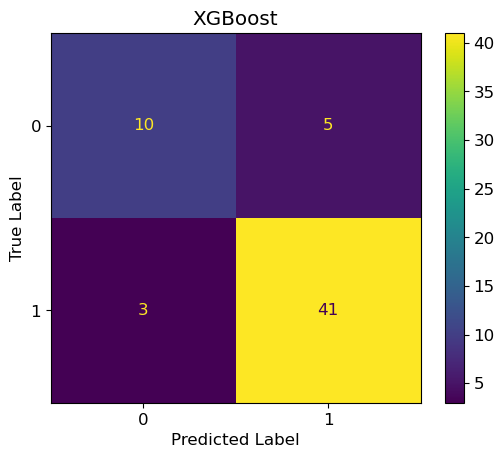

In [509]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred5)
plt.title('XGBoost')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

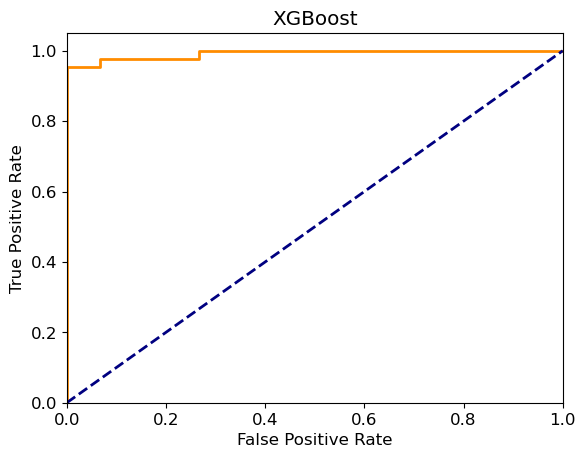

In [725]:
y_pred5 = XGB_Model1.predict_proba(x_test1)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr5, tpr5, thresholds5 = roc_curve(y_test1, y_pred5)

plt.figure()
plt.plot(fpr5, tpr5, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('XGBoost')
plt.show()

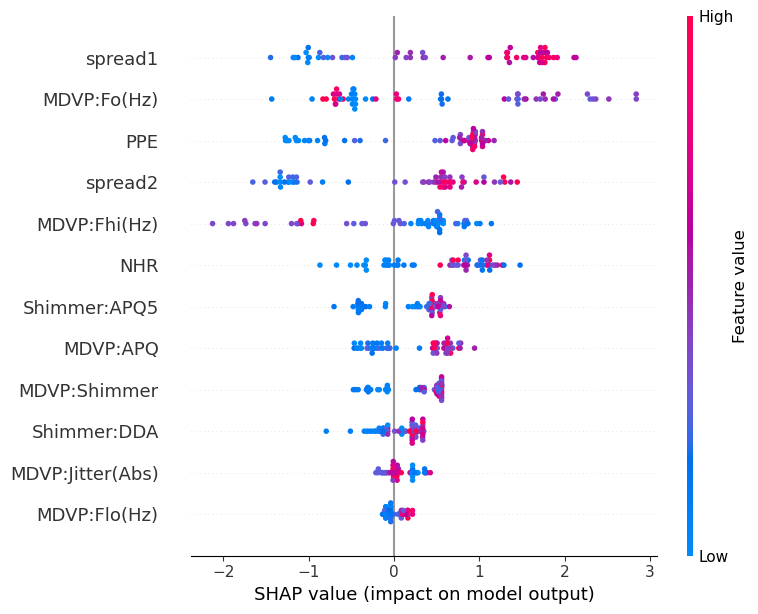

In [727]:
explainer = shap.TreeExplainer(XGB_Model1)


shap_values = explainer.shap_values(x_test1)


feature_names = X1.columns


shap.summary_plot(shap_values, x_test1, feature_names=feature_names, max_display=25)

# KNN

In [41]:
KNN_Model1 = KNeighborsClassifier(n_neighbors=1)
KNN_Model1.fit(x_train1,y_train1)
ypred6=KNN_Model1.predict(x_test1)

In [42]:
evaluate_model(y_test1,ypred6)

Accuracy of the model is: 94.92 %
Precision of the model is: 100.00 %
Recall of the model is: 93.18 %
AUC value of the model is: 96.59 %
F1 score of the model is: 96.47 %


In [43]:
print(classification_report(y_test1, ypred6))

              precision    recall  f1-score   support

           0       0.83      1.00      0.91        15
           1       1.00      0.93      0.96        44

    accuracy                           0.95        59
   macro avg       0.92      0.97      0.94        59
weighted avg       0.96      0.95      0.95        59



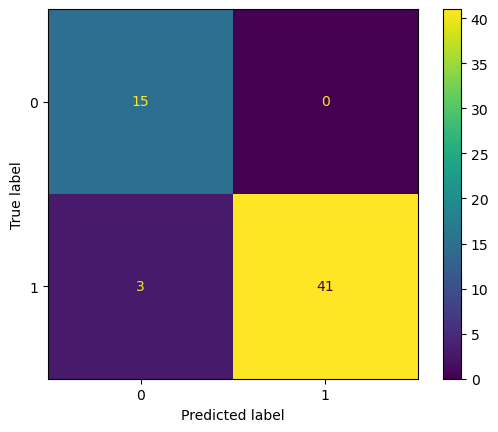

In [44]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred6)

In [34]:
n_neighbors = [1,2,5,10,20]
weights =['uniform', 'distance']
algorithm =['auto', 'ball_tree', 'kd_tree', 'brute']
p=[2,5,10,20]
grid = dict(n_neighbors =n_neighbors,weights =weights,algorithm =algorithm , p=p) # creating dictionary to store the lists


In [35]:
GC_KNN1 = GridSearchCV(estimator=KNN_Model1, param_grid=grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0) # creating grid search object for xgb
GC_KNN1_result = GC_KNN1.fit(x_test1, y_test1) # fitting the grid search on the training data
print("Highest Recall is achieved using the parameters : " , ( GC_KNN1_result.best_params_))

Highest Recall is achieved using the parameters :  {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}


In [36]:
KNN_Model1.n_neighbors= GC_KNN1_result.best_params_['n_neighbors']
KNN_Model1.weights= GC_KNN1_result.best_params_['weights']
KNN_Model1.algorithm = GC_KNN1_result.best_params_['algorithm']
KNN_Model1.p= GC_KNN1_result.best_params_['p']

In [37]:
KNN_Model1.fit(x_train1,y_train1)
ypred6=KNN_Model1.predict(x_test1)

In [38]:
evaluate_model(y_test1,ypred6)

Accuracy of the model is: 88.14 %
Precision of the model is: 100.00 %
Recall of the model is: 84.09 %
AUC value of the model is: 92.05 %
F1 score of the model is: 91.36 %


In [39]:
print(classification_report(y_test1, ypred6))

              precision    recall  f1-score   support

           0       0.68      1.00      0.81        15
           1       1.00      0.84      0.91        44

    accuracy                           0.88        59
   macro avg       0.84      0.92      0.86        59
weighted avg       0.92      0.88      0.89        59



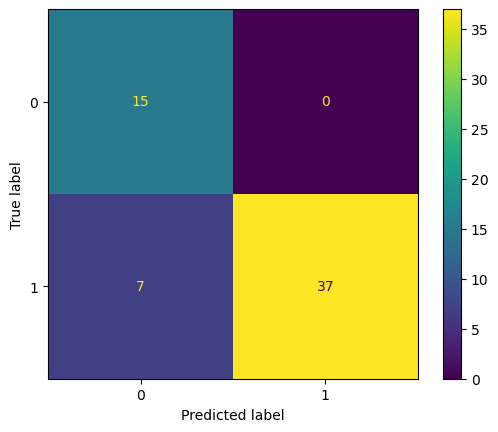

In [40]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred6)

In [677]:
param_grid = {'n_neighbors' : Integer(1,10),
               'weights': Categorical(['uniform', 'distance']),
               'algorithm' : Categorical(['auto', 'ball_tree', 'kd_tree', 'brute']),
               'p':Integer(2,20)
             }
cv = StratifiedKFold(n_splits=3, shuffle=True)

In [678]:
KNN_Model1 =  KNeighborsClassifier() 
KNN_evolved1 = GASearchCV(estimator=KNN_Model1,
                               cv=cv,
                               scoring='recall_macro',
                               population_size=10,
                               generations=50,
                               tournament_size=3,
                               elitism=True,
                               crossover_probability=0.8,
                               mutation_probability=0.1,
                               param_grid=param_grid,
                               criteria='max',
                               algorithm='eaMuPlusLambda',
                               n_jobs=-1,
                               verbose=True,
                               keep_top_k=4)

KNN_evolved1.fit(x_test1,y_test1)

gen	nevals	fitness 	fitness_std	fitness_max	fitness_min
0  	10    	0.713571	0.0549737  	0.777778   	0.609524   
1  	19    	0.750397	0.0368689  	0.777778   	0.654762   
2  	17    	0.75746 	0.0107022  	0.777778   	0.742857   
3  	19    	0.760317	0.0152703  	0.777778   	0.733333   
4  	16    	0.761825	0.0144237  	0.777778   	0.743651   
5  	19    	0.766587	0.0173171  	0.788889   	0.733333   
6  	17    	0.770952	0.0165156  	0.788889   	0.733333   
7  	15    	0.775317	0.0145887  	0.788095   	0.733333   
8  	19    	0.766111	0.0223862  	0.788095   	0.721429   
9  	19    	0.780794	0.0161593  	0.810317   	0.755556   
10 	20    	0.773175	0.0102057  	0.788889   	0.755556   
11 	19    	0.767698	0.0174893  	0.777778   	0.722222   
12 	19    	0.778889	0.00333333 	0.788889   	0.777778   
13 	20    	0.783175	0.00540382 	0.788889   	0.777778   
14 	19    	0.792063	0.0217553  	0.855556   	0.776984   
15 	20    	0.810952	0.0311487  	0.866667   	0.777778   
16 	19    	0.83873 	0.0242935  	0.866667   	0.78

GASearchCV(crossover_probability=0.8,
           cv=StratifiedKFold(n_splits=3, random_state=None, shuffle=True),
           estimator=KNeighborsClassifier(algorithm='kd_tree', n_neighbors=2,
                                          weights='distance'),
           generations=50, keep_top_k=4, mutation_probability=0.1, n_jobs=-1,
           param_grid={'algorithm': <sklearn_genetic.space.space.Categorical object at 0x00000255AD8EF0D0>,
                       'n_neighbors': <sklearn_genetic.space.space.Integer object at 0x00000255AD8EE560>,
                       'p': <sklearn_genetic.space.space.Integer object at 0x00000255AD8ED8A0>,
                       'weights': <sklearn_genetic.space.space.Categorical object at 0x00000255AD8ED090>},
           population_size=10, return_train_score=True, scoring='recall_macro')

In [679]:
KNN_evolved1.best_params_

{'n_neighbors': 2, 'weights': 'distance', 'algorithm': 'kd_tree', 'p': 2}

In [680]:
KNN_Model1.n_neighbors= KNN_evolved1.best_params_['n_neighbors']
KNN_Model1.weights= KNN_evolved1.best_params_['weights']
KNN_Model1.algorithm = KNN_evolved1.best_params_['algorithm']
KNN_Model1.p= KNN_evolved1.best_params_['p']

In [681]:
KNN_Model1.fit(x_train1,y_train1)
ypred6=KNN_Model1.predict(x_test1)

In [682]:
evaluate_model(y_test1,ypred6)

Accuracy of the model is: 93.22 %
Precision of the model is: 91.67 %
Recall of the model is: 100.00 %
AUC value of the model is: 86.67 %
F1 score of the model is: 95.65 %


In [683]:
print(classification_report(y_test1, ypred6))

              precision    recall  f1-score   support

           0       1.00      0.73      0.85        15
           1       0.92      1.00      0.96        44

    accuracy                           0.93        59
   macro avg       0.96      0.87      0.90        59
weighted avg       0.94      0.93      0.93        59



Text(0.5, 1.0, 'KNN')

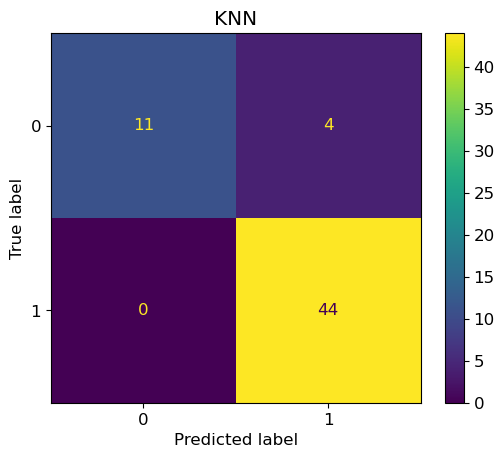

In [684]:
ConfusionMatrixDisplay.from_predictions(y_test1, ypred6)
plt.title('KNN')

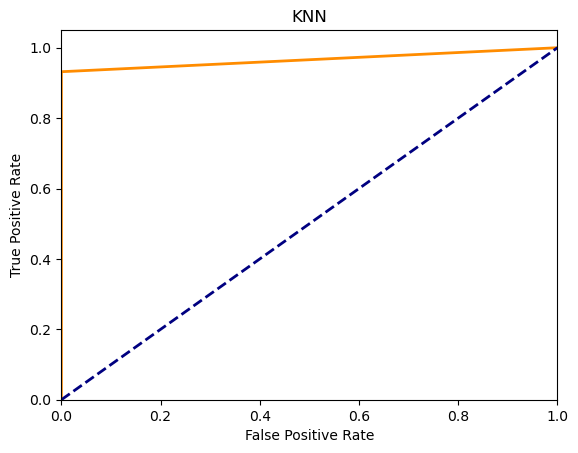

In [45]:
y_pred6 = KNN_Model1.predict_proba(x_test1)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fpr6, tpr6, thresholds6 = roc_curve(y_test1, y_pred6)

plt.figure()
plt.plot(fpr6, tpr6, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('KNN')
plt.show()

  0%|          | 0/59 [00:00<?, ?it/s]

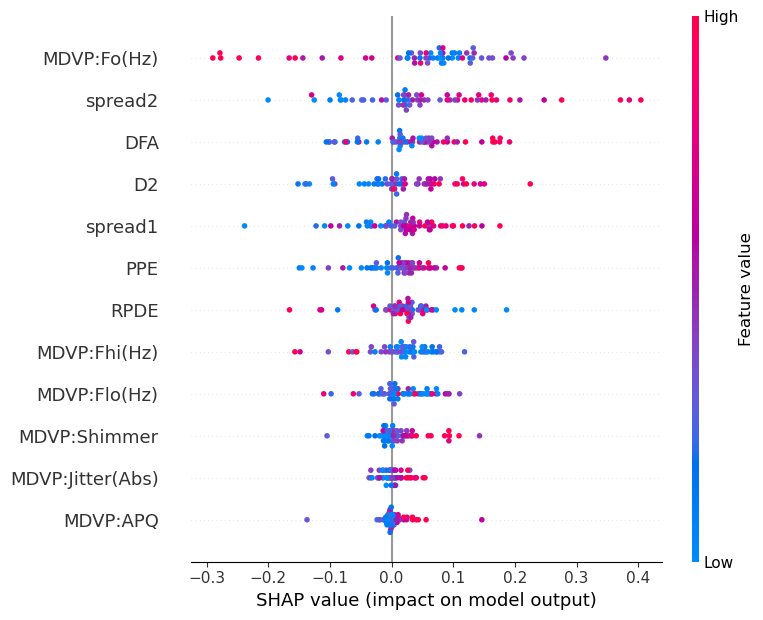

In [46]:
explainer = shap.KernelExplainer(KNN_Model1.predict_proba, shap.sample(x_train1, 30))

# Calculate SHAP values for the test data
shap_values = explainer.shap_values(x_test1)


feature_names = X1.columns

# Summary plot for SHAP values of the KNN model
shap.summary_plot(shap_values[1], x_test1, feature_names=feature_names, max_display=25)

## MLP

In [718]:
from sklearn.neural_network import MLPClassifier

mlp_model1 = MLPClassifier(hidden_layer_sizes=(100, 50), max_iter=300)


mlp_model1.fit(x_train1, y_train1)
y_pred_m= mlp_model1.predict(x_test1)

In [719]:
evaluate_model(y_pred_m,y_test1)

Accuracy of the model is: 93.22 %
Precision of the model is: 97.73 %
Recall of the model is: 93.48 %
AUC value of the model is: 92.89 %
F1 score of the model is: 95.56 %


In [720]:
print(classification_report(y_test1, y_pred_m))

              precision    recall  f1-score   support

           0       0.92      0.80      0.86        15
           1       0.93      0.98      0.96        44

    accuracy                           0.93        59
   macro avg       0.93      0.89      0.91        59
weighted avg       0.93      0.93      0.93        59



In [533]:
hidden_layer_sizes = [(100,), (100, 50), (50, 50),(100,50,25),(100,50,25,10)]
activation = ['relu', 'logistic']
solver = ['adam', 'sgd']
alpha = [0.0001, 0.001, 0.01]
max_iter = [200, 500, 1000]
param_grid = dict(hidden_layer_sizes=hidden_layer_sizes, activation=activation, solver=solver, alpha=alpha, max_iter=max_iter)
mlp_model1 = MLPClassifier()

grid_mlp = GridSearchCV(estimator=mlp_model1, param_grid=param_grid, n_jobs=-1, cv=5, scoring='recall_macro', error_score=0)


grid_mlp_result = grid_mlp.fit(x_test1, y_test1)

print("Highest Recall is achieved using the parameters:", grid_mlp_result.best_params_)

mlp_model1.set_params(**grid_mlp_result.best_params_)

Highest Recall is achieved using the parameters: {'activation': 'relu', 'alpha': 0.001, 'hidden_layer_sizes': (100,), 'max_iter': 1000, 'solver': 'adam'}


MLPClassifier(alpha=0.001, max_iter=1000)

In [534]:
mlp_model1.fit(x_train1, y_train1)
y_pred_m= mlp_model1.predict(x_test1)

In [535]:
evaluate_model(y_test1, y_pred_m)

Accuracy of the model is: 93.22 %
Precision of the model is: 93.48 %
Recall of the model is: 97.73 %
AUC value of the model is: 88.86 %
F1 score of the model is: 95.56 %


In [536]:
print(classification_report(y_test1, y_pred_m))

              precision    recall  f1-score   support

           0       0.92      0.80      0.86        15
           1       0.93      0.98      0.96        44

    accuracy                           0.93        59
   macro avg       0.93      0.89      0.91        59
weighted avg       0.93      0.93      0.93        59



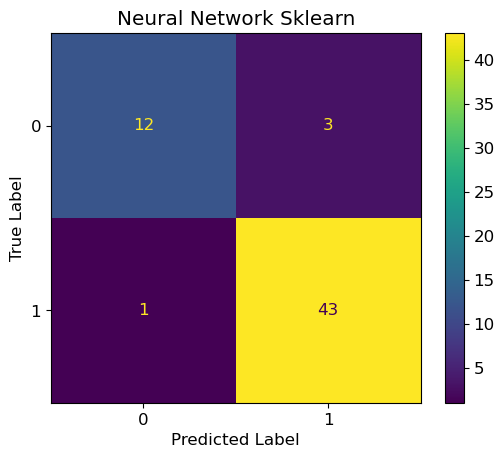

In [537]:
ConfusionMatrixDisplay.from_predictions(y_test1, y_pred_m)
plt.title('Neural Network Sklearn')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

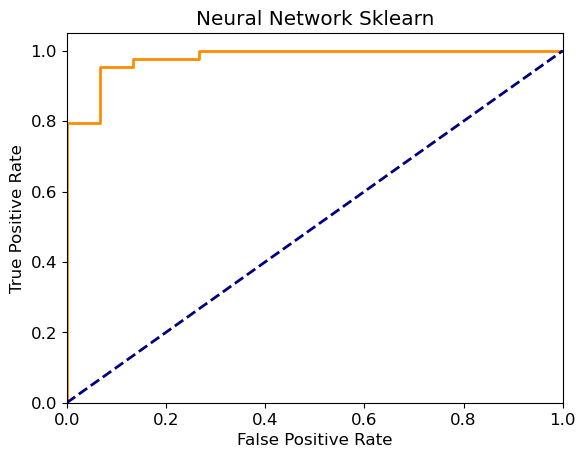

In [721]:
y_predm = mlp_model1.predict_proba(x_test1)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fprm, tprm, thresholdsm = roc_curve(y_test1, y_predm)

plt.figure()
plt.plot(fprm, tprm, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Neural Network Sklearn')
plt.show()

Using 206 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


  0%|          | 0/59 [00:00<?, ?it/s]

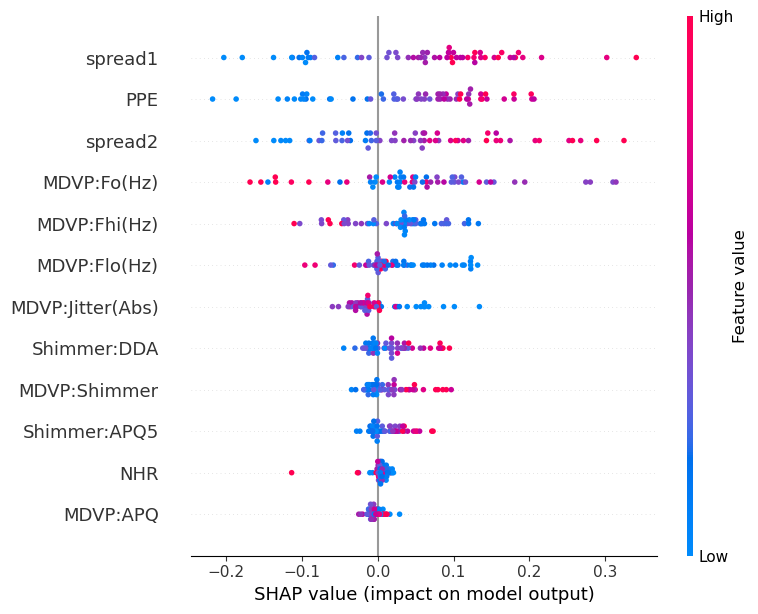

In [729]:
explainer = shap.KernelExplainer(mlp_model1.predict_proba, x_train1)


shap_values = explainer.shap_values(x_test1)


feature_names = X1.columns


shap.summary_plot(shap_values[1], x_test1, feature_names=feature_names, max_display=25)

## NB

In [685]:
from sklearn.naive_bayes import GaussianNB
NB_Model1 = GaussianNB()
NB_Model1.fit(x_train1, y_train1)
y_pred_n= NB_Model1.predict(x_test1)

In [686]:
evaluate_model(y_test1,y_pred_n)

Accuracy of the model is: 79.66 %
Precision of the model is: 92.11 %
Recall of the model is: 79.55 %
AUC value of the model is: 79.77 %
F1 score of the model is: 85.37 %


In [687]:
print(classification_report(y_test1, y_pred_n))

              precision    recall  f1-score   support

           0       0.57      0.80      0.67        15
           1       0.92      0.80      0.85        44

    accuracy                           0.80        59
   macro avg       0.75      0.80      0.76        59
weighted avg       0.83      0.80      0.81        59



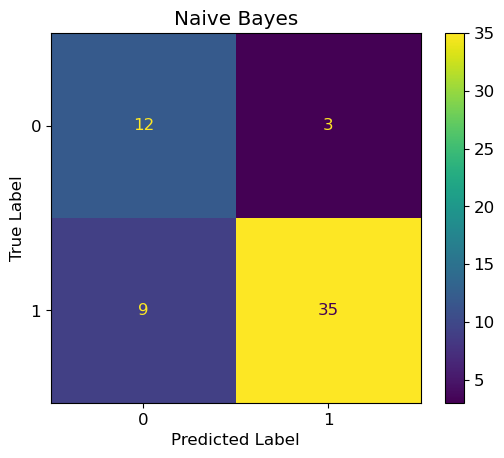

In [688]:
ConfusionMatrixDisplay.from_predictions(y_test1, y_pred_n)
plt.title('Naive Bayes')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

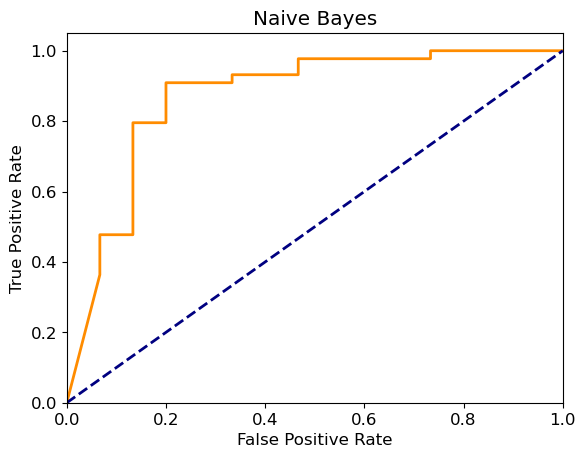

In [722]:
y_predn = NB_Model1.predict_proba(x_test1)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fprn, tprn, thresholdsn = roc_curve(y_test1, y_predn)

plt.figure()
plt.plot(fprn, tprn, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Naive Bayes')
plt.show()

## Stacking Classifier

In [772]:
estimators = [
    ('XGB_Model',XGB_Model1),
    ('KNN_Model', KNN_Model1),
    ('SVM_Model', SVM_Model1)
]
Stacking_Model1 = StackingClassifier(estimators=estimators, final_estimator=KNeighborsClassifier())

In [773]:
Stacking_Model1.fit(x_train1,y_train1)
y_pred_s= Stacking_Model1.predict(x_test1)

In [774]:
evaluate_model(y_pred_s,y_test1)

Accuracy of the model is: 93.22 %
Precision of the model is: 97.73 %
Recall of the model is: 93.48 %
AUC value of the model is: 92.89 %
F1 score of the model is: 95.56 %


In [775]:
print(classification_report(y_test1, y_pred_s))

              precision    recall  f1-score   support

           0       0.92      0.80      0.86        15
           1       0.93      0.98      0.96        44

    accuracy                           0.93        59
   macro avg       0.93      0.89      0.91        59
weighted avg       0.93      0.93      0.93        59



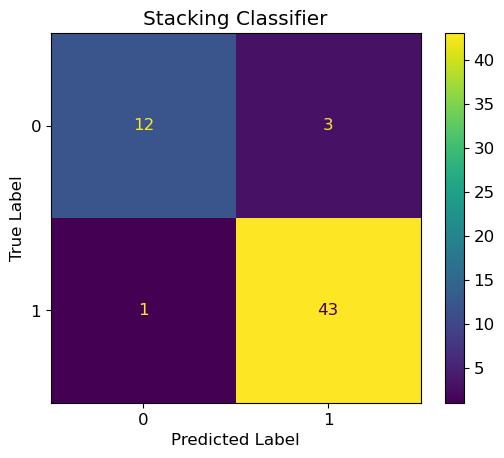

In [776]:
ConfusionMatrixDisplay.from_predictions(y_test1, y_pred_s)
plt.title('Stacking Classifier')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

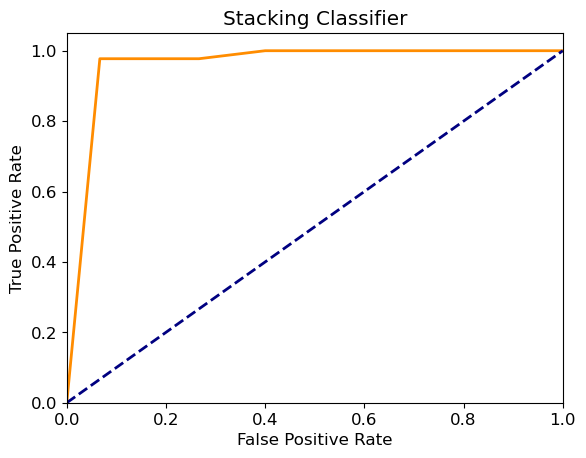

In [777]:
y_preds = Stacking_Model1.predict_proba(x_test1)[:, 1]  # Use predicted probabilities of the positive class

# Calculate the False Positive Rate (FPR), True Positive Rate (TPR), and Area Under the Curve (AUC)
fprs, tprs, thresholdss = roc_curve(y_test1, y_preds)

plt.figure()
plt.plot(fprs, tprs, color='darkorange', lw=2)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Stacking Classifier')
plt.show()